In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
!unzip /content/drive/MyDrive/Data/LungTumorDetectionAndSegmentation.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/detections/Subject_3/303.txt  
  inflating: train/detections/Subject_3/304.txt  
  inflating: train/detections/Subject_3/305.txt  
   creating: train/detections/Subject_30/
  inflating: train/detections/Subject_30/131.txt  
  inflating: train/detections/Subject_30/132.txt  
  inflating: train/detections/Subject_30/133.txt  
  inflating: train/detections/Subject_30/134.txt  
  inflating: train/detections/Subject_30/135.txt  
  inflating: train/detections/Subject_30/136.txt  
  inflating: train/detections/Subject_30/137.txt  
  inflating: train/detections/Subject_30/138.txt  
  inflating: train/detections/Subject_30/139.txt  
  inflating: train/detections/Subject_30/140.txt  
  inflating: train/detections/Subject_30/141.txt  
  inflating: train/detections/Subject_30/142.txt  
  inflating: train/detections/Subject_30/143.txt  
  inflating: train/detections/Subject_30/144.txt  
  inflating: train/detections/Subject_30/14

In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torchvision.datasets as datasets
import torchvision.transforms as transforms

In [7]:
import os
import math
import glob
import torch
import random
from PIL import Image
from tqdm import tqdm
from torch.utils.data import Dataset
import torchvision.transforms as T
import argparse
import numpy as np
import matplotlib.pyplot as plt
import yaml
from torch.optim.lr_scheduler import MultiStepLR

# Prepare the dataset


In [8]:
def load_images_and_anns(im_dir, ann_dir):
    """
    Load tumor detection dataset based on txt annotations (xmin ymin xmax ymax per line).
    """
    im_infos = []
    for img_path in tqdm(glob.glob(os.path.join(im_dir, '*/*.png'))):
        im_info = {}
        im_info['img_id'] = os.path.splitext(os.path.basename(img_path))[0]
        im_info['filename'] = img_path
        im_info['subject'] = os.path.basename(os.path.dirname(img_path))

        # Load image to get width and height
        with Image.open(img_path) as img:
            width, height = img.size
        im_info['width'] = width
        im_info['height'] = height

        # Look for corresponding annotation .txt
        ann_file = os.path.join(ann_dir, im_info['subject'], f"{im_info['img_id']}.txt")
        detections = []
        if os.path.exists(ann_file):
            with open(ann_file, 'r') as f:
                for line in f:
                    line = line.strip()
                    if line:  # Skip empty lines
                        try:
                            # Handle both comma and space separated values
                            coords = line.replace(',', ' ').split()
                            if len(coords) >= 4:
                                xmin, ymin, xmax, ymax = map(float, coords[:4])

                                # Validate coordinates
                                if xmin >= 0 and ymin >= 0 and xmax > xmin and ymax > ymin:
                                    # Ensure coordinates are within image bounds
                                    xmin = max(0, min(xmin, width - 1))
                                    ymin = max(0, min(ymin, height - 1))
                                    xmax = max(xmin + 1, min(xmax, width))
                                    ymax = max(ymin + 1, min(ymax, height))

                                    bbox = [xmin, ymin, xmax, ymax]
                                    detections.append({'label': 1, 'bbox': bbox})  # 1 for tumor
                        except ValueError:
                            print(f"Warning: Invalid annotation in {ann_file}: {line}")
                            continue

        im_info['detections'] = detections
        im_infos.append(im_info)

    print('Total {} images found'.format(len(im_infos)))
    return im_infos

In [9]:
class TumorDataset(Dataset):
    def __init__(self, split, im_dir, ann_dir):
        self.split = split
        self.im_dir = im_dir
        self.ann_dir = ann_dir
        self.label2idx = {'background': 0, 'tumor': 1}  # Fixed order
        self.idx2label = {0: 'background', 1: 'tumor'}
        self.images_info = load_images_and_anns(im_dir, ann_dir)

        # Filter out images with no valid detections for training
        if split == 'train':
            self.images_info = [info for info in self.images_info if len(info['detections']) > 0]
            print(f"Filtered to {len(self.images_info)} training images with annotations")

        self.transforms = T.ToTensor()

    def __len__(self):
        return len(self.images_info)

    def __getitem__(self, index):
        im_info = self.images_info[index]
        im = Image.open(im_info['filename']).convert("RGB")
        to_flip = False

        # Data augmentation for training
        if self.split == 'train' and random.random() < 0.5:
            to_flip = True
            im = im.transpose(Image.FLIP_LEFT_RIGHT)

        im_tensor = self.transforms(im)

        # Get image dimensions after transform
        _, height, width = im_tensor.shape

        # Get boxes and labels
        if len(im_info['detections']) == 0:
            # For images with no annotations, create minimal valid tensors
            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros((0,), dtype=torch.int64)
            area = torch.zeros((0,), dtype=torch.float32)
            iscrowd = torch.zeros((0,), dtype=torch.int64)
        else:
            boxes_list = []
            labels_list = []

            for d in im_info['detections']:
                bbox = d['bbox']
                # Ensure box coordinates are valid
                x1, y1, x2, y2 = bbox

                # Clamp coordinates to image bounds
                x1 = max(0, min(x1, width - 1))
                y1 = max(0, min(y1, height - 1))
                x2 = max(x1 + 1, min(x2, width))
                y2 = max(y1 + 1, min(y2, height))

                # Only add if box has valid area
                if x2 > x1 and y2 > y1:
                    boxes_list.append([x1, y1, x2, y2])
                    labels_list.append(d['label'])

            if len(boxes_list) == 0:
                # Fallback if all boxes are invalid
                boxes = torch.zeros((0, 4), dtype=torch.float32)
                labels = torch.zeros((0,), dtype=torch.int64)
                area = torch.zeros((0,), dtype=torch.float32)
                iscrowd = torch.zeros((0,), dtype=torch.int64)
            else:
                boxes = torch.tensor(boxes_list, dtype=torch.float32)
                labels = torch.tensor(labels_list, dtype=torch.int64)

                # Calculate area for each box
                area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
                iscrowd = torch.zeros((len(boxes),), dtype=torch.int64)

        # Apply horizontal flip to boxes if needed
        if to_flip and boxes.numel() > 0:
            boxes[:, [0, 2]] = width - boxes[:, [2, 0]]  # flip x1, x2

        target = {
            'boxes': boxes,
            'labels': labels,
            'area': area,
            'iscrowd': iscrowd,
            'image_id': torch.tensor(index, dtype=torch.int64)
        }

        return im_tensor, target

In [10]:
# Test Cases

def test_load_images_and_anns():
    """Test case for load_images_and_anns function"""
    print("Testing load_images_and_anns function...")

    # Create mock directory structure for testing
    import tempfile
    import shutil

    with tempfile.TemporaryDirectory() as temp_dir:
        # Create mock image directory
        img_dir = os.path.join(temp_dir, 'images')
        ann_dir = os.path.join(temp_dir, 'annotations')

        # Create subject directories
        os.makedirs(os.path.join(img_dir, 'subject1'))
        os.makedirs(os.path.join(ann_dir, 'subject1'))

        # Create a mock PNG file
        mock_img_path = os.path.join(img_dir, 'subject1', 'image1.png')
        mock_ann_path = os.path.join(ann_dir, 'subject1', 'image1.txt')

        # Create a simple 100x100 RGB image
        from PIL import Image
        mock_img = Image.new('RGB', (100, 100), color='red')
        mock_img.save(mock_img_path)

        # Create mock annotation file
        with open(mock_ann_path, 'w') as f:
            f.write("10 20 50 60\n")  # Valid bounding box
            f.write("70 80 90 95\n")  # Another valid bounding box

        # Test the function
        try:
            result = load_images_and_anns(img_dir, ann_dir)

            # Assertions
            assert len(result) == 1, f"Expected 1 image, got {len(result)}"
            assert result[0]['img_id'] == 'image1', f"Expected img_id 'image1', got {result[0]['img_id']}"
            assert result[0]['width'] == 100, f"Expected width 100, got {result[0]['width']}"
            assert result[0]['height'] == 100, f"Expected height 100, got {result[0]['height']}"
            assert len(result[0]['detections']) == 2, f"Expected 2 detections, got {len(result[0]['detections'])}"
            assert result[0]['detections'][0]['bbox'] == [10.0, 20.0, 50.0, 60.0], "First bbox doesn't match"
            assert result[0]['detections'][1]['bbox'] == [70.0, 80.0, 90.0, 95.0], "Second bbox doesn't match"

            print("✓ load_images_and_anns test passed!")
            return True

        except Exception as e:
            print(f"✗ load_images_and_anns test failed: {e}")
            return False


In [11]:
def test_tumor_dataset():
    """Test case for TumorDataset class"""
    print("\nTesting TumorDataset class...")

    import tempfile

    with tempfile.TemporaryDirectory() as temp_dir:
        # Create mock directory structure
        img_dir = os.path.join(temp_dir, 'images')
        ann_dir = os.path.join(temp_dir, 'annotations')

        # Create subject directories
        os.makedirs(os.path.join(img_dir, 'subject1'))
        os.makedirs(os.path.join(ann_dir, 'subject1'))

        # Create mock images and annotations
        for i in range(3):
            # Create mock image
            mock_img_path = os.path.join(img_dir, 'subject1', f'image{i}.png')
            mock_ann_path = os.path.join(ann_dir, 'subject1', f'image{i}.txt')

            # Create a simple 128x128 RGB image
            mock_img = Image.new('RGB', (128, 128), color='blue')
            mock_img.save(mock_img_path)

            # Create mock annotation (only for first two images)
            if i < 2:
                with open(mock_ann_path, 'w') as f:
                    f.write(f"{i*10} {i*10} {i*10+30} {i*10+40}\n")

        try:
            # Test dataset creation
            dataset = TumorDataset('train', img_dir, ann_dir)

            # Assertions
            assert len(dataset) == 2, f"Expected 2 images (filtered), got {len(dataset)}"
            assert hasattr(dataset, 'label2idx'), "Dataset should have label2idx attribute"
            assert dataset.label2idx['tumor'] == 1, "Tumor label should be 1"
            assert dataset.label2idx['background'] == 0, "Background label should be 0"

            # Test __getitem__
            img_tensor, target = dataset[0]

            # Check image tensor
            assert isinstance(img_tensor, torch.Tensor), "Image should be a tensor"
            assert img_tensor.shape[0] == 3, f"Expected 3 channels, got {img_tensor.shape[0]}"
            assert img_tensor.shape[1] == 128, f"Expected height 128, got {img_tensor.shape[1]}"
            assert img_tensor.shape[2] == 128, f"Expected width 128, got {img_tensor.shape[2]}"

            # Check target
            assert isinstance(target, dict), "Target should be a dictionary"
            required_keys = ['boxes', 'labels', 'area', 'iscrowd', 'image_id']
            for key in required_keys:
                assert key in target, f"Target should contain key '{key}'"

            # Check target tensors
            assert isinstance(target['boxes'], torch.Tensor), "Boxes should be a tensor"
            assert isinstance(target['labels'], torch.Tensor), "Labels should be a tensor"
            assert target['boxes'].dtype == torch.float32, "Boxes should be float32"
            assert target['labels'].dtype == torch.int64, "Labels should be int64"

            # Check if boxes have correct shape
            if target['boxes'].numel() > 0:
                assert target['boxes'].shape[1] == 4, f"Boxes should have 4 coordinates, got {target['boxes'].shape[1]}"
                assert len(target['labels']) == len(target['boxes']), "Number of labels should match number of boxes"

            print("✓ TumorDataset test passed!")

            # Test validation dataset (should include images without annotations)
            val_dataset = TumorDataset('val', img_dir, ann_dir)
            assert len(val_dataset) == 3, f"Validation dataset should have all 3 images, got {len(val_dataset)}"
            print("✓ Validation dataset test passed!")

            return True

        except Exception as e:
            print(f"✗ TumorDataset test failed: {e}")
            import traceback
            traceback.print_exc()
            return False

In [12]:
def run_all_tests():
    """Run all test cases"""
    print("=" * 50)
    print("Running Dataset Tests")
    print("=" * 50)

    test1_passed = test_load_images_and_anns()
    test2_passed = test_tumor_dataset()

    print("\n" + "=" * 50)
    print("Test Results Summary:")
    print(f"load_images_and_anns: {'✓ PASSED' if test1_passed else '✗ FAILED'}")
    print(f"TumorDataset: {'✓ PASSED' if test2_passed else '✗ FAILED'}")
    print("=" * 50)

    return test1_passed and test2_passed


In [13]:
run_all_tests()

Running Dataset Tests
Testing load_images_and_anns function...


100%|██████████| 1/1 [00:00<00:00, 1289.76it/s]


Total 1 images found
✓ load_images_and_anns test passed!

Testing TumorDataset class...


100%|██████████| 3/3 [00:00<00:00, 2464.82it/s]


Total 3 images found
Filtered to 2 training images with annotations
✓ TumorDataset test passed!


100%|██████████| 3/3 [00:00<00:00, 4059.00it/s]

Total 3 images found
✓ Validation dataset test passed!

Test Results Summary:
load_images_and_anns: ✓ PASSED
TumorDataset: ✓ PASSED


True

# Model

In [14]:
import torch
import math


def get_iou(boxes1, boxes2):
    """
    IOU between two sets of boxes
    :param boxes1: (Tensor of shape N x 4)
    :param boxes2: (Tensor of shape M x 4)
    :return: IOU matrix of shape N x M
    """
    # Input validation
    if boxes1.numel() == 0 or boxes2.numel() == 0:
        return torch.zeros((boxes1.shape[0], boxes2.shape[0]), dtype=torch.float32, device=boxes1.device)

    # Ensure boxes are in correct format and have valid areas
    assert boxes1.shape[1] == 4, f"boxes1 should have 4 coordinates, got {boxes1.shape[1]}"
    assert boxes2.shape[1] == 4, f"boxes2 should have 4 coordinates, got {boxes2.shape[1]}"

    # Area of boxes (x2-x1)*(y2-y1)
    area1 = (boxes1[:, 2] - boxes1[:, 0]) * (boxes1[:, 3] - boxes1[:, 1])  # (N,)
    area2 = (boxes2[:, 2] - boxes2[:, 0]) * (boxes2[:, 3] - boxes2[:, 1])  # (M,)

    # Clamp negative areas to 0 (invalid boxes)
    area1 = area1.clamp(min=0)
    area2 = area2.clamp(min=0)

    # Get top left x1,y1 coordinate
    x_left = torch.max(boxes1[:, None, 0], boxes2[:, 0])  # (N, M)
    y_top = torch.max(boxes1[:, None, 1], boxes2[:, 1])  # (N, M)

    # Get bottom right x2,y2 coordinate
    x_right = torch.min(boxes1[:, None, 2], boxes2[:, 2])  # (N, M)
    y_bottom = torch.min(boxes1[:, None, 3], boxes2[:, 3])  # (N, M)

    intersection_area = (x_right - x_left).clamp(min=0) * (y_bottom - y_top).clamp(min=0)  # (N, M)
    union = area1[:, None] + area2 - intersection_area  # (N, M)

    # Avoid division by zero
    iou = intersection_area / (union + 1e-6)  # (N, M)
    return iou

In [15]:
def boxes_to_transformation_targets(ground_truth_boxes, anchors_or_proposals):
    """
    Given all anchor boxes or proposals in image and their respective
    ground truth assignments, we use the x1,y1,x2,y2 coordinates of them
    to get tx,ty,tw,th transformation targets for all anchor boxes or proposals
    :param ground_truth_boxes: (anchors_or_proposals_in_image, 4)
        Ground truth box assignments for the anchors/proposals
    :param anchors_or_proposals: (anchors_or_proposals_in_image, 4) Anchors/Proposal boxes
    :return: regression_targets: (anchors_or_proposals_in_image, 4) transformation targets tx,ty,tw,th
        for all anchors/proposal boxes
    """
    # Input validation
    assert ground_truth_boxes.shape == anchors_or_proposals.shape, \
        f"GT boxes shape {ground_truth_boxes.shape} != anchors shape {anchors_or_proposals.shape}"
    assert ground_truth_boxes.shape[1] == 4, "Boxes should have 4 coordinates"

    # Get center_x,center_y,w,h from x1,y1,x2,y2 for anchors
    widths = anchors_or_proposals[:, 2] - anchors_or_proposals[:, 0]
    heights = anchors_or_proposals[:, 3] - anchors_or_proposals[:, 1]
    center_x = anchors_or_proposals[:, 0] + 0.5 * widths
    center_y = anchors_or_proposals[:, 1] + 0.5 * heights

    # Get center_x,center_y,w,h from x1,y1,x2,y2 for gt boxes
    gt_widths = ground_truth_boxes[:, 2] - ground_truth_boxes[:, 0]
    gt_heights = ground_truth_boxes[:, 3] - ground_truth_boxes[:, 1]
    gt_center_x = ground_truth_boxes[:, 0] + 0.5 * gt_widths
    gt_center_y = ground_truth_boxes[:, 1] + 0.5 * gt_heights

    # Avoid division by zero for width and height
    widths = torch.clamp(widths, min=1e-6)
    heights = torch.clamp(heights, min=1e-6)
    gt_widths = torch.clamp(gt_widths, min=1e-6)
    gt_heights = torch.clamp(gt_heights, min=1e-6)

    targets_dx = (gt_center_x - center_x) / widths
    targets_dy = (gt_center_y - center_y) / heights
    targets_dw = torch.log(gt_widths / widths)
    targets_dh = torch.log(gt_heights / heights)

    regression_targets = torch.stack((targets_dx, targets_dy, targets_dw, targets_dh), dim=1)
    return regression_targets


In [16]:
def apply_regression_pred_to_anchors_or_proposals(box_transform_pred, anchors_or_proposals):
    """
    Given the transformation parameter predictions for all
    input anchors or proposals, transform them accordingly
    to generate predicted proposals or predicted boxes
    :param box_transform_pred: (num_anchors_or_proposals, num_classes, 4) or (num_anchors_or_proposals, 4)
    :param anchors_or_proposals: (num_anchors_or_proposals, 4)
    :return pred_boxes: (num_anchors_or_proposals, num_classes, 4) or (num_anchors_or_proposals, 4)
    """
    # Handle both 2D and 3D input tensors
    original_shape = box_transform_pred.shape
    if len(original_shape) == 2:
        # (num_anchors, 4) -> (num_anchors, 1, 4)
        box_transform_pred = box_transform_pred.unsqueeze(1)
        squeeze_output = True
    else:
        # (num_anchors, num_classes, 4)
        squeeze_output = False

    box_transform_pred = box_transform_pred.reshape(box_transform_pred.size(0), -1, 4)

    # Get cx, cy, w, h from x1,y1,x2,y2
    w = anchors_or_proposals[:, 2] - anchors_or_proposals[:, 0]
    h = anchors_or_proposals[:, 3] - anchors_or_proposals[:, 1]
    center_x = anchors_or_proposals[:, 0] + 0.5 * w
    center_y = anchors_or_proposals[:, 1] + 0.5 * h

    # Clamp width and height to avoid division by zero
    w = torch.clamp(w, min=1e-6)
    h = torch.clamp(h, min=1e-6)

    dx = box_transform_pred[..., 0]
    dy = box_transform_pred[..., 1]
    dw = box_transform_pred[..., 2]
    dh = box_transform_pred[..., 3]
    # dh -> (num_anchors_or_proposals, num_classes)

    # Prevent sending too large values into torch.exp()
    dw = torch.clamp(dw, max=math.log(1000.0 / 16))
    dh = torch.clamp(dh, max=math.log(1000.0 / 16))

    pred_center_x = dx * w[:, None] + center_x[:, None]
    pred_center_y = dy * h[:, None] + center_y[:, None]
    pred_w = torch.exp(dw) * w[:, None]
    pred_h = torch.exp(dh) * h[:, None]
    # pred_center_x -> (num_anchors_or_proposals, num_classes)

    pred_box_x1 = pred_center_x - 0.5 * pred_w
    pred_box_y1 = pred_center_y - 0.5 * pred_h
    pred_box_x2 = pred_center_x + 0.5 * pred_w
    pred_box_y2 = pred_center_y + 0.5 * pred_h

    pred_boxes = torch.stack((
        pred_box_x1,
        pred_box_y1,
        pred_box_x2,
        pred_box_y2),
        dim=2)
    # pred_boxes -> (num_anchors_or_proposals, num_classes, 4)

    if squeeze_output:
        pred_boxes = pred_boxes.squeeze(1)  # (num_anchors, 4)

    return pred_boxes

In [17]:
def test_get_iou():
    """Test case for get_iou function"""
    print("Testing get_iou function...")

    try:
        # Test case 1: Perfect overlap
        boxes1 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        boxes2 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        expected_iou = torch.tensor([[1.0]])
        assert torch.allclose(iou, expected_iou, atol=1e-6), f"Perfect overlap failed: {iou} vs {expected_iou}"

        # Test case 2: No overlap
        boxes1 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        boxes2 = torch.tensor([[20, 20, 30, 30]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        expected_iou = torch.tensor([[0.0]])
        assert torch.allclose(iou, expected_iou, atol=1e-6), f"No overlap failed: {iou} vs {expected_iou}"

        # Test case 3: Partial overlap
        boxes1 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        boxes2 = torch.tensor([[5, 5, 15, 15]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        # Intersection: 5x5=25, Union: 100+100-25=175, IoU: 25/175 ≈ 0.1429
        expected_iou = 25.0 / 175.0
        assert torch.allclose(iou, torch.tensor([[expected_iou]]), atol=1e-4), f"Partial overlap failed: {iou}"

        # Test case 4: Multiple boxes
        boxes1 = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        boxes2 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        assert iou.shape == (2, 1), f"Shape mismatch: {iou.shape}"
        assert torch.allclose(iou[0, 0], torch.tensor(1.0), atol=1e-6), "First box IoU failed"

        # Test case 5: Empty boxes
        boxes1 = torch.zeros((0, 4), dtype=torch.float32)
        boxes2 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        assert iou.shape == (0, 1), f"Empty boxes shape failed: {iou.shape}"

        print("✓ get_iou test passed!")
        return True

    except Exception as e:
        print(f"✗ get_iou test failed: {e}")
        import traceback
        traceback.print_exc()
        return False


In [18]:
def test_boxes_to_transformation_targets():
    """Test case for boxes_to_transformation_targets function"""
    print("\nTesting boxes_to_transformation_targets function...")

    try:
        # Test case 1: Same boxes (should give zero transformation)
        anchors = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        gt_boxes = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        targets = boxes_to_transformation_targets(gt_boxes, anchors)

        expected_targets = torch.zeros((2, 4), dtype=torch.float32)
        assert torch.allclose(targets, expected_targets, atol=1e-6), f"Same boxes failed: {targets}"

        # Test case 2: Translation only
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        gt_boxes = torch.tensor([[2, 3, 12, 13]], dtype=torch.float32)  # Moved by (2, 3)
        targets = boxes_to_transformation_targets(gt_boxes, anchors)

        # Expected: dx=2/10=0.2, dy=3/10=0.3, dw=0, dh=0
        expected_targets = torch.tensor([[0.2, 0.3, 0.0, 0.0]], dtype=torch.float32)
        assert torch.allclose(targets, expected_targets, atol=1e-6), f"Translation failed: {targets}"

        # Test case 3: Scaling only
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        gt_boxes = torch.tensor([[-5, -5, 15, 15]], dtype=torch.float32)  # 2x scaling
        targets = boxes_to_transformation_targets(gt_boxes, anchors)

        # Expected: dx=0, dy=0, dw=log(2), dh=log(2)
        expected_dw = math.log(2.0)
        expected_targets = torch.tensor([[0.0, 0.0, expected_dw, expected_dw]], dtype=torch.float32)
        assert torch.allclose(targets, expected_targets, atol=1e-6), f"Scaling failed: {targets}"

        print("✓ boxes_to_transformation_targets test passed!")
        return True

    except Exception as e:
        print(f"✗ boxes_to_transformation_targets test failed: {e}")
        import traceback
        traceback.print_exc()
        return False

In [19]:
import torch
import math


def get_iou(boxes1, boxes2):
    """
    IOU between two sets of boxes
    :param boxes1: (Tensor of shape N x 4)
    :param boxes2: (Tensor of shape M x 4)
    :return: IOU matrix of shape N x M
    """
    # Input validation
    if boxes1.numel() == 0 or boxes2.numel() == 0:
        return torch.zeros((boxes1.shape[0], boxes2.shape[0]), dtype=torch.float32, device=boxes1.device)

    # Ensure boxes are in correct format and have valid areas
    assert boxes1.shape[1] == 4, f"boxes1 should have 4 coordinates, got {boxes1.shape[1]}"
    assert boxes2.shape[1] == 4, f"boxes2 should have 4 coordinates, got {boxes2.shape[1]}"

    # Area of boxes (x2-x1)*(y2-y1)
    area1 = (boxes1[:, 2] - boxes1[:, 0]) * (boxes1[:, 3] - boxes1[:, 1])  # (N,)
    area2 = (boxes2[:, 2] - boxes2[:, 0]) * (boxes2[:, 3] - boxes2[:, 1])  # (M,)

    # Clamp negative areas to 0 (invalid boxes)
    area1 = area1.clamp(min=0)
    area2 = area2.clamp(min=0)

    # Get top left x1,y1 coordinate
    x_left = torch.max(boxes1[:, None, 0], boxes2[:, 0])  # (N, M)
    y_top = torch.max(boxes1[:, None, 1], boxes2[:, 1])  # (N, M)

    # Get bottom right x2,y2 coordinate
    x_right = torch.min(boxes1[:, None, 2], boxes2[:, 2])  # (N, M)
    y_bottom = torch.min(boxes1[:, None, 3], boxes2[:, 3])  # (N, M)

    intersection_area = (x_right - x_left).clamp(min=0) * (y_bottom - y_top).clamp(min=0)  # (N, M)
    union = area1[:, None] + area2 - intersection_area  # (N, M)

    # Avoid division by zero
    iou = intersection_area / (union + 1e-6)  # (N, M)
    return iou


def boxes_to_transformation_targets(ground_truth_boxes, anchors_or_proposals):
    """
    Given all anchor boxes or proposals in image and their respective
    ground truth assignments, we use the x1,y1,x2,y2 coordinates of them
    to get tx,ty,tw,th transformation targets for all anchor boxes or proposals
    :param ground_truth_boxes: (anchors_or_proposals_in_image, 4)
        Ground truth box assignments for the anchors/proposals
    :param anchors_or_proposals: (anchors_or_proposals_in_image, 4) Anchors/Proposal boxes
    :return: regression_targets: (anchors_or_proposals_in_image, 4) transformation targets tx,ty,tw,th
        for all anchors/proposal boxes
    """
    # Input validation
    assert ground_truth_boxes.shape == anchors_or_proposals.shape, \
        f"GT boxes shape {ground_truth_boxes.shape} != anchors shape {anchors_or_proposals.shape}"
    assert ground_truth_boxes.shape[1] == 4, "Boxes should have 4 coordinates"

    # Get center_x,center_y,w,h from x1,y1,x2,y2 for anchors
    widths = anchors_or_proposals[:, 2] - anchors_or_proposals[:, 0]
    heights = anchors_or_proposals[:, 3] - anchors_or_proposals[:, 1]
    center_x = anchors_or_proposals[:, 0] + 0.5 * widths
    center_y = anchors_or_proposals[:, 1] + 0.5 * heights

    # Get center_x,center_y,w,h from x1,y1,x2,y2 for gt boxes
    gt_widths = ground_truth_boxes[:, 2] - ground_truth_boxes[:, 0]
    gt_heights = ground_truth_boxes[:, 3] - ground_truth_boxes[:, 1]
    gt_center_x = ground_truth_boxes[:, 0] + 0.5 * gt_widths
    gt_center_y = ground_truth_boxes[:, 1] + 0.5 * gt_heights

    # Avoid division by zero for width and height
    widths = torch.clamp(widths, min=1e-6)
    heights = torch.clamp(heights, min=1e-6)
    gt_widths = torch.clamp(gt_widths, min=1e-6)
    gt_heights = torch.clamp(gt_heights, min=1e-6)

    targets_dx = (gt_center_x - center_x) / widths
    targets_dy = (gt_center_y - center_y) / heights
    targets_dw = torch.log(gt_widths / widths)
    targets_dh = torch.log(gt_heights / heights)

    regression_targets = torch.stack((targets_dx, targets_dy, targets_dw, targets_dh), dim=1)
    return regression_targets


def apply_regression_pred_to_anchors_or_proposals(box_transform_pred, anchors_or_proposals):
    """
    Given the transformation parameter predictions for all
    input anchors or proposals, transform them accordingly
    to generate predicted proposals or predicted boxes
    :param box_transform_pred: (num_anchors_or_proposals, num_classes, 4) or (num_anchors_or_proposals, 4)
    :param anchors_or_proposals: (num_anchors_or_proposals, 4)
    :return pred_boxes: (num_anchors_or_proposals, num_classes, 4) or (num_anchors_or_proposals, 4)
    """
    # Handle both 2D and 3D input tensors
    original_shape = box_transform_pred.shape
    if len(original_shape) == 2:
        # (num_anchors, 4) -> (num_anchors, 1, 4)
        box_transform_pred = box_transform_pred.unsqueeze(1)
        squeeze_output = True
    else:
        # (num_anchors, num_classes, 4)
        squeeze_output = False

    box_transform_pred = box_transform_pred.reshape(box_transform_pred.size(0), -1, 4)

    # Get cx, cy, w, h from x1,y1,x2,y2
    w = anchors_or_proposals[:, 2] - anchors_or_proposals[:, 0]
    h = anchors_or_proposals[:, 3] - anchors_or_proposals[:, 1]
    center_x = anchors_or_proposals[:, 0] + 0.5 * w
    center_y = anchors_or_proposals[:, 1] + 0.5 * h

    # Clamp width and height to avoid division by zero
    w = torch.clamp(w, min=1e-6)
    h = torch.clamp(h, min=1e-6)

    dx = box_transform_pred[..., 0]
    dy = box_transform_pred[..., 1]
    dw = box_transform_pred[..., 2]
    dh = box_transform_pred[..., 3]
    # dh -> (num_anchors_or_proposals, num_classes)

    # Prevent sending too large values into torch.exp()
    dw = torch.clamp(dw, max=math.log(1000.0 / 16))
    dh = torch.clamp(dh, max=math.log(1000.0 / 16))

    pred_center_x = dx * w[:, None] + center_x[:, None]
    pred_center_y = dy * h[:, None] + center_y[:, None]
    pred_w = torch.exp(dw) * w[:, None]
    pred_h = torch.exp(dh) * h[:, None]
    # pred_center_x -> (num_anchors_or_proposals, num_classes)

    pred_box_x1 = pred_center_x - 0.5 * pred_w
    pred_box_y1 = pred_center_y - 0.5 * pred_h
    pred_box_x2 = pred_center_x + 0.5 * pred_w
    pred_box_y2 = pred_center_y + 0.5 * pred_h

    pred_boxes = torch.stack((
        pred_box_x1,
        pred_box_y1,
        pred_box_x2,
        pred_box_y2),
        dim=2)
    # pred_boxes -> (num_anchors_or_proposals, num_classes, 4)

    if squeeze_output:
        pred_boxes = pred_boxes.squeeze(1)  # (num_anchors, 4)

    return pred_boxes


# Test Cases

def test_get_iou():
    """Test case for get_iou function"""
    print("Testing get_iou function...")

    try:
        # Test case 1: Perfect overlap
        boxes1 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        boxes2 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        expected_iou = torch.tensor([[1.0]])
        assert torch.allclose(iou, expected_iou, atol=1e-6), f"Perfect overlap failed: {iou} vs {expected_iou}"

        # Test case 2: No overlap
        boxes1 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        boxes2 = torch.tensor([[20, 20, 30, 30]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        expected_iou = torch.tensor([[0.0]])
        assert torch.allclose(iou, expected_iou, atol=1e-6), f"No overlap failed: {iou} vs {expected_iou}"

        # Test case 3: Partial overlap
        boxes1 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        boxes2 = torch.tensor([[5, 5, 15, 15]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        # Intersection: 5x5=25, Union: 100+100-25=175, IoU: 25/175 ≈ 0.1429
        expected_iou = 25.0 / 175.0
        assert torch.allclose(iou, torch.tensor([[expected_iou]]), atol=1e-4), f"Partial overlap failed: {iou}"

        # Test case 4: Multiple boxes
        boxes1 = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        boxes2 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        assert iou.shape == (2, 1), f"Shape mismatch: {iou.shape}"
        assert torch.allclose(iou[0, 0], torch.tensor(1.0), atol=1e-6), "First box IoU failed"

        # Test case 5: Empty boxes
        boxes1 = torch.zeros((0, 4), dtype=torch.float32)
        boxes2 = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        iou = get_iou(boxes1, boxes2)
        assert iou.shape == (0, 1), f"Empty boxes shape failed: {iou.shape}"

        print("✓ get_iou test passed!")
        return True

    except Exception as e:
        print(f"✗ get_iou test failed: {e}")
        import traceback
        traceback.print_exc()
        return False


def test_boxes_to_transformation_targets():
    """Test case for boxes_to_transformation_targets function"""
    print("\nTesting boxes_to_transformation_targets function...")

    try:
        # Test case 1: Same boxes (should give zero transformation)
        anchors = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        gt_boxes = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        targets = boxes_to_transformation_targets(gt_boxes, anchors)

        expected_targets = torch.zeros((2, 4), dtype=torch.float32)
        assert torch.allclose(targets, expected_targets, atol=1e-6), f"Same boxes failed: {targets}"

        # Test case 2: Translation only
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        gt_boxes = torch.tensor([[2, 3, 12, 13]], dtype=torch.float32)  # Moved by (2, 3)
        targets = boxes_to_transformation_targets(gt_boxes, anchors)

        # Expected: dx=2/10=0.2, dy=3/10=0.3, dw=0, dh=0
        expected_targets = torch.tensor([[0.2, 0.3, 0.0, 0.0]], dtype=torch.float32)
        assert torch.allclose(targets, expected_targets, atol=1e-6), f"Translation failed: {targets}"

        # Test case 3: Scaling only
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        gt_boxes = torch.tensor([[-5, -5, 15, 15]], dtype=torch.float32)  # 2x scaling
        targets = boxes_to_transformation_targets(gt_boxes, anchors)

        # Expected: dx=0, dy=0, dw=log(2), dh=log(2)
        expected_dw = math.log(2.0)
        expected_targets = torch.tensor([[0.0, 0.0, expected_dw, expected_dw]], dtype=torch.float32)
        assert torch.allclose(targets, expected_targets, atol=1e-6), f"Scaling failed: {targets}"

        print("✓ boxes_to_transformation_targets test passed!")
        return True

    except Exception as e:
        print(f"✗ boxes_to_transformation_targets test failed: {e}")
        import traceback
        traceback.print_exc()
        return False


def test_apply_regression_pred_to_anchors_or_proposals():
    """Test case for apply_regression_pred_to_anchors_or_proposals function"""
    print("\nTesting apply_regression_pred_to_anchors_or_proposals function...")

    try:
        # Test case 1: Zero transformation (should return original boxes)
        anchors = torch.tensor([[0, 0, 10, 10], [5, 5, 15, 15]], dtype=torch.float32)
        transforms = torch.zeros((2, 4), dtype=torch.float32)
        pred_boxes = apply_regression_pred_to_anchors_or_proposals(transforms, anchors)

        assert torch.allclose(pred_boxes, anchors, atol=1e-6), f"Zero transform failed: {pred_boxes} vs {anchors}"

        # Test case 2: Translation
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        transforms = torch.tensor([[0.2, 0.3, 0.0, 0.0]], dtype=torch.float32)  # Move by (2, 3)
        pred_boxes = apply_regression_pred_to_anchors_or_proposals(transforms, anchors)

        expected_boxes = torch.tensor([[2, 3, 12, 13]], dtype=torch.float32)
        assert torch.allclose(pred_boxes, expected_boxes, atol=1e-6), f"Translation failed: {pred_boxes}"

        # Test case 3: Scaling
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        transforms = torch.tensor([[0.0, 0.0, math.log(2.0), math.log(2.0)]], dtype=torch.float32)
        pred_boxes = apply_regression_pred_to_anchors_or_proposals(transforms, anchors)

        expected_boxes = torch.tensor([[-5, -5, 15, 15]], dtype=torch.float32)
        assert torch.allclose(pred_boxes, expected_boxes, atol=1e-6), f"Scaling failed: {pred_boxes}"

        # Test case 4: Multi-class predictions
        anchors = torch.tensor([[0, 0, 10, 10]], dtype=torch.float32)
        transforms = torch.zeros((1, 2, 4), dtype=torch.float32)  # 2 classes
        pred_boxes = apply_regression_pred_to_anchors_or_proposals(transforms, anchors)

        assert pred_boxes.shape == (1, 2, 4), f"Multi-class shape failed: {pred_boxes.shape}"
        expected_boxes = anchors.unsqueeze(1).repeat(1, 2, 1)
        assert torch.allclose(pred_boxes, expected_boxes, atol=1e-6), "Multi-class failed"

        print("✓ apply_regression_pred_to_anchors_or_proposals test passed!")
        return True

    except Exception as e:
        print(f"✗ apply_regression_pred_to_anchors_or_proposals test failed: {e}")
        import traceback
        traceback.print_exc()
        return False



In [20]:
def run_bbox_utils_tests():
    """Run all bounding box utility tests"""
    print("=" * 60)
    print("Running Bounding Box Utility Tests")
    print("=" * 60)

    test1_passed = test_get_iou()
    test2_passed = test_boxes_to_transformation_targets()
    test3_passed = test_apply_regression_pred_to_anchors_or_proposals()

    print("\n" + "=" * 60)
    print("Test Results Summary:")
    print(f"get_iou: {'✓ PASSED' if test1_passed else '✗ FAILED'}")
    print(f"boxes_to_transformation_targets: {'✓ PASSED' if test2_passed else '✗ FAILED'}")
    print(f"apply_regression_pred_to_anchors_or_proposals: {'✓ PASSED' if test3_passed else '✗ FAILED'}")
    print("=" * 60)

    return test1_passed and test2_passed and test3_passed


In [21]:
run_bbox_utils_tests()

Running Bounding Box Utility Tests
Testing get_iou function...
✓ get_iou test passed!

Testing boxes_to_transformation_targets function...
✓ boxes_to_transformation_targets test passed!

Testing apply_regression_pred_to_anchors_or_proposals function...
✓ apply_regression_pred_to_anchors_or_proposals test passed!

Test Results Summary:
get_iou: ✓ PASSED
boxes_to_transformation_targets: ✓ PASSED
apply_regression_pred_to_anchors_or_proposals: ✓ PASSED


True

In [22]:
def sample_positive_negative(labels, positive_count, total_count):
    """
    Sample positive and negative proposals for training
    :param labels: (N,) tensor of labels where 0=background, >=1=positive
    :param positive_count: target number of positive samples
    :param total_count: total number of samples to return
    :return: (pos_mask, neg_mask) boolean masks for sampled indices
    """
    # Input validation
    assert labels.dim() == 1, f"Labels should be 1D tensor, got {labels.dim()}D"
    assert positive_count <= total_count, f"positive_count ({positive_count}) > total_count ({total_count})"
    assert total_count > 0, f"total_count should be positive, got {total_count}"

    # Sample positive and negative proposals
    positive = torch.where(labels >= 1)[0]
    negative = torch.where(labels == 0)[0]

    # Handle edge cases
    if positive.numel() == 0 and negative.numel() == 0:
        # No valid samples
        sampled_pos_idx_mask = torch.zeros_like(labels, dtype=torch.bool)
        sampled_neg_idx_mask = torch.zeros_like(labels, dtype=torch.bool)
        return sampled_pos_idx_mask, sampled_neg_idx_mask

    # Calculate actual number of positive and negative samples
    num_pos = min(positive.numel(), positive_count)
    num_neg = min(negative.numel(), total_count - num_pos)

    # If we don't have enough positives, increase negatives to reach total_count
    if num_pos < positive_count:
        num_neg = min(negative.numel(), total_count - num_pos)

    # Sample indices
    sampled_pos_idx_mask = torch.zeros_like(labels, dtype=torch.bool)
    sampled_neg_idx_mask = torch.zeros_like(labels, dtype=torch.bool)

    if num_pos > 0:
        perm_positive_idxs = torch.randperm(positive.numel(), device=positive.device)[:num_pos]
        pos_idxs = positive[perm_positive_idxs]
        sampled_pos_idx_mask[pos_idxs] = True

    if num_neg > 0:
        perm_negative_idxs = torch.randperm(negative.numel(), device=negative.device)[:num_neg]
        neg_idxs = negative[perm_negative_idxs]
        sampled_neg_idx_mask[neg_idxs] = True

    return sampled_pos_idx_mask, sampled_neg_idx_mask

In [23]:
def clamp_boxes_to_image_boundary(boxes, image_shape):
    """
    Clamp bounding boxes to image boundaries
    :param boxes: (..., 4) tensor of boxes in (x1, y1, x2, y2) format
    :param image_shape: (H, W) or (..., H, W) shape of the image
    :return: clamped boxes with same shape as input
    """
    if boxes.numel() == 0:
        return boxes

    # Handle different input shapes
    if len(image_shape) >= 2:
        height, width = image_shape[-2:]
    else:
        raise ValueError(f"image_shape should have at least 2 dimensions, got {len(image_shape)}")

    # Extract coordinates
    boxes_x1 = boxes[..., 0]
    boxes_y1 = boxes[..., 1]
    boxes_x2 = boxes[..., 2]
    boxes_y2 = boxes[..., 3]

    # Clamp coordinates to image boundaries
    # Fix: x coordinates should be clamped to [0, width-1], y to [0, height-1]
    boxes_x1 = boxes_x1.clamp(min=0, max=width - 1)
    boxes_x2 = boxes_x2.clamp(min=0, max=width - 1)
    boxes_y1 = boxes_y1.clamp(min=0, max=height - 1)
    boxes_y2 = boxes_y2.clamp(min=0, max=height - 1)

    # Ensure x2 >= x1 and y2 >= y1 (valid boxes)
    boxes_x2 = torch.max(boxes_x1, boxes_x2)
    boxes_y2 = torch.max(boxes_y1, boxes_y2)

    # Reconstruct boxes tensor
    boxes = torch.stack((boxes_x1, boxes_y1, boxes_x2, boxes_y2), dim=-1)

    return boxes


In [24]:
def transform_boxes_to_original_size(boxes, new_size, original_size):
    """
    Transform boxes from resized image coordinates back to original image coordinates
    :param boxes: (N, 4) tensor of boxes in (x1, y1, x2, y2) format
    :param new_size: (H, W) size of the resized image
    :param original_size: (H, W) size of the original image
    :return: boxes transformed to original image coordinates
    """
    if boxes.numel() == 0:
        return boxes

    # Input validation
    assert len(new_size) == 2, f"new_size should have 2 elements, got {len(new_size)}"
    assert len(original_size) == 2, f"original_size should have 2 elements, got {len(original_size)}"
    assert boxes.shape[-1] == 4, f"boxes should have 4 coordinates, got {boxes.shape[-1]}"

    # Calculate scaling ratios
    new_height, new_width = new_size
    orig_height, orig_width = original_size

    # Avoid division by zero
    if new_height == 0 or new_width == 0:
        raise ValueError(f"new_size cannot contain zeros: {new_size}")

    ratio_height = float(orig_height) / float(new_height)
    ratio_width = float(orig_width) / float(new_width)

    # Convert ratios to tensors on the same device as boxes
    ratio_height = torch.tensor(ratio_height, dtype=boxes.dtype, device=boxes.device)
    ratio_width = torch.tensor(ratio_width, dtype=boxes.dtype, device=boxes.device)

    # Extract coordinates
    xmin, ymin, xmax, ymax = boxes.unbind(-1)

    # Scale coordinates
    xmin = xmin * ratio_width
    xmax = xmax * ratio_width
    ymin = ymin * ratio_height
    ymax = ymax * ratio_height

    # Reconstruct boxes
    transformed_boxes = torch.stack((xmin, ymin, xmax, ymax), dim=-1)

    return transformed_boxes

In [25]:
# Test Cases

def test_sample_positive_negative():
    """Test case for sample_positive_negative function"""
    print("Testing sample_positive_negative function...")

    try:
        # Test case 1: Normal case with enough positive and negative samples
        labels = torch.tensor([0, 1, 0, 2, 0, 1, 0])  # 2 pos (indices 1,5), 5 neg (0,2,4,6)
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=2, total_count=4)

        assert pos_mask.sum() <= 2, f"Too many positives: {pos_mask.sum()}"
        assert neg_mask.sum() <= 2, f"Too many negatives: {neg_mask.sum()}"
        assert (pos_mask.sum() + neg_mask.sum()) <= 4, "Total samples exceed limit"
        assert not (pos_mask & neg_mask).any(), "Overlap between pos and neg masks"

        # Test case 2: Not enough positive samples
        labels = torch.tensor([0, 1, 0, 0, 0])  # 1 pos, 4 neg
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=3, total_count=4)

        assert pos_mask.sum() == 1, f"Should have 1 positive, got {pos_mask.sum()}"
        assert neg_mask.sum() == 3, f"Should have 3 negatives, got {neg_mask.sum()}"

        # Test case 3: No positive samples
        labels = torch.tensor([0, 0, 0, 0])  # all negative
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=2, total_count=3)

        assert pos_mask.sum() == 0, f"Should have 0 positives, got {pos_mask.sum()}"
        assert neg_mask.sum() == 3, f"Should have 3 negatives, got {neg_mask.sum()}"

        # Test case 4: Empty labels
        labels = torch.tensor([])
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=1, total_count=2)

        assert pos_mask.numel() == 0, "Empty input should return empty masks"
        assert neg_mask.numel() == 0, "Empty input should return empty masks"

        print("✓ sample_positive_negative test passed!")
        return True

    except Exception as e:
        print(f"✗ sample_positive_negative test failed: {e}")
        import traceback
        traceback.print_exc()
        return False


In [29]:
import torch


def sample_positive_negative(labels, positive_count, total_count):
    """
    Sample positive and negative proposals for training
    :param labels: (N,) tensor of labels where 0=background, >=1=positive
    :param positive_count: target number of positive samples
    :param total_count: total number of samples to return
    :return: (pos_mask, neg_mask) boolean masks for sampled indices
    """
    # Input validation
    assert labels.dim() == 1, f"Labels should be 1D tensor, got {labels.dim()}D"
    assert positive_count <= total_count, f"positive_count ({positive_count}) > total_count ({total_count})"
    assert total_count > 0, f"total_count should be positive, got {total_count}"

    # Sample positive and negative proposals
    positive = torch.where(labels >= 1)[0]
    negative = torch.where(labels == 0)[0]

    # Handle edge cases
    if positive.numel() == 0 and negative.numel() == 0:
        # No valid samples
        sampled_pos_idx_mask = torch.zeros_like(labels, dtype=torch.bool)
        sampled_neg_idx_mask = torch.zeros_like(labels, dtype=torch.bool)
        return sampled_pos_idx_mask, sampled_neg_idx_mask

    # Calculate actual number of positive and negative samples
    num_pos = min(positive.numel(), positive_count)
    num_neg = min(negative.numel(), total_count - num_pos)

    # If we don't have enough positives, increase negatives to reach total_count
    if num_pos < positive_count:
        num_neg = min(negative.numel(), total_count - num_pos)

    # Sample indices
    sampled_pos_idx_mask = torch.zeros_like(labels, dtype=torch.bool)
    sampled_neg_idx_mask = torch.zeros_like(labels, dtype=torch.bool)

    if num_pos > 0:
        perm_positive_idxs = torch.randperm(positive.numel(), device=positive.device)[:num_pos]
        pos_idxs = positive[perm_positive_idxs]
        sampled_pos_idx_mask[pos_idxs] = True

    if num_neg > 0:
        perm_negative_idxs = torch.randperm(negative.numel(), device=negative.device)[:num_neg]
        neg_idxs = negative[perm_negative_idxs]
        sampled_neg_idx_mask[neg_idxs] = True

    return sampled_pos_idx_mask, sampled_neg_idx_mask


def clamp_boxes_to_image_boundary(boxes, image_shape):
    """
    Clamp bounding boxes to image boundaries
    :param boxes: (..., 4) tensor of boxes in (x1, y1, x2, y2) format
    :param image_shape: (H, W) or (..., H, W) shape of the image
    :return: clamped boxes with same shape as input
    """
    if boxes.numel() == 0:
        return boxes

    # Handle different input shapes
    if len(image_shape) >= 2:
        height, width = image_shape[-2:]
    else:
        raise ValueError(f"image_shape should have at least 2 dimensions, got {len(image_shape)}")

    # Extract coordinates
    boxes_x1 = boxes[..., 0]
    boxes_y1 = boxes[..., 1]
    boxes_x2 = boxes[..., 2]
    boxes_y2 = boxes[..., 3]

    # Clamp coordinates to image boundaries
    # Fix: x coordinates should be clamped to [0, width-1], y to [0, height-1]
    boxes_x1 = boxes_x1.clamp(min=0, max=width - 1)
    boxes_x2 = boxes_x2.clamp(min=0, max=width - 1)
    boxes_y1 = boxes_y1.clamp(min=0, max=height - 1)
    boxes_y2 = boxes_y2.clamp(min=0, max=height - 1)

    # Ensure x2 >= x1 and y2 >= y1 (valid boxes)
    boxes_x2 = torch.max(boxes_x1, boxes_x2)
    boxes_y2 = torch.max(boxes_y1, boxes_y2)

    # Reconstruct boxes tensor
    boxes = torch.stack((boxes_x1, boxes_y1, boxes_x2, boxes_y2), dim=-1)

    return boxes


def transform_boxes_to_original_size(boxes, new_size, original_size):
    """
    Transform boxes from resized image coordinates back to original image coordinates
    :param boxes: (N, 4) tensor of boxes in (x1, y1, x2, y2) format
    :param new_size: (H, W) size of the resized image
    :param original_size: (H, W) size of the original image
    :return: boxes transformed to original image coordinates
    """
    if boxes.numel() == 0:
        return boxes

    # Input validation
    assert len(new_size) == 2, f"new_size should have 2 elements, got {len(new_size)}"
    assert len(original_size) == 2, f"original_size should have 2 elements, got {len(original_size)}"
    assert boxes.shape[-1] == 4, f"boxes should have 4 coordinates, got {boxes.shape[-1]}"

    # Calculate scaling ratios
    new_height, new_width = new_size
    orig_height, orig_width = original_size

    # Avoid division by zero
    if new_height == 0 or new_width == 0:
        raise ValueError(f"new_size cannot contain zeros: {new_size}")

    ratio_height = float(orig_height) / float(new_height)
    ratio_width = float(orig_width) / float(new_width)

    # Convert ratios to tensors on the same device as boxes
    ratio_height = torch.tensor(ratio_height, dtype=boxes.dtype, device=boxes.device)
    ratio_width = torch.tensor(ratio_width, dtype=boxes.dtype, device=boxes.device)

    # Extract coordinates
    xmin, ymin, xmax, ymax = boxes.unbind(-1)

    # Scale coordinates
    xmin = xmin * ratio_width
    xmax = xmax * ratio_width
    ymin = ymin * ratio_height
    ymax = ymax * ratio_height

    # Reconstruct boxes
    transformed_boxes = torch.stack((xmin, ymin, xmax, ymax), dim=-1)

    return transformed_boxes


# Test Cases

def test_sample_positive_negative():
    """Test case for sample_positive_negative function"""
    print("Testing sample_positive_negative function...")

    try:
        # Test case 1: Normal case with enough positive and negative samples
        labels = torch.tensor([0, 1, 0, 2, 0, 1, 0])  # 2 pos (indices 1,5), 5 neg (0,2,4,6)
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=2, total_count=4)

        assert pos_mask.sum() <= 2, f"Too many positives: {pos_mask.sum()}"
        assert neg_mask.sum() <= 2, f"Too many negatives: {neg_mask.sum()}"
        assert (pos_mask.sum() + neg_mask.sum()) <= 4, "Total samples exceed limit"
        assert not (pos_mask & neg_mask).any(), "Overlap between pos and neg masks"

        # Test case 2: Not enough positive samples
        labels = torch.tensor([0, 1, 0, 0, 0])  # 1 pos, 4 neg
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=3, total_count=4)

        assert pos_mask.sum() == 1, f"Should have 1 positive, got {pos_mask.sum()}"
        assert neg_mask.sum() == 3, f"Should have 3 negatives, got {neg_mask.sum()}"

        # Test case 3: No positive samples
        labels = torch.tensor([0, 0, 0, 0])  # all negative
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=2, total_count=3)

        assert pos_mask.sum() == 0, f"Should have 0 positives, got {pos_mask.sum()}"
        assert neg_mask.sum() == 3, f"Should have 3 negatives, got {neg_mask.sum()}"

        # Test case 4: Empty labels
        labels = torch.tensor([])
        pos_mask, neg_mask = sample_positive_negative(labels, positive_count=1, total_count=2)

        assert pos_mask.numel() == 0, "Empty input should return empty masks"
        assert neg_mask.numel() == 0, "Empty input should return empty masks"

        print("✓ sample_positive_negative test passed!")
        return True

    except Exception as e:
        print(f"✗ sample_positive_negative test failed: {e}")
        import traceback
        traceback.print_exc()
        return False


def test_clamp_boxes_to_image_boundary():
    """Test case for clamp_boxes_to_image_boundary function"""
    print("\nTesting clamp_boxes_to_image_boundary function...")

    try:
        # Test case 1: Boxes within boundary
        boxes = torch.tensor([[10, 20, 50, 60], [5, 5, 15, 25]], dtype=torch.float32)
        image_shape = (100, 80)  # H=100, W=80
        clamped = clamp_boxes_to_image_boundary(boxes, image_shape)

        expected = torch.tensor([[10, 20, 50, 60], [5, 5, 15, 25]], dtype=torch.float32)
        assert torch.allclose(clamped, expected), f"Within boundary failed: {clamped}"

        # Test case 2: Boxes outside boundary
        boxes = torch.tensor([[-10, -5, 100, 150], [70, 90, 85, 110]], dtype=torch.float32)
        image_shape = (100, 80)  # H=100, W=80
        clamped = clamp_boxes_to_image_boundary(boxes, image_shape)

        # Expected: x clamped to [0, 79], y clamped to [0, 99]
        expected = torch.tensor([[0, 0, 79, 99], [70, 90, 79, 99]], dtype=torch.float32)
        assert torch.allclose(clamped, expected), f"Outside boundary failed: {clamped} vs {expected}"

        # Test case 3: Invalid boxes (x2 < x1, y2 < y1)
        boxes = torch.tensor([[50, 60, 10, 20]], dtype=torch.float32)
        image_shape = (100, 80)
        clamped = clamp_boxes_to_image_boundary(boxes, image_shape)

        # Should fix invalid boxes: x2 should be >= x1, y2 >= y1
        assert clamped[0, 2] >= clamped[0, 0], "x2 should be >= x1"
        assert clamped[0, 3] >= clamped[0, 1], "y2 should be >= y1"

        # Test case 4: Empty boxes
        boxes = torch.zeros((0, 4), dtype=torch.float32)
        image_shape = (100, 80)
        clamped = clamp_boxes_to_image_boundary(boxes, image_shape)

        assert clamped.shape == (0, 4), f"Empty boxes shape failed: {clamped.shape}"

        print("✓ clamp_boxes_to_image_boundary test passed!")
        return True

    except Exception as e:
        print(f"✗ clamp_boxes_to_image_boundary test failed: {e}")
        import traceback
        traceback.print_exc()
        return False


In [26]:
def test_transform_boxes_to_original_size():
    """Test case for transform_boxes_to_original_size function"""
    print("\nTesting transform_boxes_to_original_size function...")

    try:
        # Test case 1: 2x upscaling
        boxes = torch.tensor([[10, 20, 30, 40]], dtype=torch.float32)
        new_size = (100, 50)  # resized image
        original_size = (200, 100)  # original image (2x larger)
        transformed = transform_boxes_to_original_size(boxes, new_size, original_size)

        expected = torch.tensor([[20, 40, 60, 80]], dtype=torch.float32)  # 2x scaling
        assert torch.allclose(transformed, expected), f"2x upscaling failed: {transformed} vs {expected}"

        # Test case 2: 0.5x downscaling
        boxes = torch.tensor([[20, 40, 60, 80]], dtype=torch.float32)
        new_size = (200, 100)  # resized image
        original_size = (100, 50)  # original image (0.5x smaller)
        transformed = transform_boxes_to_original_size(boxes, new_size, original_size)

        expected = torch.tensor([[10, 20, 30, 40]], dtype=torch.float32)  # 0.5x scaling
        assert torch.allclose(transformed, expected), f"0.5x downscaling failed: {transformed} vs {expected}"

        # Test case 3: Non-uniform scaling
        boxes = torch.tensor([[10, 20, 30, 40]], dtype=torch.float32)
        new_size = (100, 50)  # H=100, W=50
        original_size = (200, 150)  # H=200 (2x), W=150 (3x)
        transformed = transform_boxes_to_original_size(boxes, new_size, original_size)

        expected = torch.tensor([[30, 40, 90, 80]], dtype=torch.float32)  # x*3, y*2
        assert torch.allclose(transformed, expected), f"Non-uniform scaling failed: {transformed} vs {expected}"

        # Test case 4: Identity transformation
        boxes = torch.tensor([[5, 10, 15, 25]], dtype=torch.float32)
        new_size = (100, 100)
        original_size = (100, 100)
        transformed = transform_boxes_to_original_size(boxes, new_size, original_size)

        assert torch.allclose(transformed, boxes), f"Identity failed: {transformed} vs {boxes}"

        # Test case 5: Empty boxes
        boxes = torch.zeros((0, 4), dtype=torch.float32)
        new_size = (100, 100)
        original_size = (200, 200)
        transformed = transform_boxes_to_original_size(boxes, new_size, original_size)

        assert transformed.shape == (0, 4), f"Empty boxes shape failed: {transformed.shape}"

        print("✓ transform_boxes_to_original_size test passed!")
        return True

    except Exception as e:
        print(f"✗ transform_boxes_to_original_size test failed: {e}")
        import traceback
        traceback.print_exc()
        return False

In [27]:
def run_sampling_utils_tests():
    """Run all sampling and utility tests"""
    print("=" * 70)
    print("Running Sampling and Box Utility Tests")
    print("=" * 70)

    test1_passed = test_sample_positive_negative()
    test2_passed = test_clamp_boxes_to_image_boundary()
    test3_passed = test_transform_boxes_to_original_size()

    print("\n" + "=" * 70)
    print("Test Results Summary:")
    print(f"sample_positive_negative: {'✓ PASSED' if test1_passed else '✗ FAILED'}")
    print(f"clamp_boxes_to_image_boundary: {'✓ PASSED' if test2_passed else '✗ FAILED'}")
    print(f"transform_boxes_to_original_size: {'✓ PASSED' if test3_passed else '✗ FAILED'}")
    print("=" * 70)

    return test1_passed and test2_passed and test3_passed


In [30]:
run_sampling_utils_tests()

Running Sampling and Box Utility Tests
Testing sample_positive_negative function...
✓ sample_positive_negative test passed!

Testing clamp_boxes_to_image_boundary function...
✓ clamp_boxes_to_image_boundary test passed!

Testing transform_boxes_to_original_size function...
✓ transform_boxes_to_original_size test passed!

Test Results Summary:
sample_positive_negative: ✓ PASSED
clamp_boxes_to_image_boundary: ✓ PASSED
transform_boxes_to_original_size: ✓ PASSED


True

In [31]:
import torch
import torch.nn as nn
from typing import Dict, List, Optional, Tuple

class RegionProposalNetwork(nn.Module):
    def __init__(self, in_channels, scales, aspect_ratios, model_config):
        super(RegionProposalNetwork, self).__init__()
        self.scales = scales
        self.low_iou_threshold = model_config['rpn_bg_threshold']
        self.high_iou_threshold = model_config['rpn_fg_threshold']
        self.rpn_nms_threshold = model_config['rpn_nms_threshold']
        self.rpn_batch_size = model_config['rpn_batch_size']
        self.rpn_pos_count = int(model_config['rpn_pos_fraction'] * self.rpn_batch_size)
        self.rpn_topk = model_config['rpn_train_topk'] if self.training else model_config['rpn_test_topk']
        self.rpn_prenms_topk = model_config['rpn_train_prenms_topk'] if self.training \
            else model_config['rpn_test_prenms_topk']
        self.aspect_ratios = aspect_ratios
        self.num_anchors = len(self.scales) * len(self.aspect_ratios)

        # 3x3 conv layer
        self.rpn_conv = nn.Conv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1)

        # 1x1 classification conv layer
        self.cls_layer = nn.Conv2d(in_channels, self.num_anchors, kernel_size=1, stride=1)

        # 1x1 regression
        self.bbox_reg_layer = nn.Conv2d(in_channels, self.num_anchors * 4, kernel_size=1, stride=1)

        for layer in [self.rpn_conv, self.cls_layer, self.bbox_reg_layer]:
            torch.nn.init.normal_(layer.weight, std=0.01)
            torch.nn.init.constant_(layer.bias, 0)

    def generate_anchors(self, image, feat):
        """Generate anchors for a single image"""
        # Handle batch dimension - work with single image
        if image.dim() == 4:
            image = image[0]  # Take first image from batch
        if feat.dim() == 4:
            feat = feat[0]    # Take corresponding feature map

        grid_h, grid_w = feat.shape[-2:]
        image_h, image_w = image.shape[-2:]

        # Calculate stride
        stride_h = torch.tensor(image_h // grid_h, dtype=torch.int64, device=feat.device)
        stride_w = torch.tensor(image_w // grid_w, dtype=torch.int64, device=feat.device)

        # Ensure scales and aspect_ratios are on the same device
        scales = torch.as_tensor(self.scales, dtype=feat.dtype, device=feat.device)
        aspect_ratios = torch.as_tensor(self.aspect_ratios, dtype=feat.dtype, device=feat.device)

        h_ratios = torch.sqrt(aspect_ratios)
        w_ratios = 1 / h_ratios

        ws = (w_ratios[:, None] * scales[None, :]).view(-1)
        hs = (h_ratios[:, None] * scales[None, :]).view(-1)

        base_anchors = torch.stack([-ws, -hs, ws, hs], dim=1) / 2
        base_anchors = base_anchors.round()

        # Generate shifts
        shifts_x = torch.arange(0, grid_w, dtype=torch.int32, device=feat.device) * stride_w
        shifts_y = torch.arange(0, grid_h, dtype=torch.int32, device=feat.device) * stride_h

        shifts_y, shifts_x = torch.meshgrid(shifts_y, shifts_x, indexing="ij")
        shifts_x = shifts_x.reshape(-1)
        shifts_y = shifts_y.reshape(-1)

        shifts = torch.stack((shifts_x, shifts_y, shifts_x, shifts_y), dim=1)

        anchors = (shifts.view(-1, 1, 4) + base_anchors.view(1, -1, 4))
        anchors = anchors.reshape(-1, 4)
        return anchors

    def assign_targets_to_anchors(self, anchors, gt_boxes):
        """Assign targets to anchors"""
        # Ensure gt_boxes is 2D
        if gt_boxes.dim() == 1:
            gt_boxes = gt_boxes.unsqueeze(0)

        # Handle empty ground truth case
        if gt_boxes.numel() == 0 or gt_boxes.shape[0] == 0:
            labels = torch.zeros(anchors.shape[0], dtype=torch.float32, device=anchors.device)
            matched_gt_boxes = torch.zeros_like(anchors)
            return labels, matched_gt_boxes

        # Get IOU matrix
        iou_matrix = get_iou(gt_boxes, anchors)

        # For each anchor get the gt box index with maximum overlap
        best_match_iou, best_match_gt_idx = iou_matrix.max(dim=0)
        best_match_gt_idx_pre_thresholding = best_match_gt_idx.clone()

        # Apply thresholds
        below_low_threshold = best_match_iou < self.low_iou_threshold
        between_thresholds = (best_match_iou >= self.low_iou_threshold) & (best_match_iou < self.high_iou_threshold)
        best_match_gt_idx[below_low_threshold] = -1
        best_match_gt_idx[between_thresholds] = -2

        # Add high quality matches
        best_anchor_iou_for_gt, _ = iou_matrix.max(dim=1)
        gt_pred_pair_with_highest_iou = torch.where(iou_matrix == best_anchor_iou_for_gt[:, None])
        pred_inds_to_update = gt_pred_pair_with_highest_iou[1]
        best_match_gt_idx[pred_inds_to_update] = best_match_gt_idx_pre_thresholding[pred_inds_to_update]

        # Get matched gt boxes
        matched_gt_boxes = gt_boxes[best_match_gt_idx.clamp(min=0)]

        # Create labels
        labels = best_match_gt_idx >= 0
        labels = labels.to(dtype=torch.float32)

        background_anchors = best_match_gt_idx == -1
        labels[background_anchors] = 0.0

        ignored_anchors = best_match_gt_idx == -2
        labels[ignored_anchors] = -1.0

        return labels, matched_gt_boxes

    def filter_proposals(self, proposals, cls_scores, image_shape):
        """Filter proposals using NMS and other criteria"""
        # Handle empty proposals
        if proposals.numel() == 0:
            return proposals, cls_scores

        # Pre NMS Filtering
        cls_scores = cls_scores.reshape(-1)
        cls_scores = torch.sigmoid(cls_scores)

        # Handle case where we have fewer proposals than requested
        num_proposals = min(self.rpn_prenms_topk, len(cls_scores))
        if num_proposals == 0:
            return proposals[:0], cls_scores[:0]

        _, top_n_idx = cls_scores.topk(num_proposals)
        cls_scores = cls_scores[top_n_idx]
        proposals = proposals[top_n_idx]

        # Clamp boxes to image boundary
        proposals = clamp_boxes_to_image_boundary(proposals, image_shape)

        # Filter small boxes
        min_size = 16
        ws, hs = proposals[:, 2] - proposals[:, 0], proposals[:, 3] - proposals[:, 1]
        keep = (ws >= min_size) & (hs >= min_size)
        keep = torch.where(keep)[0]

        if len(keep) == 0:
            return proposals[:0], cls_scores[:0]

        proposals = proposals[keep]
        cls_scores = cls_scores[keep]

        # NMS
        if len(proposals) > 0:
            keep_indices = torch.ops.torchvision.nms(proposals, cls_scores, self.rpn_nms_threshold)
            keep_mask = torch.zeros_like(cls_scores, dtype=torch.bool)
            keep_mask[keep_indices] = True
            keep_indices = torch.where(keep_mask)[0]

            # Sort by objectness
            post_nms_keep_indices = keep_indices[cls_scores[keep_indices].sort(descending=True)[1]]

            # Post NMS topk filtering
            final_keep = min(self.rpn_topk, len(post_nms_keep_indices))
            proposals = proposals[post_nms_keep_indices[:final_keep]]
            cls_scores = cls_scores[post_nms_keep_indices[:final_keep]]

        return proposals, cls_scores

    def forward(self, images, features, targets=None):
        """
        Forward pass of RPN
        Args:
            images: batch of images [B, C, H, W]
            features: batch of feature maps [B, C, H', W']
            targets: list of targets for each image (for training)
        """
        batch_size = images.shape[0]
        device = images.device

        # Process features through RPN layers
        rpn_feat = torch.relu(self.rpn_conv(features))
        cls_scores = self.cls_layer(rpn_feat)
        box_transform_pred = self.bbox_reg_layer(rpn_feat)

        # Process each image in the batch
        all_proposals = []
        all_scores = []
        total_rpn_cls_loss = 0.0
        total_rpn_loc_loss = 0.0

        for i in range(batch_size):
            # Get single image data
            image = images[i:i+1]  # Keep batch dimension for compatibility
            feat = features[i:i+1]
            cls_score_i = cls_scores[i:i+1]
            box_pred_i = box_transform_pred[i:i+1]

            # Generate anchors for this image
            anchors = self.generate_anchors(image, feat)

            # Reshape predictions
            H, W = feat.shape[-2:]
            num_anchors_per_location = cls_score_i.size(1)

            # Reshape classification scores
            cls_score_i = cls_score_i.permute(0, 2, 3, 1).reshape(-1, 1)

            # Reshape box predictions
            box_pred_i = box_pred_i.view(1, num_anchors_per_location, 4, H, W)
            box_pred_i = box_pred_i.permute(0, 3, 4, 1, 2).reshape(-1, 4)

            # Generate proposals
            proposals = apply_regression_pred_to_anchors_or_proposals(
                box_pred_i.detach().reshape(-1, 1, 4),
                anchors
            )
            proposals = proposals.reshape(-1, 4)

            # Filter proposals
            proposals, scores = self.filter_proposals(
                proposals,
                cls_score_i.detach(),
                image.shape
            )

            all_proposals.append(proposals)
            all_scores.append(scores)

            # Training losses
            if self.training and targets is not None:
                # Get target for this image
                target = targets[i] if isinstance(targets, list) else targets

                # Handle different target formats
                if isinstance(target, dict):
                    gt_boxes = target.get('bboxes', target.get('boxes', None))
                else:
                    gt_boxes = target

                if gt_boxes is not None and gt_boxes.numel() > 0:
                    # Ensure gt_boxes is 2D
                    if gt_boxes.dim() == 1:
                        gt_boxes = gt_boxes.reshape(-1, 4)

                    # Assign targets to anchors
                    labels_for_anchors, matched_gt_boxes_for_anchors = self.assign_targets_to_anchors(
                        anchors, gt_boxes
                    )

                    # Get regression targets
                    regression_targets = boxes_to_transformation_targets(
                        matched_gt_boxes_for_anchors, anchors
                    )

                    # Sample positive and negative anchors
                    sampled_neg_idx_mask, sampled_pos_idx_mask = sample_positive_negative(
                        labels_for_anchors,
                        positive_count=self.rpn_pos_count,
                        total_count=self.rpn_batch_size
                    )

                    sampled_idxs = torch.where(sampled_pos_idx_mask | sampled_neg_idx_mask)[0]

                    # Compute losses
                    if sampled_pos_idx_mask.sum() > 0:
                        localization_loss = torch.nn.functional.smooth_l1_loss(
                            box_pred_i[sampled_pos_idx_mask],
                            regression_targets[sampled_pos_idx_mask],
                            beta=1 / 9,
                            reduction="sum",
                        ) / max(sampled_idxs.numel(), 1)
                    else:
                        localization_loss = torch.tensor(0.0, device=device)

                    if len(sampled_idxs) > 0:
                        cls_loss = torch.nn.functional.binary_cross_entropy_with_logits(
                            cls_score_i[sampled_idxs].flatten(),
                            labels_for_anchors[sampled_idxs].flatten()
                        )
                    else:
                        cls_loss = torch.tensor(0.0, device=device)

                    total_rpn_cls_loss += cls_loss
                    total_rpn_loc_loss += localization_loss

        # Prepare output
        rpn_output = {
            'proposals': all_proposals,
            'scores': all_scores
        }

        if self.training and targets is not None:
            rpn_output['rpn_classification_loss'] = total_rpn_cls_loss / batch_size
            rpn_output['rpn_localization_loss'] = total_rpn_loc_loss / batch_size

        return rpn_output



In [32]:

# Test function for the RPN
def test_rpn():
    """Test function for RegionProposalNetwork"""
    print("Testing RegionProposalNetwork...")

    # Mock config
    model_config = {
        'rpn_bg_threshold': 0.3,
        'rpn_fg_threshold': 0.7,
        'rpn_nms_threshold': 0.7,
        'rpn_batch_size': 256,
        'rpn_pos_fraction': 0.5,
        'rpn_train_topk': 2000,
        'rpn_test_topk': 1000,
        'rpn_train_prenms_topk': 12000,
        'rpn_test_prenms_topk': 6000
    }

    # Initialize RPN
    in_channels = 512
    scales = [128, 256, 512]
    aspect_ratios = [0.5, 1.0, 2.0]

    rpn = RegionProposalNetwork(in_channels, scales, aspect_ratios, model_config)
    rpn.train()

    # Create test data
    batch_size = 2
    images = torch.randn(batch_size, 3, 800, 800)
    features = torch.randn(batch_size, in_channels, 50, 50)  # Assuming 16x downsampling

    # Create mock targets
    targets = [
        {'bboxes': torch.tensor([[100, 100, 200, 200], [300, 300, 400, 400]], dtype=torch.float32)},
        {'bboxes': torch.tensor([[150, 150, 250, 250]], dtype=torch.float32)}
    ]

    try:
        # Test forward pass
        with torch.no_grad():
            rpn.eval()
            output = rpn(images, features)
            print(f"✓ Inference mode test passed!")
            print(f"  - Got {len(output['proposals'])} proposal lists")
            print(f"  - First image proposals shape: {output['proposals'][0].shape}")

        # Test training mode
        rpn.train()
        output = rpn(images, features, targets)
        print(f"✓ Training mode test passed!")
        print(f"  - RPN classification loss: {output['rpn_classification_loss']:.4f}")
        print(f"  - RPN localization loss: {output['rpn_localization_loss']:.4f}")

        return True

    except Exception as e:
        print(f"✗ RPN test failed: {str(e)}")
        import traceback
        traceback.print_exc()
        return False

if __name__ == "__main__":
    test_rpn()

Testing RegionProposalNetwork...
✓ Inference mode test passed!
  - Got 2 proposal lists
  - First image proposals shape: torch.Size([2000, 4])
✓ Training mode test passed!
  - RPN classification loss: 0.6879
  - RPN localization loss: 4.1205


In [33]:
import torch
import torch.nn as nn
import torchvision.ops
from typing import Dict, List, Optional, Tuple

class ROIHead(nn.Module):
    """
    ROI head on top of ROI pooling layer for generating
    classification and box transformation predictions
    """

    def __init__(self, model_config, num_classes, in_channels):
        super(ROIHead, self).__init__()
        self.num_classes = num_classes
        self.roi_batch_size = model_config['roi_batch_size']
        self.roi_pos_count = int(model_config['roi_pos_fraction'] * self.roi_batch_size)
        self.iou_threshold = model_config['roi_iou_threshold']
        self.low_bg_iou = model_config['roi_low_bg_iou']
        self.nms_threshold = model_config['roi_nms_threshold']
        self.topK_detections = model_config['roi_topk_detections']
        self.low_score_threshold = model_config['roi_score_threshold']
        self.pool_size = model_config['roi_pool_size']
        self.fc_inner_dim = model_config['fc_inner_dim']

        # FC layers
        self.fc6 = nn.Linear(in_channels * self.pool_size * self.pool_size, self.fc_inner_dim)
        self.fc7 = nn.Linear(self.fc_inner_dim, self.fc_inner_dim)
        self.cls_layer = nn.Linear(self.fc_inner_dim, self.num_classes)
        self.bbox_reg_layer = nn.Linear(self.fc_inner_dim, self.num_classes * 4)

        # Initialize weights
        torch.nn.init.normal_(self.cls_layer.weight, std=0.01)
        torch.nn.init.constant_(self.cls_layer.bias, 0)
        torch.nn.init.normal_(self.bbox_reg_layer.weight, std=0.001)
        torch.nn.init.constant_(self.bbox_reg_layer.bias, 0)

    def assign_target_to_proposals(self, proposals, gt_boxes, gt_labels):
        """
        Assign ground truth targets to proposals based on IoU
        """
        if gt_boxes.numel() == 0 or proposals.numel() == 0:
            # Handle empty cases
            labels = torch.zeros(proposals.shape[0], dtype=torch.int64, device=proposals.device)
            matched_gt_boxes = torch.zeros_like(proposals)
            return labels, matched_gt_boxes

        # Ensure inputs are 2D
        if gt_boxes.dim() == 1:
            gt_boxes = gt_boxes.reshape(-1, 4)
        if proposals.dim() == 1:
            proposals = proposals.reshape(-1, 4)
        if gt_labels.dim() == 0:
            gt_labels = gt_labels.unsqueeze(0)

        # Get IOU matrix
        iou_matrix = get_iou(gt_boxes, proposals)

        # For each proposal, find best matching gt box
        best_match_iou, best_match_gt_idx = iou_matrix.max(dim=0)

        # Classify proposals
        background_proposals = (best_match_iou < self.iou_threshold) & (best_match_iou >= self.low_bg_iou)
        ignored_proposals = best_match_iou < self.low_bg_iou

        # Update indices for background and ignored proposals
        best_match_gt_idx[background_proposals] = -1
        best_match_gt_idx[ignored_proposals] = -2

        # Get matched gt boxes (clamp to avoid negative indexing)
        matched_gt_boxes_for_proposals = gt_boxes[best_match_gt_idx.clamp(min=0)]

        # Get class labels
        labels = gt_labels[best_match_gt_idx.clamp(min=0)]
        labels = labels.to(dtype=torch.int64)

        # Set background and ignored labels
        labels[background_proposals] = 0  # Background class
        labels[ignored_proposals] = -1   # Ignored

        return labels, matched_gt_boxes_for_proposals

    def postprocess_detections(self, cls_scores, box_transform_pred, proposals, image_shape):
        """
        Post-process predictions to get final detections
        """
        device = cls_scores.device
        num_boxes, num_classes = cls_scores.shape

        # Reshape box predictions: (num_boxes, num_classes, 4)
        box_transform_pred = box_transform_pred.view(num_boxes, num_classes, 4)

        # Apply softmax to classification scores
        cls_probs = torch.softmax(cls_scores, dim=1)

        all_boxes = []
        all_scores = []
        all_labels = []

        # Process each class (skip background class 0)
        for class_idx in range(1, num_classes):
            # Get scores for this class
            class_scores = cls_probs[:, class_idx]

            # Filter by score threshold
            score_mask = class_scores > self.low_score_threshold
            if not score_mask.any():
                continue

            class_scores = class_scores[score_mask]
            class_proposals = proposals[score_mask]
            class_box_deltas = box_transform_pred[score_mask, class_idx]

            # Apply box transformations
            class_boxes = apply_regression_pred_to_anchors_or_proposals(
                class_box_deltas.unsqueeze(1),
                class_proposals
            ).squeeze(1)

            # Clamp boxes to image boundary
            class_boxes = clamp_boxes_to_image_boundary(class_boxes, image_shape)

            # Apply NMS
            keep_indices = torch.ops.torchvision.nms(
                class_boxes, class_scores, self.nms_threshold
            )

            if len(keep_indices) > 0:
                all_boxes.append(class_boxes[keep_indices])
                all_scores.append(class_scores[keep_indices])
                all_labels.append(torch.full((len(keep_indices),), class_idx,
                                           dtype=torch.int64, device=device))

        if len(all_boxes) == 0:
            # Return empty results
            return (torch.empty((0, 4), device=device),
                   torch.empty((0,), device=device),
                   torch.empty((0,), dtype=torch.int64, device=device))

        # Concatenate all detections
        final_boxes = torch.cat(all_boxes, dim=0)
        final_scores = torch.cat(all_scores, dim=0)
        final_labels = torch.cat(all_labels, dim=0)

        # Keep top K detections
        if len(final_scores) > self.topK_detections:
            _, top_indices = final_scores.topk(self.topK_detections)
            final_boxes = final_boxes[top_indices]
            final_scores = final_scores[top_indices]
            final_labels = final_labels[top_indices]

        return final_boxes, final_scores, final_labels

    def forward(self, features, proposals_list, image_shapes, targets=None):
        """
        Forward pass of ROI Head
        Args:
            features: batch of feature maps [B, C, H, W]
            proposals_list: list of proposals for each image
            image_shapes: list of image shapes for each image
            targets: list of targets (for training)
        """
        batch_size = len(proposals_list)
        device = features.device

        all_detections = []
        total_roi_cls_loss = 0.0
        total_roi_loc_loss = 0.0

        for i in range(batch_size):
            # Get data for this image
            feat = features[i:i+1]  # Keep batch dimension
            proposals = proposals_list[i]
            image_shape = image_shapes[i] if isinstance(image_shapes, list) else image_shapes

            # Skip if no proposals
            if proposals.numel() == 0:
                # Return empty detections
                empty_boxes = torch.empty((0, 4), device=device)
                empty_scores = torch.empty((0,), device=device)
                empty_labels = torch.empty((0,), dtype=torch.int64, device=device)
                all_detections.append({
                    'boxes': empty_boxes,
                    'scores': empty_scores,
                    'labels': empty_labels
                })
                continue

            # Ensure proposals are on correct device
            proposals = proposals.to(device)

            # Training: add ground truth and assign targets
            if self.training and targets is not None:
                target = targets[i] if isinstance(targets, list) else targets

                # Get ground truth data
                if isinstance(target, dict):
                    gt_boxes = target.get('bboxes', target.get('boxes', torch.empty((0, 4))))
                    gt_labels = target.get('labels', torch.empty((0,), dtype=torch.int64))
                else:
                    gt_boxes = target
                    gt_labels = torch.ones(gt_boxes.shape[0], dtype=torch.int64)  # Default to class 1

                # Ensure proper shapes and devices
                if gt_boxes.numel() > 0:
                    gt_boxes = gt_boxes.to(device)
                    if gt_boxes.dim() == 1:
                        gt_boxes = gt_boxes.reshape(-1, 4)

                    gt_labels = gt_labels.to(device).flatten()

                    # Add ground truth to proposals
                    proposals = torch.cat([proposals, gt_boxes], dim=0)

                    # Assign targets to proposals
                    labels, matched_gt_boxes_for_proposals = self.assign_target_to_proposals(
                        proposals, gt_boxes, gt_labels
                    )

                    # Sample positive and negative proposals
                    sampled_neg_idx_mask, sampled_pos_idx_mask = sample_positive_negative(
                        labels,
                        positive_count=self.roi_pos_count,
                        total_count=self.roi_batch_size
                    )

                    sampled_idxs = torch.where(sampled_pos_idx_mask | sampled_neg_idx_mask)[0]

                    if len(sampled_idxs) > 0:
                        # Keep only sampled proposals
                        proposals = proposals[sampled_idxs]
                        labels = labels[sampled_idxs]
                        matched_gt_boxes_for_proposals = matched_gt_boxes_for_proposals[sampled_idxs]
                        regression_targets = boxes_to_transformation_targets(
                            matched_gt_boxes_for_proposals, proposals
                        )

            # Skip if no proposals after sampling
            if proposals.numel() == 0:
                empty_boxes = torch.empty((0, 4), device=device)
                empty_scores = torch.empty((0,), device=device)
                empty_labels = torch.empty((0,), dtype=torch.int64, device=device)
                all_detections.append({
                    'boxes': empty_boxes,
                    'scores': empty_scores,
                    'labels': empty_labels
                })
                continue

            # Calculate spatial scale for ROI pooling
            feat_size = feat.shape[-2:]
            if isinstance(image_shape, (list, tuple)):
                img_h, img_w = image_shape[-2:]
            else:
                img_h, img_w = image_shape.shape[-2:]

            spatial_scale = min(feat_size[0] / img_h, feat_size[1] / img_w)

            # ROI pooling
            proposal_roi_pool_feats = torchvision.ops.roi_pool(
                feat,
                [proposals],
                output_size=self.pool_size,
                spatial_scale=spatial_scale
            )

            # Forward through FC layers
            proposal_roi_pool_feats = proposal_roi_pool_feats.flatten(start_dim=1)
            box_fc_6 = torch.relu(self.fc6(proposal_roi_pool_feats))
            box_fc_7 = torch.relu(self.fc7(box_fc_6))
            cls_scores = self.cls_layer(box_fc_7)
            box_transform_pred = self.bbox_reg_layer(box_fc_7)

            # Compute losses during training
            if self.training and targets is not None and 'labels' in locals():
                # Classification loss
                valid_mask = labels >= 0  # Exclude ignored samples
                if valid_mask.sum() > 0:
                    cls_loss = torch.nn.functional.cross_entropy(
                        cls_scores[valid_mask],
                        labels[valid_mask]
                    )
                else:
                    cls_loss = torch.tensor(0.0, device=device)

                # Regression loss (only for positive samples)
                pos_mask = labels > 0
                if pos_mask.sum() > 0:
                    # Get box predictions for the correct class
                    num_boxes = box_transform_pred.shape[0]
                    box_transform_pred_reshaped = box_transform_pred.view(num_boxes, self.num_classes, 4)

                    # Select predictions for ground truth classes
                    pos_labels = labels[pos_mask]
                    pos_box_preds = box_transform_pred_reshaped[pos_mask, pos_labels]
                    pos_regression_targets = regression_targets[pos_mask]

                    loc_loss = torch.nn.functional.smooth_l1_loss(
                        pos_box_preds,
                        pos_regression_targets,
                        beta=1.0,
                        reduction="mean"
                    )
                else:
                    loc_loss = torch.tensor(0.0, device=device)

                total_roi_cls_loss += cls_loss
                total_roi_loc_loss += loc_loss

            # Post-process predictions for inference
            if not self.training:
                boxes, scores, pred_labels = self.postprocess_detections(
                    cls_scores, box_transform_pred, proposals, image_shape
                )
                all_detections.append({
                    'boxes': boxes,
                    'scores': scores,
                    'labels': pred_labels
                })
            else:
                # During training, return raw predictions
                all_detections.append({
                    'cls_scores': cls_scores,
                    'box_predictions': box_transform_pred,
                    'proposals': proposals
                })

        # Prepare output
        roi_output = {
            'detections': all_detections
        }

        if self.training and targets is not None:
            roi_output['roi_classification_loss'] = total_roi_cls_loss / batch_size
            roi_output['roi_localization_loss'] = total_roi_loc_loss / batch_size

        return roi_output


In [34]:
def test_roi_head():
    """Test function for ROI Head"""
    print("Testing ROI Head...")

    # Mock config
    model_config = {
        'roi_batch_size': 128,
        'roi_pos_fraction': 0.25,
        'roi_iou_threshold': 0.5,
        'roi_low_bg_iou': 0.1,
        'roi_nms_threshold': 0.3,
        'roi_topk_detections': 100,
        'roi_score_threshold': 0.05,
        'roi_pool_size': 7,
        'fc_inner_dim': 1024
    }

    # Initialize ROI Head
    num_classes = 3  # Background + 2 classes
    in_channels = 512

    roi_head = ROIHead(model_config, num_classes, in_channels)

    # Create test data
    batch_size = 2
    features = torch.randn(batch_size, in_channels, 50, 50)

    # Mock proposals for each image
    proposals_list = [
        torch.tensor([[100, 100, 200, 200], [300, 300, 400, 400]], dtype=torch.float32),
        torch.tensor([[150, 150, 250, 250]], dtype=torch.float32)
    ]

    image_shapes = [(800, 800), (800, 800)]

    # Mock targets
    targets = [
        {
            'bboxes': torch.tensor([[100, 100, 200, 200]], dtype=torch.float32),
            'labels': torch.tensor([1], dtype=torch.int64)
        },
        {
            'bboxes': torch.tensor([[150, 150, 250, 250]], dtype=torch.float32),
            'labels': torch.tensor([2], dtype=torch.int64)
        }
    ]

    try:
        # Test inference mode
        roi_head.eval()
        with torch.no_grad():
            output = roi_head(features, proposals_list, image_shapes)
            print("✓ Inference mode test passed!")
            print(f"  - Got {len(output['detections'])} detection results")
            for i, det in enumerate(output['detections']):
                print(f"  - Image {i}: {det['boxes'].shape[0]} detections")

        # Test training mode
        roi_head.train()
        output = roi_head(features, proposals_list, image_shapes, targets)
        print("✓ Training mode test passed!")
        print(f"  - ROI classification loss: {output['roi_classification_loss']:.4f}")
        print(f"  - ROI localization loss: {output['roi_localization_loss']:.4f}")

        return True

    except Exception as e:
        print(f"✗ ROI Head test failed: {str(e)}")
        import traceback
        traceback.print_exc()
        return False

if __name__ == "__main__":
    test_roi_head()

Testing ROI Head...
✓ Inference mode test passed!
  - Got 2 detection results
  - Image 0: 4 detections
  - Image 1: 2 detections
✓ Training mode test passed!
  - ROI classification loss: 1.1833
  - ROI localization loss: 0.0000


In [35]:
class FasterRCNN(nn.Module):
    def __init__(self, model_config, num_classes):
        super(FasterRCNN, self).__init__()
        self.model_config = model_config
        vgg16 = torchvision.models.vgg16(pretrained=True)
        self.backbone = vgg16.features[:-1]
        self.rpn = RegionProposalNetwork(model_config['backbone_out_channels'],
                                         scales=model_config['scales'],
                                         aspect_ratios=model_config['aspect_ratios'],
                                         model_config=model_config)
        self.roi_head = ROIHead(model_config, num_classes, in_channels=model_config['backbone_out_channels'])

        # Freeze early layers
        for layer in self.backbone[:10]:
            for p in layer.parameters():
                p.requires_grad = False

        self.image_mean = [0.485, 0.456, 0.406]
        self.image_std = [0.229, 0.224, 0.225]
        self.min_size = model_config['min_im_size']
        self.max_size = model_config['max_im_size']

    def normalize_resize_image_and_boxes(self, image, bboxes):
        """
        Normalize and resize image and corresponding bounding boxes
        Args:
            image: Tensor of shape (B, C, H, W) or (C, H, W)
            bboxes: Tensor of shape (B, N, 4) or (N, 4) or None
        Returns:
            resized_image: Tensor of shape (B, C, H', W')
            resized_bboxes: Tensor of shape (B, N, 4) or None
        """
        dtype, device = image.dtype, image.device

        # Ensure image has batch dimension
        original_batch_dim = image.dim() == 4
        if not original_batch_dim:
            image = image.unsqueeze(0)

        batch_size = image.shape[0]

        # Normalize
        mean = torch.as_tensor(self.image_mean, dtype=dtype, device=device).view(1, 3, 1, 1)
        std = torch.as_tensor(self.image_std, dtype=dtype, device=device).view(1, 3, 1, 1)
        image = (image - mean) / std

        # Calculate resize scale
        h, w = image.shape[-2:]
        min_size_current = min(h, w)
        max_size_current = max(h, w)
        scale = min(self.min_size / min_size_current, self.max_size / max_size_current)

        # Resize image
        new_h = int(h * scale)
        new_w = int(w * scale)

        image = torch.nn.functional.interpolate(
            image,
            size=(new_h, new_w),
            mode="bilinear",
            align_corners=False
        )

        # Resize bboxes if provided
        resized_bboxes = None
        if bboxes is not None and bboxes.numel() > 0:
            # Ensure bboxes have batch dimension
            if bboxes.dim() == 2:  # (N, 4)
                bboxes = bboxes.unsqueeze(0)  # (1, N, 4)

            # Expand to match batch size if needed
            if bboxes.shape[0] == 1 and batch_size > 1:
                bboxes = bboxes.expand(batch_size, -1, -1)

            # Apply scaling
            resized_bboxes = bboxes * scale

            # Clamp to image boundaries
            resized_bboxes[:, :, [0, 2]] = torch.clamp(resized_bboxes[:, :, [0, 2]], 0, new_w)
            resized_bboxes[:, :, [1, 3]] = torch.clamp(resized_bboxes[:, :, [1, 3]], 0, new_h)

        return image, resized_bboxes

    def forward(self, image, target=None):
        """
        Forward pass of Faster R-CNN
        Args:
            image: Input image tensor (B, C, H, W)
            target: Dictionary with 'bboxes' and 'labels' (training only)
        Returns:
            For training: Dictionary with losses
            For inference: Dictionary with detections
        """
        if image.dim() != 4:
            raise ValueError(f"Expected 4D image tensor (B,C,H,W), got shape: {image.shape}")

        original_image_size = image.shape[-2:]

        # Process targets for training
        processed_target = None
        if self.training and target is not None:
            # Normalize and resize first
            image, resized_bboxes = self.normalize_resize_image_and_boxes(image, target['bboxes'])

            # Process targets per image (RPN expects list of targets, not batched)
            batch_size = image.shape[0]
            processed_target = []

            for i in range(batch_size):
                img_target = {}

                # Extract data for this image
                if resized_bboxes is not None:
                    img_bboxes = resized_bboxes[i]  # Shape: (N, 4)
                    img_labels = target['labels'][i] if 'labels' in target else None  # Shape: (N,)

                    # Filter out padding/invalid boxes (assuming label 0 means padding/background)
                    if img_labels is not None:
                        valid_mask = img_labels > 0
                        img_bboxes = img_bboxes[valid_mask]
                        img_labels = img_labels[valid_mask]

                    # Additional validation for box coordinates
                    if img_bboxes.numel() > 0:
                        valid_box_mask = (img_bboxes[:, 2] > img_bboxes[:, 0]) & \
                                       (img_bboxes[:, 3] > img_bboxes[:, 1])
                        img_bboxes = img_bboxes[valid_box_mask]
                        if img_labels is not None:
                            img_labels = img_labels[valid_box_mask]

                    img_target['bboxes'] = img_bboxes
                    if img_labels is not None:
                        img_target['labels'] = img_labels
                else:
                    img_target['bboxes'] = torch.empty((0, 4), dtype=torch.float32, device=image.device)
                    if 'labels' in target:
                        img_target['labels'] = torch.empty((0,), dtype=torch.long, device=image.device)

                # Copy other target information
                for key, value in target.items():
                    if key not in ['bboxes', 'labels']:
                        if isinstance(value, torch.Tensor) and value.dim() > 0:
                            img_target[key] = value[i]
                        else:
                            img_target[key] = value

                processed_target.append(img_target)

            print(f"Debug: Processed target for {len(processed_target)} images")
            for i, img_tgt in enumerate(processed_target):
                if 'bboxes' in img_tgt:
                    print(f"  Image {i}: {img_tgt['bboxes'].shape[0]} boxes, shape: {img_tgt['bboxes'].shape}")

        else:
            # Inference mode
            image, _ = self.normalize_resize_image_and_boxes(image, None)

        try:
            # Extract features
            features = self.backbone(image)
            print(f"Debug: Features shape: {features.shape}")

            # RPN forward pass - expects list of targets for training
            rpn_output = self.rpn(image, features, processed_target)
            print(f"Debug: RPN output keys: {rpn_output.keys()}")

            if 'proposals' not in rpn_output:
                raise RuntimeError("RPN did not return proposals")

            proposals = rpn_output['proposals']
            print(f"Debug: Proposals - {len(proposals)} batches, shapes: {[p.shape for p in proposals]}")

            # Validate proposals format
            for i, prop in enumerate(proposals):
                if prop.dim() != 2 or prop.shape[1] != 4:
                    raise ValueError(f"Invalid proposal shape at batch {i}: {prop.shape}, expected (N, 4)")
                # Check for invalid coordinates
                invalid_mask = (prop[:, 2] <= prop[:, 0]) | (prop[:, 3] <= prop[:, 1])
                if invalid_mask.any():
                    print(f"Warning: Found {invalid_mask.sum()} invalid proposals in batch {i}")
                    # Fix invalid proposals
                    prop[invalid_mask, 2] = prop[invalid_mask, 0] + 1
                    prop[invalid_mask, 3] = prop[invalid_mask, 1] + 1

            # ROI Head forward pass
            roi_output = self.roi_head(features, proposals, image.shape[-2:], processed_target)
            print(f"Debug: ROI output keys: {roi_output.keys()}")

            # FIXED: Proper loss aggregation and return format
            if self.training:
                # Aggregate all losses
                losses = {}

                # Add RPN losses with proper tensor conversion
                if 'rpn_classification_loss' in rpn_output:
                    rpn_cls_loss = rpn_output['rpn_classification_loss']
                    if not isinstance(rpn_cls_loss, torch.Tensor):
                        rpn_cls_loss = torch.tensor(rpn_cls_loss, dtype=torch.float32, device=image.device)
                    losses['rpn_classification_loss'] = rpn_cls_loss

                if 'rpn_localization_loss' in rpn_output:
                    rpn_loc_loss = rpn_output['rpn_localization_loss']
                    if not isinstance(rpn_loc_loss, torch.Tensor):
                        rpn_loc_loss = torch.tensor(rpn_loc_loss, dtype=torch.float32, device=image.device)
                    losses['rpn_localization_loss'] = rpn_loc_loss

                # Add ROI losses with proper tensor conversion
                if 'roi_classification_loss' in roi_output:
                    roi_cls_loss = roi_output['roi_classification_loss']
                    if not isinstance(roi_cls_loss, torch.Tensor):
                        roi_cls_loss = torch.tensor(roi_cls_loss, dtype=torch.float32, device=image.device)
                    losses['roi_classification_loss'] = roi_cls_loss

                if 'roi_localization_loss' in roi_output:
                    roi_loc_loss = roi_output['roi_localization_loss']
                    if not isinstance(roi_loc_loss, torch.Tensor):
                        roi_loc_loss = torch.tensor(roi_loc_loss, dtype=torch.float32, device=image.device)
                    losses['roi_localization_loss'] = roi_loc_loss

                # Compute total loss
                total_loss = torch.tensor(0.0, dtype=torch.float32, device=image.device, requires_grad=True)
                for loss_name, loss_value in losses.items():
                    if loss_value.requires_grad:
                        total_loss = total_loss + loss_value
                    else:
                        total_loss = total_loss + loss_value.detach().requires_grad_(True)

                losses['total_loss'] = total_loss

                print(f"Debug: Training losses computed: {list(losses.keys())}")
                return losses

            else:
                # Inference mode - return detections
                result = roi_output.copy()

                # Transform boxes back to original size
                if 'detections' in result:
                    # Handle detection format - assuming it's a list of detections per image
                    detections = result['detections']
                    if isinstance(detections, list):
                        for i, detection in enumerate(detections):
                            if isinstance(detection, dict) and 'boxes' in detection:
                                if detection['boxes'] is not None and len(detection['boxes']) > 0:
                                    detection['boxes'] = transform_boxes_to_original_size(
                                        detection['boxes'], image.shape[-2:], original_image_size
                                    )
                    elif isinstance(detections, dict) and 'boxes' in detections:
                        if detections['boxes'] is not None and len(detections['boxes']) > 0:
                            detections['boxes'] = transform_boxes_to_original_size(
                                detections['boxes'], image.shape[-2:], original_image_size
                            )

                return result

        except Exception as e:
            print(f"Error in FasterRCNN forward pass: {e}")
            print(f"Image shape: {image.shape}")
            if processed_target:
                if isinstance(processed_target, list):
                    print(f"Target list length: {len(processed_target)}")
                    for i, tgt in enumerate(processed_target):
                        print(f"  Target {i} keys: {tgt.keys()}")
                        if 'bboxes' in tgt:
                            print(f"  Target {i} bboxes shape: {tgt['bboxes'].shape}")
                else:
                    print(f"Target keys: {processed_target.keys()}")
                    if 'bboxes' in processed_target and processed_target['bboxes'] is not None:
                        print(f"Bboxes shape: {processed_target['bboxes'].shape}")
                        print(f"Bboxes content: {processed_target['bboxes']}")

            # Additional debugging for box dimension errors
            import traceback
            print("Full traceback:")
            traceback.print_exc()
            raise

In [36]:
def test_faster_rcnn():
    print("Testing FasterRCNN...")

    # Model configuration
    model_config = {
        'backbone_out_channels': 512,
        'scales': [8, 16, 32],
        'aspect_ratios': [0.5, 1.0, 2.0],
        'min_im_size': 600,
        'max_im_size': 1000,
        # RPN configuration keys (matching your implementation)
        'rpn_bg_threshold': 0.3,
        'rpn_fg_threshold': 0.7,
        'rpn_nms_threshold': 0.7,
        'rpn_batch_size': 256,
        'rpn_pos_fraction': 0.5,
        'rpn_train_topk': 2000,
        'rpn_test_topk': 1000,
        # Add the missing keys
        'rpn_train_prenms_topk': 12000,
        'rpn_test_prenms_topk': 6000,
        # ROI Head configuration
        'roi_bg_threshold': 0.5, # Note: This key seems unused in the provided ROIHead code
        'roi_fg_threshold': 0.5, # Note: This key seems unused in the provided ROIHead code
        'roi_batch_size': 512,
        'roi_pos_fraction': 0.25,
        'roi_nms_threshold': 0.7,
        'roi_score_threshold': 0.05,
        'roi_topk_detections': 100, # Corrected key name based on ROIHead init
        'roi_pool_size': 7, # Added from ROIHead init
        'fc_inner_dim': 1024, # Added from ROIHead init
        'roi_iou_threshold': 0.5, # Added missing key
        'roi_low_bg_iou': 0.1, # Added missing key
    }

    num_classes = 2  # background + tumor
    model = FasterRCNN(model_config, num_classes)

    # Test data
    batch_size = 2
    images = torch.randn(batch_size, 3, 800, 600)

    # Test inference mode
    print("Testing inference mode...")
    model.eval()
    with torch.no_grad():
        result = model(images)
        print(f"✓ Inference mode test passed!")
        print(f"  - Result keys: {result.keys()}")
        if 'detections' in result:
            detections = result['detections']
            if isinstance(detections, list):
                print(f"  - Got {len(detections)} detection results")
            else:
                print(f"  - Got detection result of type: {type(detections)}")

    # Test training mode
    print("Testing training mode...")
    model.train()

    # Create target data
    target = {
        'bboxes': torch.tensor([
            [[100., 100., 200., 200.],
             [300., 300., 400., 450.]],
            [[150., 150., 250., 280.],
             [50., 50., 120., 140.]]
        ], dtype=torch.float32),
        'labels': torch.tensor([
            [1, 1],
            [1, 1]
        ], dtype=torch.long)
    }

    print(f"Target bboxes shape: {target['bboxes'].shape}")
    print(f"Target labels shape: {target['labels'].shape}")

    try:
        losses = model(images, target)
        print(f"✓ Training mode test passed!")
        print(f"  - Loss keys: {list(losses.keys())}")

        # Check that all losses are proper tensors
        for loss_name, loss_value in losses.items():
            if isinstance(loss_value, torch.Tensor):
                print(f"  - {loss_name}: {loss_value.item():.4f} (tensor: {loss_value.requires_grad})")
            else:
                print(f"  - {loss_name}: {loss_value} (type: {type(loss_value)})")

        # Test backward pass
        if 'total_loss' in losses:
            print("Testing backward pass...")
            losses['total_loss'].backward()
            print("✓ Backward pass successful!")

    except Exception as e:
        print(f"✗ Training mode test failed: {e}")
        import traceback
        traceback.print_exc()
        return False

    return True

# Run the test
if __name__ == "__main__":
    success = test_faster_rcnn()
    print(f"\nFasterRCNN test {'PASSED' if success else 'FAILED'}")

Testing FasterRCNN...


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:04<00:00, 134MB/s]


Testing inference mode...
Debug: Features shape: torch.Size([2, 512, 50, 37])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 2 batches, shapes: [torch.Size([2000, 4]), torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections'])
✓ Inference mode test passed!
  - Result keys: dict_keys(['detections'])
  - Got 2 detection results
Testing training mode...
Target bboxes shape: torch.Size([2, 2, 4])
Target labels shape: torch.Size([2, 2])
Debug: Processed target for 2 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
  Image 1: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([2, 512, 50, 37])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 2 batches, shapes: [torch.Size([2000, 4]), torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_c

In [37]:
def transform_boxes_to_original_size(boxes, resized_shape, original_shape):
    """
    Resize boxes from resized_shape back to original_shape.
    Args:
        boxes: Tensor of shape (N, 4) or list of tensors
        resized_shape: (height, width) of resized image
        original_shape: (height, width) of original image
    Returns:
        Transformed boxes in original image coordinates
    """
    if isinstance(boxes, list):
        # Handle list of boxes (one per image in batch)
        transformed_boxes = []
        for box_tensor in boxes:
            if box_tensor.numel() == 0:
                transformed_boxes.append(box_tensor)
                continue
            height_scale = original_shape[0] / resized_shape[0]
            width_scale = original_shape[1] / resized_shape[1]
            scales = torch.tensor([width_scale, height_scale, width_scale, height_scale],
                                device=box_tensor.device, dtype=box_tensor.dtype)
            transformed_boxes.append(box_tensor * scales)
        return transformed_boxes
    else:
        # Handle single tensor
        if boxes.numel() == 0:
            return boxes
        height_scale = original_shape[0] / resized_shape[0]
        width_scale = original_shape[1] / resized_shape[1]
        scales = torch.tensor([width_scale, height_scale, width_scale, height_scale],
                            device=boxes.device, dtype=boxes.dtype)
        return boxes * scales

In [38]:
def test_faster_rcnn_forward_pass(model, image_path):
    """
    Test FasterRCNN forward pass with a real image.
    Updated to work with the corrected FasterRCNN class.
    """
    model.eval()

    # Don't resize here - let the model handle it
    transform = T.Compose([
        T.ToTensor()  # Just convert to tensor, model will handle resizing
    ])

    # Load and preprocess image
    image_pil = Image.open(image_path).convert("RGB")
    original_size = image_pil.size  # (width, height)
    image_tensor = transform(image_pil).unsqueeze(0)  # Add batch dim: (1, 3, H, W)

    print(f"Original image size: {original_size}")
    print(f"Input tensor shape: {image_tensor.shape}")

    with torch.no_grad():
        # Updated to work with corrected FasterRCNN return format
        result = model(image_tensor)

    print(f"Model output keys: {result.keys()}")

    # Handle different possible output formats
    if 'detections' in result:
        detections = result['detections']

        if isinstance(detections, list):
            # List of detections per image
            print(f"Number of images processed: {len(detections)}")
            for i, detection in enumerate(detections):
                print(f"Image {i} detection keys: {detection.keys()}")
                if 'boxes' in detection and detection['boxes'] is not None:
                    print(f"Image {i} boxes shape: {detection['boxes'].shape}")
                    if 'scores' in detection:
                        print(f"Image {i} top 5 scores: {detection['scores'][:5]}")
                    if 'labels' in detection:
                        print(f"Image {i} labels: {detection['labels'][:5]}")

            # Use first image for visualization
            if len(detections) > 0 and 'boxes' in detections[0]:
                draw_detections(image_tensor[0], detections[0])

        elif isinstance(detections, dict):
            # Single detection dictionary
            print(f"Detection keys: {detections.keys()}")
            if 'boxes' in detections and detections['boxes'] is not None:
                print(f"Boxes shape: {detections['boxes'].shape}")
                if 'scores' in detections:
                    print(f"Top 5 scores: {detections['scores'][:5]}")
                if 'labels' in detections:
                    print(f"Labels: {detections['labels'][:5]}")

                draw_detections(image_tensor[0], detections)

    # Handle legacy format (if RPN and ROI outputs are returned separately)
    elif 'proposals' in result:
        print("Legacy format detected - RPN proposals:")
        proposals = result['proposals']
        if isinstance(proposals, list):
            for i, prop in enumerate(proposals):
                print(f"Image {i} proposals shape: {prop.shape}")
        else:
            print(f"Proposals shape: {proposals.shape}")

    return result

In [39]:
import cv2

In [40]:
def draw_detections(image_tensor, detections, threshold=0.5):
    """
    Draw detection boxes on image.
    Updated to handle different detection formats.
    """
    # Convert tensor to numpy
    if image_tensor.dim() == 4:
        image_tensor = image_tensor[0]  # Remove batch dimension

    # Denormalize if needed (assuming ImageNet normalization)
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)

    # Check if image is normalized
    if image_tensor.min() < 0 or image_tensor.max() > 1:
        # Likely normalized, denormalize
        image_tensor = image_tensor * std + mean

    # Clamp to [0, 1] and convert to [0, 255]
    image_np = torch.clamp(image_tensor, 0, 1).permute(1, 2, 0).cpu().numpy() * 255
    image_np = image_np.astype("uint8")
    image_bgr = cv2.cvtColor(image_np, cv2.COLOR_RGB2BGR)

    # Extract detection components
    boxes = None
    scores = None
    labels = None

    if isinstance(detections, dict):
        boxes = detections.get('boxes', None)
        scores = detections.get('scores', None)
        labels = detections.get('labels', None)
    elif isinstance(detections, (list, tuple)) and len(detections) >= 3:
        boxes, scores, labels = detections[:3]

    if boxes is None or len(boxes) == 0:
        print("No detections to draw")
        plt.figure(figsize=(10, 8))
        plt.imshow(cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title("No Detections")
        plt.show()
        return

    # Ensure tensors are on CPU
    if isinstance(boxes, torch.Tensor):
        boxes = boxes.cpu()
    if isinstance(scores, torch.Tensor):
        scores = scores.cpu()
    if isinstance(labels, torch.Tensor):
        labels = labels.cpu()

    # Filter by threshold
    if scores is not None:
        valid_indices = scores >= threshold
        boxes = boxes[valid_indices]
        scores = scores[valid_indices]
        if labels is not None:
            labels = labels[valid_indices]

    print(f"Drawing {len(boxes)} detections above threshold {threshold}")

    # Draw boxes
    for i in range(len(boxes)):
        box = boxes[i]
        score = scores[i] if scores is not None else 1.0
        label = labels[i] if labels is not None else 1

        x1, y1, x2, y2 = box.int().tolist()

        # Draw rectangle
        cv2.rectangle(image_bgr, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Draw label and score
        if isinstance(label, torch.Tensor):
            label_text = str(label.item())
        else:
            label_text = str(label)

        if isinstance(score, torch.Tensor):
            score_val = score.item()
        else:
            score_val = float(score)

        text = f"Class {label_text}: {score_val:.2f}"
        cv2.putText(image_bgr, text, (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

    # Display
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f"Detections (threshold: {threshold})")
    plt.show()

Testing utility functions...
Testing transform_boxes_to_original_size...
Original boxes: tensor([[100., 100., 200., 200.],
        [150., 150., 250., 250.]])
Transformed boxes: tensor([[200., 200., 400., 400.],
        [300., 300., 500., 500.]])
List input length: 2
List output length: 2
✓ transform_boxes_to_original_size test passed!
Testing draw_detections...
Drawing 2 detections above threshold 0.5


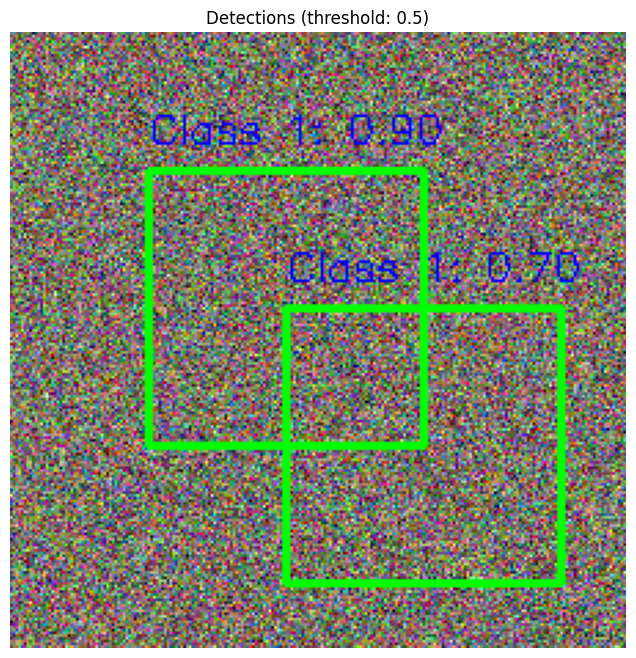

✓ draw_detections test passed!


In [41]:
def test_utility_functions():
    """Test the utility functions with dummy data"""
    print("Testing utility functions...")

    # Test transform_boxes_to_original_size
    print("Testing transform_boxes_to_original_size...")

    # Test with single tensor
    boxes = torch.tensor([[100, 100, 200, 200], [150, 150, 250, 250]], dtype=torch.float32)
    resized_shape = (400, 600)  # H, W
    original_shape = (800, 1200)  # H, W

    transformed_boxes = transform_boxes_to_original_size(boxes, resized_shape, original_shape)
    print(f"Original boxes: {boxes}")
    print(f"Transformed boxes: {transformed_boxes}")

    # Test with list of tensors
    boxes_list = [
        torch.tensor([[100, 100, 200, 200]], dtype=torch.float32),
        torch.tensor([[150, 150, 250, 250], [50, 50, 100, 100]], dtype=torch.float32)
    ]

    transformed_list = transform_boxes_to_original_size(boxes_list, resized_shape, original_shape)
    print(f"List input length: {len(boxes_list)}")
    print(f"List output length: {len(transformed_list)}")

    print("✓ transform_boxes_to_original_size test passed!")

    # Test draw_detections with dummy data
    print("Testing draw_detections...")

    # Create dummy image
    dummy_image = torch.randn(3, 224, 224)
    dummy_detections = {
        'boxes': torch.tensor([[50, 50, 150, 150], [100, 100, 200, 200]], dtype=torch.float32),
        'scores': torch.tensor([0.9, 0.7], dtype=torch.float32),
        'labels': torch.tensor([1, 1], dtype=torch.long)
    }

    try:
        # This will show a plot - you can comment out if running in non-interactive environment
        draw_detections(dummy_image, dummy_detections, threshold=0.5)
        print("✓ draw_detections test passed!")
    except Exception as e:
        print(f"draw_detections test failed (this might be due to display issues): {e}")

    return True

if __name__ == "__main__":
    test_utility_functions()

COMPLETE FASTER R-CNN TEST
1. Testing utility functions...
Testing utility functions...
Testing transform_boxes_to_original_size...
Original boxes: tensor([[100., 100., 200., 200.],
        [150., 150., 250., 250.]])
Transformed boxes: tensor([[200., 200., 400., 400.],
        [300., 300., 500., 500.]])
List input length: 2
List output length: 2
✓ transform_boxes_to_original_size test passed!
Testing draw_detections...
Drawing 2 detections above threshold 0.5


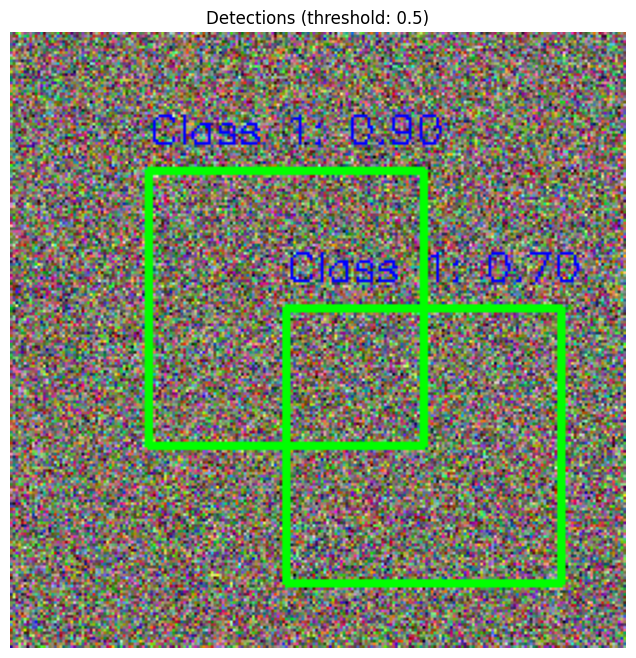

✓ draw_detections test passed!
✓ Utility functions test passed!

2. Testing model inference...
Debug: Features shape: torch.Size([2, 512, 37, 50])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 2 batches, shapes: [torch.Size([2000, 4]), torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections'])
✓ Inference successful!
  - Result type: <class 'dict'>
  - Result keys: dict_keys(['detections'])
  - First image detections: 100 boxes
  - Box transformation test: torch.Size([3, 4]) -> torch.Size([3, 4])

3. Testing model training mode...
Debug: Processed target for 2 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
  Image 1: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([2, 512, 37, 50])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 2 batches, shapes: [torch.Size([2000, 4]), torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['dete

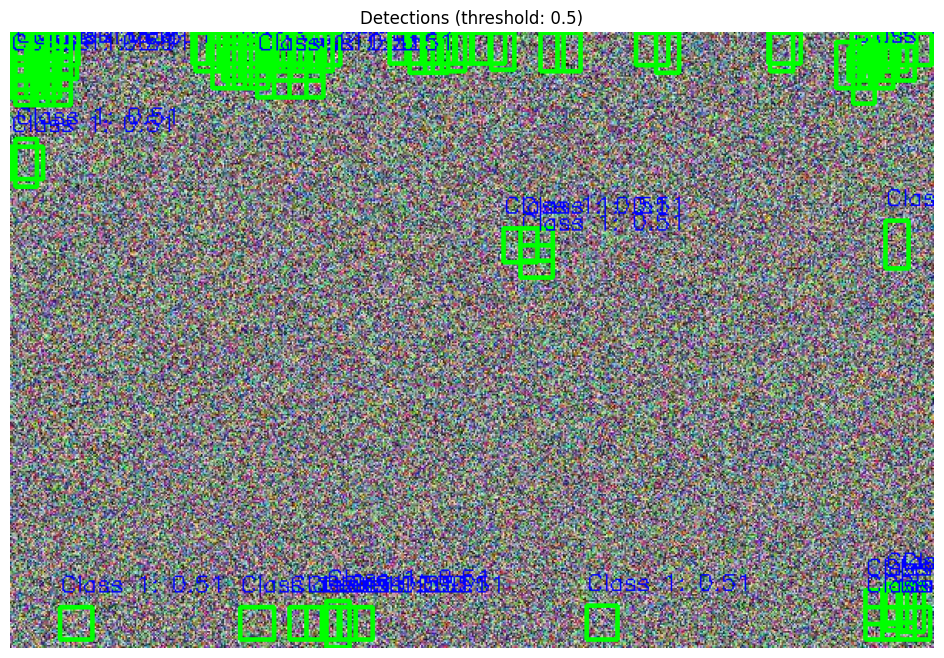

✓ Dummy image test passed!

ALL TESTS COMPLETED SUCCESSFULLY!

Overall test result: PASSED


In [42]:
def complete_faster_rcnn_test():
    """Complete test for FasterRCNN with utilities"""
    print("=" * 60)
    print("COMPLETE FASTER R-CNN TEST")
    print("=" * 60)

    # Model configuration
    model_config = {
        'backbone_out_channels': 512,
        'scales': [8, 16, 32],
        'aspect_ratios': [0.5, 1.0, 2.0],
        'min_im_size': 600,
        'max_im_size': 1000,
        # RPN configuration keys (matching your implementation)
        'rpn_bg_threshold': 0.3,
        'rpn_fg_threshold': 0.7,
        'rpn_nms_threshold': 0.7,
        'rpn_batch_size': 256,
        'rpn_pos_fraction': 0.5,
        'rpn_train_topk': 2000,
        'rpn_test_topk': 1000,
        # Add the missing keys
        'rpn_train_prenms_topk': 12000,
        'rpn_test_prenms_topk': 6000,
        # ROI Head configuration
        'roi_bg_threshold': 0.5, # Note: This key seems unused in the provided ROIHead code
        'roi_fg_threshold': 0.5, # Note: This key seems unused in the provided ROIHead code
        'roi_batch_size': 512,
        'roi_pos_fraction': 0.25,
        'roi_nms_threshold': 0.7,
        'roi_score_threshold': 0.05,
        'roi_topk_detections': 100, # Corrected key name based on ROIHead init
        'roi_pool_size': 7, # Added from ROIHead init
        'fc_inner_dim': 1024, # Added from ROIHead init
        'roi_iou_threshold': 0.5, # Added missing key
        'roi_low_bg_iou': 0.1, # Added missing key
    }
    num_classes = 2  # background + tumor
    model = FasterRCNN(model_config, num_classes)

    # Test 1: Utility functions
    print("1. Testing utility functions...")
    try:
        test_utility_functions()
        print("✓ Utility functions test passed!")
    except Exception as e:
        print(f"✗ Utility functions test failed: {e}")
        return False

    # Test 2: Model inference
    print("\n2. Testing model inference...")
    batch_size = 2
    images = torch.randn(batch_size, 3, 600, 800)  # Different sizes to test

    model.eval()
    try:
        with torch.no_grad():
            result = model(images)

        print(f"✓ Inference successful!")
        print(f"  - Result type: {type(result)}")
        print(f"  - Result keys: {result.keys()}")

        # Test box transformation
        if 'detections' in result:
            detections = result['detections']
            if isinstance(detections, list) and len(detections) > 0:
                det = detections[0]
                if 'boxes' in det and det['boxes'].numel() > 0:
                    print(f"  - First image detections: {det['boxes'].shape[0]} boxes")

                    # Test box transformation
                    original_boxes = det['boxes'][:3]  # Take first 3 boxes
                    transformed = transform_boxes_to_original_size(
                        original_boxes, (600, 800), (1200, 1600)
                    )
                    print(f"  - Box transformation test: {original_boxes.shape} -> {transformed.shape}")

    except Exception as e:
        print(f"✗ Inference test failed: {e}")
        import traceback
        traceback.print_exc()
        return False

    # Test 3: Model training mode
    print("\n3. Testing model training mode...")
    model.train()

    # Create realistic target data
    target = {
        'bboxes': torch.tensor([
            [[150., 150., 300., 300.],
             [400., 200., 550., 400.]],
            [[100., 100., 200., 250.],
             [350., 150., 450., 300.]]
        ], dtype=torch.float32),
        'labels': torch.tensor([
            [1, 1],
            [1, 1]
        ], dtype=torch.long)
    }

    try:
        losses = model(images, target)

        print(f"✓ Training mode successful!")
        print(f"  - Loss keys: {list(losses.keys())}")

        # Verify all losses are proper tensors
        all_tensors = True
        for loss_name, loss_value in losses.items():
            is_tensor = isinstance(loss_value, torch.Tensor)
            has_grad = is_tensor and loss_value.requires_grad
            print(f"  - {loss_name}: {loss_value.item():.4f} (tensor: {is_tensor}, grad: {has_grad})")
            if not is_tensor or not has_grad:
                all_tensors = False

        if not all_tensors:
            print("✗ Some losses are not proper tensors with gradients!")
            return False

        # Test backward pass
        if 'total_loss' in losses:
            print("  - Testing backward pass...")
            losses['total_loss'].backward()
            print("  ✓ Backward pass successful!")

    except Exception as e:
        print(f"✗ Training mode test failed: {e}")
        import traceback
        traceback.print_exc()
        return False

    # Test 4: Integration test with dummy image file
    print("\n4. Testing with dummy image...")
    try:
        # Create a dummy image file
        dummy_image_path = "dummy_test_image.jpg"

        # Create and save dummy image
        from PIL import Image
        import numpy as np

        dummy_img_array = np.random.randint(0, 255, (400, 600, 3), dtype=np.uint8)
        dummy_img = Image.fromarray(dummy_img_array)
        dummy_img.save(dummy_image_path)

        # Test the forward pass function
        result = test_faster_rcnn_forward_pass(model, dummy_image_path)
        print("✓ Dummy image test passed!")

        # Clean up
        import os
        if os.path.exists(dummy_image_path):
            os.remove(dummy_image_path)

    except Exception as e:
        print(f"✗ Dummy image test failed: {e}")
        # Don't fail the whole test for this
        print("  (This test failure might be due to missing dependencies)")

    print("\n" + "=" * 60)
    print("ALL TESTS COMPLETED SUCCESSFULLY!")
    print("=" * 60)
    return True

# Usage example for training loop integration
def example_training_loop_integration(model, dataloader, optimizer, device):
    """
    Example of how to integrate the corrected model into a training loop
    """
    model.train()
    total_loss = 0.0

    for batch_idx, (images, targets) in enumerate(dataloader):
        images = images.to(device)

        # Move targets to device
        for key in targets:
            if isinstance(targets[key], torch.Tensor):
                targets[key] = targets[key].to(device)

        # Zero gradients
        optimizer.zero_grad()

        # Forward pass - now returns losses dictionary
        losses = model(images, targets)

        # Get total loss
        total_loss_batch = losses['total_loss']

        # Backward pass
        total_loss_batch.backward()

        # Update weights
        optimizer.step()

        # Accumulate loss
        total_loss += total_loss_batch.item()

        # Print progress
        if batch_idx % 10 == 0:
            print(f"Batch {batch_idx}, Total Loss: {total_loss_batch.item():.4f}")
            for loss_name, loss_value in losses.items():
                if loss_name != 'total_loss':
                    print(f"  {loss_name}: {loss_value.item():.4f}")

    return total_loss / len(dataloader)

if __name__ == "__main__":
    success = complete_faster_rcnn_test()
    print(f"\nOverall test result: {'PASSED' if success else 'FAILED'}")

# Training

In [44]:
import os
import yaml
import torch
import numpy as np
import random
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import MultiStepLR
from tqdm import tqdm

In [45]:
def train(args):
    # Read the config file #
    with open(args.config_path, 'r') as file:
        try:
            config = yaml.safe_load(file)
        except yaml.YAMLError as exc:
            print(exc)
    print(config)
    ########################

    dataset_config = config['dataset_params']
    model_config = config['model_params']
    train_config = config['train_params']

    # FIX 1: Define device properly
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    seed = train_config['seed']
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)
    if device.type == 'cuda':
        torch.cuda.manual_seed_all(seed)

    tumor_dataset = TumorDataset(
        split='train',
        im_dir=dataset_config['im_train_path'],
        ann_dir=dataset_config['ann_train_path'])

    train_dataloader = DataLoader(tumor_dataset,
                                  batch_size=1,
                                  shuffle=True,
                                  num_workers=2,
                                  collate_fn=lambda batch: tuple(zip(*batch)))

    faster_rcnn_model = FasterRCNN(model_config,
                                   num_classes=dataset_config['num_classes'])
    faster_rcnn_model.train()
    faster_rcnn_model.to(device)

    if not os.path.exists(train_config['task_name']):
        os.mkdir(train_config['task_name'])

    optimizer = torch.optim.SGD(lr=train_config['lr'],
                                params=filter(lambda p: p.requires_grad, faster_rcnn_model.parameters()),
                                weight_decay=5E-4,
                                momentum=0.9)
    scheduler = MultiStepLR(optimizer, milestones=train_config['lr_steps'], gamma=0.1)

    acc_steps = train_config['acc_steps']
    num_epochs = train_config['num_epochs']

    for epoch in range(num_epochs):
        print(f'\nStarting Epoch {epoch + 1}/{num_epochs}')

        rpn_classification_losses = []
        rpn_localization_losses = []
        roi_classification_losses = []
        roi_localization_losses = []

        step_count = 1
        epoch_total_loss = 0.0

        for batch_idx, batch_data in enumerate(tqdm(train_dataloader, desc=f'Epoch {epoch+1}')):
            if len(batch_data) == 3:
                im, target, fname = batch_data
            elif len(batch_data) == 2:
                im, target = batch_data
                fname = [f"batch_{batch_idx}"]
            else:
                raise ValueError(f"Unexpected batch format: got {len(batch_data)} items")

            image_batch = im[0].unsqueeze(0).float().to(device)

            boxes = target[0]['boxes'].float().to(device)
            labels = target[0]['labels'].long().to(device)

            print(f"Debug - Original boxes shape: {boxes.shape}")
            print(f"Debug - Original labels shape: {labels.shape}")

            if boxes.dim() == 1 and len(boxes) == 4:
                boxes = boxes.unsqueeze(0)
            elif boxes.dim() == 2 and boxes.shape[1] != 4:
                raise ValueError(f"Boxes must have shape [N, 4], got {boxes.shape}")
            elif boxes.dim() != 2:
                raise ValueError(f"Boxes must be 2D tensor [N, 4], got shape {boxes.shape}")

            if labels.dim() == 0:
                labels = labels.unsqueeze(0)

            if len(boxes) != len(labels):
                raise ValueError(f"Number of boxes ({len(boxes)}) must match number of labels ({len(labels)})")

            target_batch = {
                'bboxes': boxes.unsqueeze(0),
                'labels': labels.unsqueeze(0)
            }

            print(f"Debug - Final batched boxes shape: {target_batch['bboxes'].shape}")
            print(f"Debug - Final batched labels shape: {target_batch['labels'].shape}")

            output = faster_rcnn_model(image_batch, target_batch)

            rpn_cls_loss = output['rpn_classification_loss']
            rpn_loc_loss = output['rpn_localization_loss']
            roi_cls_loss = output['roi_classification_loss']
            roi_loc_loss = output['roi_localization_loss']
            total_loss = output['total_loss']

            rpn_classification_losses.append(rpn_cls_loss.item())
            rpn_localization_losses.append(rpn_loc_loss.item())
            roi_classification_losses.append(roi_cls_loss.item())
            roi_localization_losses.append(roi_loc_loss.item())

            loss = total_loss / acc_steps
            loss.backward()

            if step_count % acc_steps == 0:
                optimizer.step()
                optimizer.zero_grad()

            step_count += 1
            epoch_total_loss += total_loss.item()

        print(f'Finished epoch {epoch + 1}')

        optimizer.step()
        optimizer.zero_grad()

        checkpoint_path = os.path.join(train_config['task_name'], f"epoch_{epoch+1}_{train_config['ckpt_name']}")
        torch.save(faster_rcnn_model.state_dict(), checkpoint_path)

        avg_rpn_cls = np.mean(rpn_classification_losses)
        avg_rpn_loc = np.mean(rpn_localization_losses)
        avg_roi_cls = np.mean(roi_classification_losses)
        avg_roi_loc = np.mean(roi_localization_losses)
        avg_total = epoch_total_loss / len(train_dataloader)

        loss_output = f'Epoch {epoch+1}/{num_epochs} - '
        loss_output += f'RPN Cls: {avg_rpn_cls:.4f} | '
        loss_output += f'RPN Loc: {avg_rpn_loc:.4f} | '
        loss_output += f'ROI Cls: {avg_roi_cls:.4f} | '
        loss_output += f'ROI Loc: {avg_roi_loc:.4f} | '
        loss_output += f'Total: {avg_total:.4f}'
        print(loss_output)

        scheduler.step()

    print('Done Training...')

    # Save the final model
    final_model_path = os.path.join(train_config['task_name'], f"final_{train_config['ckpt_name']}")
    torch.save(faster_rcnn_model.state_dict(), final_model_path)
    print(f"Final model saved to {final_model_path}")


In [46]:
def test_training_setup():
    """Test case to verify training setup works"""

    # Create a minimal config for testing
    test_config = {
        'dataset_params': {
            'im_train_path': '/content/train/images',
            'ann_train_path': '/content/train/detections',
            'num_classes': 2
        },
        'model_params': {
            'backbone': 'vgg16',
            'pretrained': True
        },
        'train_params': {
            'seed': 42,
            'lr': 0.001,
            'lr_steps': [5, 8],
            'acc_steps': 1,
            'num_epochs': 2,  # Small for testing
            'task_name': 'test_tumor_detection',
            'ckpt_name': 'model.pth'
        }
    }

    # Save test config
    os.makedirs('config', exist_ok=True)
    with open('config/test_tumor.yaml', 'w') as f:
        yaml.dump(test_config, f)

    print("✓ Test config created successfully!")
    print("✓ Training function ready to run!")
    print("Next steps:")
    print("1. Ensure your TumorDataset class is properly implemented")
    print("2. Ensure your FasterRCNN model class is available")
    print("3. Update config paths to your actual data directories")
    print("4. Run: python train.py")

In [47]:
if __name__ == '__main__':
    # Test the setup
    test_training_setup()

    class Args:
        config_path = 'config/tumor.yaml'  # Update with your actual config

    args = Args()
    train(args)

✓ Test config created successfully!
✓ Training function ready to run!
Next steps:
1. Ensure your TumorDataset class is properly implemented
2. Ensure your FasterRCNN model class is available
3. Update config paths to your actual data directories
4. Run: python train.py
{'dataset_params': {'im_train_path': 'train/images', 'ann_train_path': 'train/detections', 'im_test_path': 'val/images', 'ann_test_path': 'val/detections', 'num_classes': 2}, 'model_params': {'im_channels': 3, 'aspect_ratios': [0.5, 1.0, 2.0], 'scales': [64, 128, 256], 'min_im_size': 512, 'max_im_size': 512, 'backbone_out_channels': 512, 'fc_inner_dim': 1024, 'rpn_bg_threshold': 0.3, 'rpn_fg_threshold': 0.7, 'rpn_nms_threshold': 0.7, 'rpn_train_prenms_topk': 12000, 'rpn_test_prenms_topk': 6000, 'rpn_train_topk': 2000, 'rpn_test_topk': 300, 'rpn_batch_size': 256, 'rpn_pos_fraction': 0.5, 'roi_iou_threshold': 0.5, 'roi_low_bg_iou': 0.0, 'roi_pool_size': 7, 'roi_nms_threshold': 0.3, 'roi_topk_detections': 100, 'roi_score_th

100%|██████████| 1832/1832 [00:00<00:00, 4892.29it/s]


Total 1832 images found
Filtered to 1547 training images with annotations

Starting Epoch 1/15


Epoch 1:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 1:   0%|          | 2/1547 [00:03<33:11,  1.29s/it]  

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   0%|          | 5/1547 [00:03<09:37,  2.67it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   0%|          | 7/1547 [00:03<06:17,  4.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   1%|          | 9/1547 [00:03<04:40,  5.49it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   1%|          | 13/1547 [00:04<03:10,  8.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   1%|          | 15/1547 [00:04<02:48,  9.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   1%|          | 17/1547 [00:04<02:34,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   1%|▏         | 21/1547 [00:04<02:19, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:   1%|▏         | 23/1547 [00:04<02:15, 11.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   2%|▏         | 25/1547 [00:05<02:11, 11.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:   2%|▏         | 27/1547 [00:05<02:09, 11.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   2%|▏         | 31/1547 [00:05<02:07, 11.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:   2%|▏         | 33/1547 [00:05<02:07, 11.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   2%|▏         | 35/1547 [00:05<02:05, 12.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   3%|▎         | 39/1547 [00:06<02:02, 12.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   3%|▎         | 41/1547 [00:06<02:02, 12.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   3%|▎         | 43/1547 [00:06<02:02, 12.27it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   3%|▎         | 47/1547 [00:06<02:02, 12.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   3%|▎         | 49/1547 [00:06<02:02, 12.21it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   3%|▎         | 51/1547 [00:07<02:02, 12.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   4%|▎         | 55/1547 [00:07<02:01, 12.26it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   4%|▎         | 57/1547 [00:07<02:02, 12.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   4%|▍         | 59/1547 [00:07<02:03, 12.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   4%|▍         | 61/1547 [00:07<02:01, 12.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   4%|▍         | 65/1547 [00:08<02:03, 11.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   4%|▍         | 67/1547 [00:08<02:07, 11.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   4%|▍         | 69/1547 [00:08<02:09, 11.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   5%|▍         | 71/1547 [00:08<02:11, 11.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   5%|▍         | 75/1547 [00:09<02:10, 11.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   5%|▍         | 77/1547 [00:09<02:10, 11.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   5%|▌         | 79/1547 [00:09<02:11, 11.17it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   5%|▌         | 81/1547 [00:09<02:12, 11.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   5%|▌         | 83/1547 [00:09<02:24, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   6%|▌         | 86/1547 [00:10<02:36,  9.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   6%|▌         | 88/1547 [00:10<02:38,  9.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   6%|▌         | 89/1547 [00:10<02:39,  9.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   6%|▌         | 92/1547 [00:10<02:37,  9.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   6%|▌         | 94/1547 [00:11<02:38,  9.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   6%|▌         | 96/1547 [00:11<02:51,  8.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   6%|▋         | 98/1547 [00:11<03:00,  8.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   6%|▋         | 100/1547 [00:11<02:50,  8.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   7%|▋         | 102/1547 [00:12<02:34,  9.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   7%|▋         | 104/1547 [00:12<02:31,  9.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   7%|▋         | 107/1547 [00:12<02:18, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:   7%|▋         | 109/1547 [00:12<02:11, 10.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   7%|▋         | 111/1547 [00:12<02:07, 11.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   7%|▋         | 113/1547 [00:13<02:06, 11.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   8%|▊         | 117/1547 [00:13<02:01, 11.80it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   8%|▊         | 119/1547 [00:13<02:00, 11.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   8%|▊         | 121/1547 [00:13<02:00, 11.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   8%|▊         | 123/1547 [00:13<02:00, 11.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:   8%|▊         | 127/1547 [00:14<02:04, 11.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   8%|▊         | 129/1547 [00:14<02:10, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   8%|▊         | 131/1547 [00:14<02:06, 11.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   9%|▊         | 133/1547 [00:14<02:06, 11.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   9%|▊         | 135/1547 [00:15<02:03, 11.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   9%|▉         | 139/1547 [00:15<02:00, 11.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   9%|▉         | 141/1547 [00:15<01:59, 11.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:   9%|▉         | 143/1547 [00:15<01:58, 11.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:   9%|▉         | 145/1547 [00:15<01:58, 11.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  10%|▉         | 149/1547 [00:16<01:55, 12.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  10%|▉         | 151/1547 [00:16<01:57, 11.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  10%|▉         | 153/1547 [00:16<02:02, 11.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  10%|█         | 155/1547 [00:16<02:06, 11.00it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 1:  10%|█         | 157/1547 [00:16<02:07, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  10%|█         | 159/1547 [00:17<02:09, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed targe

Epoch 1:  11%|█         | 163/1547 [00:17<02:18, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  11%|█         | 165/1547 [00:17<02:10, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  11%|█         | 167/1547 [00:17<02:05, 11.02it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  11%|█         | 169/1547 [00:18<02:02, 11.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  11%|█         | 173/1547 [00:18<01:57, 11.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  11%|█▏        | 175/1547 [00:18<01:55, 11.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  11%|█▏        | 177/1547 [00:18<01:54, 11.93it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  12%|█▏        | 179/1547 [00:18<01:54, 11.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  12%|█▏        | 183/1547 [00:19<01:53, 12.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  12%|█▏        | 185/1547 [00:19<01:52, 12.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  12%|█▏        | 187/1547 [00:19<01:52, 12.04it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 1:  12%|█▏        | 191/1547 [00:19<01:51, 12.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  13%|█▎        | 195/1547 [00:20<02:11, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  13%|█▎        | 197/1547 [00:20<02:05, 10.75it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 1:  13%|█▎        | 199/1547 [00:20<02:01, 11.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  13%|█▎        | 201/1547 [00:20<01:59, 11.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  13%|█▎        | 203/1547 [00:21<02:09, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  13%|█▎        | 205/1547 [00:21<02:05, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  14%|█▎        | 209/1547 [00:21<01:58, 11.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  14%|█▎        | 211/1547 [00:21<01:56, 11.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  14%|█▍        | 213/1547 [00:21<01:56, 11.43it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  14%|█▍        | 215/1547 [00:22<01:58, 11.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  14%|█▍        | 219/1547 [00:22<01:59, 11.11it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  14%|█▍        | 221/1547 [00:22<01:59, 11.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  14%|█▍        | 223/1547 [00:22<01:58, 11.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  15%|█▍        | 225/1547 [00:22<01:58, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  15%|█▍        | 229/1547 [00:23<01:57, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  15%|█▍        | 231/1547 [00:23<01:59, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  15%|█▌        | 233/1547 [00:23<02:00, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  15%|█▌        | 235/1547 [00:23<01:59, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  15%|█▌        | 239/1547 [00:24<01:59, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  16%|█▌        | 241/1547 [00:24<02:01, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  16%|█▌        | 243/1547 [00:24<02:00, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  16%|█▌        | 245/1547 [00:24<02:00, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  16%|█▌        | 249/1547 [00:25<01:58, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  16%|█▌        | 251/1547 [00:25<01:55, 11.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  16%|█▋        | 253/1547 [00:25<01:52, 11.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  16%|█▋        | 255/1547 [00:25<01:52, 11.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  17%|█▋        | 259/1547 [00:26<01:49, 11.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  17%|█▋        | 261/1547 [00:26<01:48, 11.87it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  17%|█▋        | 263/1547 [00:26<01:48, 11.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  17%|█▋        | 265/1547 [00:26<01:47, 11.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  17%|█▋        | 269/1547 [00:26<01:46, 12.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  18%|█▊        | 271/1547 [00:27<01:45, 12.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  18%|█▊        | 273/1547 [00:27<01:46, 11.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  18%|█▊        | 275/1547 [00:27<01:46, 11.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  18%|█▊        | 279/1547 [00:27<01:46, 11.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  18%|█▊        | 281/1547 [00:27<01:46, 11.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  18%|█▊        | 283/1547 [00:28<01:45, 11.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  19%|█▊        | 287/1547 [00:28<01:42, 12.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  19%|█▊        | 289/1547 [00:28<01:43, 12.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  19%|█▉        | 291/1547 [00:28<01:44, 12.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  19%|█▉        | 293/1547 [00:28<01:45, 11.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  19%|█▉        | 297/1547 [00:29<01:44, 12.00it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  19%|█▉        | 299/1547 [00:29<01:44, 11.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  19%|█▉        | 301/1547 [00:29<01:44, 11.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  20%|█▉        | 303/1547 [00:29<01:45, 11.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  20%|█▉        | 307/1547 [00:30<01:43, 11.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  20%|█▉        | 309/1547 [00:30<01:42, 12.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  20%|██        | 311/1547 [00:30<01:42, 12.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  20%|██        | 313/1547 [00:30<01:42, 12.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  20%|██        | 317/1547 [00:30<01:42, 12.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  21%|██        | 319/1547 [00:31<01:42, 12.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  21%|██        | 321/1547 [00:31<01:41, 12.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  21%|██        | 323/1547 [00:31<01:41, 12.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  21%|██        | 327/1547 [00:31<01:41, 12.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  21%|██▏       | 329/1547 [00:31<01:42, 11.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  21%|██▏       | 331/1547 [00:32<01:41, 11.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  22%|██▏       | 333/1547 [00:32<01:41, 12.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  22%|██▏       | 337/1547 [00:32<01:40, 12.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  22%|██▏       | 339/1547 [00:32<01:40, 12.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  22%|██▏       | 341/1547 [00:32<01:41, 11.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  22%|██▏       | 345/1547 [00:33<01:39, 12.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  22%|██▏       | 347/1547 [00:33<01:39, 12.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  23%|██▎       | 349/1547 [00:33<01:40, 11.97it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  23%|██▎       | 351/1547 [00:33<01:40, 11.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  23%|██▎       | 355/1547 [00:34<01:40, 11.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  23%|██▎       | 357/1547 [00:34<01:39, 11.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  23%|██▎       | 359/1547 [00:34<01:40, 11.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  23%|██▎       | 363/1547 [00:34<01:39, 11.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  24%|██▎       | 365/1547 [00:34<01:39, 11.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  24%|██▎       | 367/1547 [00:35<01:38, 11.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  24%|██▍       | 371/1547 [00:35<01:39, 11.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  24%|██▍       | 373/1547 [00:35<01:41, 11.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  24%|██▍       | 375/1547 [00:35<01:42, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  24%|██▍       | 377/1547 [00:35<01:44, 11.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  25%|██▍       | 381/1547 [00:36<01:44, 11.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  25%|██▍       | 383/1547 [00:36<01:44, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  25%|██▍       | 385/1547 [00:36<01:44, 11.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  25%|██▌       | 387/1547 [00:36<01:45, 11.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  25%|██▌       | 391/1547 [00:37<01:45, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  25%|██▌       | 393/1547 [00:37<01:44, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  26%|██▌       | 395/1547 [00:37<01:43, 11.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  26%|██▌       | 397/1547 [00:37<01:44, 11.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  26%|██▌       | 401/1547 [00:38<01:43, 11.04it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  26%|██▌       | 403/1547 [00:38<01:42, 11.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  26%|██▌       | 405/1547 [00:38<01:42, 11.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  26%|██▋       | 407/1547 [00:38<01:43, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  27%|██▋       | 411/1547 [00:38<01:40, 11.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  27%|██▋       | 413/1547 [00:39<01:39, 11.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  27%|██▋       | 415/1547 [00:39<01:38, 11.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  27%|██▋       | 417/1547 [00:39<01:37, 11.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  27%|██▋       | 421/1547 [00:39<01:35, 11.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  27%|██▋       | 423/1547 [00:39<01:34, 11.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  27%|██▋       | 425/1547 [00:40<01:34, 11.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  28%|██▊       | 427/1547 [00:40<01:34, 11.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  28%|██▊       | 431/1547 [00:40<01:33, 11.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  28%|██▊       | 433/1547 [00:40<01:33, 11.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  28%|██▊       | 435/1547 [00:41<01:33, 11.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  28%|██▊       | 437/1547 [00:41<01:33, 11.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  29%|██▊       | 441/1547 [00:41<01:33, 11.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  29%|██▊       | 443/1547 [00:41<01:32, 11.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  29%|██▉       | 445/1547 [00:41<01:32, 11.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  29%|██▉       | 447/1547 [00:42<01:33, 11.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  29%|██▉       | 451/1547 [00:42<01:33, 11.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  29%|██▉       | 453/1547 [00:42<01:32, 11.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  29%|██▉       | 455/1547 [00:42<01:31, 11.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  30%|██▉       | 457/1547 [00:42<01:33, 11.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  30%|██▉       | 461/1547 [00:43<01:32, 11.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  30%|██▉       | 463/1547 [00:43<01:31, 11.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  30%|███       | 465/1547 [00:43<01:31, 11.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  30%|███       | 467/1547 [00:43<01:32, 11.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  30%|███       | 471/1547 [00:44<01:31, 11.77it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  31%|███       | 473/1547 [00:44<01:31, 11.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  31%|███       | 475/1547 [00:44<01:31, 11.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  31%|███       | 477/1547 [00:44<01:31, 11.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  31%|███       | 481/1547 [00:44<01:31, 11.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  31%|███       | 483/1547 [00:45<01:30, 11.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  31%|███▏      | 485/1547 [00:45<01:29, 11.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  31%|███▏      | 487/1547 [00:45<01:30, 11.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  32%|███▏      | 491/1547 [00:45<01:29, 11.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  32%|███▏      | 493/1547 [00:45<01:29, 11.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  32%|███▏      | 495/1547 [00:46<01:28, 11.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  32%|███▏      | 497/1547 [00:46<01:28, 11.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  32%|███▏      | 501/1547 [00:46<01:28, 11.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  33%|███▎      | 503/1547 [00:46<01:29, 11.70it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  33%|███▎      | 505/1547 [00:46<01:28, 11.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  33%|███▎      | 507/1547 [00:47<01:28, 11.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  33%|███▎      | 511/1547 [00:47<01:28, 11.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  33%|███▎      | 513/1547 [00:47<01:28, 11.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  33%|███▎      | 515/1547 [00:47<01:29, 11.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  33%|███▎      | 517/1547 [00:47<01:29, 11.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  34%|███▎      | 521/1547 [00:48<01:27, 11.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  34%|███▍      | 523/1547 [00:48<01:28, 11.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  34%|███▍      | 525/1547 [00:48<01:27, 11.67it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  34%|███▍      | 527/1547 [00:48<01:28, 11.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  34%|███▍      | 531/1547 [00:49<01:32, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  34%|███▍      | 533/1547 [00:49<01:33, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  35%|███▍      | 535/1547 [00:49<01:32, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1740, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  35%|███▍      | 537/1547 [00:49<01:33, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  35%|███▍      | 541/1547 [00:50<01:31, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  35%|███▌      | 543/1547 [00:50<01:31, 11.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  35%|███▌      | 545/1547 [00:50<01:30, 11.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  35%|███▌      | 547/1547 [00:50<01:30, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  36%|███▌      | 551/1547 [00:51<01:32, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  36%|███▌      | 553/1547 [00:51<01:32, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  36%|███▌      | 555/1547 [00:51<01:31, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  36%|███▌      | 557/1547 [00:51<01:32, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  36%|███▋      | 561/1547 [00:52<01:32, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  36%|███▋      | 563/1547 [00:52<01:33, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  37%|███▋      | 565/1547 [00:52<01:29, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  37%|███▋      | 567/1547 [00:52<01:28, 11.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  37%|███▋      | 571/1547 [00:52<01:25, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  37%|███▋      | 573/1547 [00:53<01:24, 11.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  37%|███▋      | 575/1547 [00:53<01:24, 11.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  37%|███▋      | 577/1547 [00:53<01:23, 11.63it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  38%|███▊      | 581/1547 [00:53<01:22, 11.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  38%|███▊      | 583/1547 [00:53<01:21, 11.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  38%|███▊      | 585/1547 [00:54<01:22, 11.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  38%|███▊      | 587/1547 [00:54<01:22, 11.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  38%|███▊      | 591/1547 [00:54<01:21, 11.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  38%|███▊      | 593/1547 [00:54<01:23, 11.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  38%|███▊      | 595/1547 [00:54<01:22, 11.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  39%|███▊      | 597/1547 [00:55<01:22, 11.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  39%|███▉      | 601/1547 [00:55<01:21, 11.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  39%|███▉      | 603/1547 [00:55<01:21, 11.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  39%|███▉      | 605/1547 [00:55<01:21, 11.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  39%|███▉      | 607/1547 [00:55<01:20, 11.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  39%|███▉      | 611/1547 [00:56<01:19, 11.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  40%|███▉      | 613/1547 [00:56<01:19, 11.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  40%|███▉      | 615/1547 [00:56<01:19, 11.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  40%|███▉      | 617/1547 [00:56<01:20, 11.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  40%|████      | 621/1547 [00:57<01:18, 11.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  40%|████      | 623/1547 [00:57<01:17, 11.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  40%|████      | 625/1547 [00:57<01:18, 11.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  41%|████      | 629/1547 [00:57<01:17, 11.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 1:  41%|████      | 631/1547 [00:58<01:18, 11.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  41%|████      | 633/1547 [00:58<01:17, 11.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  41%|████      | 635/1547 [00:58<01:18, 11.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  41%|████▏     | 639/1547 [00:58<01:17, 11.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  41%|████▏     | 641/1547 [00:58<01:18, 11.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  42%|████▏     | 643/1547 [00:59<01:18, 11.55it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  42%|████▏     | 645/1547 [00:59<01:18, 11.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  42%|████▏     | 649/1547 [00:59<01:16, 11.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  42%|████▏     | 651/1547 [00:59<01:16, 11.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  42%|████▏     | 653/1547 [00:59<01:16, 11.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  42%|████▏     | 657/1547 [01:00<01:15, 11.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  43%|████▎     | 659/1547 [01:00<01:16, 11.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  43%|████▎     | 661/1547 [01:00<01:16, 11.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  43%|████▎     | 663/1547 [01:00<01:16, 11.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  43%|████▎     | 667/1547 [01:01<01:14, 11.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  43%|████▎     | 669/1547 [01:01<01:15, 11.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  43%|████▎     | 671/1547 [01:01<01:14, 11.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  44%|████▎     | 673/1547 [01:01<01:15, 11.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  44%|████▍     | 677/1547 [01:01<01:14, 11.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  44%|████▍     | 679/1547 [01:02<01:15, 11.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  44%|████▍     | 681/1547 [01:02<01:16, 11.36it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  44%|████▍     | 683/1547 [01:02<01:18, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  44%|████▍     | 687/1547 [01:02<01:18, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  45%|████▍     | 689/1547 [01:03<01:19, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  45%|████▍     | 691/1547 [01:03<01:19, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  45%|████▍     | 693/1547 [01:03<01:19, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  45%|████▌     | 697/1547 [01:03<01:18, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  45%|████▌     | 699/1547 [01:04<01:18, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  45%|████▌     | 701/1547 [01:04<01:18, 10.84it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  45%|████▌     | 703/1547 [01:04<01:17, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  46%|████▌     | 707/1547 [01:04<01:17, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  46%|████▌     | 709/1547 [01:04<01:18, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  46%|████▌     | 711/1547 [01:05<01:18, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  46%|████▌     | 713/1547 [01:05<01:17, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  46%|████▋     | 717/1547 [01:05<01:17, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  46%|████▋     | 719/1547 [01:05<01:16, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  47%|████▋     | 721/1547 [01:06<01:13, 11.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  47%|████▋     | 723/1547 [01:06<01:14, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  47%|████▋     | 727/1547 [01:06<01:11, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  47%|████▋     | 729/1547 [01:06<01:11, 11.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  47%|████▋     | 731/1547 [01:06<01:10, 11.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  47%|████▋     | 733/1547 [01:07<01:10, 11.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  48%|████▊     | 737/1547 [01:07<01:09, 11.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  48%|████▊     | 739/1547 [01:07<01:09, 11.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  48%|████▊     | 741/1547 [01:07<01:08, 11.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  48%|████▊     | 743/1547 [01:07<01:08, 11.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  48%|████▊     | 747/1547 [01:08<01:08, 11.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  48%|████▊     | 749/1547 [01:08<01:08, 11.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  49%|████▊     | 751/1547 [01:08<01:08, 11.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  49%|████▊     | 753/1547 [01:08<01:08, 11.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  49%|████▉     | 757/1547 [01:09<01:07, 11.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  49%|████▉     | 759/1547 [01:09<01:08, 11.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  49%|████▉     | 761/1547 [01:09<01:07, 11.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  49%|████▉     | 763/1547 [01:09<01:08, 11.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  50%|████▉     | 767/1547 [01:09<01:07, 11.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  50%|████▉     | 769/1547 [01:10<01:07, 11.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  50%|████▉     | 771/1547 [01:10<01:07, 11.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  50%|████▉     | 773/1547 [01:10<01:07, 11.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  50%|█████     | 777/1547 [01:10<01:06, 11.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  50%|█████     | 779/1547 [01:11<01:06, 11.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  50%|█████     | 781/1547 [01:11<01:05, 11.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  51%|█████     | 783/1547 [01:11<01:06, 11.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  51%|█████     | 787/1547 [01:11<01:05, 11.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  51%|█████     | 789/1547 [01:11<01:06, 11.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  51%|█████     | 791/1547 [01:12<01:05, 11.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  51%|█████▏    | 793/1547 [01:12<01:06, 11.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  52%|█████▏    | 797/1547 [01:12<01:05, 11.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  52%|█████▏    | 799/1547 [01:12<01:04, 11.55it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  52%|█████▏    | 801/1547 [01:12<01:04, 11.54it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  52%|█████▏    | 803/1547 [01:13<01:04, 11.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  52%|█████▏    | 807/1547 [01:13<01:04, 11.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  52%|█████▏    | 809/1547 [01:13<01:04, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  52%|█████▏    | 811/1547 [01:13<01:04, 11.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  53%|█████▎    | 813/1547 [01:13<01:03, 11.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  53%|█████▎    | 817/1547 [01:14<01:02, 11.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  53%|█████▎    | 819/1547 [01:14<01:02, 11.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  53%|█████▎    | 821/1547 [01:14<01:02, 11.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  53%|█████▎    | 823/1547 [01:14<01:02, 11.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  53%|█████▎    | 827/1547 [01:15<01:02, 11.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  54%|█████▎    | 829/1547 [01:15<01:02, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  54%|█████▎    | 831/1547 [01:15<01:03, 11.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 1:  54%|█████▍    | 833/1547 [01:15<01:02, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  54%|█████▍    | 837/1547 [01:16<01:04, 11.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  54%|█████▍    | 839/1547 [01:16<01:05, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  54%|█████▍    | 841/1547 [01:16<01:04, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  54%|█████▍    | 843/1547 [01:16<01:05, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  55%|█████▍    | 847/1547 [01:17<01:04, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  55%|█████▍    | 849/1547 [01:17<01:05, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  55%|█████▌    | 851/1547 [01:17<01:05, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  55%|█████▌    | 853/1547 [01:17<01:06, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  55%|█████▌    | 855/1547 [01:17<01:06, 10.48it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 1:  56%|█████▌    | 859/1547 [01:18<01:04, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  56%|█████▌    | 861/1547 [01:18<01:04, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  56%|█████▌    | 863/1547 [01:18<01:05, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  56%|█████▌    | 865/1547 [01:18<01:06, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  56%|█████▌    | 867/1547 [01:18<01:06, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  56%|█████▋    | 871/1547 [01:19<01:04, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  56%|█████▋    | 873/1547 [01:19<01:02, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  57%|█████▋    | 875/1547 [01:19<01:00, 11.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  57%|█████▋    | 877/1547 [01:19<01:00, 11.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  57%|█████▋    | 881/1547 [01:20<00:58, 11.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  57%|█████▋    | 883/1547 [01:20<00:58, 11.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  57%|█████▋    | 885/1547 [01:20<00:57, 11.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  57%|█████▋    | 887/1547 [01:20<00:57, 11.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  58%|█████▊    | 891/1547 [01:21<00:57, 11.47it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  58%|█████▊    | 893/1547 [01:21<00:56, 11.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  58%|█████▊    | 895/1547 [01:21<00:56, 11.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  58%|█████▊    | 897/1547 [01:21<00:56, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  58%|█████▊    | 901/1547 [01:21<00:56, 11.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  58%|█████▊    | 903/1547 [01:22<00:56, 11.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  59%|█████▊    | 905/1547 [01:22<00:55, 11.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  59%|█████▊    | 907/1547 [01:22<00:55, 11.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  59%|█████▉    | 911/1547 [01:22<00:55, 11.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  59%|█████▉    | 913/1547 [01:22<00:55, 11.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  59%|█████▉    | 915/1547 [01:23<00:55, 11.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  59%|█████▉    | 917/1547 [01:23<00:55, 11.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  60%|█████▉    | 921/1547 [01:23<00:54, 11.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  60%|█████▉    | 923/1547 [01:23<00:54, 11.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  60%|█████▉    | 925/1547 [01:24<00:54, 11.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  60%|█████▉    | 927/1547 [01:24<00:54, 11.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  60%|██████    | 931/1547 [01:24<00:53, 11.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  60%|██████    | 933/1547 [01:24<00:53, 11.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  60%|██████    | 935/1547 [01:24<00:53, 11.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  61%|██████    | 937/1547 [01:25<00:54, 11.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  61%|██████    | 941/1547 [01:25<00:53, 11.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  61%|██████    | 943/1547 [01:25<00:53, 11.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  61%|██████    | 945/1547 [01:25<00:53, 11.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  61%|██████    | 947/1547 [01:25<00:53, 11.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  61%|██████▏   | 951/1547 [01:26<00:52, 11.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  62%|██████▏   | 953/1547 [01:26<00:52, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  62%|██████▏   | 955/1547 [01:26<00:51, 11.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  62%|██████▏   | 957/1547 [01:26<00:51, 11.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  62%|██████▏   | 961/1547 [01:27<00:51, 11.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  62%|██████▏   | 963/1547 [01:27<00:51, 11.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  62%|██████▏   | 965/1547 [01:27<00:51, 11.26it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  63%|██████▎   | 967/1547 [01:27<00:51, 11.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  63%|██████▎   | 971/1547 [01:28<00:50, 11.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  63%|██████▎   | 973/1547 [01:28<00:49, 11.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  63%|██████▎   | 975/1547 [01:28<00:49, 11.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  63%|██████▎   | 977/1547 [01:28<00:49, 11.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  63%|██████▎   | 981/1547 [01:28<00:49, 11.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  64%|██████▎   | 983/1547 [01:29<00:50, 11.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  64%|██████▎   | 985/1547 [01:29<00:49, 11.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  64%|██████▍   | 987/1547 [01:29<00:50, 11.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  64%|██████▍   | 991/1547 [01:29<00:51, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  64%|██████▍   | 993/1547 [01:30<00:51, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  64%|██████▍   | 995/1547 [01:30<00:52, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  64%|██████▍   | 997/1547 [01:30<00:51, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  65%|██████▍   | 1001/1547 [01:30<00:50, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  65%|██████▍   | 1003/1547 [01:31<00:50, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  65%|██████▍   | 1005/1547 [01:31<00:50, 10.82it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  65%|██████▌   | 1007/1547 [01:31<00:50, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  65%|██████▌   | 1011/1547 [01:31<00:49, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  65%|██████▌   | 1013/1547 [01:31<00:49, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  66%|██████▌   | 1015/1547 [01:32<00:50, 10.58it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  66%|██████▌   | 1017/1547 [01:32<00:49, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  66%|██████▌   | 1019/1547 [01:32<00:51, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  66%|██████▌   | 1023/1547 [01:32<00:50, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  66%|██████▋   | 1025/1547 [01:33<00:48, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  66%|██████▋   | 1027/1547 [01:33<00:47, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  67%|██████▋   | 1029/1547 [01:33<00:46, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  67%|██████▋   | 1033/1547 [01:33<00:45, 11.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  67%|██████▋   | 1035/1547 [01:33<00:45, 11.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  67%|██████▋   | 1037/1547 [01:34<00:44, 11.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  67%|██████▋   | 1039/1547 [01:34<00:44, 11.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  67%|██████▋   | 1043/1547 [01:34<00:44, 11.44it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  68%|██████▊   | 1045/1547 [01:34<00:43, 11.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  68%|██████▊   | 1047/1547 [01:34<00:43, 11.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  68%|██████▊   | 1049/1547 [01:35<00:43, 11.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  68%|██████▊   | 1053/1547 [01:35<00:43, 11.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  68%|██████▊   | 1055/1547 [01:35<00:42, 11.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  68%|██████▊   | 1057/1547 [01:35<00:42, 11.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  68%|██████▊   | 1059/1547 [01:36<00:42, 11.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  69%|██████▊   | 1061/1547 [01:36<00:46, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  69%|██████▊   | 1063/1547 [01:36<00:53,  9.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  69%|██████▉   | 1065/1547 [01:36<00:54,  8.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  69%|██████▉   | 1067/1547 [01:36<00:49,  9.60it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  69%|██████▉   | 1069/1547 [01:37<00:47, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  69%|██████▉   | 1071/1547 [01:37<00:45, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  69%|██████▉   | 1075/1547 [01:37<00:43, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  70%|██████▉   | 1077/1547 [01:37<00:42, 11.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  70%|██████▉   | 1079/1547 [01:38<00:41, 11.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  70%|██████▉   | 1081/1547 [01:38<00:41, 11.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  70%|███████   | 1085/1547 [01:38<00:40, 11.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  70%|███████   | 1087/1547 [01:38<00:40, 11.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  70%|███████   | 1089/1547 [01:38<00:40, 11.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  71%|███████   | 1091/1547 [01:39<00:40, 11.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  71%|███████   | 1095/1547 [01:39<00:39, 11.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  71%|███████   | 1097/1547 [01:39<00:39, 11.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  71%|███████   | 1099/1547 [01:39<00:39, 11.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  71%|███████   | 1101/1547 [01:39<00:39, 11.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  71%|███████▏  | 1105/1547 [01:40<00:38, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  72%|███████▏  | 1107/1547 [01:40<00:38, 11.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  72%|███████▏  | 1109/1547 [01:40<00:38, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  72%|███████▏  | 1111/1547 [01:40<00:38, 11.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  72%|███████▏  | 1115/1547 [01:41<00:37, 11.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  72%|███████▏  | 1117/1547 [01:41<00:37, 11.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  72%|███████▏  | 1119/1547 [01:41<00:37, 11.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  72%|███████▏  | 1121/1547 [01:41<00:37, 11.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  73%|███████▎  | 1125/1547 [01:42<00:37, 11.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  73%|███████▎  | 1127/1547 [01:42<00:37, 11.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  73%|███████▎  | 1129/1547 [01:42<00:36, 11.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  73%|███████▎  | 1131/1547 [01:42<00:36, 11.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  73%|███████▎  | 1135/1547 [01:42<00:36, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  73%|███████▎  | 1137/1547 [01:43<00:37, 11.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  74%|███████▎  | 1139/1547 [01:43<00:37, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  74%|███████▍  | 1141/1547 [01:43<00:37, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  74%|███████▍  | 1145/1547 [01:43<00:38, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  74%|███████▍  | 1147/1547 [01:44<00:38, 10.39it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1703, 4])]
Debug

Epoch 1:  74%|███████▍  | 1149/1547 [01:44<00:38, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  74%|███████▍  | 1151/1547 [01:44<00:38, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  75%|███████▍  | 1153/1547 [01:44<00:37, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  75%|███████▍  | 1155/1547 [01:44<00:37, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  75%|███████▍  | 1159/1547 [01:45<00:37, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1828, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  75%|███████▌  | 1161/1547 [01:45<00:37, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  75%|███████▌  | 1163/1547 [01:45<00:37, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  75%|███████▌  | 1165/1547 [01:45<00:36, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  75%|███████▌  | 1167/1547 [01:46<00:37, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  76%|███████▌  | 1169/1547 [01:46<00:37, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  76%|███████▌  | 1173/1547 [01:46<00:35, 10.41it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  76%|███████▌  | 1175/1547 [01:46<00:34, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  76%|███████▌  | 1177/1547 [01:46<00:34, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  76%|███████▌  | 1179/1547 [01:47<00:33, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  76%|███████▋  | 1183/1547 [01:47<00:32, 11.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  77%|███████▋  | 1185/1547 [01:47<00:32, 11.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  77%|███████▋  | 1187/1547 [01:47<00:31, 11.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  77%|███████▋  | 1189/1547 [01:48<00:32, 11.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  77%|███████▋  | 1193/1547 [01:48<00:31, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  77%|███████▋  | 1195/1547 [01:48<00:31, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  77%|███████▋  | 1197/1547 [01:48<00:31, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  78%|███████▊  | 1199/1547 [01:48<00:31, 11.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  78%|███████▊  | 1203/1547 [01:49<00:30, 11.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  78%|███████▊  | 1205/1547 [01:49<00:30, 11.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1013, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  78%|███████▊  | 1207/1547 [01:49<00:29, 11.40it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  78%|███████▊  | 1209/1547 [01:49<00:30, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  78%|███████▊  | 1213/1547 [01:50<00:29, 11.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  79%|███████▊  | 1215/1547 [01:50<00:29, 11.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  79%|███████▊  | 1217/1547 [01:50<00:29, 11.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  79%|███████▉  | 1219/1547 [01:50<00:29, 11.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  79%|███████▉  | 1223/1547 [01:51<00:28, 11.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  79%|███████▉  | 1225/1547 [01:51<00:28, 11.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  79%|███████▉  | 1227/1547 [01:51<00:28, 11.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  79%|███████▉  | 1229/1547 [01:51<00:28, 11.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  80%|███████▉  | 1233/1547 [01:51<00:27, 11.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  80%|███████▉  | 1235/1547 [01:52<00:27, 11.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  80%|███████▉  | 1237/1547 [01:52<00:27, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  80%|████████  | 1239/1547 [01:52<00:27, 11.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  80%|████████  | 1243/1547 [01:52<00:26, 11.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  80%|████████  | 1245/1547 [01:53<00:27, 11.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  81%|████████  | 1247/1547 [01:53<00:26, 11.18it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  81%|████████  | 1249/1547 [01:53<00:26, 11.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  81%|████████  | 1253/1547 [01:53<00:25, 11.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  81%|████████  | 1255/1547 [01:53<00:25, 11.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  81%|████████▏ | 1257/1547 [01:54<00:25, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  81%|████████▏ | 1259/1547 [01:54<00:25, 11.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  82%|████████▏ | 1263/1547 [01:54<00:25, 11.35it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  82%|████████▏ | 1265/1547 [01:54<00:24, 11.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  82%|████████▏ | 1267/1547 [01:54<00:24, 11.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  82%|████████▏ | 1269/1547 [01:55<00:24, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  82%|████████▏ | 1273/1547 [01:55<00:24, 11.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  82%|████████▏ | 1275/1547 [01:55<00:24, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  83%|████████▎ | 1277/1547 [01:55<00:24, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  83%|████████▎ | 1279/1547 [01:56<00:23, 11.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  83%|████████▎ | 1283/1547 [01:56<00:23, 11.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  83%|████████▎ | 1285/1547 [01:56<00:23, 11.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  83%|████████▎ | 1287/1547 [01:56<00:23, 11.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  83%|████████▎ | 1289/1547 [01:56<00:23, 11.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1905, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  84%|████████▎ | 1293/1547 [01:57<00:23, 10.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1022, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  84%|████████▎ | 1295/1547 [01:57<00:23, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  84%|████████▍ | 1297/1547 [01:57<00:23, 10.50it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  84%|████████▍ | 1299/1547 [01:57<00:23, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  84%|████████▍ | 1301/1547 [01:58<00:23, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  84%|████████▍ | 1305/1547 [01:58<00:22, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  84%|████████▍ | 1307/1547 [01:58<00:22, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  85%|████████▍ | 1309/1547 [01:58<00:22, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  85%|████████▍ | 1311/1547 [01:59<00:22, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  85%|████████▍ | 1313/1547 [01:59<00:22, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  85%|████████▌ | 1317/1547 [01:59<00:21, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  85%|████████▌ | 1319/1547 [01:59<00:21, 10.39it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 1:  85%|████████▌ | 1321/1547 [01:59<00:21, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  86%|████████▌ | 1323/1547 [02:00<00:21, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  86%|████████▌ | 1325/1547 [02:00<00:20, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  86%|████████▌ | 1329/1547 [02:00<00:19, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  86%|████████▌ | 1331/1547 [02:00<00:19, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  86%|████████▌ | 1333/1547 [02:01<00:19, 11.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  86%|████████▋ | 1335/1547 [02:01<00:18, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  87%|████████▋ | 1339/1547 [02:01<00:18, 11.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  87%|████████▋ | 1341/1547 [02:01<00:18, 11.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  87%|████████▋ | 1343/1547 [02:01<00:18, 11.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  87%|████████▋ | 1345/1547 [02:02<00:18, 11.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  87%|████████▋ | 1349/1547 [02:02<00:17, 11.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  87%|████████▋ | 1351/1547 [02:02<00:17, 11.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  87%|████████▋ | 1353/1547 [02:02<00:17, 11.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  88%|████████▊ | 1355/1547 [02:03<00:17, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  88%|████████▊ | 1359/1547 [02:03<00:16, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  88%|████████▊ | 1361/1547 [02:03<00:16, 11.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  88%|████████▊ | 1363/1547 [02:03<00:16, 11.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  88%|████████▊ | 1365/1547 [02:03<00:16, 11.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  88%|████████▊ | 1369/1547 [02:04<00:15, 11.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  89%|████████▊ | 1371/1547 [02:04<00:15, 11.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  89%|████████▉ | 1373/1547 [02:04<00:15, 11.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  89%|████████▉ | 1375/1547 [02:04<00:15, 11.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  89%|████████▉ | 1379/1547 [02:05<00:14, 11.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  89%|████████▉ | 1381/1547 [02:05<00:14, 11.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1328, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  89%|████████▉ | 1383/1547 [02:05<00:14, 11.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  90%|████████▉ | 1385/1547 [02:05<00:14, 11.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  90%|████████▉ | 1389/1547 [02:06<00:14, 11.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1024, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  90%|████████▉ | 1391/1547 [02:06<00:13, 11.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  90%|█████████ | 1393/1547 [02:06<00:13, 11.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 1:  90%|█████████ | 1395/1547 [02:06<00:13, 11.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  90%|█████████ | 1399/1547 [02:06<00:13, 11.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  91%|█████████ | 1401/1547 [02:07<00:12, 11.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  91%|█████████ | 1403/1547 [02:07<00:12, 11.31it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  91%|█████████ | 1405/1547 [02:07<00:12, 11.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  91%|█████████ | 1409/1547 [02:07<00:12, 11.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  91%|█████████ | 1411/1547 [02:07<00:12, 11.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  91%|█████████▏| 1413/1547 [02:08<00:11, 11.34it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  91%|█████████▏| 1415/1547 [02:08<00:11, 11.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  92%|█████████▏| 1419/1547 [02:08<00:11, 11.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  92%|█████████▏| 1421/1547 [02:08<00:11, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  92%|█████████▏| 1423/1547 [02:09<00:10, 11.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  92%|█████████▏| 1425/1547 [02:09<00:10, 11.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  92%|█████████▏| 1429/1547 [02:09<00:10, 11.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  93%|█████████▎| 1431/1547 [02:09<00:10, 11.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  93%|█████████▎| 1433/1547 [02:09<00:10, 11.29it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  93%|█████████▎| 1435/1547 [02:10<00:10, 11.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  93%|█████████▎| 1439/1547 [02:10<00:09, 11.25it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  93%|█████████▎| 1441/1547 [02:10<00:09, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  93%|█████████▎| 1443/1547 [02:10<00:09, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  93%|█████████▎| 1445/1547 [02:11<00:09, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  94%|█████████▎| 1447/1547 [02:11<00:09, 10.56it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  94%|█████████▍| 1451/1547 [02:11<00:09, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  94%|█████████▍| 1453/1547 [02:11<00:08, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  94%|█████████▍| 1455/1547 [02:11<00:08, 10.51it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  94%|█████████▍| 1457/1547 [02:12<00:08, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  94%|█████████▍| 1461/1547 [02:12<00:08, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  95%|█████████▍| 1463/1547 [02:12<00:07, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  95%|█████████▍| 1465/1547 [02:12<00:07, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  95%|█████████▍| 1467/1547 [02:13<00:07, 10.40it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1959, 4])]
Debug

Epoch 1:  95%|█████████▍| 1469/1547 [02:13<00:07, 10.20it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 1:  95%|█████████▌| 1471/1547 [02:13<00:07, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  95%|█████████▌| 1475/1547 [02:13<00:06, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  95%|█████████▌| 1477/1547 [02:14<00:06, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  96%|█████████▌| 1479/1547 [02:14<00:06, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 1:  96%|█████████▌| 1481/1547 [02:14<00:06, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 1:  96%|█████████▌| 1483/1547 [02:14<00:05, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  96%|█████████▌| 1487/1547 [02:14<00:05, 11.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  96%|█████████▋| 1489/1547 [02:15<00:05, 11.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  96%|█████████▋| 1491/1547 [02:15<00:05, 11.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  97%|█████████▋| 1493/1547 [02:15<00:04, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  97%|█████████▋| 1497/1547 [02:15<00:04, 11.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  97%|█████████▋| 1499/1547 [02:16<00:04, 11.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  97%|█████████▋| 1501/1547 [02:16<00:04, 11.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  97%|█████████▋| 1503/1547 [02:16<00:03, 11.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  97%|█████████▋| 1507/1547 [02:16<00:03, 11.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  98%|█████████▊| 1509/1547 [02:16<00:03, 11.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  98%|█████████▊| 1511/1547 [02:17<00:03, 11.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  98%|█████████▊| 1513/1547 [02:17<00:02, 11.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 1:  98%|█████████▊| 1517/1547 [02:17<00:02, 11.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  98%|█████████▊| 1519/1547 [02:17<00:02, 11.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  98%|█████████▊| 1521/1547 [02:17<00:02, 11.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  98%|█████████▊| 1523/1547 [02:18<00:02, 11.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  99%|█████████▊| 1527/1547 [02:18<00:01, 11.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  99%|█████████▉| 1529/1547 [02:18<00:01, 11.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  99%|█████████▉| 1531/1547 [02:18<00:01, 11.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  99%|█████████▉| 1533/1547 [02:19<00:01, 11.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1:  99%|█████████▉| 1537/1547 [02:19<00:00, 11.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1:  99%|█████████▉| 1539/1547 [02:19<00:00, 11.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1: 100%|█████████▉| 1541/1547 [02:19<00:00, 11.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1: 100%|█████████▉| 1543/1547 [02:19<00:00, 11.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 1: 100%|██████████| 1547/1547 [02:20<00:00, 11.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 1: 100%|██████████| 1547/1547 [02:20<00:00, 11.02it/s]


Finished epoch 1
Epoch 1/15 - RPN Cls: 0.0795 | RPN Loc: 2.7140 | ROI Cls: 0.0801 | ROI Loc: 0.0079 | Total: 2.8815

Starting Epoch 2/15


Epoch 2:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 2:   0%|          | 1/1547 [00:00<05:33,  4.64it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   0%|          | 3/1547 [00:00<03:09,  8.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   0%|          | 5/1547 [00:00<02:42,  9.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 2:   0%|          | 7/1547 [00:00<02:31, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   1%|          | 9/1547 [00:00<02:28, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   1%|          | 11/1547 [00:01<02:23, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 2:   1%|          | 13/1547 [00:01<02:22, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   1%|          | 15/1547 [00:01<02:19, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 2:   1%|          | 17/1547 [00:01<02:18, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   1%|          | 19/1547 [00:01<02:19, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   1%|▏         | 21/1547 [00:02<02:19, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   1%|▏         | 23/1547 [00:02<02:19, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   2%|▏         | 25/1547 [00:02<02:17, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 2:   2%|▏         | 27/1547 [00:02<02:16, 11.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   2%|▏         | 29/1547 [00:02<02:16, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   2%|▏         | 31/1547 [00:02<02:16, 11.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   2%|▏         | 33/1547 [00:03<02:18, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   2%|▏         | 35/1547 [00:03<02:17, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 2:   2%|▏         | 37/1547 [00:03<02:15, 11.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   3%|▎         | 39/1547 [00:03<02:15, 11.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   3%|▎         | 41/1547 [00:03<02:20, 10.69it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:   3%|▎         | 43/1547 [00:04<02:26, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   3%|▎         | 45/1547 [00:04<02:26, 10.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:   3%|▎         | 47/1547 [00:04<02:26, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   3%|▎         | 49/1547 [00:04<02:24, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 2:   3%|▎         | 51/1547 [00:04<02:24, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1779, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   3%|▎         | 53/1547 [00:05<02:26, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   4%|▎         | 55/1547 [00:05<02:29,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   4%|▎         | 56/1547 [00:05<02:29,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   4%|▍         | 60/1547 [00:05<02:24, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   4%|▍         | 62/1547 [00:05<02:24, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   4%|▍         | 64/1547 [00:06<02:27, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:   4%|▍         | 66/1547 [00:06<02:29,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:   4%|▍         | 68/1547 [00:06<02:30,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:   5%|▍         | 70/1547 [00:06<02:26, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:   5%|▍         | 72/1547 [00:06<02:24, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   5%|▍         | 74/1547 [00:07<02:24, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   5%|▍         | 76/1547 [00:07<02:25, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:   5%|▌         | 80/1547 [00:07<02:23, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:   5%|▌         | 82/1547 [00:07<02:19, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   5%|▌         | 84/1547 [00:08<02:17, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   6%|▌         | 86/1547 [00:08<02:15, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   6%|▌         | 90/1547 [00:08<02:12, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   6%|▌         | 92/1547 [00:08<02:11, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   6%|▌         | 94/1547 [00:08<02:10, 11.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   6%|▌         | 96/1547 [00:09<02:10, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   6%|▋         | 100/1547 [00:09<02:09, 11.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   7%|▋         | 102/1547 [00:09<02:09, 11.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   7%|▋         | 104/1547 [00:09<02:08, 11.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   7%|▋         | 106/1547 [00:10<02:09, 11.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   7%|▋         | 110/1547 [00:10<02:07, 11.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   7%|▋         | 112/1547 [00:10<02:08, 11.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   7%|▋         | 114/1547 [00:10<02:08, 11.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1533, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   7%|▋         | 116/1547 [00:10<02:08, 11.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   8%|▊         | 120/1547 [00:11<02:08, 11.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   8%|▊         | 122/1547 [00:11<02:08, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   8%|▊         | 124/1547 [00:11<02:08, 11.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   8%|▊         | 126/1547 [00:11<02:07, 11.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   8%|▊         | 130/1547 [00:12<02:06, 11.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1484, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   9%|▊         | 132/1547 [00:12<02:06, 11.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   9%|▊         | 134/1547 [00:12<02:06, 11.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   9%|▉         | 136/1547 [00:12<02:06, 11.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   9%|▉         | 140/1547 [00:13<02:05, 11.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   9%|▉         | 142/1547 [00:13<02:06, 11.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:   9%|▉         | 144/1547 [00:13<02:05, 11.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:   9%|▉         | 146/1547 [00:13<02:06, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  10%|▉         | 150/1547 [00:13<02:04, 11.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  10%|▉         | 152/1547 [00:14<02:05, 11.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  10%|▉         | 154/1547 [00:14<02:04, 11.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  10%|█         | 156/1547 [00:14<02:04, 11.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  10%|█         | 160/1547 [00:14<02:04, 11.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1094, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  10%|█         | 162/1547 [00:15<02:04, 11.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  11%|█         | 164/1547 [00:15<02:04, 11.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  11%|█         | 166/1547 [00:15<02:03, 11.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  11%|█         | 170/1547 [00:15<02:02, 11.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  11%|█         | 172/1547 [00:15<02:03, 11.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  11%|█         | 174/1547 [00:16<02:03, 11.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  11%|█▏        | 176/1547 [00:16<02:03, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1084, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  12%|█▏        | 180/1547 [00:16<02:03, 11.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  12%|█▏        | 182/1547 [00:16<02:02, 11.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  12%|█▏        | 184/1547 [00:17<02:02, 11.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  12%|█▏        | 186/1547 [00:17<02:02, 11.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  12%|█▏        | 190/1547 [00:17<02:02, 11.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  12%|█▏        | 192/1547 [00:17<02:03, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  13%|█▎        | 194/1547 [00:17<02:06, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  13%|█▎        | 196/1547 [00:18<02:09, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  13%|█▎        | 198/1547 [00:18<02:07, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  13%|█▎        | 202/1547 [00:18<02:06, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  13%|█▎        | 204/1547 [00:18<02:08, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  13%|█▎        | 206/1547 [00:19<02:09, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 2:  13%|█▎        | 208/1547 [00:19<02:09, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  14%|█▎        | 210/1547 [00:19<02:08, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  14%|█▎        | 212/1547 [00:19<02:10, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  14%|█▍        | 216/1547 [00:20<02:08, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  14%|█▍        | 218/1547 [00:20<02:07, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  14%|█▍        | 220/1547 [00:20<02:08, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  14%|█▍        | 222/1547 [00:20<02:07, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  14%|█▍        | 224/1547 [00:20<02:07, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  15%|█▍        | 228/1547 [00:21<02:07, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  15%|█▍        | 230/1547 [00:21<02:08, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  15%|█▍        | 232/1547 [00:21<02:07, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  15%|█▌        | 234/1547 [00:21<02:06, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  15%|█▌        | 236/1547 [00:22<02:05, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  16%|█▌        | 240/1547 [00:22<02:01, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  16%|█▌        | 242/1547 [00:22<02:00, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  16%|█▌        | 244/1547 [00:22<01:59, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  16%|█▌        | 246/1547 [00:22<01:59, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  16%|█▌        | 250/1547 [00:23<01:58, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  16%|█▋        | 252/1547 [00:23<01:58, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  16%|█▋        | 254/1547 [00:23<01:57, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  17%|█▋        | 256/1547 [00:23<01:57, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  17%|█▋        | 260/1547 [00:24<01:58, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  17%|█▋        | 262/1547 [00:24<01:58, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  17%|█▋        | 264/1547 [00:24<01:57, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  17%|█▋        | 266/1547 [00:24<01:57, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  17%|█▋        | 270/1547 [00:25<01:56, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  18%|█▊        | 272/1547 [00:25<01:56, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  18%|█▊        | 274/1547 [00:25<01:56, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  18%|█▊        | 276/1547 [00:25<01:55, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  18%|█▊        | 280/1547 [00:26<01:55, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  18%|█▊        | 282/1547 [00:26<01:56, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  18%|█▊        | 284/1547 [00:26<01:55, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  18%|█▊        | 286/1547 [00:26<01:55, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  19%|█▊        | 290/1547 [00:26<01:54, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  19%|█▉        | 292/1547 [00:27<01:54, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  19%|█▉        | 294/1547 [00:27<01:54, 10.90it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  19%|█▉        | 296/1547 [00:27<01:54, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  19%|█▉        | 300/1547 [00:27<01:53, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  20%|█▉        | 302/1547 [00:28<01:53, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  20%|█▉        | 304/1547 [00:28<01:52, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  20%|█▉        | 306/1547 [00:28<01:53, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  20%|██        | 310/1547 [00:28<01:53, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  20%|██        | 312/1547 [00:28<01:55, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  20%|██        | 314/1547 [00:29<01:54, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  20%|██        | 316/1547 [00:29<01:55, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  21%|██        | 320/1547 [00:29<01:52, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  21%|██        | 322/1547 [00:29<01:52, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  21%|██        | 324/1547 [00:30<01:52, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  21%|██        | 326/1547 [00:30<01:51, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  21%|██▏       | 330/1547 [00:30<01:51, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  21%|██▏       | 332/1547 [00:30<01:51, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  22%|██▏       | 334/1547 [00:30<01:51, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  22%|██▏       | 336/1547 [00:31<01:51, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  22%|██▏       | 340/1547 [00:31<01:51, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  22%|██▏       | 342/1547 [00:31<01:50, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  22%|██▏       | 344/1547 [00:31<01:50, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  22%|██▏       | 346/1547 [00:32<01:53, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  22%|██▏       | 348/1547 [00:32<01:54, 10.44it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  23%|██▎       | 352/1547 [00:32<01:54, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  23%|██▎       | 354/1547 [00:32<01:57, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  23%|██▎       | 356/1547 [00:33<01:56, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  23%|██▎       | 358/1547 [00:33<01:56, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  23%|██▎       | 360/1547 [00:33<01:55, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  23%|██▎       | 362/1547 [00:33<01:56, 10.21it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 2:  24%|██▎       | 366/1547 [00:34<01:55, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  24%|██▍       | 368/1547 [00:34<01:55, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  24%|██▍       | 370/1547 [00:34<01:53, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  24%|██▍       | 372/1547 [00:34<01:53, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  24%|██▍       | 374/1547 [00:34<01:54, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  24%|██▍       | 376/1547 [00:35<01:54, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  25%|██▍       | 380/1547 [00:35<01:53, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  25%|██▍       | 382/1547 [00:35<01:52, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  25%|██▍       | 384/1547 [00:35<01:52, 10.33it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  25%|██▍       | 386/1547 [00:36<01:51, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  25%|██▌       | 390/1547 [00:36<01:47, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  25%|██▌       | 392/1547 [00:36<01:46, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  25%|██▌       | 394/1547 [00:36<01:45, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  26%|██▌       | 396/1547 [00:36<01:45, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  26%|██▌       | 400/1547 [00:37<01:44, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  26%|██▌       | 402/1547 [00:37<01:44, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  26%|██▌       | 404/1547 [00:37<01:43, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  26%|██▌       | 406/1547 [00:37<01:43, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  27%|██▋       | 410/1547 [00:38<01:43, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  27%|██▋       | 412/1547 [00:38<01:43, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  27%|██▋       | 414/1547 [00:38<01:42, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  27%|██▋       | 416/1547 [00:38<01:42, 11.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  27%|██▋       | 420/1547 [00:39<01:42, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  27%|██▋       | 422/1547 [00:39<01:41, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1017, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  27%|██▋       | 424/1547 [00:39<01:41, 11.08it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  28%|██▊       | 426/1547 [00:39<01:41, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  28%|██▊       | 430/1547 [00:39<01:41, 11.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  28%|██▊       | 432/1547 [00:40<01:40, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  28%|██▊       | 434/1547 [00:40<01:40, 11.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  28%|██▊       | 436/1547 [00:40<01:40, 11.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  28%|██▊       | 440/1547 [00:40<01:39, 11.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  29%|██▊       | 442/1547 [00:41<01:39, 11.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  29%|██▊       | 444/1547 [00:41<01:39, 11.09it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  29%|██▉       | 446/1547 [00:41<01:41, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  29%|██▉       | 450/1547 [00:41<01:38, 11.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  29%|██▉       | 452/1547 [00:41<01:39, 11.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  29%|██▉       | 454/1547 [00:42<01:39, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  29%|██▉       | 456/1547 [00:42<01:39, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  30%|██▉       | 460/1547 [00:42<01:38, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  30%|██▉       | 462/1547 [00:42<01:38, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  30%|██▉       | 464/1547 [00:43<01:39, 10.93it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  30%|███       | 466/1547 [00:43<01:38, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  30%|███       | 470/1547 [00:43<01:37, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  31%|███       | 472/1547 [00:43<01:37, 11.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  31%|███       | 474/1547 [00:43<01:37, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  31%|███       | 476/1547 [00:44<01:38, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  31%|███       | 480/1547 [00:44<01:36, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  31%|███       | 482/1547 [00:44<01:36, 11.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  31%|███▏      | 484/1547 [00:44<01:36, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  31%|███▏      | 486/1547 [00:45<01:37, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  32%|███▏      | 490/1547 [00:45<01:35, 11.11it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  32%|███▏      | 492/1547 [00:45<01:35, 11.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  32%|███▏      | 494/1547 [00:45<01:34, 11.10it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  32%|███▏      | 496/1547 [00:45<01:34, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  32%|███▏      | 498/1547 [00:46<01:37, 10.72it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  32%|███▏      | 502/1547 [00:46<01:39, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 2:  33%|███▎      | 504/1547 [00:46<01:40, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  33%|███▎      | 506/1547 [00:46<01:39, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  33%|███▎      | 508/1547 [00:47<01:39, 10.45it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  33%|███▎      | 510/1547 [00:47<01:38, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1390, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  33%|███▎      | 514/1547 [00:47<01:36, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  33%|███▎      | 516/1547 [00:47<01:36, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  33%|███▎      | 518/1547 [00:48<01:37, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  34%|███▎      | 520/1547 [00:48<01:39, 10.29it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 2:  34%|███▎      | 522/1547 [00:48<01:40, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  34%|███▍      | 526/1547 [00:48<01:38, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  34%|███▍      | 528/1547 [00:49<01:38, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  34%|███▍      | 530/1547 [00:49<01:37, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  34%|███▍      | 532/1547 [00:49<01:39, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  35%|███▍      | 534/1547 [00:49<01:40, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  35%|███▍      | 538/1547 [00:50<01:38, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  35%|███▍      | 540/1547 [00:50<01:39, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  35%|███▌      | 542/1547 [00:50<01:39, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  35%|███▌      | 544/1547 [00:50<01:35, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  35%|███▌      | 546/1547 [00:50<01:34, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  36%|███▌      | 550/1547 [00:51<01:31, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  36%|███▌      | 552/1547 [00:51<01:31, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  36%|███▌      | 554/1547 [00:51<01:31, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  36%|███▌      | 556/1547 [00:51<01:31, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  36%|███▌      | 560/1547 [00:52<01:29, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  36%|███▋      | 562/1547 [00:52<01:29, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  36%|███▋      | 564/1547 [00:52<01:29, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  37%|███▋      | 566/1547 [00:52<01:29, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  37%|███▋      | 570/1547 [00:52<01:28, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  37%|███▋      | 572/1547 [00:53<01:28, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  37%|███▋      | 574/1547 [00:53<01:28, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  37%|███▋      | 576/1547 [00:53<01:29, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  37%|███▋      | 580/1547 [00:53<01:27, 11.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 2:  38%|███▊      | 582/1547 [00:54<01:27, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  38%|███▊      | 584/1547 [00:54<01:27, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  38%|███▊      | 586/1547 [00:54<01:27, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  38%|███▊      | 590/1547 [00:54<01:27, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  38%|███▊      | 592/1547 [00:54<01:26, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  38%|███▊      | 594/1547 [00:55<01:26, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  39%|███▊      | 596/1547 [00:55<01:26, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  39%|███▉      | 600/1547 [00:55<01:25, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  39%|███▉      | 602/1547 [00:55<01:25, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  39%|███▉      | 604/1547 [00:56<01:26, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  39%|███▉      | 606/1547 [00:56<01:25, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  39%|███▉      | 610/1547 [00:56<01:24, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  40%|███▉      | 612/1547 [00:56<01:24, 11.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  40%|███▉      | 614/1547 [00:56<01:23, 11.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  40%|███▉      | 616/1547 [00:57<01:24, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  40%|████      | 620/1547 [00:57<01:23, 11.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  40%|████      | 622/1547 [00:57<01:23, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  40%|████      | 624/1547 [00:57<01:23, 11.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  40%|████      | 626/1547 [00:58<01:23, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  41%|████      | 630/1547 [00:58<01:22, 11.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  41%|████      | 632/1547 [00:58<01:22, 11.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  41%|████      | 634/1547 [00:58<01:23, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  41%|████      | 636/1547 [00:58<01:22, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  41%|████▏     | 640/1547 [00:59<01:22, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  41%|████▏     | 642/1547 [00:59<01:21, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  42%|████▏     | 644/1547 [00:59<01:21, 11.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  42%|████▏     | 646/1547 [00:59<01:22, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  42%|████▏     | 650/1547 [01:00<01:21, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  42%|████▏     | 652/1547 [01:00<01:23, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  42%|████▏     | 654/1547 [01:00<01:25, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  42%|████▏     | 656/1547 [01:00<01:26, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  43%|████▎     | 658/1547 [01:01<01:26, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  43%|████▎     | 660/1547 [01:01<01:26, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  43%|████▎     | 662/1547 [01:01<01:28, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  43%|████▎     | 666/1547 [01:01<01:25, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  43%|████▎     | 668/1547 [01:02<01:27, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  43%|████▎     | 670/1547 [01:02<01:28,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  43%|████▎     | 672/1547 [01:02<01:26, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  44%|████▎     | 674/1547 [01:02<01:26, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  44%|████▍     | 677/1547 [01:02<01:27,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  44%|████▍     | 679/1547 [01:03<01:25, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  44%|████▍     | 681/1547 [01:03<01:24, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  44%|████▍     | 683/1547 [01:03<01:23, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  44%|████▍     | 685/1547 [01:03<01:24, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  45%|████▍     | 689/1547 [01:04<01:26,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  45%|████▍     | 690/1547 [01:04<01:27,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  45%|████▍     | 693/1547 [01:04<01:27,  9.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  45%|████▍     | 694/1547 [01:04<01:27,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  45%|████▍     | 696/1547 [01:04<01:22, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  45%|████▌     | 700/1547 [01:05<01:18, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  45%|████▌     | 702/1547 [01:05<01:17, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  46%|████▌     | 704/1547 [01:05<01:16, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  46%|████▌     | 706/1547 [01:05<01:15, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  46%|████▌     | 710/1547 [01:06<01:15, 11.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  46%|████▌     | 712/1547 [01:06<01:15, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  46%|████▌     | 714/1547 [01:06<01:15, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  46%|████▋     | 716/1547 [01:06<01:15, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  47%|████▋     | 720/1547 [01:06<01:14, 11.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  47%|████▋     | 722/1547 [01:07<01:15, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  47%|████▋     | 724/1547 [01:07<01:14, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  47%|████▋     | 726/1547 [01:07<01:14, 11.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  47%|████▋     | 730/1547 [01:07<01:13, 11.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  47%|████▋     | 732/1547 [01:08<01:13, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  47%|████▋     | 734/1547 [01:08<01:13, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  48%|████▊     | 736/1547 [01:08<01:14, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  48%|████▊     | 740/1547 [01:08<01:12, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  48%|████▊     | 742/1547 [01:08<01:12, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  48%|████▊     | 744/1547 [01:09<01:12, 11.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  48%|████▊     | 746/1547 [01:09<01:12, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  48%|████▊     | 750/1547 [01:09<01:12, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  49%|████▊     | 752/1547 [01:09<01:12, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  49%|████▊     | 754/1547 [01:10<01:12, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1696, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  49%|████▉     | 756/1547 [01:10<01:12, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  49%|████▉     | 760/1547 [01:10<01:11, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  49%|████▉     | 762/1547 [01:10<01:11, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  49%|████▉     | 764/1547 [01:10<01:11, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  50%|████▉     | 766/1547 [01:11<01:11, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  50%|████▉     | 770/1547 [01:11<01:10, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  50%|████▉     | 772/1547 [01:11<01:10, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  50%|█████     | 774/1547 [01:11<01:10, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  50%|█████     | 776/1547 [01:12<01:09, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  50%|█████     | 780/1547 [01:12<01:09, 11.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  51%|█████     | 782/1547 [01:12<01:08, 11.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  51%|█████     | 784/1547 [01:12<01:08, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  51%|█████     | 786/1547 [01:12<01:08, 11.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  51%|█████     | 790/1547 [01:13<01:08, 11.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  51%|█████     | 792/1547 [01:13<01:08, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  51%|█████▏    | 794/1547 [01:13<01:08, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  51%|█████▏    | 796/1547 [01:13<01:08, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  52%|█████▏    | 800/1547 [01:14<01:07, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  52%|█████▏    | 802/1547 [01:14<01:07, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  52%|█████▏    | 804/1547 [01:14<01:07, 11.07it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  52%|█████▏    | 806/1547 [01:14<01:08, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  52%|█████▏    | 810/1547 [01:15<01:10, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  52%|█████▏    | 812/1547 [01:15<01:09, 10.57it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug:

Epoch 2:  53%|█████▎    | 814/1547 [01:15<01:10, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  53%|█████▎    | 816/1547 [01:15<01:10, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  53%|█████▎    | 818/1547 [01:15<01:09, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1399, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  53%|█████▎    | 820/1547 [01:16<01:10, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  53%|█████▎    | 822/1547 [01:16<01:09, 10.39it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 2:  53%|█████▎    | 826/1547 [01:16<01:09, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  54%|█████▎    | 828/1547 [01:16<01:10, 10.16it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 2:  54%|█████▎    | 830/1547 [01:17<01:09, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  54%|█████▍    | 832/1547 [01:17<01:09, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  54%|█████▍    | 834/1547 [01:17<01:08, 10.36it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape

Epoch 2:  54%|█████▍    | 836/1547 [01:17<01:08, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  54%|█████▍    | 838/1547 [01:17<01:08, 10.34it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 2:  54%|█████▍    | 840/1547 [01:18<01:09, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  54%|█████▍    | 842/1547 [01:18<01:10, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  55%|█████▍    | 844/1547 [01:18<01:10, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  55%|█████▍    | 848/1547 [01:18<01:09, 10.08it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  55%|█████▍    | 850/1547 [01:19<01:09, 10.01it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 2:  55%|█████▌    | 852/1547 [01:19<01:07, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  55%|█████▌    | 854/1547 [01:19<01:06, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  55%|█████▌    | 856/1547 [01:19<01:04, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  56%|█████▌    | 860/1547 [01:19<01:03, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  56%|█████▌    | 862/1547 [01:20<01:02, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  56%|█████▌    | 864/1547 [01:20<01:02, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  56%|█████▌    | 866/1547 [01:20<01:02, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  56%|█████▌    | 870/1547 [01:20<01:01, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  56%|█████▋    | 872/1547 [01:21<01:01, 11.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  56%|█████▋    | 874/1547 [01:21<01:00, 11.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  57%|█████▋    | 876/1547 [01:21<01:00, 11.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  57%|█████▋    | 880/1547 [01:21<01:00, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  57%|█████▋    | 882/1547 [01:21<01:00, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  57%|█████▋    | 884/1547 [01:22<01:00, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  57%|█████▋    | 886/1547 [01:22<01:00, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  58%|█████▊    | 890/1547 [01:22<00:59, 11.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  58%|█████▊    | 892/1547 [01:22<00:59, 11.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  58%|█████▊    | 894/1547 [01:23<00:59, 10.92it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  58%|█████▊    | 896/1547 [01:23<00:59, 11.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  58%|█████▊    | 900/1547 [01:23<00:58, 11.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  58%|█████▊    | 902/1547 [01:23<00:58, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  58%|█████▊    | 904/1547 [01:23<00:58, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  59%|█████▊    | 906/1547 [01:24<00:58, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  59%|█████▉    | 910/1547 [01:24<00:57, 11.09it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  59%|█████▉    | 912/1547 [01:24<00:57, 11.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  59%|█████▉    | 914/1547 [01:24<00:57, 11.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  59%|█████▉    | 916/1547 [01:25<00:57, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  59%|█████▉    | 920/1547 [01:25<00:57, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  60%|█████▉    | 922/1547 [01:25<00:56, 11.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  60%|█████▉    | 924/1547 [01:25<00:56, 11.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  60%|█████▉    | 926/1547 [01:25<00:56, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  60%|██████    | 930/1547 [01:26<00:56, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  60%|██████    | 932/1547 [01:26<00:56, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  60%|██████    | 934/1547 [01:26<00:56, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1129, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  61%|██████    | 936/1547 [01:26<00:55, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  61%|██████    | 940/1547 [01:27<00:55, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  61%|██████    | 942/1547 [01:27<00:55, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  61%|██████    | 944/1547 [01:27<00:54, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  61%|██████    | 946/1547 [01:27<00:54, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  61%|██████▏   | 950/1547 [01:28<00:54, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  62%|██████▏   | 952/1547 [01:28<00:54, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1828, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  62%|██████▏   | 954/1547 [01:28<00:53, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  62%|██████▏   | 956/1547 [01:28<00:53, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  62%|██████▏   | 960/1547 [01:29<00:53, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  62%|██████▏   | 962/1547 [01:29<00:54, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  62%|██████▏   | 964/1547 [01:29<00:55, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1600, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  62%|██████▏   | 966/1547 [01:29<00:56, 10.37it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  63%|██████▎   | 968/1547 [01:29<00:55, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  63%|██████▎   | 972/1547 [01:30<00:54, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  63%|██████▎   | 974/1547 [01:30<00:54, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  63%|██████▎   | 976/1547 [01:30<00:53, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  63%|██████▎   | 978/1547 [01:30<00:54, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  63%|██████▎   | 982/1547 [01:31<00:53, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  64%|██████▎   | 984/1547 [01:31<00:53, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  64%|██████▎   | 986/1547 [01:31<00:53, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  64%|██████▍   | 988/1547 [01:31<00:53, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  64%|██████▍   | 990/1547 [01:31<00:54, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  64%|██████▍   | 992/1547 [01:32<00:54, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  64%|██████▍   | 996/1547 [01:32<00:54, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  65%|██████▍   | 998/1547 [01:32<00:53, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  65%|██████▍   | 1000/1547 [01:32<00:54, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  65%|██████▍   | 1002/1547 [01:33<00:54,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  65%|██████▍   | 1004/1547 [01:33<00:55,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  65%|██████▌   | 1006/1547 [01:33<00:55,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  65%|██████▌   | 1007/1547 [01:33<00:55,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  65%|██████▌   | 1011/1547 [01:34<00:51, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 2:  65%|██████▌   | 1013/1547 [01:34<00:49, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  66%|██████▌   | 1015/1547 [01:34<00:49, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  66%|██████▌   | 1017/1547 [01:34<00:49, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  66%|██████▌   | 1021/1547 [01:34<00:48, 10.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  66%|██████▌   | 1023/1547 [01:35<00:48, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  66%|██████▋   | 1025/1547 [01:35<00:47, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  66%|██████▋   | 1027/1547 [01:35<00:47, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  67%|██████▋   | 1031/1547 [01:35<00:46, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  67%|██████▋   | 1033/1547 [01:36<00:46, 11.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  67%|██████▋   | 1035/1547 [01:36<00:46, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  67%|██████▋   | 1037/1547 [01:36<00:46, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  67%|██████▋   | 1041/1547 [01:36<00:45, 11.02it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  67%|██████▋   | 1043/1547 [01:36<00:45, 11.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  68%|██████▊   | 1045/1547 [01:37<00:45, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  68%|██████▊   | 1047/1547 [01:37<00:45, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  68%|██████▊   | 1051/1547 [01:37<00:44, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  68%|██████▊   | 1053/1547 [01:37<00:45, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  68%|██████▊   | 1055/1547 [01:38<00:44, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  68%|██████▊   | 1057/1547 [01:38<00:44, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  69%|██████▊   | 1061/1547 [01:38<00:43, 11.11it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  69%|██████▊   | 1063/1547 [01:38<00:43, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  69%|██████▉   | 1065/1547 [01:38<00:43, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  69%|██████▉   | 1067/1547 [01:39<00:43, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  69%|██████▉   | 1071/1547 [01:39<00:43, 11.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  69%|██████▉   | 1073/1547 [01:39<00:42, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  69%|██████▉   | 1075/1547 [01:39<00:43, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  70%|██████▉   | 1077/1547 [01:40<00:43, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  70%|██████▉   | 1081/1547 [01:40<00:42, 11.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  70%|███████   | 1083/1547 [01:40<00:42, 11.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  70%|███████   | 1085/1547 [01:40<00:41, 11.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  70%|███████   | 1087/1547 [01:40<00:41, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  71%|███████   | 1091/1547 [01:41<00:41, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  71%|███████   | 1093/1547 [01:41<00:40, 11.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  71%|███████   | 1095/1547 [01:41<00:41, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  71%|███████   | 1097/1547 [01:41<00:41, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  71%|███████   | 1101/1547 [01:42<00:41, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  71%|███████▏  | 1103/1547 [01:42<00:40, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  71%|███████▏  | 1105/1547 [01:42<00:40, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  72%|███████▏  | 1107/1547 [01:42<00:40, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  72%|███████▏  | 1111/1547 [01:43<00:40, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  72%|███████▏  | 1113/1547 [01:43<00:40, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1509, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  72%|███████▏  | 1115/1547 [01:43<00:39, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  72%|███████▏  | 1117/1547 [01:43<00:39, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  72%|███████▏  | 1121/1547 [01:44<00:40, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  73%|███████▎  | 1123/1547 [01:44<00:41, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  73%|███████▎  | 1125/1547 [01:44<00:41, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  73%|███████▎  | 1127/1547 [01:44<00:41, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  73%|███████▎  | 1130/1547 [01:45<00:41,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  73%|███████▎  | 1132/1547 [01:45<00:42,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  73%|███████▎  | 1134/1547 [01:45<00:42,  9.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  73%|███████▎  | 1135/1547 [01:45<00:42,  9.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  73%|███████▎  | 1137/1547 [01:45<00:42,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  74%|███████▎  | 1139/1547 [01:45<00:41,  9.88it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  74%|███████▍  | 1143/1547 [01:46<00:40,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  74%|███████▍  | 1145/1547 [01:46<00:40,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  74%|███████▍  | 1147/1547 [01:46<00:40,  9.90it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1514, 4])]
Debug

Epoch 2:  74%|███████▍  | 1149/1547 [01:46<00:41,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  74%|███████▍  | 1151/1547 [01:47<00:40,  9.87it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  75%|███████▍  | 1153/1547 [01:47<00:40,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  75%|███████▍  | 1155/1547 [01:47<00:39,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  75%|███████▍  | 1157/1547 [01:47<00:40,  9.59it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  75%|███████▍  | 1159/1547 [01:47<00:40,  9.61it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  75%|███████▌  | 1161/1547 [01:48<00:40,  9.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  75%|███████▌  | 1163/1547 [01:48<00:40,  9.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  75%|███████▌  | 1165/1547 [01:48<00:38,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  75%|███████▌  | 1167/1547 [01:48<00:37, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  76%|███████▌  | 1169/1547 [01:48<00:36, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  76%|███████▌  | 1173/1547 [01:49<00:34, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  76%|███████▌  | 1175/1547 [01:49<00:34, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  76%|███████▌  | 1177/1547 [01:49<00:33, 10.92it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  76%|███████▌  | 1179/1547 [01:49<00:33, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  76%|███████▋  | 1183/1547 [01:50<00:33, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1600, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  77%|███████▋  | 1185/1547 [01:50<00:33, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  77%|███████▋  | 1187/1547 [01:50<00:33, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  77%|███████▋  | 1189/1547 [01:50<00:33, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  77%|███████▋  | 1193/1547 [01:51<00:32, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  77%|███████▋  | 1195/1547 [01:51<00:32, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  77%|███████▋  | 1197/1547 [01:51<00:31, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  78%|███████▊  | 1199/1547 [01:51<00:32, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  78%|███████▊  | 1203/1547 [01:52<00:31, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  78%|███████▊  | 1205/1547 [01:52<00:31, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  78%|███████▊  | 1207/1547 [01:52<00:31, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  78%|███████▊  | 1209/1547 [01:52<00:31, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  78%|███████▊  | 1213/1547 [01:52<00:30, 10.93it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  79%|███████▊  | 1215/1547 [01:53<00:30, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  79%|███████▊  | 1217/1547 [01:53<00:30, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  79%|███████▉  | 1219/1547 [01:53<00:30, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  79%|███████▉  | 1223/1547 [01:53<00:29, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  79%|███████▉  | 1225/1547 [01:54<00:29, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  79%|███████▉  | 1227/1547 [01:54<00:29, 10.93it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  79%|███████▉  | 1229/1547 [01:54<00:29, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  80%|███████▉  | 1233/1547 [01:54<00:29, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  80%|███████▉  | 1235/1547 [01:55<00:28, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  80%|███████▉  | 1237/1547 [01:55<00:28, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  80%|████████  | 1239/1547 [01:55<00:28, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  80%|████████  | 1243/1547 [01:55<00:28, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  80%|████████  | 1245/1547 [01:55<00:27, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  81%|████████  | 1247/1547 [01:56<00:27, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  81%|████████  | 1249/1547 [01:56<00:27, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  81%|████████  | 1253/1547 [01:56<00:26, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  81%|████████  | 1255/1547 [01:56<00:26, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  81%|████████▏ | 1257/1547 [01:57<00:26, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  81%|████████▏ | 1259/1547 [01:57<00:26, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  82%|████████▏ | 1263/1547 [01:57<00:25, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  82%|████████▏ | 1265/1547 [01:57<00:25, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  82%|████████▏ | 1267/1547 [01:57<00:25, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  82%|████████▏ | 1269/1547 [01:58<00:25, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  82%|████████▏ | 1273/1547 [01:58<00:25, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  82%|████████▏ | 1275/1547 [01:58<00:26, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  83%|████████▎ | 1277/1547 [01:58<00:26, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  83%|████████▎ | 1279/1547 [01:59<00:26, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  83%|████████▎ | 1281/1547 [01:59<00:25, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  83%|████████▎ | 1283/1547 [01:59<00:25, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  83%|████████▎ | 1285/1547 [01:59<00:26, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  83%|████████▎ | 1289/1547 [02:00<00:25, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  83%|████████▎ | 1291/1547 [02:00<00:25, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  84%|████████▎ | 1293/1547 [02:00<00:24, 10.24it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 2:  84%|████████▎ | 1295/1547 [02:00<00:24, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  84%|████████▍ | 1297/1547 [02:00<00:24, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  84%|████████▍ | 1299/1547 [02:01<00:24, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  84%|████████▍ | 1301/1547 [02:01<00:24,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  84%|████████▍ | 1305/1547 [02:01<00:23, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  84%|████████▍ | 1307/1547 [02:01<00:24,  9.97it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▍ | 1308/1547 [02:01<00:24,  9.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▍ | 1311/1547 [02:02<00:24,  9.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▍ | 1312/1547 [02:02<00:24,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▍ | 1314/1547 [02:02<00:24,  9.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▌ | 1316/1547 [02:02<00:24,  9.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▌ | 1319/1547 [02:03<00:23,  9.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  85%|████████▌ | 1321/1547 [02:03<00:23,  9.81it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 2:  86%|████████▌ | 1323/1547 [02:03<00:22, 10.08it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1822, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 2:  86%|████████▌ | 1325/1547 [02:03<00:21, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  86%|████████▌ | 1327/1547 [02:03<00:20, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  86%|████████▌ | 1329/1547 [02:04<00:20, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  86%|████████▌ | 1333/1547 [02:04<00:19, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  86%|████████▋ | 1335/1547 [02:04<00:19, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  86%|████████▋ | 1337/1547 [02:04<00:19, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  87%|████████▋ | 1339/1547 [02:04<00:19, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  87%|████████▋ | 1343/1547 [02:05<00:18, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  87%|████████▋ | 1345/1547 [02:05<00:18, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  87%|████████▋ | 1347/1547 [02:05<00:18, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  87%|████████▋ | 1349/1547 [02:05<00:18, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  87%|████████▋ | 1353/1547 [02:06<00:17, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  88%|████████▊ | 1355/1547 [02:06<00:17, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  88%|████████▊ | 1357/1547 [02:06<00:17, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  88%|████████▊ | 1359/1547 [02:06<00:17, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  88%|████████▊ | 1363/1547 [02:07<00:16, 11.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  88%|████████▊ | 1365/1547 [02:07<00:16, 11.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  88%|████████▊ | 1367/1547 [02:07<00:16, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  88%|████████▊ | 1369/1547 [02:07<00:16, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  89%|████████▉ | 1373/1547 [02:08<00:15, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 2:  89%|████████▉ | 1375/1547 [02:08<00:15, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  89%|████████▉ | 1377/1547 [02:08<00:15, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed targe

Epoch 2:  89%|████████▉ | 1379/1547 [02:08<00:15, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  89%|████████▉ | 1383/1547 [02:08<00:15, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  90%|████████▉ | 1385/1547 [02:09<00:14, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  90%|████████▉ | 1387/1547 [02:09<00:14, 10.94it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  90%|████████▉ | 1389/1547 [02:09<00:14, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  90%|█████████ | 1393/1547 [02:09<00:14, 10.86it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  90%|█████████ | 1395/1547 [02:10<00:13, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  90%|█████████ | 1397/1547 [02:10<00:13, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  90%|█████████ | 1399/1547 [02:10<00:13, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  91%|█████████ | 1403/1547 [02:10<00:13, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  91%|█████████ | 1405/1547 [02:11<00:12, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  91%|█████████ | 1407/1547 [02:11<00:12, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  91%|█████████ | 1409/1547 [02:11<00:12, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  91%|█████████▏| 1413/1547 [02:11<00:12, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  91%|█████████▏| 1415/1547 [02:11<00:12, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  92%|█████████▏| 1417/1547 [02:12<00:11, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  92%|█████████▏| 1419/1547 [02:12<00:11, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  92%|█████████▏| 1423/1547 [02:12<00:11, 11.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  92%|█████████▏| 1425/1547 [02:12<00:11, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  92%|█████████▏| 1427/1547 [02:13<00:10, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  92%|█████████▏| 1429/1547 [02:13<00:10, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  93%|█████████▎| 1433/1547 [02:13<00:10, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  93%|█████████▎| 1435/1547 [02:13<00:10, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  93%|█████████▎| 1437/1547 [02:13<00:10, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  93%|█████████▎| 1439/1547 [02:14<00:10, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  93%|█████████▎| 1443/1547 [02:14<00:09, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  93%|█████████▎| 1445/1547 [02:14<00:09, 10.30it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 2:  94%|█████████▎| 1447/1547 [02:14<00:09, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  94%|█████████▎| 1449/1547 [02:15<00:09, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  94%|█████████▍| 1451/1547 [02:15<00:09,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  94%|█████████▍| 1454/1547 [02:15<00:09,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  94%|█████████▍| 1455/1547 [02:15<00:09,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  94%|█████████▍| 1458/1547 [02:16<00:09,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  94%|█████████▍| 1460/1547 [02:16<00:08, 10.07it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1239, 4])]
Debug

Epoch 2:  95%|█████████▍| 1462/1547 [02:16<00:08, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  95%|█████████▍| 1464/1547 [02:16<00:08, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  95%|█████████▍| 1466/1547 [02:16<00:08, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  95%|█████████▍| 1468/1547 [02:17<00:07,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  95%|█████████▌| 1470/1547 [02:17<00:07,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  95%|█████████▌| 1471/1547 [02:17<00:07,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  95%|█████████▌| 1475/1547 [02:17<00:07, 10.07it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  95%|█████████▌| 1476/1547 [02:17<00:07, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  96%|█████████▌| 1478/1547 [02:18<00:06, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  96%|█████████▌| 1480/1547 [02:18<00:06, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 2:  96%|█████████▌| 1484/1547 [02:18<00:06, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  96%|█████████▌| 1486/1547 [02:18<00:05, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  96%|█████████▌| 1488/1547 [02:19<00:05, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  96%|█████████▋| 1490/1547 [02:19<00:05, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  97%|█████████▋| 1494/1547 [02:19<00:04, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 2:  97%|█████████▋| 1496/1547 [02:19<00:04, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  97%|█████████▋| 1498/1547 [02:19<00:04, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  97%|█████████▋| 1500/1547 [02:20<00:04, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1037, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 2:  97%|█████████▋| 1504/1547 [02:20<00:03, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  97%|█████████▋| 1506/1547 [02:20<00:03, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  97%|█████████▋| 1508/1547 [02:20<00:03, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  98%|█████████▊| 1510/1547 [02:21<00:03, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 2:  98%|█████████▊| 1514/1547 [02:21<00:03, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  98%|█████████▊| 1516/1547 [02:21<00:02, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  98%|█████████▊| 1518/1547 [02:21<00:02, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  98%|█████████▊| 1520/1547 [02:21<00:02, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  99%|█████████▊| 1524/1547 [02:22<00:02, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  99%|█████████▊| 1526/1547 [02:22<00:01, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  99%|█████████▉| 1528/1547 [02:22<00:01, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  99%|█████████▉| 1530/1547 [02:22<00:01, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  99%|█████████▉| 1534/1547 [02:23<00:01, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2:  99%|█████████▉| 1536/1547 [02:23<00:01, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2:  99%|█████████▉| 1538/1547 [02:23<00:00, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2: 100%|█████████▉| 1540/1547 [02:23<00:00, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2: 100%|█████████▉| 1544/1547 [02:24<00:00, 10.99it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 2: 100%|█████████▉| 1546/1547 [02:24<00:00, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 2: 100%|██████████| 1547/1547 [02:24<00:00, 10.71it/s]


Finished epoch 2
Epoch 2/15 - RPN Cls: 0.0392 | RPN Loc: 2.2359 | ROI Cls: 0.0581 | ROI Loc: 0.0087 | Total: 2.3420

Starting Epoch 3/15


Epoch 3:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]


Epoch 3:   0%|          | 1/1547 [00:00<06:16,  4.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   0%|          | 2/1547 [00:00<04:08,  6.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   0%|          | 4/1547 [00:00<03:01,  8.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   0%|          | 6/1547 [00:00<02:43,  9.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1822, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   1%|          | 8/1547 [00:00<02:34,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   1%|          | 10/1547 [00:01<02:30, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   1%|          | 12/1547 [00:01<02:27, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   1%|          | 14/1547 [00:01<02:25, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   1%|          | 16/1547 [00:01<02:24, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   1%|          | 18/1547 [00:01<02:25, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   1%|▏         | 20/1547 [00:02<02:24, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   1%|▏         | 22/1547 [00:02<02:23, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1870, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   2%|▏         | 24/1547 [00:02<02:22, 10.70it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   2%|▏         | 26/1547 [00:02<02:22, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   2%|▏         | 28/1547 [00:02<02:20, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   2%|▏         | 30/1547 [00:02<02:20, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   2%|▏         | 32/1547 [00:03<02:21, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   2%|▏         | 34/1547 [00:03<02:19, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:   2%|▏         | 36/1547 [00:03<02:20, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   2%|▏         | 38/1547 [00:03<02:18, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   3%|▎         | 40/1547 [00:03<02:21, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   3%|▎         | 42/1547 [00:04<02:21, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   3%|▎         | 44/1547 [00:04<02:22, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   3%|▎         | 46/1547 [00:04<02:23, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:   3%|▎         | 48/1547 [00:04<02:22, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:   3%|▎         | 50/1547 [00:04<02:26, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   3%|▎         | 52/1547 [00:05<02:27, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1094, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   3%|▎         | 54/1547 [00:05<02:27, 10.10it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 3:   4%|▎         | 56/1547 [00:05<02:29,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   4%|▎         | 58/1547 [00:05<02:26, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   4%|▍         | 60/1547 [00:05<02:28, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   4%|▍         | 62/1547 [00:06<02:29,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:   4%|▍         | 63/1547 [00:06<02:29,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   4%|▍         | 65/1547 [00:06<02:28,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   4%|▍         | 67/1547 [00:06<02:30,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   4%|▍         | 69/1547 [00:06<02:29,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:   5%|▍         | 72/1547 [00:07<02:29,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   5%|▍         | 74/1547 [00:07<02:27,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   5%|▍         | 75/1547 [00:07<02:28,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   5%|▍         | 76/1547 [00:07<02:29,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   5%|▍         | 77/1547 [00:07<02:30,  9.75it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   5%|▌         | 78/1547 [00:07<02:32,  9.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   5%|▌         | 80/1547 [00:07<02:31,  9.69it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:   5%|▌         | 81/1547 [00:07<02:30,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   5%|▌         | 83/1547 [00:08<02:27,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:   5%|▌         | 85/1547 [00:08<02:26,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   6%|▌         | 87/1547 [00:08<02:24, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   6%|▌         | 89/1547 [00:08<02:24, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   6%|▌         | 91/1547 [00:08<02:24, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1462, 4])]
Debug

Epoch 3:   6%|▌         | 93/1547 [00:09<02:27,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   6%|▌         | 95/1547 [00:09<02:27,  9.85it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:   6%|▌         | 96/1547 [00:09<02:28,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   6%|▋         | 98/1547 [00:09<02:25,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   6%|▋         | 100/1547 [00:09<02:21, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   7%|▋         | 102/1547 [00:10<02:19, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   7%|▋         | 104/1547 [00:10<02:16, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   7%|▋         | 106/1547 [00:10<02:17, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   7%|▋         | 108/1547 [00:10<02:15, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   7%|▋         | 110/1547 [00:10<02:14, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:   7%|▋         | 112/1547 [00:10<02:13, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   7%|▋         | 114/1547 [00:11<02:13, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   7%|▋         | 116/1547 [00:11<02:12, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   8%|▊         | 118/1547 [00:11<02:14, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:   8%|▊         | 120/1547 [00:11<02:13, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   8%|▊         | 122/1547 [00:11<02:12, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   8%|▊         | 124/1547 [00:12<02:11, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   8%|▊         | 126/1547 [00:12<02:11, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   8%|▊         | 128/1547 [00:12<02:11, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1766, 4])]


Epoch 3:   8%|▊         | 130/1547 [00:12<02:12, 10.66it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:   9%|▊         | 132/1547 [00:12<02:12, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   9%|▊         | 134/1547 [00:13<02:12, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   9%|▉         | 136/1547 [00:13<02:11, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   9%|▉         | 138/1547 [00:13<02:11, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:   9%|▉         | 140/1547 [00:13<02:11, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:   9%|▉         | 142/1547 [00:13<02:10, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:   9%|▉         | 144/1547 [00:13<02:10, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:   9%|▉         | 146/1547 [00:14<02:08, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  10%|▉         | 148/1547 [00:14<02:08, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  10%|▉         | 150/1547 [00:14<02:08, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  10%|▉         | 152/1547 [00:14<02:09, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  10%|▉         | 154/1547 [00:14<02:09, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  10%|█         | 156/1547 [00:15<02:09, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  10%|█         | 158/1547 [00:15<02:08, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  10%|█         | 160/1547 [00:15<02:07, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  10%|█         | 162/1547 [00:15<02:07, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  11%|█         | 164/1547 [00:15<02:07, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  11%|█         | 166/1547 [00:16<02:06, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  11%|█         | 168/1547 [00:16<02:07, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  11%|█         | 170/1547 [00:16<02:06, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  11%|█         | 172/1547 [00:16<02:06, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  11%|█         | 174/1547 [00:16<02:08, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  11%|█▏        | 176/1547 [00:16<02:07, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  12%|█▏        | 178/1547 [00:17<02:06, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  12%|█▏        | 180/1547 [00:17<02:05, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  12%|█▏        | 182/1547 [00:17<02:06, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  12%|█▏        | 184/1547 [00:17<02:06, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  12%|█▏        | 186/1547 [00:17<02:06, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  12%|█▏        | 188/1547 [00:18<02:05, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  12%|█▏        | 190/1547 [00:18<02:05, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  12%|█▏        | 192/1547 [00:18<02:05, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  13%|█▎        | 194/1547 [00:18<02:05, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1905, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  13%|█▎        | 196/1547 [00:18<02:04, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  13%|█▎        | 198/1547 [00:18<02:05, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  13%|█▎        | 200/1547 [00:19<02:03, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  13%|█▎        | 202/1547 [00:19<02:04, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  13%|█▎        | 204/1547 [00:19<02:04, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  13%|█▎        | 206/1547 [00:19<02:05, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  13%|█▎        | 208/1547 [00:19<02:07, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  14%|█▎        | 210/1547 [00:20<02:09, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  14%|█▎        | 212/1547 [00:20<02:09, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:  14%|█▍        | 214/1547 [00:20<02:07, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  14%|█▍        | 216/1547 [00:20<02:08, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  14%|█▍        | 218/1547 [00:20<02:06, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  14%|█▍        | 220/1547 [00:21<02:07, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  14%|█▍        | 222/1547 [00:21<02:07, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  14%|█▍        | 224/1547 [00:21<02:14,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▍        | 225/1547 [00:21<02:14,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▍        | 226/1547 [00:21<02:14,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▍        | 227/1547 [00:21<02:15,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  15%|█▍        | 229/1547 [00:22<02:13,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▍        | 230/1547 [00:22<02:16,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▍        | 231/1547 [00:22<02:17,  9.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▍        | 232/1547 [00:22<02:18,  9.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▌        | 233/1547 [00:22<02:16,  9.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▌        | 234/1547 [00:22<02:15,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▌        | 235/1547 [00:22<02:17,  9.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▌        | 236/1547 [00:22<02:17,  9.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  15%|█▌        | 237/1547 [00:22<02:17,  9.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  15%|█▌        | 239/1547 [00:23<02:12,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  16%|█▌        | 241/1547 [00:23<02:10,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])


Epoch 3:  16%|█▌        | 243/1547 [00:23<02:11,  9.95it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  16%|█▌        | 245/1547 [00:23<02:09, 10.02it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  16%|█▌        | 246/1547 [00:23<02:10,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 3:  16%|█▌        | 247/1547 [00:23<02:12,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  16%|█▌        | 249/1547 [00:24<02:12,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  16%|█▌        | 250/1547 [00:24<02:13,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  16%|█▋        | 252/1547 [00:24<02:12,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:  16%|█▋        | 254/1547 [00:24<02:10,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 3:  17%|█▋        | 256/1547 [00:24<02:07, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  17%|█▋        | 258/1547 [00:24<02:05, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  17%|█▋        | 260/1547 [00:25<02:05, 10.24it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([745, 4])]
Debug: 

Epoch 3:  17%|█▋        | 262/1547 [00:25<02:04, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  17%|█▋        | 266/1547 [00:25<02:02, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  17%|█▋        | 268/1547 [00:25<02:01, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  17%|█▋        | 270/1547 [00:26<02:01, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  18%|█▊        | 272/1547 [00:26<02:00, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  18%|█▊        | 276/1547 [00:26<02:01, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  18%|█▊        | 278/1547 [00:26<02:00, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  18%|█▊        | 280/1547 [00:27<02:00, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  18%|█▊        | 282/1547 [00:27<01:59, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  18%|█▊        | 286/1547 [00:27<02:00, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  19%|█▊        | 288/1547 [00:27<01:59, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  19%|█▊        | 290/1547 [00:27<01:57, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  19%|█▉        | 292/1547 [00:28<01:57, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  19%|█▉        | 296/1547 [00:28<01:55, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  19%|█▉        | 298/1547 [00:28<01:56, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  19%|█▉        | 300/1547 [00:28<01:55, 10.82it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  20%|█▉        | 302/1547 [00:29<01:55, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  20%|█▉        | 306/1547 [00:29<01:53, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  20%|█▉        | 308/1547 [00:29<01:53, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  20%|██        | 310/1547 [00:29<01:53, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  20%|██        | 312/1547 [00:29<01:53, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  20%|██        | 316/1547 [00:30<01:51, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  21%|██        | 318/1547 [00:30<01:52, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  21%|██        | 320/1547 [00:30<01:52, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  21%|██        | 322/1547 [00:30<01:52, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  21%|██        | 326/1547 [00:31<01:51, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  21%|██        | 328/1547 [00:31<01:50, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  21%|██▏       | 330/1547 [00:31<01:49, 11.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  21%|██▏       | 332/1547 [00:31<01:50, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  22%|██▏       | 336/1547 [00:32<01:50, 10.97it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  22%|██▏       | 338/1547 [00:32<01:51, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  22%|██▏       | 340/1547 [00:32<01:51, 10.85it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  22%|██▏       | 342/1547 [00:32<01:50, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  22%|██▏       | 346/1547 [00:33<01:49, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  22%|██▏       | 348/1547 [00:33<01:49, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  23%|██▎       | 350/1547 [00:33<01:49, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  23%|██▎       | 352/1547 [00:33<01:49, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  23%|██▎       | 356/1547 [00:34<01:48, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  23%|██▎       | 358/1547 [00:34<01:48, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  23%|██▎       | 360/1547 [00:34<01:49, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  23%|██▎       | 362/1547 [00:34<01:49, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  24%|██▎       | 366/1547 [00:34<01:49, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  24%|██▍       | 368/1547 [00:35<01:49, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  24%|██▍       | 370/1547 [00:35<01:50, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  24%|██▍       | 372/1547 [00:35<01:52, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  24%|██▍       | 374/1547 [00:35<01:54, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  24%|██▍       | 376/1547 [00:35<01:53, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  25%|██▍       | 380/1547 [00:36<01:51, 10.44it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  25%|██▍       | 382/1547 [00:36<01:51, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  25%|██▍       | 384/1547 [00:36<01:50, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  25%|██▍       | 386/1547 [00:36<01:51, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  25%|██▌       | 388/1547 [00:37<01:51, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  25%|██▌       | 390/1547 [00:37<01:52, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  25%|██▌       | 392/1547 [00:37<01:55, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  25%|██▌       | 394/1547 [00:37<01:56,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  26%|██▌       | 398/1547 [00:38<01:53, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  26%|██▌       | 400/1547 [00:38<01:55,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  26%|██▌       | 402/1547 [00:38<01:59,  9.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  26%|██▌       | 404/1547 [00:38<01:57,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  26%|██▌       | 405/1547 [00:38<01:57,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  26%|██▋       | 408/1547 [00:39<01:57,  9.72it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  26%|██▋       | 409/1547 [00:39<01:57,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  27%|██▋       | 412/1547 [00:39<01:56,  9.72it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  27%|██▋       | 413/1547 [00:39<01:58,  9.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  27%|██▋       | 415/1547 [00:39<01:57,  9.67it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  27%|██▋       | 419/1547 [00:40<01:55,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  27%|██▋       | 420/1547 [00:40<01:56,  9.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  27%|██▋       | 423/1547 [00:40<01:55,  9.75it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  27%|██▋       | 424/1547 [00:40<01:57,  9.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  28%|██▊       | 427/1547 [00:41<01:52,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  28%|██▊       | 429/1547 [00:41<01:49, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  28%|██▊       | 431/1547 [00:41<01:48, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  28%|██▊       | 433/1547 [00:41<01:45, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  28%|██▊       | 437/1547 [00:41<01:43, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  28%|██▊       | 439/1547 [00:42<01:41, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  29%|██▊       | 441/1547 [00:42<01:42, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  29%|██▊       | 443/1547 [00:42<01:41, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  29%|██▉       | 447/1547 [00:42<01:40, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  29%|██▉       | 449/1547 [00:43<01:41, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  29%|██▉       | 451/1547 [00:43<01:40, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 3:  29%|██▉       | 453/1547 [00:43<01:41, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  30%|██▉       | 457/1547 [00:43<01:40, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  30%|██▉       | 459/1547 [00:43<01:40, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  30%|██▉       | 461/1547 [00:44<01:40, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  30%|██▉       | 463/1547 [00:44<01:40, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  30%|███       | 467/1547 [00:44<01:39, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  30%|███       | 469/1547 [00:44<01:38, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  30%|███       | 471/1547 [00:45<01:38, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  31%|███       | 473/1547 [00:45<01:38, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  31%|███       | 477/1547 [00:45<01:38, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  31%|███       | 479/1547 [00:45<01:38, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  31%|███       | 481/1547 [00:46<01:37, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  31%|███       | 483/1547 [00:46<01:38, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  31%|███▏      | 487/1547 [00:46<01:38, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  32%|███▏      | 489/1547 [00:46<01:38, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  32%|███▏      | 491/1547 [00:46<01:36, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  32%|███▏      | 493/1547 [00:47<01:37, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([806, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  32%|███▏      | 497/1547 [00:47<01:36, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  32%|███▏      | 499/1547 [00:47<01:37, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  32%|███▏      | 501/1547 [00:47<01:36, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  33%|███▎      | 503/1547 [00:48<01:35, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  33%|███▎      | 507/1547 [00:48<01:34, 11.05it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  33%|███▎      | 509/1547 [00:48<01:33, 11.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  33%|███▎      | 511/1547 [00:48<01:34, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  33%|███▎      | 513/1547 [00:48<01:34, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  33%|███▎      | 517/1547 [00:49<01:33, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  34%|███▎      | 519/1547 [00:49<01:33, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  34%|███▎      | 521/1547 [00:49<01:33, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  34%|███▍      | 523/1547 [00:49<01:33, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  34%|███▍      | 527/1547 [00:50<01:32, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  34%|███▍      | 529/1547 [00:50<01:32, 11.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  34%|███▍      | 531/1547 [00:50<01:32, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  34%|███▍      | 533/1547 [00:50<01:33, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  35%|███▍      | 537/1547 [00:51<01:35, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  35%|███▍      | 539/1547 [00:51<01:37, 10.34it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 3:  35%|███▍      | 541/1547 [00:51<01:38, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  35%|███▌      | 543/1547 [00:51<01:37, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  35%|███▌      | 545/1547 [00:51<01:37, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  35%|███▌      | 547/1547 [00:52<01:37, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  35%|███▌      | 549/1547 [00:52<01:37, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  36%|███▌      | 552/1547 [00:52<01:41,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  36%|███▌      | 553/1547 [00:52<01:40,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  36%|███▌      | 557/1547 [00:53<01:36, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  36%|███▌      | 559/1547 [00:53<01:38, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  36%|███▋      | 561/1547 [00:53<01:36, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  36%|███▋      | 563/1547 [00:53<01:37, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  37%|███▋      | 565/1547 [00:53<01:37, 10.10it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  37%|███▋      | 567/1547 [00:54<01:37, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  37%|███▋      | 569/1547 [00:54<01:36, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  37%|███▋      | 572/1547 [00:54<01:38,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  37%|███▋      | 574/1547 [00:54<01:39,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  37%|███▋      | 575/1547 [00:54<01:38,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  37%|███▋      | 578/1547 [00:55<01:38,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  37%|███▋      | 580/1547 [00:55<01:40,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  38%|███▊      | 581/1547 [00:55<01:39,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  38%|███▊      | 584/1547 [00:55<01:40,  9.62it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  38%|███▊      | 585/1547 [00:55<01:41,  9.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  38%|███▊      | 587/1547 [00:56<01:38,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  38%|███▊      | 589/1547 [00:56<01:37,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  38%|███▊      | 593/1547 [00:56<01:33, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  38%|███▊      | 595/1547 [00:56<01:32, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  39%|███▊      | 597/1547 [00:57<01:31, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  39%|███▊      | 599/1547 [00:57<01:31, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  39%|███▉      | 603/1547 [00:57<01:29, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  39%|███▉      | 605/1547 [00:57<01:29, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  39%|███▉      | 607/1547 [00:58<01:28, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 3:  39%|███▉      | 609/1547 [00:58<01:27, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  40%|███▉      | 613/1547 [00:58<01:26, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  40%|███▉      | 615/1547 [00:58<01:26, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  40%|███▉      | 617/1547 [00:59<01:26, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  40%|████      | 619/1547 [00:59<01:26, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  40%|████      | 623/1547 [00:59<01:25, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  40%|████      | 625/1547 [00:59<01:25, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  41%|████      | 627/1547 [00:59<01:25, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  41%|████      | 629/1547 [01:00<01:25, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  41%|████      | 633/1547 [01:00<01:24, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  41%|████      | 635/1547 [01:00<01:24, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  41%|████      | 637/1547 [01:00<01:24, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  41%|████▏     | 639/1547 [01:01<01:24, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  42%|████▏     | 643/1547 [01:01<01:22, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  42%|████▏     | 645/1547 [01:01<01:23, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([726, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  42%|████▏     | 647/1547 [01:01<01:23, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  42%|████▏     | 649/1547 [01:01<01:22, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  42%|████▏     | 653/1547 [01:02<01:21, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  42%|████▏     | 655/1547 [01:02<01:21, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  42%|████▏     | 657/1547 [01:02<01:22, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  43%|████▎     | 659/1547 [01:02<01:21, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  43%|████▎     | 663/1547 [01:03<01:21, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  43%|████▎     | 665/1547 [01:03<01:21, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  43%|████▎     | 667/1547 [01:03<01:21, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  43%|████▎     | 669/1547 [01:03<01:21, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  44%|████▎     | 673/1547 [01:04<01:19, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  44%|████▎     | 675/1547 [01:04<01:19, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  44%|████▍     | 677/1547 [01:04<01:19, 10.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  44%|████▍     | 679/1547 [01:04<01:19, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  44%|████▍     | 683/1547 [01:05<01:19, 10.88it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  44%|████▍     | 685/1547 [01:05<01:18, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  44%|████▍     | 687/1547 [01:05<01:18, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  45%|████▍     | 689/1547 [01:05<01:18, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  45%|████▍     | 693/1547 [01:06<01:17, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  45%|████▍     | 695/1547 [01:06<01:17, 11.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  45%|████▌     | 697/1547 [01:06<01:17, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  45%|████▌     | 699/1547 [01:06<01:17, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  45%|████▌     | 703/1547 [01:06<01:21, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  46%|████▌     | 705/1547 [01:07<01:22, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  46%|████▌     | 707/1547 [01:07<01:24,  9.97it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  46%|████▌     | 709/1547 [01:07<01:24,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  46%|████▌     | 710/1547 [01:07<01:24,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  46%|████▌     | 713/1547 [01:07<01:23,  9.97it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug

Epoch 3:  46%|████▌     | 714/1547 [01:08<01:24,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  46%|████▋     | 717/1547 [01:08<01:25,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1603, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  46%|████▋     | 719/1547 [01:08<01:27,  9.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 721/1547 [01:08<01:28,  9.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 723/1547 [01:09<01:27,  9.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 724/1547 [01:09<01:27,  9.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 727/1547 [01:09<01:24,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 728/1547 [01:09<01:24,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 730/1547 [01:09<01:22,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  47%|████▋     | 733/1547 [01:10<01:22,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  48%|████▊     | 735/1547 [01:10<01:20, 10.12it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  48%|████▊     | 737/1547 [01:10<01:18, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  48%|████▊     | 741/1547 [01:10<01:18, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  48%|████▊     | 743/1547 [01:11<01:20, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  48%|████▊     | 745/1547 [01:11<01:21,  9.85it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  48%|████▊     | 747/1547 [01:11<01:22,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  48%|████▊     | 748/1547 [01:11<01:22,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  48%|████▊     | 750/1547 [01:11<01:24,  9.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  49%|████▊     | 753/1547 [01:12<01:20,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  49%|████▊     | 754/1547 [01:12<01:21,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  49%|████▉     | 758/1547 [01:12<01:17, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  49%|████▉     | 760/1547 [01:12<01:15, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  49%|████▉     | 762/1547 [01:12<01:15, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  49%|████▉     | 764/1547 [01:13<01:14, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  50%|████▉     | 768/1547 [01:13<01:13, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 3:  50%|████▉     | 770/1547 [01:13<01:13, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  50%|████▉     | 772/1547 [01:13<01:13, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  50%|█████     | 774/1547 [01:14<01:12, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  50%|█████     | 778/1547 [01:14<01:12, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  50%|█████     | 780/1547 [01:14<01:11, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  51%|█████     | 782/1547 [01:14<01:10, 10.83it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  51%|█████     | 784/1547 [01:14<01:10, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  51%|█████     | 788/1547 [01:15<01:09, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  51%|█████     | 790/1547 [01:15<01:09, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  51%|█████     | 792/1547 [01:15<01:09, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  51%|█████▏    | 794/1547 [01:15<01:08, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  52%|█████▏    | 798/1547 [01:16<01:08, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  52%|█████▏    | 800/1547 [01:16<01:09, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  52%|█████▏    | 802/1547 [01:16<01:09, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  52%|█████▏    | 804/1547 [01:16<01:09, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  52%|█████▏    | 808/1547 [01:17<01:08, 10.86it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  52%|█████▏    | 810/1547 [01:17<01:07, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  52%|█████▏    | 812/1547 [01:17<01:08, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  53%|█████▎    | 814/1547 [01:17<01:07, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  53%|█████▎    | 818/1547 [01:18<01:07, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  53%|█████▎    | 820/1547 [01:18<01:07, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  53%|█████▎    | 822/1547 [01:18<01:07, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  53%|█████▎    | 824/1547 [01:18<01:07, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  54%|█████▎    | 828/1547 [01:19<01:05, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  54%|█████▎    | 830/1547 [01:19<01:05, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  54%|█████▍    | 832/1547 [01:19<01:06, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  54%|█████▍    | 834/1547 [01:19<01:06, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  54%|█████▍    | 838/1547 [01:19<01:05, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  54%|█████▍    | 840/1547 [01:20<01:05, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  54%|█████▍    | 842/1547 [01:20<01:04, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  55%|█████▍    | 844/1547 [01:20<01:04, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  55%|█████▍    | 848/1547 [01:20<01:03, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  55%|█████▍    | 850/1547 [01:21<01:04, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  55%|█████▌    | 852/1547 [01:21<01:03, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  55%|█████▌    | 854/1547 [01:21<01:03, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  55%|█████▌    | 858/1547 [01:21<01:03, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  56%|█████▌    | 860/1547 [01:21<01:03, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  56%|█████▌    | 862/1547 [01:22<01:05, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  56%|█████▌    | 864/1547 [01:22<01:05, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  56%|█████▌    | 866/1547 [01:22<01:06, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  56%|█████▌    | 868/1547 [01:22<01:06, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  56%|█████▋    | 872/1547 [01:23<01:04, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  56%|█████▋    | 874/1547 [01:23<01:03, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  57%|█████▋    | 876/1547 [01:23<01:02, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  57%|█████▋    | 878/1547 [01:23<01:02, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  57%|█████▋    | 882/1547 [01:24<01:02, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  57%|█████▋    | 884/1547 [01:24<01:01, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  57%|█████▋    | 886/1547 [01:24<01:01, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  57%|█████▋    | 888/1547 [01:24<01:02, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  58%|█████▊    | 890/1547 [01:24<01:02, 10.50it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  58%|█████▊    | 894/1547 [01:25<01:02, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  58%|█████▊    | 896/1547 [01:25<01:01, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  58%|█████▊    | 898/1547 [01:25<01:02, 10.36it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  58%|█████▊    | 900/1547 [01:25<01:01, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  58%|█████▊    | 902/1547 [01:25<01:01, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  58%|█████▊    | 904/1547 [01:26<01:01, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:  59%|█████▊    | 908/1547 [01:26<01:01, 10.32it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  59%|█████▉    | 910/1547 [01:26<01:02, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  59%|█████▉    | 912/1547 [01:26<01:02, 10.21it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  59%|█████▉    | 914/1547 [01:27<01:02, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  59%|█████▉    | 916/1547 [01:27<01:02, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  59%|█████▉    | 918/1547 [01:27<01:02, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  59%|█████▉    | 920/1547 [01:27<01:02, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  60%|█████▉    | 924/1547 [01:28<01:02, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  60%|█████▉    | 926/1547 [01:28<01:01, 10.18it/s]

Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  60%|█████▉    | 928/1547 [01:28<01:00, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  60%|██████    | 930/1547 [01:28<00:58, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  60%|██████    | 932/1547 [01:28<00:58, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  61%|██████    | 936/1547 [01:29<00:57, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  61%|██████    | 938/1547 [01:29<00:57, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1745, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  61%|██████    | 940/1547 [01:29<00:56, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  61%|██████    | 942/1547 [01:29<00:56, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1882, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  61%|██████    | 946/1547 [01:30<00:55, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  61%|██████▏   | 948/1547 [01:30<00:55, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  61%|██████▏   | 950/1547 [01:30<00:54, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  62%|██████▏   | 952/1547 [01:30<00:54, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  62%|██████▏   | 956/1547 [01:31<00:53, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  62%|██████▏   | 958/1547 [01:31<00:53, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  62%|██████▏   | 960/1547 [01:31<00:54, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  62%|██████▏   | 962/1547 [01:31<00:53, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  62%|██████▏   | 966/1547 [01:32<00:52, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  63%|██████▎   | 968/1547 [01:32<00:52, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  63%|██████▎   | 970/1547 [01:32<00:52, 10.97it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  63%|██████▎   | 972/1547 [01:32<00:53, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  63%|██████▎   | 976/1547 [01:32<00:52, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  63%|██████▎   | 978/1547 [01:33<00:52, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  63%|██████▎   | 980/1547 [01:33<00:52, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  63%|██████▎   | 982/1547 [01:33<00:52, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  64%|██████▎   | 986/1547 [01:33<00:51, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  64%|██████▍   | 988/1547 [01:34<00:51, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  64%|██████▍   | 990/1547 [01:34<00:51, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  64%|██████▍   | 992/1547 [01:34<00:51, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  64%|██████▍   | 996/1547 [01:34<00:50, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  65%|██████▍   | 998/1547 [01:34<00:50, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  65%|██████▍   | 1000/1547 [01:35<00:50, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  65%|██████▍   | 1002/1547 [01:35<00:50, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  65%|██████▌   | 1006/1547 [01:35<00:50, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  65%|██████▌   | 1008/1547 [01:35<00:50, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  65%|██████▌   | 1010/1547 [01:36<00:50, 10.63it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  65%|██████▌   | 1012/1547 [01:36<00:49, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  66%|██████▌   | 1014/1547 [01:36<00:50, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  66%|██████▌   | 1018/1547 [01:36<00:48, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  66%|██████▌   | 1020/1547 [01:37<00:48, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  66%|██████▌   | 1022/1547 [01:37<00:48, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  66%|██████▌   | 1024/1547 [01:37<00:48, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  66%|██████▋   | 1028/1547 [01:37<00:47, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  67%|██████▋   | 1030/1547 [01:37<00:47, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  67%|██████▋   | 1032/1547 [01:38<00:47, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  67%|██████▋   | 1034/1547 [01:38<00:47, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  67%|██████▋   | 1038/1547 [01:38<00:48, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  67%|██████▋   | 1040/1547 [01:38<00:49, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  67%|██████▋   | 1042/1547 [01:39<00:49, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  67%|██████▋   | 1044/1547 [01:39<00:49, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  68%|██████▊   | 1046/1547 [01:39<00:50,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  68%|██████▊   | 1048/1547 [01:39<00:49, 10.06it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1037, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1621, 4])]
Debug

Epoch 3:  68%|██████▊   | 1050/1547 [01:39<00:49, 10.06it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1499, 4])]
Debug:

Epoch 3:  68%|██████▊   | 1053/1547 [01:40<00:50,  9.69it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  68%|██████▊   | 1055/1547 [01:40<00:50,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  68%|██████▊   | 1056/1547 [01:40<00:51,  9.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  68%|██████▊   | 1058/1547 [01:40<00:49,  9.81it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 3:  69%|██████▊   | 1060/1547 [01:40<00:49,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  69%|██████▉   | 1064/1547 [01:41<00:49,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  69%|██████▉   | 1065/1547 [01:41<00:49,  9.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  69%|██████▉   | 1068/1547 [01:41<00:50,  9.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  69%|██████▉   | 1070/1547 [01:41<00:47,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  69%|██████▉   | 1072/1547 [01:42<00:48,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  69%|██████▉   | 1074/1547 [01:42<00:48,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  70%|██████▉   | 1076/1547 [01:42<00:47,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  70%|██████▉   | 1078/1547 [01:42<00:47,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:  70%|██████▉   | 1080/1547 [01:43<00:47,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  70%|███████   | 1083/1547 [01:43<00:47,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  70%|███████   | 1085/1547 [01:43<00:47,  9.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  70%|███████   | 1086/1547 [01:43<00:47,  9.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  70%|███████   | 1088/1547 [01:43<00:46,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  70%|███████   | 1090/1547 [01:44<00:45, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  71%|███████   | 1094/1547 [01:44<00:44, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  71%|███████   | 1096/1547 [01:44<00:43, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  71%|███████   | 1098/1547 [01:44<00:43, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  71%|███████   | 1100/1547 [01:44<00:42, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  71%|███████▏  | 1104/1547 [01:45<00:42, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  71%|███████▏  | 1106/1547 [01:45<00:41, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  72%|███████▏  | 1108/1547 [01:45<00:41, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  72%|███████▏  | 1110/1547 [01:45<00:40, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  72%|███████▏  | 1114/1547 [01:46<00:40, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  72%|███████▏  | 1116/1547 [01:46<00:40, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  72%|███████▏  | 1118/1547 [01:46<00:40, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  72%|███████▏  | 1120/1547 [01:46<00:40, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  73%|███████▎  | 1124/1547 [01:47<00:38, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  73%|███████▎  | 1126/1547 [01:47<00:38, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  73%|███████▎  | 1128/1547 [01:47<00:38, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  73%|███████▎  | 1130/1547 [01:47<00:38, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  73%|███████▎  | 1134/1547 [01:48<00:37, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  73%|███████▎  | 1136/1547 [01:48<00:37, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  74%|███████▎  | 1138/1547 [01:48<00:38, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  74%|███████▎  | 1140/1547 [01:48<00:37, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  74%|███████▍  | 1144/1547 [01:49<00:37, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  74%|███████▍  | 1146/1547 [01:49<00:37, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  74%|███████▍  | 1148/1547 [01:49<00:37, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  74%|███████▍  | 1150/1547 [01:49<00:37, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1812, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  75%|███████▍  | 1154/1547 [01:49<00:36, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  75%|███████▍  | 1156/1547 [01:50<00:36, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  75%|███████▍  | 1158/1547 [01:50<00:35, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  75%|███████▍  | 1160/1547 [01:50<00:35, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  75%|███████▌  | 1164/1547 [01:50<00:35, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  75%|███████▌  | 1166/1547 [01:51<00:35, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  76%|███████▌  | 1168/1547 [01:51<00:35, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  76%|███████▌  | 1170/1547 [01:51<00:35, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  76%|███████▌  | 1174/1547 [01:51<00:34, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  76%|███████▌  | 1176/1547 [01:52<00:34, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  76%|███████▌  | 1178/1547 [01:52<00:33, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  76%|███████▋  | 1180/1547 [01:52<00:33, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  77%|███████▋  | 1184/1547 [01:52<00:33, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  77%|███████▋  | 1186/1547 [01:52<00:33, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  77%|███████▋  | 1188/1547 [01:53<00:33, 10.83it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  77%|███████▋  | 1190/1547 [01:53<00:33, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  77%|███████▋  | 1194/1547 [01:53<00:32, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  77%|███████▋  | 1196/1547 [01:53<00:32, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  77%|███████▋  | 1198/1547 [01:54<00:33, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  78%|███████▊  | 1200/1547 [01:54<00:33, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  78%|███████▊  | 1202/1547 [01:54<00:33, 10.19it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  78%|███████▊  | 1204/1547 [01:54<00:33, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  78%|███████▊  | 1206/1547 [01:54<00:34,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  78%|███████▊  | 1209/1547 [01:55<00:34,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  78%|███████▊  | 1211/1547 [01:55<00:34,  9.87it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  78%|███████▊  | 1213/1547 [01:55<00:33, 10.12it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1204, 4])]
Debug:

Epoch 3:  79%|███████▊  | 1215/1547 [01:55<00:32, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  79%|███████▊  | 1217/1547 [01:55<00:32, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  79%|███████▉  | 1219/1547 [01:56<00:32,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  79%|███████▉  | 1221/1547 [01:56<00:32,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  79%|███████▉  | 1223/1547 [01:56<00:32, 10.08it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1054, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 3:  79%|███████▉  | 1225/1547 [01:56<00:32, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  79%|███████▉  | 1227/1547 [01:56<00:31, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  80%|███████▉  | 1231/1547 [01:57<00:31, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  80%|███████▉  | 1233/1547 [01:57<00:30, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  80%|███████▉  | 1235/1547 [01:57<00:30, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  80%|███████▉  | 1237/1547 [01:57<00:30, 10.08it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  80%|████████  | 1239/1547 [01:58<00:31,  9.92it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  80%|████████  | 1241/1547 [01:58<00:30,  9.96it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  80%|████████  | 1243/1547 [01:58<00:30, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  80%|████████  | 1245/1547 [01:58<00:30,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  81%|████████  | 1249/1547 [01:59<00:29, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1870, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  81%|████████  | 1251/1547 [01:59<00:29, 10.09it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 3:  81%|████████  | 1253/1547 [01:59<00:28, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  81%|████████  | 1255/1547 [01:59<00:28, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  81%|████████▏ | 1257/1547 [01:59<00:27, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  81%|████████▏ | 1259/1547 [02:00<00:28, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  82%|████████▏ | 1261/1547 [02:00<00:28, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  82%|████████▏ | 1265/1547 [02:00<00:27, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  82%|████████▏ | 1267/1547 [02:00<00:26, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1955, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  82%|████████▏ | 1269/1547 [02:01<00:26, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  82%|████████▏ | 1271/1547 [02:01<00:25, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  82%|████████▏ | 1275/1547 [02:01<00:25, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  83%|████████▎ | 1277/1547 [02:01<00:25, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  83%|████████▎ | 1279/1547 [02:02<00:24, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  83%|████████▎ | 1281/1547 [02:02<00:24, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  83%|████████▎ | 1285/1547 [02:02<00:24, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  83%|████████▎ | 1287/1547 [02:02<00:24, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  83%|████████▎ | 1289/1547 [02:02<00:23, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  83%|████████▎ | 1291/1547 [02:03<00:23, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  84%|████████▎ | 1295/1547 [02:03<00:23, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  84%|████████▍ | 1297/1547 [02:03<00:23, 10.72it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: 

Epoch 3:  84%|████████▍ | 1299/1547 [02:03<00:22, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  84%|████████▍ | 1301/1547 [02:04<00:22, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  84%|████████▍ | 1303/1547 [02:04<00:22, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  84%|████████▍ | 1307/1547 [02:04<00:22, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  85%|████████▍ | 1309/1547 [02:04<00:22, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  85%|████████▍ | 1311/1547 [02:04<00:21, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  85%|████████▍ | 1313/1547 [02:05<00:21, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  85%|████████▌ | 1317/1547 [02:05<00:21, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  85%|████████▌ | 1319/1547 [02:05<00:21, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  85%|████████▌ | 1321/1547 [02:05<00:20, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  86%|████████▌ | 1323/1547 [02:06<00:20, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  86%|████████▌ | 1327/1547 [02:06<00:20, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  86%|████████▌ | 1329/1547 [02:06<00:20, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  86%|████████▌ | 1331/1547 [02:06<00:20, 10.70it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  86%|████████▌ | 1333/1547 [02:07<00:20, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  86%|████████▋ | 1335/1547 [02:07<00:19, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  87%|████████▋ | 1339/1547 [02:07<00:19, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  87%|████████▋ | 1341/1547 [02:07<00:19, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  87%|████████▋ | 1343/1547 [02:07<00:19, 10.55it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  87%|████████▋ | 1345/1547 [02:08<00:19, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  87%|████████▋ | 1349/1547 [02:08<00:18, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  87%|████████▋ | 1351/1547 [02:08<00:18, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  87%|████████▋ | 1353/1547 [02:08<00:18, 10.44it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  88%|████████▊ | 1355/1547 [02:09<00:18, 10.54it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  88%|████████▊ | 1357/1547 [02:09<00:17, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  88%|████████▊ | 1361/1547 [02:09<00:17, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  88%|████████▊ | 1363/1547 [02:09<00:17, 10.34it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1148, 4])]
Debug

Epoch 3:  88%|████████▊ | 1365/1547 [02:10<00:17, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  88%|████████▊ | 1367/1547 [02:10<00:18,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  88%|████████▊ | 1369/1547 [02:10<00:18,  9.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  89%|████████▊ | 1370/1547 [02:10<00:18,  9.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  89%|████████▉ | 1373/1547 [02:10<00:17,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  89%|████████▉ | 1376/1547 [02:11<00:17,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  89%|████████▉ | 1378/1547 [02:11<00:17,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  89%|████████▉ | 1379/1547 [02:11<00:17,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  89%|████████▉ | 1382/1547 [02:11<00:16,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  89%|████████▉ | 1383/1547 [02:11<00:17,  9.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  90%|████████▉ | 1386/1547 [02:12<00:16,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  90%|████████▉ | 1388/1547 [02:12<00:16,  9.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  90%|████████▉ | 1389/1547 [02:12<00:16,  9.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  90%|████████▉ | 1391/1547 [02:12<00:15,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  90%|█████████ | 1394/1547 [02:13<00:15,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  90%|█████████ | 1395/1547 [02:13<00:15,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  90%|█████████ | 1398/1547 [02:13<00:15,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  90%|█████████ | 1400/1547 [02:13<00:15,  9.74it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1129, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  91%|█████████ | 1401/1547 [02:13<00:15,  9.65it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  91%|█████████ | 1404/1547 [02:14<00:14,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  91%|█████████ | 1405/1547 [02:14<00:14,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3:  91%|█████████ | 1409/1547 [02:14<00:13,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  91%|█████████ | 1411/1547 [02:14<00:13,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  91%|█████████▏| 1413/1547 [02:14<00:13, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1767, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  91%|█████████▏| 1415/1547 [02:15<00:13, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  92%|█████████▏| 1417/1547 [02:15<00:12, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  92%|█████████▏| 1421/1547 [02:15<00:12, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  92%|█████████▏| 1423/1547 [02:15<00:11, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  92%|█████████▏| 1425/1547 [02:16<00:11, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  92%|█████████▏| 1427/1547 [02:16<00:11, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  93%|█████████▎| 1431/1547 [02:16<00:11, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  93%|█████████▎| 1433/1547 [02:16<00:10, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  93%|█████████▎| 1435/1547 [02:17<00:10, 10.46it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1779, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  93%|█████████▎| 1437/1547 [02:17<00:10, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  93%|█████████▎| 1439/1547 [02:17<00:10, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:  93%|█████████▎| 1443/1547 [02:17<00:09, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  93%|█████████▎| 1445/1547 [02:18<00:09, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  94%|█████████▎| 1447/1547 [02:18<00:09, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  94%|█████████▎| 1449/1547 [02:18<00:09, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  94%|█████████▍| 1453/1547 [02:18<00:08, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  94%|█████████▍| 1455/1547 [02:19<00:08, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  94%|█████████▍| 1457/1547 [02:19<00:08, 10.51it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  94%|█████████▍| 1459/1547 [02:19<00:08, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  95%|█████████▍| 1463/1547 [02:19<00:07, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  95%|█████████▍| 1465/1547 [02:19<00:07, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  95%|█████████▍| 1467/1547 [02:20<00:07, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  95%|█████████▍| 1469/1547 [02:20<00:07, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  95%|█████████▌| 1473/1547 [02:20<00:06, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  95%|█████████▌| 1475/1547 [02:20<00:06, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  95%|█████████▌| 1477/1547 [02:21<00:06, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  96%|█████████▌| 1479/1547 [02:21<00:06, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 3:  96%|█████████▌| 1483/1547 [02:21<00:05, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  96%|█████████▌| 1485/1547 [02:21<00:05, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  96%|█████████▌| 1487/1547 [02:21<00:05, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  96%|█████████▋| 1489/1547 [02:22<00:05, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  97%|█████████▋| 1493/1547 [02:22<00:04, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  97%|█████████▋| 1495/1547 [02:22<00:04, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  97%|█████████▋| 1497/1547 [02:22<00:04, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  97%|█████████▋| 1499/1547 [02:23<00:04, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  97%|█████████▋| 1503/1547 [02:23<00:04, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  97%|█████████▋| 1505/1547 [02:23<00:03, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  97%|█████████▋| 1507/1547 [02:23<00:03, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 3:  98%|█████████▊| 1509/1547 [02:24<00:03, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  98%|█████████▊| 1513/1547 [02:24<00:03, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 3:  98%|█████████▊| 1515/1547 [02:24<00:02, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  98%|█████████▊| 1517/1547 [02:24<00:02, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 3:  98%|█████████▊| 1519/1547 [02:24<00:02, 10.45it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1890, 4])]
Debug

Epoch 3:  98%|█████████▊| 1521/1547 [02:25<00:02, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  98%|█████████▊| 1523/1547 [02:25<00:02, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  99%|█████████▊| 1525/1547 [02:25<00:02, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:  99%|█████████▊| 1527/1547 [02:25<00:02,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3:  99%|█████████▉| 1531/1547 [02:26<00:01, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 3:  99%|█████████▉| 1533/1547 [02:26<00:01, 10.04it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1729, 4])]
Debug

Epoch 3:  99%|█████████▉| 1535/1547 [02:26<00:01, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 3:  99%|█████████▉| 1537/1547 [02:26<00:01,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3:  99%|█████████▉| 1538/1547 [02:26<00:00,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 3: 100%|█████████▉| 1541/1547 [02:27<00:00,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 3: 100%|█████████▉| 1543/1547 [02:27<00:00,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3: 100%|█████████▉| 1544/1547 [02:27<00:00,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 3: 100%|██████████| 1547/1547 [02:27<00:00, 10.46it/s]


Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Finished epoch 3
Epoch 3/15 - RPN Cls: 0.0317 | RPN Loc: 1.9921 | ROI Cls: 0.0611 | ROI Loc: 0.0086 | Total: 2.0936

Starting Epoch 4/15


Epoch 4:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 4:   0%|          | 1/1547 [00:00<07:17,  3.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   0%|          | 2/1547 [00:00<04:31,  5.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]


Epoch 4:   0%|          | 3/1547 [00:00<03:39,  7.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:   0%|          | 6/1547 [00:00<02:55,  8.78it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   1%|          | 8/1547 [00:01<02:49,  9.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   1%|          | 10/1547 [00:01<02:45,  9.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   1%|          | 12/1547 [00:01<02:40,  9.58it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 4:   1%|          | 13/1547 [00:01<02:40,  9.57it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:   1%|          | 15/1547 [00:01<02:37,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 4:   1%|          | 16/1547 [00:01<02:39,  9.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   1%|          | 17/1547 [00:01<02:38,  9.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 4:   1%|          | 19/1547 [00:02<02:34,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   1%|▏         | 21/1547 [00:02<02:30, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   1%|▏         | 23/1547 [00:02<02:27, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:   2%|▏         | 25/1547 [00:02<02:25, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   2%|▏         | 27/1547 [00:02<02:25, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 4:   2%|▏         | 29/1547 [00:03<02:23, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:   2%|▏         | 31/1547 [00:03<02:23, 10.54it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:   2%|▏         | 33/1547 [00:03<02:24, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:   2%|▏         | 35/1547 [00:03<02:24, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   2%|▏         | 37/1547 [00:03<02:24, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 4:   3%|▎         | 39/1547 [00:04<02:24, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:   3%|▎         | 41/1547 [00:04<02:24, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:   3%|▎         | 43/1547 [00:04<02:23, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   3%|▎         | 45/1547 [00:04<02:23, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   3%|▎         | 47/1547 [00:04<02:23, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 4:   3%|▎         | 49/1547 [00:04<02:23, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   3%|▎         | 51/1547 [00:05<02:23, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:   3%|▎         | 53/1547 [00:05<02:22, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   4%|▎         | 55/1547 [00:05<02:22, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   4%|▍         | 59/1547 [00:05<02:21, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   4%|▍         | 61/1547 [00:06<02:22, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   4%|▍         | 63/1547 [00:06<02:21, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   4%|▍         | 65/1547 [00:06<02:21, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   4%|▍         | 69/1547 [00:06<02:19, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   5%|▍         | 71/1547 [00:07<02:20, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   5%|▍         | 73/1547 [00:07<02:20, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   5%|▍         | 75/1547 [00:07<02:19, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   5%|▌         | 79/1547 [00:07<02:19, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   5%|▌         | 81/1547 [00:08<02:19, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   5%|▌         | 83/1547 [00:08<02:19, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   5%|▌         | 85/1547 [00:08<02:20, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   6%|▌         | 89/1547 [00:08<02:19, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   6%|▌         | 91/1547 [00:08<02:20, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   6%|▌         | 93/1547 [00:09<02:19, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   6%|▌         | 95/1547 [00:09<02:18, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   6%|▋         | 99/1547 [00:09<02:17, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1129, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   7%|▋         | 101/1547 [00:09<02:16, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   7%|▋         | 103/1547 [00:10<02:17, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   7%|▋         | 105/1547 [00:10<02:16, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([840, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:   7%|▋         | 109/1547 [00:10<02:18, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:   7%|▋         | 111/1547 [00:10<02:20, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   7%|▋         | 113/1547 [00:11<02:20, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   7%|▋         | 115/1547 [00:11<02:18, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   8%|▊         | 117/1547 [00:11<02:17, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   8%|▊         | 119/1547 [00:11<02:16, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   8%|▊         | 123/1547 [00:12<02:14, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:   8%|▊         | 125/1547 [00:12<02:16, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   8%|▊         | 127/1547 [00:12<02:18, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:   8%|▊         | 129/1547 [00:12<02:16, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   8%|▊         | 131/1547 [00:12<02:19, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:   9%|▊         | 133/1547 [00:13<02:18, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   9%|▊         | 135/1547 [00:13<02:21,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:   9%|▉         | 137/1547 [00:13<02:21,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:   9%|▉         | 140/1547 [00:13<02:23,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:   9%|▉         | 142/1547 [00:13<02:25,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:   9%|▉         | 144/1547 [00:14<02:21,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:   9%|▉         | 146/1547 [00:14<02:18, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  10%|▉         | 148/1547 [00:14<02:17, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  10%|▉         | 150/1547 [00:14<02:18, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  10%|▉         | 152/1547 [00:14<02:18, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  10%|▉         | 154/1547 [00:15<02:20,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  10%|█         | 157/1547 [00:15<02:21,  9.85it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  10%|█         | 159/1547 [00:15<02:21,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1905, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  10%|█         | 160/1547 [00:15<02:20,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  10%|█         | 162/1547 [00:15<02:18,  9.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  11%|█         | 166/1547 [00:16<02:18, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  11%|█         | 168/1547 [00:16<02:19,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  11%|█         | 170/1547 [00:16<02:17,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  11%|█         | 173/1547 [00:17<02:17, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  11%|█         | 174/1547 [00:17<02:19,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  11%|█▏        | 177/1547 [00:17<02:19,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  12%|█▏        | 179/1547 [00:17<02:16, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  12%|█▏        | 181/1547 [00:17<02:13, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  12%|█▏        | 183/1547 [00:18<02:13, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  12%|█▏        | 187/1547 [00:18<02:10, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  12%|█▏        | 189/1547 [00:18<02:09, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  12%|█▏        | 191/1547 [00:18<02:08, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  12%|█▏        | 193/1547 [00:18<02:09, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  13%|█▎        | 197/1547 [00:19<02:08, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  13%|█▎        | 199/1547 [00:19<02:08, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  13%|█▎        | 201/1547 [00:19<02:07, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  13%|█▎        | 203/1547 [00:19<02:07, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  13%|█▎        | 207/1547 [00:20<02:07, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  14%|█▎        | 209/1547 [00:20<02:06, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  14%|█▎        | 211/1547 [00:20<02:06, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  14%|█▍        | 213/1547 [00:20<02:06, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  14%|█▍        | 217/1547 [00:21<02:06, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  14%|█▍        | 219/1547 [00:21<02:06, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  14%|█▍        | 221/1547 [00:21<02:06, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  14%|█▍        | 223/1547 [00:21<02:06, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  15%|█▍        | 227/1547 [00:22<02:04, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  15%|█▍        | 229/1547 [00:22<02:03, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  15%|█▍        | 231/1547 [00:22<02:02, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  15%|█▌        | 233/1547 [00:22<02:02, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  15%|█▌        | 237/1547 [00:23<02:01, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  15%|█▌        | 239/1547 [00:23<02:03, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  16%|█▌        | 241/1547 [00:23<02:01, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  16%|█▌        | 243/1547 [00:23<02:01, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  16%|█▌        | 247/1547 [00:24<02:00, 10.79it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  16%|█▌        | 249/1547 [00:24<02:02, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  16%|█▌        | 251/1547 [00:24<02:03, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  16%|█▋        | 253/1547 [00:24<02:01, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  17%|█▋        | 257/1547 [00:25<02:00, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  17%|█▋        | 259/1547 [00:25<01:59, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  17%|█▋        | 261/1547 [00:25<02:00, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  17%|█▋        | 263/1547 [00:25<02:00, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  17%|█▋        | 267/1547 [00:25<01:59, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  17%|█▋        | 269/1547 [00:26<02:00, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  18%|█▊        | 271/1547 [00:26<02:01, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  18%|█▊        | 273/1547 [00:26<02:01, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  18%|█▊        | 277/1547 [00:26<01:59, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  18%|█▊        | 279/1547 [00:27<02:00, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  18%|█▊        | 281/1547 [00:27<01:58, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  18%|█▊        | 283/1547 [00:27<01:59, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  18%|█▊        | 285/1547 [00:27<02:00, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  19%|█▊        | 287/1547 [00:27<02:04, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1484, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  19%|█▉        | 291/1547 [00:28<02:04, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  19%|█▉        | 293/1547 [00:28<02:04, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 4:  19%|█▉        | 295/1547 [00:28<02:04, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  19%|█▉        | 297/1547 [00:28<02:06,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  19%|█▉        | 298/1547 [00:28<02:08,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  19%|█▉        | 301/1547 [00:29<02:07,  9.74it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  20%|█▉        | 303/1547 [00:29<02:08,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  20%|█▉        | 304/1547 [00:29<02:07,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  20%|█▉        | 307/1547 [00:29<02:05,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  20%|██        | 310/1547 [00:30<02:06,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  20%|██        | 311/1547 [00:30<02:06,  9.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  20%|██        | 313/1547 [00:30<02:01, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  20%|██        | 315/1547 [00:30<02:03,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  21%|██        | 319/1547 [00:31<02:00, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  21%|██        | 321/1547 [00:31<02:00, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  21%|██        | 323/1547 [00:31<01:59, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  21%|██        | 325/1547 [00:31<02:01, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  21%|██        | 327/1547 [00:31<02:02,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  21%|██▏       | 329/1547 [00:32<02:01, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  21%|██▏       | 332/1547 [00:32<02:02,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  22%|██▏       | 334/1547 [00:32<02:03,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  22%|██▏       | 336/1547 [00:32<02:02,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  22%|██▏       | 338/1547 [00:33<02:03,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  22%|██▏       | 340/1547 [00:33<02:02,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  22%|██▏       | 342/1547 [00:33<02:00, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  22%|██▏       | 346/1547 [00:33<01:56, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  22%|██▏       | 348/1547 [00:33<01:56, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  23%|██▎       | 350/1547 [00:34<01:54, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 4:  23%|██▎       | 352/1547 [00:34<01:54, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  23%|██▎       | 356/1547 [00:34<01:52, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  23%|██▎       | 358/1547 [00:34<01:52, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  23%|██▎       | 360/1547 [00:35<01:52, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1332, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  23%|██▎       | 362/1547 [00:35<01:52, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  24%|██▎       | 366/1547 [00:35<01:51, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  24%|██▍       | 368/1547 [00:35<01:52, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  24%|██▍       | 370/1547 [00:36<01:51, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  24%|██▍       | 372/1547 [00:36<01:52, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  24%|██▍       | 376/1547 [00:36<01:51, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  24%|██▍       | 378/1547 [00:36<01:51, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  25%|██▍       | 380/1547 [00:37<01:50, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  25%|██▍       | 382/1547 [00:37<01:51, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  25%|██▍       | 386/1547 [00:37<01:50, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  25%|██▌       | 388/1547 [00:37<01:50, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  25%|██▌       | 390/1547 [00:37<01:49, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  25%|██▌       | 392/1547 [00:38<01:48, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  25%|██▌       | 394/1547 [00:38<01:49, 10.50it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  26%|██▌       | 398/1547 [00:38<01:48, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  26%|██▌       | 400/1547 [00:38<01:48, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  26%|██▌       | 402/1547 [00:39<01:47, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  26%|██▌       | 404/1547 [00:39<01:48, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  26%|██▋       | 408/1547 [00:39<01:47, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  27%|██▋       | 410/1547 [00:39<01:46, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  27%|██▋       | 412/1547 [00:40<01:45, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  27%|██▋       | 414/1547 [00:40<01:45, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  27%|██▋       | 416/1547 [00:40<01:46, 10.62it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  27%|██▋       | 420/1547 [00:40<01:45, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  27%|██▋       | 422/1547 [00:40<01:44, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  27%|██▋       | 424/1547 [00:41<01:44, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  28%|██▊       | 426/1547 [00:41<01:44, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  28%|██▊       | 430/1547 [00:41<01:44, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  28%|██▊       | 432/1547 [00:41<01:44, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  28%|██▊       | 434/1547 [00:42<01:44, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  28%|██▊       | 436/1547 [00:42<01:43, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  28%|██▊       | 440/1547 [00:42<01:42, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  29%|██▊       | 442/1547 [00:42<01:43, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  29%|██▊       | 444/1547 [00:43<01:43, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  29%|██▉       | 446/1547 [00:43<01:42, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  29%|██▉       | 450/1547 [00:43<01:44, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  29%|██▉       | 452/1547 [00:43<01:44, 10.43it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 4:  29%|██▉       | 454/1547 [00:43<01:47, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  29%|██▉       | 456/1547 [00:44<01:48, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  30%|██▉       | 458/1547 [00:44<01:49,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  30%|██▉       | 461/1547 [00:44<01:49,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  30%|██▉       | 462/1547 [00:44<01:50,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  30%|██▉       | 464/1547 [00:45<01:52,  9.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  30%|███       | 467/1547 [00:45<01:52,  9.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  30%|███       | 469/1547 [00:45<01:50,  9.77it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  30%|███       | 470/1547 [00:45<01:50,  9.72it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug:

Epoch 4:  31%|███       | 472/1547 [00:45<01:48,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  31%|███       | 474/1547 [00:46<01:49,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  31%|███       | 476/1547 [00:46<01:47,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  31%|███       | 480/1547 [00:46<01:44, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  31%|███       | 482/1547 [00:46<01:42, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  31%|███▏      | 484/1547 [00:47<01:43, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  31%|███▏      | 486/1547 [00:47<01:44, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  32%|███▏      | 488/1547 [00:47<01:44, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  32%|███▏      | 490/1547 [00:47<01:45, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  32%|███▏      | 492/1547 [00:47<01:46,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  32%|███▏      | 495/1547 [00:48<01:46,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  32%|███▏      | 497/1547 [00:48<01:48,  9.70it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 4:  32%|███▏      | 499/1547 [00:48<01:47,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  32%|███▏      | 500/1547 [00:48<01:47,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  33%|███▎      | 503/1547 [00:48<01:46,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  33%|███▎      | 505/1547 [00:49<01:47,  9.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  33%|███▎      | 507/1547 [00:49<01:43, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  33%|███▎      | 511/1547 [00:49<01:39, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  33%|███▎      | 513/1547 [00:49<01:39, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  33%|███▎      | 515/1547 [00:50<01:38, 10.43it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  33%|███▎      | 517/1547 [00:50<01:39, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  34%|███▎      | 521/1547 [00:50<01:37, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  34%|███▍      | 523/1547 [00:50<01:37, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  34%|███▍      | 525/1547 [00:51<01:38, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  34%|███▍      | 527/1547 [00:51<01:38, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  34%|███▍      | 529/1547 [00:51<01:38, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  34%|███▍      | 533/1547 [00:51<01:37, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  35%|███▍      | 535/1547 [00:52<01:37, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  35%|███▍      | 537/1547 [00:52<01:36, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  35%|███▍      | 539/1547 [00:52<01:36, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  35%|███▌      | 543/1547 [00:52<01:36, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  35%|███▌      | 545/1547 [00:52<01:36, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  35%|███▌      | 547/1547 [00:53<01:35, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  35%|███▌      | 549/1547 [00:53<01:35, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  36%|███▌      | 553/1547 [00:53<01:34, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  36%|███▌      | 555/1547 [00:53<01:34, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  36%|███▌      | 557/1547 [00:54<01:34, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  36%|███▌      | 559/1547 [00:54<01:33, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  36%|███▋      | 561/1547 [00:54<01:35, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  37%|███▋      | 565/1547 [00:54<01:33, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  37%|███▋      | 567/1547 [00:55<01:33, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  37%|███▋      | 569/1547 [00:55<01:32, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  37%|███▋      | 571/1547 [00:55<01:33, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  37%|███▋      | 573/1547 [00:55<01:33, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  37%|███▋      | 577/1547 [00:56<01:32, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  37%|███▋      | 579/1547 [00:56<01:32, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  38%|███▊      | 581/1547 [00:56<01:31, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  38%|███▊      | 583/1547 [00:56<01:32, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  38%|███▊      | 587/1547 [00:56<01:31, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  38%|███▊      | 589/1547 [00:57<01:30, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  38%|███▊      | 591/1547 [00:57<01:30, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  38%|███▊      | 593/1547 [00:57<01:29, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  39%|███▊      | 597/1547 [00:57<01:28, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  39%|███▊      | 599/1547 [00:58<01:28, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  39%|███▉      | 601/1547 [00:58<01:28, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  39%|███▉      | 603/1547 [00:58<01:27, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  39%|███▉      | 607/1547 [00:58<01:27, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  39%|███▉      | 609/1547 [00:59<01:28, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  39%|███▉      | 611/1547 [00:59<01:28, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  40%|███▉      | 613/1547 [00:59<01:29, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  40%|███▉      | 615/1547 [00:59<01:30, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  40%|███▉      | 617/1547 [00:59<01:31, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  40%|████      | 619/1547 [01:00<01:32, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  40%|████      | 623/1547 [01:00<01:31, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  40%|████      | 625/1547 [01:00<01:31, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  41%|████      | 627/1547 [01:00<01:31, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  41%|████      | 629/1547 [01:01<01:30, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  41%|████      | 631/1547 [01:01<01:29, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  41%|████      | 635/1547 [01:01<01:27, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  41%|████      | 637/1547 [01:01<01:27, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  41%|████▏     | 639/1547 [01:01<01:28, 10.24it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  41%|████▏     | 641/1547 [01:02<01:27, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  42%|████▏     | 643/1547 [01:02<01:26, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  42%|████▏     | 647/1547 [01:02<01:27, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  42%|████▏     | 649/1547 [01:02<01:30,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  42%|████▏     | 651/1547 [01:03<01:28, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  42%|████▏     | 653/1547 [01:03<01:28, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  42%|████▏     | 655/1547 [01:03<01:27, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  42%|████▏     | 657/1547 [01:03<01:28, 10.11it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  43%|████▎     | 659/1547 [01:03<01:28, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  43%|████▎     | 661/1547 [01:04<01:28, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  43%|████▎     | 663/1547 [01:04<01:28, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  43%|████▎     | 665/1547 [01:04<01:28, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  43%|████▎     | 668/1547 [01:04<01:30,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  43%|████▎     | 669/1547 [01:04<01:30,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  43%|████▎     | 671/1547 [01:05<01:29,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  44%|████▎     | 675/1547 [01:05<01:25, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  44%|████▍     | 677/1547 [01:05<01:24, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  44%|████▍     | 679/1547 [01:05<01:23, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1880, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  44%|████▍     | 681/1547 [01:06<01:22, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  44%|████▍     | 685/1547 [01:06<01:21, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  44%|████▍     | 687/1547 [01:06<01:20, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  45%|████▍     | 689/1547 [01:06<01:20, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  45%|████▍     | 691/1547 [01:07<01:20, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  45%|████▍     | 695/1547 [01:07<01:20, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  45%|████▌     | 697/1547 [01:07<01:20, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  45%|████▌     | 699/1547 [01:07<01:20, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  45%|████▌     | 701/1547 [01:08<01:19, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  46%|████▌     | 705/1547 [01:08<01:19, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  46%|████▌     | 707/1547 [01:08<01:19, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  46%|████▌     | 709/1547 [01:08<01:18, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  46%|████▌     | 711/1547 [01:08<01:18, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  46%|████▌     | 715/1547 [01:09<01:18, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  46%|████▋     | 717/1547 [01:09<01:18, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  46%|████▋     | 719/1547 [01:09<01:18, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  47%|████▋     | 721/1547 [01:09<01:18, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  47%|████▋     | 725/1547 [01:10<01:17, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  47%|████▋     | 727/1547 [01:10<01:17, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1096, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  47%|████▋     | 729/1547 [01:10<01:16, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  47%|████▋     | 731/1547 [01:10<01:17, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  48%|████▊     | 735/1547 [01:11<01:16, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  48%|████▊     | 737/1547 [01:11<01:16, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  48%|████▊     | 739/1547 [01:11<01:17, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  48%|████▊     | 741/1547 [01:11<01:17, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  48%|████▊     | 745/1547 [01:12<01:16, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  48%|████▊     | 747/1547 [01:12<01:15, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  48%|████▊     | 749/1547 [01:12<01:15, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  49%|████▊     | 751/1547 [01:12<01:15, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  49%|████▉     | 755/1547 [01:13<01:13, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  49%|████▉     | 757/1547 [01:13<01:13, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  49%|████▉     | 759/1547 [01:13<01:13, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  49%|████▉     | 761/1547 [01:13<01:13, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  49%|████▉     | 765/1547 [01:14<01:12, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  50%|████▉     | 767/1547 [01:14<01:12, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  50%|████▉     | 769/1547 [01:14<01:12, 10.76it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  50%|████▉     | 771/1547 [01:14<01:11, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  50%|█████     | 775/1547 [01:14<01:10, 10.89it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1017, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  50%|█████     | 777/1547 [01:15<01:11, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  50%|█████     | 779/1547 [01:15<01:11, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  50%|█████     | 781/1547 [01:15<01:14, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  51%|█████     | 783/1547 [01:15<01:14, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  51%|█████     | 785/1547 [01:15<01:15, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  51%|█████     | 787/1547 [01:16<01:15, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  51%|█████     | 789/1547 [01:16<01:15, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug:

Epoch 4:  51%|█████     | 791/1547 [01:16<01:13, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  51%|█████▏    | 795/1547 [01:16<01:13, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  52%|█████▏    | 797/1547 [01:17<01:12, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  52%|█████▏    | 799/1547 [01:17<01:12, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  52%|█████▏    | 801/1547 [01:17<01:12, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  52%|█████▏    | 805/1547 [01:17<01:12, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  52%|█████▏    | 807/1547 [01:18<01:12, 10.17it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug

Epoch 4:  52%|█████▏    | 809/1547 [01:18<01:12, 10.12it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 4:  52%|█████▏    | 811/1547 [01:18<01:14,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  53%|█████▎    | 813/1547 [01:18<01:15,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  53%|█████▎    | 814/1547 [01:18<01:16,  9.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  53%|█████▎    | 817/1547 [01:19<01:14,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  53%|█████▎    | 818/1547 [01:19<01:14,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  53%|█████▎    | 820/1547 [01:19<01:14,  9.77it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  53%|█████▎    | 823/1547 [01:19<01:14,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  53%|█████▎    | 824/1547 [01:19<01:14,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  53%|█████▎    | 827/1547 [01:20<01:12,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  54%|█████▎    | 830/1547 [01:20<01:12,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  54%|█████▍    | 832/1547 [01:20<01:11,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  54%|█████▍    | 834/1547 [01:20<01:09, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  54%|█████▍    | 836/1547 [01:21<01:08, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  54%|█████▍    | 840/1547 [01:21<01:08, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  54%|█████▍    | 842/1547 [01:21<01:07, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  55%|█████▍    | 844/1547 [01:21<01:06, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  55%|█████▍    | 846/1547 [01:21<01:05, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  55%|█████▍    | 850/1547 [01:22<01:04, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  55%|█████▌    | 852/1547 [01:22<01:04, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  55%|█████▌    | 854/1547 [01:22<01:04, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  55%|█████▌    | 856/1547 [01:22<01:04, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  56%|█████▌    | 860/1547 [01:23<01:04, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  56%|█████▌    | 862/1547 [01:23<01:04, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  56%|█████▌    | 864/1547 [01:23<01:04, 10.61it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  56%|█████▌    | 866/1547 [01:23<01:04, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([939, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  56%|█████▌    | 870/1547 [01:24<01:03, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  56%|█████▋    | 872/1547 [01:24<01:03, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  56%|█████▋    | 874/1547 [01:24<01:03, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  57%|█████▋    | 876/1547 [01:24<01:03, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  57%|█████▋    | 880/1547 [01:25<01:02, 10.61it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  57%|█████▋    | 882/1547 [01:25<01:02, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  57%|█████▋    | 884/1547 [01:25<01:02, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  57%|█████▋    | 886/1547 [01:25<01:02, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  58%|█████▊    | 890/1547 [01:26<01:00, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  58%|█████▊    | 892/1547 [01:26<01:00, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  58%|█████▊    | 894/1547 [01:26<00:59, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  58%|█████▊    | 896/1547 [01:26<01:01, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  58%|█████▊    | 900/1547 [01:27<01:00, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  58%|█████▊    | 902/1547 [01:27<01:00, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1077, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  58%|█████▊    | 904/1547 [01:27<00:59, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  59%|█████▊    | 906/1547 [01:27<00:59, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  59%|█████▉    | 910/1547 [01:27<00:58, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  59%|█████▉    | 912/1547 [01:28<00:58, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  59%|█████▉    | 914/1547 [01:28<00:58, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  59%|█████▉    | 916/1547 [01:28<00:58, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  59%|█████▉    | 920/1547 [01:28<00:58, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  60%|█████▉    | 922/1547 [01:29<00:58, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  60%|█████▉    | 924/1547 [01:29<00:58, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  60%|█████▉    | 926/1547 [01:29<00:57, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  60%|██████    | 930/1547 [01:29<00:57, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  60%|██████    | 932/1547 [01:29<00:57, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  60%|██████    | 934/1547 [01:30<00:57, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  61%|██████    | 936/1547 [01:30<00:57, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  61%|██████    | 940/1547 [01:30<00:57, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  61%|██████    | 942/1547 [01:30<00:58, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  61%|██████    | 944/1547 [01:31<00:58, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  61%|██████    | 946/1547 [01:31<00:58, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1037, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  61%|██████▏   | 948/1547 [01:31<00:58, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  61%|██████▏   | 950/1547 [01:31<00:59, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  62%|██████▏   | 952/1547 [01:31<00:59,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  62%|██████▏   | 955/1547 [01:32<00:59,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  62%|██████▏   | 957/1547 [01:32<01:00,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  62%|██████▏   | 959/1547 [01:32<00:59,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  62%|██████▏   | 962/1547 [01:32<00:58,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  62%|██████▏   | 964/1547 [01:33<00:59,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  62%|██████▏   | 966/1547 [01:33<00:58,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1745, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  63%|██████▎   | 968/1547 [01:33<00:57, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  63%|██████▎   | 971/1547 [01:33<00:57,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  63%|██████▎   | 973/1547 [01:34<00:58,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  63%|██████▎   | 974/1547 [01:34<00:58,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  63%|██████▎   | 976/1547 [01:34<00:57,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  63%|██████▎   | 980/1547 [01:34<00:55, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  63%|██████▎   | 982/1547 [01:34<00:55, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  64%|██████▎   | 984/1547 [01:35<00:56,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  64%|██████▎   | 986/1547 [01:35<00:57,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  64%|██████▍   | 988/1547 [01:35<00:56,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  64%|██████▍   | 990/1547 [01:35<00:56,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  64%|██████▍   | 992/1547 [01:35<00:57,  9.63it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  64%|██████▍   | 994/1547 [01:36<00:55,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  64%|██████▍   | 997/1547 [01:36<00:53, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  65%|██████▍   | 999/1547 [01:36<00:52, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  65%|██████▍   | 1001/1547 [01:36<00:52, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  65%|██████▍   | 1003/1547 [01:37<00:52, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  65%|██████▌   | 1007/1547 [01:37<00:51, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  65%|██████▌   | 1009/1547 [01:37<00:51, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  65%|██████▌   | 1011/1547 [01:37<00:50, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  65%|██████▌   | 1013/1547 [01:37<00:50, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  66%|██████▌   | 1017/1547 [01:38<00:50, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  66%|██████▌   | 1019/1547 [01:38<00:50, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  66%|██████▌   | 1021/1547 [01:38<00:49, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  66%|██████▌   | 1023/1547 [01:38<00:49, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  66%|██████▋   | 1027/1547 [01:39<00:49, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  67%|██████▋   | 1029/1547 [01:39<00:49, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  67%|██████▋   | 1031/1547 [01:39<00:48, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  67%|██████▋   | 1033/1547 [01:39<00:49, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  67%|██████▋   | 1037/1547 [01:40<00:48, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  67%|██████▋   | 1039/1547 [01:40<00:48, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  67%|██████▋   | 1041/1547 [01:40<00:48, 10.45it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  67%|██████▋   | 1043/1547 [01:40<00:48, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  68%|██████▊   | 1047/1547 [01:41<00:47, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  68%|██████▊   | 1049/1547 [01:41<00:46, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  68%|██████▊   | 1051/1547 [01:41<00:46, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  68%|██████▊   | 1053/1547 [01:41<00:46, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  68%|██████▊   | 1055/1547 [01:42<00:50,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  68%|██████▊   | 1057/1547 [01:42<00:58,  8.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  68%|██████▊   | 1058/1547 [01:42<01:05,  7.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  69%|██████▊   | 1061/1547 [01:42<00:57,  8.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  69%|██████▊   | 1063/1547 [01:43<00:52,  9.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1533, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  69%|██████▉   | 1065/1547 [01:43<00:50,  9.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  69%|██████▉   | 1067/1547 [01:43<00:48,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  69%|██████▉   | 1071/1547 [01:43<00:46, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  69%|██████▉   | 1073/1547 [01:43<00:46, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  69%|██████▉   | 1075/1547 [01:44<00:45, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 4:  70%|██████▉   | 1077/1547 [01:44<00:45, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  70%|██████▉   | 1081/1547 [01:44<00:44, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  70%|███████   | 1083/1547 [01:44<00:44, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  70%|███████   | 1085/1547 [01:45<00:44, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  70%|███████   | 1087/1547 [01:45<00:44, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  71%|███████   | 1091/1547 [01:45<00:43, 10.55it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  71%|███████   | 1093/1547 [01:45<00:43, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  71%|███████   | 1095/1547 [01:46<00:42, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  71%|███████   | 1097/1547 [01:46<00:42, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  71%|███████   | 1101/1547 [01:46<00:42, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  71%|███████▏  | 1103/1547 [01:46<00:42, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  71%|███████▏  | 1105/1547 [01:47<00:43, 10.24it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  72%|███████▏  | 1107/1547 [01:47<00:42, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  72%|███████▏  | 1109/1547 [01:47<00:42, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  72%|███████▏  | 1113/1547 [01:47<00:41, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  72%|███████▏  | 1115/1547 [01:47<00:41, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  72%|███████▏  | 1117/1547 [01:48<00:41, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  72%|███████▏  | 1119/1547 [01:48<00:42, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  72%|███████▏  | 1121/1547 [01:48<00:41, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  73%|███████▎  | 1125/1547 [01:48<00:40, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  73%|███████▎  | 1127/1547 [01:49<00:40, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  73%|███████▎  | 1129/1547 [01:49<00:40, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  73%|███████▎  | 1131/1547 [01:49<00:40, 10.16it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  73%|███████▎  | 1133/1547 [01:49<00:40, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  73%|███████▎  | 1135/1547 [01:49<00:39, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  74%|███████▎  | 1139/1547 [01:50<00:39, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  74%|███████▍  | 1141/1547 [01:50<00:38, 10.48it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1363, 4])]
Debug:

Epoch 4:  74%|███████▍  | 1143/1547 [01:50<00:38, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  74%|███████▍  | 1145/1547 [01:50<00:37, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  74%|███████▍  | 1147/1547 [01:51<00:38, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  74%|███████▍  | 1151/1547 [01:51<00:38, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  75%|███████▍  | 1153/1547 [01:51<00:38, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  75%|███████▍  | 1155/1547 [01:51<00:38, 10.14it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 4:  75%|███████▍  | 1157/1547 [01:52<00:37, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  75%|███████▍  | 1159/1547 [01:52<00:38, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  75%|███████▌  | 1161/1547 [01:52<00:38, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  75%|███████▌  | 1163/1547 [01:52<00:37, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  75%|███████▌  | 1165/1547 [01:52<00:38,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  76%|███████▌  | 1169/1547 [01:53<00:36, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  76%|███████▌  | 1171/1547 [01:53<00:36, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  76%|███████▌  | 1173/1547 [01:53<00:36, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  76%|███████▌  | 1175/1547 [01:53<00:35, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  76%|███████▌  | 1177/1547 [01:54<00:35, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  76%|███████▋  | 1181/1547 [01:54<00:34, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  76%|███████▋  | 1183/1547 [01:54<00:35, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  77%|███████▋  | 1185/1547 [01:54<00:34, 10.42it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  77%|███████▋  | 1187/1547 [01:54<00:34, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 4:  77%|███████▋  | 1189/1547 [01:55<00:33, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  77%|███████▋  | 1193/1547 [01:55<00:33, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  77%|███████▋  | 1195/1547 [01:55<00:33, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  77%|███████▋  | 1197/1547 [01:55<00:33, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  78%|███████▊  | 1199/1547 [01:56<00:32, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  78%|███████▊  | 1203/1547 [01:56<00:32, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  78%|███████▊  | 1205/1547 [01:56<00:31, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  78%|███████▊  | 1207/1547 [01:56<00:32, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  78%|███████▊  | 1209/1547 [01:57<00:31, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  78%|███████▊  | 1213/1547 [01:57<00:31, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  79%|███████▊  | 1215/1547 [01:57<00:31, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  79%|███████▊  | 1217/1547 [01:57<00:31, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  79%|███████▉  | 1219/1547 [01:57<00:31, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  79%|███████▉  | 1223/1547 [01:58<00:30, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  79%|███████▉  | 1225/1547 [01:58<00:30, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  79%|███████▉  | 1227/1547 [01:58<00:30, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  79%|███████▉  | 1229/1547 [01:58<00:31, 10.25it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1054, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 4:  80%|███████▉  | 1231/1547 [01:59<00:30, 10.31it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1996, 4])]
Debug

Epoch 4:  80%|███████▉  | 1233/1547 [01:59<00:30, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  80%|███████▉  | 1237/1547 [01:59<00:29, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  80%|████████  | 1239/1547 [01:59<00:29, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  80%|████████  | 1241/1547 [02:00<00:29, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  80%|████████  | 1243/1547 [02:00<00:29, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  81%|████████  | 1247/1547 [02:00<00:28, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  81%|████████  | 1249/1547 [02:00<00:28, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([740, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  81%|████████  | 1251/1547 [02:01<00:28, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  81%|████████  | 1253/1547 [02:01<00:28, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  81%|████████▏ | 1257/1547 [02:01<00:27, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  81%|████████▏ | 1259/1547 [02:01<00:27, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  82%|████████▏ | 1261/1547 [02:01<00:26, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  82%|████████▏ | 1263/1547 [02:02<00:26, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  82%|████████▏ | 1267/1547 [02:02<00:26, 10.59it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  82%|████████▏ | 1269/1547 [02:02<00:26, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  82%|████████▏ | 1271/1547 [02:02<00:25, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  82%|████████▏ | 1273/1547 [02:03<00:26, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  82%|████████▏ | 1275/1547 [02:03<00:26, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  83%|████████▎ | 1277/1547 [02:03<00:26, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  83%|████████▎ | 1279/1547 [02:03<00:26, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  83%|████████▎ | 1282/1547 [02:04<00:26,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  83%|████████▎ | 1285/1547 [02:04<00:26,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  83%|████████▎ | 1287/1547 [02:04<00:26,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 4:  83%|████████▎ | 1289/1547 [02:04<00:25, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  83%|████████▎ | 1291/1547 [02:04<00:25, 10.04it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  84%|████████▎ | 1294/1547 [02:05<00:25,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  84%|████████▍ | 1296/1547 [02:05<00:25,  9.77it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  84%|████████▍ | 1298/1547 [02:05<00:25,  9.92it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 4:  84%|████████▍ | 1300/1547 [02:05<00:25,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  84%|████████▍ | 1301/1547 [02:05<00:25,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  84%|████████▍ | 1304/1547 [02:06<00:24,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  84%|████████▍ | 1305/1547 [02:06<00:24,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  85%|████████▍ | 1309/1547 [02:06<00:23, 10.01it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  85%|████████▍ | 1311/1547 [02:06<00:23, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  85%|████████▍ | 1313/1547 [02:07<00:23,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  85%|████████▌ | 1315/1547 [02:07<00:23,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  85%|████████▌ | 1317/1547 [02:07<00:23,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  85%|████████▌ | 1318/1547 [02:07<00:23,  9.72it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  85%|████████▌ | 1322/1547 [02:08<00:22,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  86%|████████▌ | 1323/1547 [02:08<00:23,  9.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  86%|████████▌ | 1325/1547 [02:08<00:21, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug:

Epoch 4:  86%|████████▌ | 1327/1547 [02:08<00:21, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  86%|████████▌ | 1331/1547 [02:08<00:20, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  86%|████████▌ | 1333/1547 [02:09<00:20, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  86%|████████▋ | 1335/1547 [02:09<00:19, 10.69it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  86%|████████▋ | 1337/1547 [02:09<00:19, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  87%|████████▋ | 1341/1547 [02:09<00:19, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  87%|████████▋ | 1343/1547 [02:10<00:19, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  87%|████████▋ | 1345/1547 [02:10<00:19, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  87%|████████▋ | 1347/1547 [02:10<00:18, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  87%|████████▋ | 1351/1547 [02:10<00:18, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  87%|████████▋ | 1353/1547 [02:11<00:18, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  88%|████████▊ | 1355/1547 [02:11<00:18, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  88%|████████▊ | 1357/1547 [02:11<00:17, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  88%|████████▊ | 1359/1547 [02:11<00:17, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  88%|████████▊ | 1363/1547 [02:11<00:17, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  88%|████████▊ | 1365/1547 [02:12<00:17, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  88%|████████▊ | 1367/1547 [02:12<00:17, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  88%|████████▊ | 1369/1547 [02:12<00:16, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1359, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  89%|████████▉ | 1373/1547 [02:12<00:16, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  89%|████████▉ | 1375/1547 [02:13<00:16, 10.58it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1514, 4])]
Debug:

Epoch 4:  89%|████████▉ | 1377/1547 [02:13<00:15, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  89%|████████▉ | 1379/1547 [02:13<00:15, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  89%|████████▉ | 1381/1547 [02:13<00:15, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  90%|████████▉ | 1385/1547 [02:14<00:15, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  90%|████████▉ | 1387/1547 [02:14<00:15, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1726, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  90%|████████▉ | 1389/1547 [02:14<00:14, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  90%|████████▉ | 1391/1547 [02:14<00:14, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  90%|█████████ | 1395/1547 [02:14<00:14, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  90%|█████████ | 1397/1547 [02:15<00:13, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  90%|█████████ | 1399/1547 [02:15<00:13, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  91%|█████████ | 1401/1547 [02:15<00:13, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  91%|█████████ | 1405/1547 [02:15<00:13, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  91%|█████████ | 1407/1547 [02:16<00:13, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  91%|█████████ | 1409/1547 [02:16<00:13, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  91%|█████████ | 1411/1547 [02:16<00:12, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  91%|█████████▏| 1413/1547 [02:16<00:12, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  92%|█████████▏| 1417/1547 [02:17<00:12, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  92%|█████████▏| 1419/1547 [02:17<00:12, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  92%|█████████▏| 1421/1547 [02:17<00:11, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  92%|█████████▏| 1423/1547 [02:17<00:11, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  92%|█████████▏| 1427/1547 [02:18<00:11, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  92%|█████████▏| 1429/1547 [02:18<00:11, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  93%|█████████▎| 1431/1547 [02:18<00:11, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  93%|█████████▎| 1433/1547 [02:18<00:11,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  93%|█████████▎| 1435/1547 [02:18<00:11, 10.18it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1358, 4])]
Debug

Epoch 4:  93%|█████████▎| 1437/1547 [02:19<00:11,  9.91it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 4:  93%|█████████▎| 1439/1547 [02:19<00:10, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  93%|█████████▎| 1441/1547 [02:19<00:10, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  93%|█████████▎| 1443/1547 [02:19<00:10, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  94%|█████████▎| 1447/1547 [02:20<00:09, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  94%|█████████▎| 1449/1547 [02:20<00:09,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  94%|█████████▍| 1451/1547 [02:20<00:09, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1880, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  94%|█████████▍| 1453/1547 [02:20<00:09, 10.16it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  94%|█████████▍| 1455/1547 [02:20<00:09, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  94%|█████████▍| 1457/1547 [02:21<00:08, 10.12it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug:

Epoch 4:  94%|█████████▍| 1459/1547 [02:21<00:08, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  94%|█████████▍| 1461/1547 [02:21<00:08, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  95%|█████████▍| 1463/1547 [02:21<00:08,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  95%|█████████▍| 1465/1547 [02:21<00:08,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  95%|█████████▍| 1468/1547 [02:22<00:07,  9.88it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 4:  95%|█████████▌| 1470/1547 [02:22<00:07,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  95%|█████████▌| 1472/1547 [02:22<00:07, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  95%|█████████▌| 1475/1547 [02:22<00:07,  9.83it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug

Epoch 4:  95%|█████████▌| 1476/1547 [02:22<00:07,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  96%|█████████▌| 1479/1547 [02:23<00:06,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  96%|█████████▌| 1481/1547 [02:23<00:06,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  96%|█████████▌| 1483/1547 [02:23<00:06,  9.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 4:  96%|█████████▌| 1486/1547 [02:23<00:06,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  96%|█████████▌| 1487/1547 [02:24<00:06,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  96%|█████████▋| 1489/1547 [02:24<00:05, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  97%|█████████▋| 1493/1547 [02:24<00:05, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  97%|█████████▋| 1495/1547 [02:24<00:04, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  97%|█████████▋| 1497/1547 [02:24<00:04, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  97%|█████████▋| 1499/1547 [02:25<00:04, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4:  97%|█████████▋| 1503/1547 [02:25<00:04, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  97%|█████████▋| 1505/1547 [02:25<00:03, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  97%|█████████▋| 1507/1547 [02:25<00:03, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([767, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 4:  98%|█████████▊| 1509/1547 [02:26<00:03, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  98%|█████████▊| 1513/1547 [02:26<00:03, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  98%|█████████▊| 1515/1547 [02:26<00:03, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  98%|█████████▊| 1517/1547 [02:26<00:02, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  98%|█████████▊| 1519/1547 [02:27<00:02, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  98%|█████████▊| 1523/1547 [02:27<00:02, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  99%|█████████▊| 1525/1547 [02:27<00:02, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  99%|█████████▊| 1527/1547 [02:27<00:01, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  99%|█████████▉| 1529/1547 [02:27<00:01, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4:  99%|█████████▉| 1533/1547 [02:28<00:01, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4:  99%|█████████▉| 1535/1547 [02:28<00:01, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 4:  99%|█████████▉| 1537/1547 [02:28<00:00, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 4:  99%|█████████▉| 1539/1547 [02:28<00:00, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 4: 100%|█████████▉| 1543/1547 [02:29<00:00, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 4: 100%|█████████▉| 1545/1547 [02:29<00:00, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 4: 100%|██████████| 1547/1547 [02:29<00:00, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Finished epoch 4


Epoch 4/15 - RPN Cls: 0.0272 | RPN Loc: 1.7872 | ROI Cls: 0.0639 | ROI Loc: 0.0090 | Total: 1.8872

Starting Epoch 5/15


Epoch 5:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 5:   0%|          | 1/1547 [00:00<06:27,  3.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   0%|          | 3/1547 [00:00<03:31,  7.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1074, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 5:   0%|          | 5/1547 [00:00<02:58,  8.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   0%|          | 7/1547 [00:00<02:44,  9.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 5:   1%|          | 9/1547 [00:01<02:37,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   1%|          | 10/1547 [00:01<02:37,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   1%|          | 12/1547 [00:01<02:32, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:   1%|          | 14/1547 [00:01<02:30, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   1%|          | 16/1547 [00:01<02:28, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   1%|          | 18/1547 [00:01<02:27, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 5:   1%|▏         | 20/1547 [00:02<02:25, 10.48it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   1%|▏         | 22/1547 [00:02<02:24, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   2%|▏         | 24/1547 [00:02<02:26, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:   2%|▏         | 26/1547 [00:02<02:26, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   2%|▏         | 28/1547 [00:02<02:26, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 5:   2%|▏         | 30/1547 [00:03<02:25, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   2%|▏         | 32/1547 [00:03<02:25, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:   2%|▏         | 34/1547 [00:03<02:25, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   2%|▏         | 36/1547 [00:03<02:25, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   2%|▏         | 38/1547 [00:03<02:24, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 5:   3%|▎         | 40/1547 [00:03<02:24, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   3%|▎         | 42/1547 [00:04<02:24, 10.42it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:   3%|▎         | 44/1547 [00:04<02:26, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:   3%|▎         | 46/1547 [00:04<02:27, 10.16it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5:   3%|▎         | 48/1547 [00:04<02:28, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:   3%|▎         | 50/1547 [00:04<02:27, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:   3%|▎         | 54/1547 [00:05<02:23, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   4%|▎         | 56/1547 [00:05<02:24, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   4%|▎         | 58/1547 [00:05<02:23, 10.41it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 5:   4%|▍         | 60/1547 [00:05<02:25, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:   4%|▍         | 62/1547 [00:06<02:24, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:   4%|▍         | 66/1547 [00:06<02:24, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:   4%|▍         | 68/1547 [00:06<02:26, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:   5%|▍         | 70/1547 [00:06<02:28,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   5%|▍         | 71/1547 [00:07<02:28,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   5%|▍         | 75/1547 [00:07<02:25, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:   5%|▍         | 77/1547 [00:07<02:23, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   5%|▌         | 79/1547 [00:07<02:25, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:   5%|▌         | 81/1547 [00:08<02:26, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:   5%|▌         | 83/1547 [00:08<02:25, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:   5%|▌         | 85/1547 [00:08<02:25, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   6%|▌         | 87/1547 [00:08<02:27,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:   6%|▌         | 88/1547 [00:08<02:28,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   6%|▌         | 92/1547 [00:09<02:29,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:   6%|▌         | 94/1547 [00:09<02:27,  9.85it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 5:   6%|▌         | 96/1547 [00:09<02:27,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1017, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   6%|▋         | 98/1547 [00:09<02:28,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   6%|▋         | 99/1547 [00:09<02:29,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   7%|▋         | 103/1547 [00:10<02:21, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   7%|▋         | 105/1547 [00:10<02:19, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   7%|▋         | 107/1547 [00:10<02:17, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   7%|▋         | 109/1547 [00:10<02:14, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   7%|▋         | 113/1547 [00:11<02:13, 10.77it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   7%|▋         | 115/1547 [00:11<02:13, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   8%|▊         | 117/1547 [00:11<02:13, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   8%|▊         | 119/1547 [00:11<02:12, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   8%|▊         | 123/1547 [00:12<02:12, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   8%|▊         | 125/1547 [00:12<02:12, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:   8%|▊         | 127/1547 [00:12<02:12, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   8%|▊         | 129/1547 [00:12<02:12, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1840, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   9%|▊         | 133/1547 [00:13<02:14, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   9%|▊         | 135/1547 [00:13<02:14, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   9%|▉         | 137/1547 [00:13<02:13, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:   9%|▉         | 139/1547 [00:13<02:13, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:   9%|▉         | 143/1547 [00:13<02:12, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:   9%|▉         | 145/1547 [00:14<02:13, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  10%|▉         | 147/1547 [00:14<02:13, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  10%|▉         | 149/1547 [00:14<02:12, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  10%|▉         | 151/1547 [00:14<02:11, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1015, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  10%|█         | 155/1547 [00:15<02:09, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  10%|█         | 157/1547 [00:15<02:11, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  10%|█         | 159/1547 [00:15<02:10, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  10%|█         | 161/1547 [00:15<02:09, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  11%|█         | 165/1547 [00:16<02:08, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  11%|█         | 167/1547 [00:16<02:09, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  11%|█         | 169/1547 [00:16<02:08, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  11%|█         | 171/1547 [00:16<02:08, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  11%|█▏        | 175/1547 [00:16<02:06, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  11%|█▏        | 177/1547 [00:17<02:06, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  12%|█▏        | 179/1547 [00:17<02:07, 10.71it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  12%|█▏        | 181/1547 [00:17<02:07, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  12%|█▏        | 185/1547 [00:17<02:06, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([600, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 5:  12%|█▏        | 187/1547 [00:18<02:05, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  12%|█▏        | 189/1547 [00:18<02:06, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  12%|█▏        | 191/1547 [00:18<02:08, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  13%|█▎        | 195/1547 [00:18<02:07, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  13%|█▎        | 197/1547 [00:19<02:06, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  13%|█▎        | 199/1547 [00:19<02:06, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  13%|█▎        | 201/1547 [00:19<02:06, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1709, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  13%|█▎        | 205/1547 [00:19<02:07, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  13%|█▎        | 207/1547 [00:19<02:07, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  14%|█▎        | 209/1547 [00:20<02:07, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  14%|█▎        | 211/1547 [00:20<02:07, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  14%|█▍        | 213/1547 [00:20<02:08, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  14%|█▍        | 217/1547 [00:20<02:11, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 5:  14%|█▍        | 219/1547 [00:21<02:09, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  14%|█▍        | 221/1547 [00:21<02:08, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  14%|█▍        | 223/1547 [00:21<02:06, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  15%|█▍        | 225/1547 [00:21<02:07, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  15%|█▍        | 229/1547 [00:22<02:06, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  15%|█▍        | 231/1547 [00:22<02:05, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  15%|█▌        | 233/1547 [00:22<02:08, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  15%|█▌        | 235/1547 [00:22<02:09, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  15%|█▌        | 238/1547 [00:23<02:11,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  15%|█▌        | 239/1547 [00:23<02:13,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  16%|█▌        | 242/1547 [00:23<02:10,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  16%|█▌        | 243/1547 [00:23<02:13,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  16%|█▌        | 247/1547 [00:23<02:11,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  16%|█▌        | 249/1547 [00:24<02:11,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  16%|█▌        | 251/1547 [00:24<02:13,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  16%|█▋        | 252/1547 [00:24<02:13,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  16%|█▋        | 254/1547 [00:24<02:10,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  17%|█▋        | 257/1547 [00:24<02:09,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  17%|█▋        | 259/1547 [00:25<02:13,  9.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  17%|█▋        | 260/1547 [00:25<02:12,  9.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  17%|█▋        | 263/1547 [00:25<02:14,  9.56it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  17%|█▋        | 265/1547 [00:25<02:12,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  17%|█▋        | 267/1547 [00:25<02:06, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  17%|█▋        | 269/1547 [00:26<02:03, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  18%|█▊        | 271/1547 [00:26<02:01, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  18%|█▊        | 275/1547 [00:26<01:59, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  18%|█▊        | 277/1547 [00:26<01:58, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  18%|█▊        | 279/1547 [00:27<01:57, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  18%|█▊        | 281/1547 [00:27<01:58, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  18%|█▊        | 285/1547 [00:27<01:58, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  19%|█▊        | 287/1547 [00:27<01:59, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  19%|█▊        | 289/1547 [00:28<01:57, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  19%|█▉        | 291/1547 [00:28<01:58, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  19%|█▉        | 295/1547 [00:28<01:57, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  19%|█▉        | 297/1547 [00:28<01:57, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  19%|█▉        | 299/1547 [00:28<01:56, 10.69it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  19%|█▉        | 301/1547 [00:29<01:56, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1605, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  20%|█▉        | 305/1547 [00:29<01:56, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  20%|█▉        | 307/1547 [00:29<01:56, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  20%|█▉        | 309/1547 [00:29<01:55, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  20%|██        | 311/1547 [00:30<01:55, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  20%|██        | 315/1547 [00:30<01:55, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  20%|██        | 317/1547 [00:30<01:55, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  21%|██        | 319/1547 [00:30<01:55, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  21%|██        | 321/1547 [00:31<01:54, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  21%|██        | 325/1547 [00:31<01:54, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  21%|██        | 327/1547 [00:31<01:55, 10.56it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug:

Epoch 5:  21%|██▏       | 329/1547 [00:31<01:54, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  21%|██▏       | 331/1547 [00:31<01:53, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  22%|██▏       | 333/1547 [00:32<01:53, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  22%|██▏       | 337/1547 [00:32<01:53, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  22%|██▏       | 339/1547 [00:32<01:53, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  22%|██▏       | 341/1547 [00:32<01:52, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  22%|██▏       | 343/1547 [00:33<01:53, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  22%|██▏       | 347/1547 [00:33<01:52, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  23%|██▎       | 349/1547 [00:33<01:53, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  23%|██▎       | 351/1547 [00:33<01:52, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  23%|██▎       | 353/1547 [00:34<01:51, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  23%|██▎       | 357/1547 [00:34<01:51, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  23%|██▎       | 359/1547 [00:34<01:53, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  23%|██▎       | 361/1547 [00:34<01:52, 10.57it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  23%|██▎       | 363/1547 [00:34<01:51, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  24%|██▎       | 365/1547 [00:35<01:50, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  24%|██▍       | 369/1547 [00:35<01:50, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  24%|██▍       | 371/1547 [00:35<01:50, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  24%|██▍       | 373/1547 [00:35<01:51, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  24%|██▍       | 375/1547 [00:36<01:52, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  24%|██▍       | 377/1547 [00:36<01:53, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  24%|██▍       | 379/1547 [00:36<01:54, 10.22it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  25%|██▍       | 383/1547 [00:36<01:53, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  25%|██▍       | 385/1547 [00:37<01:53, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  25%|██▌       | 387/1547 [00:37<01:57,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  25%|██▌       | 389/1547 [00:37<01:58,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  25%|██▌       | 390/1547 [00:37<01:58,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  25%|██▌       | 392/1547 [00:37<01:56,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  26%|██▌       | 396/1547 [00:38<01:51, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  26%|██▌       | 398/1547 [00:38<01:51, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  26%|██▌       | 400/1547 [00:38<01:53, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  26%|██▌       | 402/1547 [00:38<01:53, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  26%|██▌       | 404/1547 [00:38<01:53, 10.06it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5:  26%|██▌       | 406/1547 [00:39<01:53, 10.04it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5:  26%|██▋       | 408/1547 [00:39<01:51, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  27%|██▋       | 412/1547 [00:39<01:53, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  27%|██▋       | 414/1547 [00:39<01:53, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  27%|██▋       | 416/1547 [00:40<01:53,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  27%|██▋       | 418/1547 [00:40<01:54,  9.87it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 5:  27%|██▋       | 419/1547 [00:40<01:55,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  27%|██▋       | 421/1547 [00:40<01:52,  9.96it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 5:  27%|██▋       | 424/1547 [00:41<01:53,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  27%|██▋       | 425/1547 [00:41<01:53,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  28%|██▊       | 427/1547 [00:41<01:51, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  28%|██▊       | 431/1547 [00:41<01:46, 10.45it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  28%|██▊       | 433/1547 [00:41<01:46, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  28%|██▊       | 435/1547 [00:42<01:45, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  28%|██▊       | 437/1547 [00:42<01:44, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  29%|██▊       | 441/1547 [00:42<01:44, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  29%|██▊       | 443/1547 [00:42<01:43, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  29%|██▉       | 445/1547 [00:42<01:42, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  29%|██▉       | 447/1547 [00:43<01:42, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  29%|██▉       | 451/1547 [00:43<01:42, 10.72it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  29%|██▉       | 453/1547 [00:43<01:42, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  29%|██▉       | 455/1547 [00:43<01:41, 10.73it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  30%|██▉       | 457/1547 [00:44<01:41, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  30%|██▉       | 461/1547 [00:44<01:41, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed targe

Epoch 5:  30%|██▉       | 463/1547 [00:44<01:41, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  30%|███       | 465/1547 [00:44<01:42, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  30%|███       | 467/1547 [00:45<01:41, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  30%|███       | 471/1547 [00:45<01:41, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  31%|███       | 473/1547 [00:45<01:41, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  31%|███       | 475/1547 [00:45<01:40, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  31%|███       | 477/1547 [00:45<01:40, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  31%|███       | 481/1547 [00:46<01:40, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed targe

Epoch 5:  31%|███       | 483/1547 [00:46<01:40, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  31%|███▏      | 485/1547 [00:46<01:39, 10.65it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  31%|███▏      | 487/1547 [00:46<01:39, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  32%|███▏      | 491/1547 [00:47<01:38, 10.72it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  32%|███▏      | 493/1547 [00:47<01:40, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  32%|███▏      | 495/1547 [00:47<01:39, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  32%|███▏      | 497/1547 [00:47<01:39, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  32%|███▏      | 499/1547 [00:48<01:38, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  33%|███▎      | 503/1547 [00:48<01:38, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  33%|███▎      | 505/1547 [00:48<01:39, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([812, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  33%|███▎      | 507/1547 [00:48<01:38, 10.55it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  33%|███▎      | 509/1547 [00:49<01:37, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  33%|███▎      | 513/1547 [00:49<01:36, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  33%|███▎      | 515/1547 [00:49<01:36, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  33%|███▎      | 517/1547 [00:49<01:35, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  34%|███▎      | 519/1547 [00:49<01:35, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  34%|███▍      | 523/1547 [00:50<01:35, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  34%|███▍      | 525/1547 [00:50<01:35, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  34%|███▍      | 527/1547 [00:50<01:36, 10.55it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  34%|███▍      | 529/1547 [00:50<01:36, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  34%|███▍      | 533/1547 [00:51<01:35, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  35%|███▍      | 535/1547 [00:51<01:35, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  35%|███▍      | 537/1547 [00:51<01:38, 10.27it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  35%|███▍      | 539/1547 [00:51<01:38, 10.24it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  35%|███▍      | 541/1547 [00:52<01:39, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  35%|███▌      | 543/1547 [00:52<01:41,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  35%|███▌      | 545/1547 [00:52<01:40,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  35%|███▌      | 547/1547 [00:52<01:39, 10.01it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 5:  35%|███▌      | 549/1547 [00:52<01:39, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  36%|███▌      | 553/1547 [00:53<01:34, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  36%|███▌      | 555/1547 [00:53<01:35, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  36%|███▌      | 557/1547 [00:53<01:35, 10.32it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  36%|███▌      | 559/1547 [00:53<01:36, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  36%|███▋      | 561/1547 [00:54<01:37, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  36%|███▋      | 563/1547 [00:54<01:37, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  37%|███▋      | 565/1547 [00:54<01:38,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  37%|███▋      | 567/1547 [00:54<01:38,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  37%|███▋      | 571/1547 [00:55<01:38,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 5:  37%|███▋      | 573/1547 [00:55<01:38,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  37%|███▋      | 575/1547 [00:55<01:39,  9.81it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug

Epoch 5:  37%|███▋      | 577/1547 [00:55<01:41,  9.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  37%|███▋      | 579/1547 [00:55<01:38,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  37%|███▋      | 580/1547 [00:55<01:38,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  38%|███▊      | 584/1547 [00:56<01:37,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  38%|███▊      | 586/1547 [00:56<01:36,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  38%|███▊      | 588/1547 [00:56<01:36,  9.95it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1053, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1482, 4])]
Debug

Epoch 5:  38%|███▊      | 589/1547 [00:56<01:37,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  38%|███▊      | 593/1547 [00:57<01:32, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  38%|███▊      | 595/1547 [00:57<01:32, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  39%|███▊      | 597/1547 [00:57<01:32, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  39%|███▊      | 599/1547 [00:57<01:31, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  39%|███▉      | 601/1547 [00:57<01:30, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  39%|███▉      | 605/1547 [00:58<01:29, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  39%|███▉      | 607/1547 [00:58<01:29, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  39%|███▉      | 609/1547 [00:58<01:28, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  39%|███▉      | 611/1547 [00:58<01:28, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  40%|███▉      | 615/1547 [00:59<01:28, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  40%|███▉      | 617/1547 [00:59<01:27, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  40%|████      | 619/1547 [00:59<01:27, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  40%|████      | 621/1547 [00:59<01:27, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  40%|████      | 625/1547 [01:00<01:27, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  41%|████      | 627/1547 [01:00<01:26, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  41%|████      | 629/1547 [01:00<01:26, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  41%|████      | 631/1547 [01:00<01:26, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  41%|████      | 635/1547 [01:01<01:26, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  41%|████      | 637/1547 [01:01<01:26, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  41%|████▏     | 639/1547 [01:01<01:26, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  41%|████▏     | 641/1547 [01:01<01:26, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  42%|████▏     | 645/1547 [01:02<01:25, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  42%|████▏     | 647/1547 [01:02<01:24, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  42%|████▏     | 649/1547 [01:02<01:25, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  42%|████▏     | 651/1547 [01:02<01:24, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  42%|████▏     | 655/1547 [01:03<01:24, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  42%|████▏     | 657/1547 [01:03<01:23, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  43%|████▎     | 659/1547 [01:03<01:23, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  43%|████▎     | 661/1547 [01:03<01:23, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  43%|████▎     | 665/1547 [01:04<01:23, 10.53it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  43%|████▎     | 667/1547 [01:04<01:22, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  43%|████▎     | 669/1547 [01:04<01:22, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  43%|████▎     | 671/1547 [01:04<01:24, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  44%|████▎     | 675/1547 [01:04<01:23, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  44%|████▍     | 677/1547 [01:05<01:22, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  44%|████▍     | 679/1547 [01:05<01:22, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  44%|████▍     | 681/1547 [01:05<01:23, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  44%|████▍     | 683/1547 [01:05<01:23, 10.36it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  44%|████▍     | 687/1547 [01:06<01:21, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  45%|████▍     | 689/1547 [01:06<01:21, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  45%|████▍     | 691/1547 [01:06<01:21, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  45%|████▍     | 693/1547 [01:06<01:20, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([870, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  45%|████▌     | 697/1547 [01:07<01:21, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  45%|████▌     | 699/1547 [01:07<01:22, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  45%|████▌     | 701/1547 [01:07<01:23, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  45%|████▌     | 703/1547 [01:07<01:24,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  46%|████▌     | 705/1547 [01:07<01:24, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  46%|████▌     | 707/1547 [01:08<01:23, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  46%|████▌     | 709/1547 [01:08<01:24,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  46%|████▌     | 712/1547 [01:08<01:23,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  46%|████▌     | 714/1547 [01:08<01:23,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  46%|████▋     | 716/1547 [01:09<01:24,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  46%|████▋     | 718/1547 [01:09<01:23,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  46%|████▋     | 719/1547 [01:09<01:24,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  47%|████▋     | 723/1547 [01:09<01:21, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  47%|████▋     | 725/1547 [01:09<01:21, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  47%|████▋     | 727/1547 [01:10<01:22,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  47%|████▋     | 728/1547 [01:10<01:24,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  47%|████▋     | 731/1547 [01:10<01:23,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  47%|████▋     | 732/1547 [01:10<01:24,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  47%|████▋     | 734/1547 [01:10<01:23,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1505, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  48%|████▊     | 736/1547 [01:11<01:21,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  48%|████▊     | 739/1547 [01:11<01:22,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  48%|████▊     | 740/1547 [01:11<01:22,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  48%|████▊     | 744/1547 [01:11<01:20,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  48%|████▊     | 746/1547 [01:12<01:19, 10.03it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([

Epoch 5:  48%|████▊     | 748/1547 [01:12<01:20,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  48%|████▊     | 750/1547 [01:12<01:22,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([420, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  49%|████▊     | 752/1547 [01:12<01:19,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  49%|████▊     | 754/1547 [01:12<01:22,  9.57it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  49%|████▉     | 756/1547 [01:13<01:19,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  49%|████▉     | 758/1547 [01:13<01:16, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  49%|████▉     | 760/1547 [01:13<01:15, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  49%|████▉     | 764/1547 [01:13<01:14, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  50%|████▉     | 766/1547 [01:14<01:13, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  50%|████▉     | 768/1547 [01:14<01:14, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  50%|████▉     | 770/1547 [01:14<01:13, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  50%|█████     | 774/1547 [01:14<01:13, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  50%|█████     | 776/1547 [01:14<01:13, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1359, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  50%|█████     | 778/1547 [01:15<01:13, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  50%|█████     | 780/1547 [01:15<01:13, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  51%|█████     | 784/1547 [01:15<01:12, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  51%|█████     | 786/1547 [01:15<01:12, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  51%|█████     | 788/1547 [01:16<01:11, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  51%|█████     | 790/1547 [01:16<01:11, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  51%|█████     | 792/1547 [01:16<01:12, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  51%|█████▏    | 796/1547 [01:16<01:11, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  52%|█████▏    | 798/1547 [01:17<01:10, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  52%|█████▏    | 800/1547 [01:17<01:09, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  52%|█████▏    | 802/1547 [01:17<01:09, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  52%|█████▏    | 806/1547 [01:17<01:08, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  52%|█████▏    | 808/1547 [01:17<01:08, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  52%|█████▏    | 810/1547 [01:18<01:08, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  52%|█████▏    | 812/1547 [01:18<01:09, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  53%|█████▎    | 814/1547 [01:18<01:09, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  53%|█████▎    | 818/1547 [01:18<01:08, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  53%|█████▎    | 820/1547 [01:19<01:08, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1313, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  53%|█████▎    | 822/1547 [01:19<01:07, 10.68it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  53%|█████▎    | 824/1547 [01:19<01:08, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  54%|█████▎    | 828/1547 [01:19<01:07, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  54%|█████▎    | 830/1547 [01:20<01:07, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  54%|█████▍    | 832/1547 [01:20<01:07, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  54%|█████▍    | 834/1547 [01:20<01:07, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  54%|█████▍    | 838/1547 [01:20<01:08, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  54%|█████▍    | 840/1547 [01:21<01:08, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  54%|█████▍    | 842/1547 [01:21<01:07, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  55%|█████▍    | 844/1547 [01:21<01:07, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  55%|█████▍    | 846/1547 [01:21<01:07, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  55%|█████▍    | 850/1547 [01:21<01:06, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  55%|█████▌    | 852/1547 [01:22<01:06, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  55%|█████▌    | 854/1547 [01:22<01:06, 10.45it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  55%|█████▌    | 856/1547 [01:22<01:05, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  56%|█████▌    | 860/1547 [01:22<01:05, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  56%|█████▌    | 862/1547 [01:23<01:05, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  56%|█████▌    | 864/1547 [01:23<01:06, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  56%|█████▌    | 866/1547 [01:23<01:07, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  56%|█████▌    | 868/1547 [01:23<01:07, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  56%|█████▌    | 870/1547 [01:23<01:09,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  56%|█████▋    | 872/1547 [01:24<01:08,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  57%|█████▋    | 875/1547 [01:24<01:08,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  57%|█████▋    | 877/1547 [01:24<01:09,  9.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  57%|█████▋    | 879/1547 [01:24<01:09,  9.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  57%|█████▋    | 881/1547 [01:25<01:08,  9.77it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1271, 4])]
Debug

Epoch 5:  57%|█████▋    | 882/1547 [01:25<01:08,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  57%|█████▋    | 885/1547 [01:25<01:07,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  57%|█████▋    | 887/1547 [01:25<01:07,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  57%|█████▋    | 888/1547 [01:25<01:08,  9.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  58%|█████▊    | 892/1547 [01:26<01:04, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  58%|█████▊    | 894/1547 [01:26<01:04, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  58%|█████▊    | 896/1547 [01:26<01:05, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  58%|█████▊    | 898/1547 [01:26<01:04, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1084, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  58%|█████▊    | 900/1547 [01:26<01:04, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  58%|█████▊    | 903/1547 [01:27<01:04,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  59%|█████▊    | 905/1547 [01:27<01:04,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  59%|█████▊    | 906/1547 [01:27<01:04,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  59%|█████▉    | 910/1547 [01:27<01:03, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  59%|█████▉    | 912/1547 [01:28<01:03,  9.96it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: 

Epoch 5:  59%|█████▉    | 914/1547 [01:28<01:05,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  59%|█████▉    | 916/1547 [01:28<01:04,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  59%|█████▉    | 917/1547 [01:28<01:04,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  60%|█████▉    | 921/1547 [01:29<01:01, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  60%|█████▉    | 923/1547 [01:29<01:00, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  60%|█████▉    | 925/1547 [01:29<00:59, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  60%|█████▉    | 927/1547 [01:29<00:59, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  60%|██████    | 931/1547 [01:30<00:58, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  60%|██████    | 933/1547 [01:30<00:57, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  60%|██████    | 935/1547 [01:30<00:58, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  61%|██████    | 937/1547 [01:30<00:57, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  61%|██████    | 941/1547 [01:30<00:57, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  61%|██████    | 943/1547 [01:31<00:56, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  61%|██████    | 945/1547 [01:31<00:56, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  61%|██████    | 947/1547 [01:31<00:56, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  61%|██████▏   | 951/1547 [01:31<00:56, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  62%|██████▏   | 953/1547 [01:32<00:56, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  62%|██████▏   | 955/1547 [01:32<00:55, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  62%|██████▏   | 957/1547 [01:32<00:55, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  62%|██████▏   | 961/1547 [01:32<00:55, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  62%|██████▏   | 963/1547 [01:33<00:55, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  62%|██████▏   | 965/1547 [01:33<00:54, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  63%|██████▎   | 967/1547 [01:33<00:55, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  63%|██████▎   | 971/1547 [01:33<00:54, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 5:  63%|██████▎   | 973/1547 [01:33<00:54, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  63%|██████▎   | 975/1547 [01:34<00:53, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  63%|██████▎   | 977/1547 [01:34<00:53, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  63%|██████▎   | 981/1547 [01:34<00:53, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  64%|██████▎   | 983/1547 [01:34<00:53, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1016, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  64%|██████▎   | 985/1547 [01:35<00:53, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  64%|██████▍   | 987/1547 [01:35<00:53, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1603, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  64%|██████▍   | 991/1547 [01:35<00:52, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  64%|██████▍   | 993/1547 [01:35<00:52, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  64%|██████▍   | 995/1547 [01:36<00:51, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  64%|██████▍   | 997/1547 [01:36<00:51, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  65%|██████▍   | 1001/1547 [01:36<00:51, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  65%|██████▍   | 1003/1547 [01:36<00:51, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  65%|██████▍   | 1005/1547 [01:37<00:51, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  65%|██████▌   | 1007/1547 [01:37<00:50, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  65%|██████▌   | 1009/1547 [01:37<00:50, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  65%|██████▌   | 1013/1547 [01:37<00:50, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  66%|██████▌   | 1015/1547 [01:37<00:51, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  66%|██████▌   | 1017/1547 [01:38<00:50, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  66%|██████▌   | 1019/1547 [01:38<00:50, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  66%|██████▌   | 1023/1547 [01:38<00:49, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  66%|██████▋   | 1025/1547 [01:38<00:49, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  66%|██████▋   | 1027/1547 [01:39<00:50, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  67%|██████▋   | 1029/1547 [01:39<00:49, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  67%|██████▋   | 1033/1547 [01:39<00:50, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  67%|██████▋   | 1035/1547 [01:39<00:51,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  67%|██████▋   | 1037/1547 [01:40<00:51,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  67%|██████▋   | 1039/1547 [01:40<00:51,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  67%|██████▋   | 1041/1547 [01:40<00:50,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  67%|██████▋   | 1042/1547 [01:40<00:51,  9.77it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 5:  67%|██████▋   | 1044/1547 [01:40<00:51,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  68%|██████▊   | 1046/1547 [01:41<00:50, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  68%|██████▊   | 1050/1547 [01:41<00:49, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  68%|██████▊   | 1052/1547 [01:41<00:48, 10.20it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5:  68%|██████▊   | 1054/1547 [01:41<00:48, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  68%|██████▊   | 1056/1547 [01:42<00:49, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  68%|██████▊   | 1058/1547 [01:42<00:49,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  69%|██████▊   | 1060/1547 [01:42<00:49,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  69%|██████▊   | 1062/1547 [01:42<00:48,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  69%|██████▉   | 1064/1547 [01:42<00:47, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  69%|██████▉   | 1066/1547 [01:43<00:47, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1443, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  69%|██████▉   | 1068/1547 [01:43<00:47, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  69%|██████▉   | 1070/1547 [01:43<00:47,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  69%|██████▉   | 1074/1547 [01:43<00:47, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  70%|██████▉   | 1078/1547 [01:44<00:47,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  70%|██████▉   | 1079/1547 [01:44<00:47,  9.90it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5:  70%|██████▉   | 1081/1547 [01:44<00:46, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  70%|███████   | 1085/1547 [01:44<00:45, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  70%|███████   | 1087/1547 [01:45<00:44, 10.25it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([

Epoch 5:  70%|███████   | 1089/1547 [01:45<00:44, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  71%|███████   | 1091/1547 [01:45<00:44, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  71%|███████   | 1093/1547 [01:45<00:43, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  71%|███████   | 1097/1547 [01:46<00:42, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  71%|███████   | 1099/1547 [01:46<00:42, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  71%|███████   | 1101/1547 [01:46<00:42, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  71%|███████▏  | 1103/1547 [01:46<00:42, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1069, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  72%|███████▏  | 1107/1547 [01:47<00:41, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  72%|███████▏  | 1109/1547 [01:47<00:41, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  72%|███████▏  | 1111/1547 [01:47<00:40, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  72%|███████▏  | 1113/1547 [01:47<00:41, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  72%|███████▏  | 1117/1547 [01:47<00:40, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  72%|███████▏  | 1119/1547 [01:48<00:40, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  72%|███████▏  | 1121/1547 [01:48<00:40, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  73%|███████▎  | 1123/1547 [01:48<00:40, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  73%|███████▎  | 1125/1547 [01:48<00:40, 10.38it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 5:  73%|███████▎  | 1129/1547 [01:49<00:39, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  73%|███████▎  | 1131/1547 [01:49<00:39, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  73%|███████▎  | 1133/1547 [01:49<00:39, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1228, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  73%|███████▎  | 1135/1547 [01:49<00:39, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  74%|███████▎  | 1139/1547 [01:50<00:38, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  74%|███████▍  | 1141/1547 [01:50<00:38, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  74%|███████▍  | 1143/1547 [01:50<00:38, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  74%|███████▍  | 1145/1547 [01:50<00:38, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  74%|███████▍  | 1147/1547 [01:50<00:38, 10.36it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  74%|███████▍  | 1151/1547 [01:51<00:37, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  75%|███████▍  | 1153/1547 [01:51<00:37, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  75%|███████▍  | 1155/1547 [01:51<00:37, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  75%|███████▍  | 1157/1547 [01:51<00:36, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  75%|███████▌  | 1161/1547 [01:52<00:35, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  75%|███████▌  | 1163/1547 [01:52<00:35, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  75%|███████▌  | 1165/1547 [01:52<00:35, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  75%|███████▌  | 1167/1547 [01:52<00:35, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  76%|███████▌  | 1171/1547 [01:53<00:35, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([939, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 5:  76%|███████▌  | 1173/1547 [01:53<00:35, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  76%|███████▌  | 1175/1547 [01:53<00:35, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  76%|███████▌  | 1177/1547 [01:53<00:34, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  76%|███████▋  | 1181/1547 [01:54<00:34, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  76%|███████▋  | 1183/1547 [01:54<00:34, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  77%|███████▋  | 1185/1547 [01:54<00:33, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  77%|███████▋  | 1187/1547 [01:54<00:33, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  77%|███████▋  | 1191/1547 [01:54<00:33, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  77%|███████▋  | 1193/1547 [01:55<00:33, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  77%|███████▋  | 1195/1547 [01:55<00:33, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  77%|███████▋  | 1197/1547 [01:55<00:34, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  78%|███████▊  | 1201/1547 [01:55<00:33, 10.36it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  78%|███████▊  | 1203/1547 [01:56<00:33, 10.20it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug:

Epoch 5:  78%|███████▊  | 1205/1547 [01:56<00:33, 10.14it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug

Epoch 5:  78%|███████▊  | 1207/1547 [01:56<00:34,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  78%|███████▊  | 1208/1547 [01:56<00:34,  9.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1074, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  78%|███████▊  | 1211/1547 [01:56<00:33,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  78%|███████▊  | 1213/1547 [01:57<00:33,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  79%|███████▊  | 1215/1547 [01:57<00:33, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  79%|███████▊  | 1217/1547 [01:57<00:33,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  79%|███████▉  | 1219/1547 [01:57<00:33,  9.73it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  79%|███████▉  | 1222/1547 [01:58<00:33,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  79%|███████▉  | 1224/1547 [01:58<00:32,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  79%|███████▉  | 1226/1547 [01:58<00:32,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  79%|███████▉  | 1228/1547 [01:58<00:32,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1034, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  80%|███████▉  | 1230/1547 [01:58<00:32,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  80%|███████▉  | 1232/1547 [01:59<00:31,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  80%|███████▉  | 1234/1547 [01:59<00:32,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  80%|███████▉  | 1236/1547 [01:59<00:31,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  80%|████████  | 1238/1547 [01:59<00:31,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  80%|████████  | 1239/1547 [01:59<00:31,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  80%|████████  | 1242/1547 [02:00<00:31,  9.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  80%|████████  | 1244/1547 [02:00<00:31,  9.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  81%|████████  | 1246/1547 [02:00<00:30,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  81%|████████  | 1250/1547 [02:00<00:28, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  81%|████████  | 1252/1547 [02:01<00:28, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  81%|████████  | 1254/1547 [02:01<00:27, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  81%|████████  | 1256/1547 [02:01<00:27, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  81%|████████▏ | 1260/1547 [02:01<00:26, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  82%|████████▏ | 1262/1547 [02:01<00:26, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  82%|████████▏ | 1264/1547 [02:02<00:26, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  82%|████████▏ | 1266/1547 [02:02<00:25, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  82%|████████▏ | 1270/1547 [02:02<00:25, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([328, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  82%|████████▏ | 1272/1547 [02:02<00:25, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  82%|████████▏ | 1274/1547 [02:03<00:25, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  82%|████████▏ | 1276/1547 [02:03<00:25, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  83%|████████▎ | 1280/1547 [02:03<00:25, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  83%|████████▎ | 1282/1547 [02:03<00:24, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  83%|████████▎ | 1284/1547 [02:04<00:24, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  83%|████████▎ | 1286/1547 [02:04<00:24, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  83%|████████▎ | 1290/1547 [02:04<00:23, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  84%|████████▎ | 1292/1547 [02:04<00:23, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  84%|████████▎ | 1294/1547 [02:04<00:23, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  84%|████████▍ | 1296/1547 [02:05<00:23, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  84%|████████▍ | 1300/1547 [02:05<00:22, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  84%|████████▍ | 1302/1547 [02:05<00:22, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  84%|████████▍ | 1304/1547 [02:05<00:22, 10.64it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  84%|████████▍ | 1306/1547 [02:06<00:22, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  85%|████████▍ | 1308/1547 [02:06<00:22, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  85%|████████▍ | 1312/1547 [02:06<00:21, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  85%|████████▍ | 1314/1547 [02:06<00:21, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  85%|████████▌ | 1316/1547 [02:06<00:21, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  85%|████████▌ | 1318/1547 [02:07<00:21, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  85%|████████▌ | 1322/1547 [02:07<00:20, 10.81it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  86%|████████▌ | 1324/1547 [02:07<00:20, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  86%|████████▌ | 1326/1547 [02:07<00:20, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  86%|████████▌ | 1328/1547 [02:08<00:19, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1089, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  86%|████████▌ | 1332/1547 [02:08<00:19, 10.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  86%|████████▌ | 1334/1547 [02:08<00:19, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  86%|████████▋ | 1336/1547 [02:08<00:19, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  86%|████████▋ | 1338/1547 [02:09<00:19, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1228, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  87%|████████▋ | 1342/1547 [02:09<00:19, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  87%|████████▋ | 1344/1547 [02:09<00:18, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  87%|████████▋ | 1346/1547 [02:09<00:18, 10.79it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  87%|████████▋ | 1348/1547 [02:09<00:18, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  87%|████████▋ | 1352/1547 [02:10<00:18, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  88%|████████▊ | 1354/1547 [02:10<00:18, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  88%|████████▊ | 1356/1547 [02:10<00:18, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  88%|████████▊ | 1358/1547 [02:10<00:18, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  88%|████████▊ | 1360/1547 [02:11<00:18, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([420, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  88%|████████▊ | 1362/1547 [02:11<00:18, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  88%|████████▊ | 1364/1547 [02:11<00:18,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  88%|████████▊ | 1367/1547 [02:11<00:18,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  88%|████████▊ | 1368/1547 [02:11<00:18,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  89%|████████▊ | 1371/1547 [02:12<00:17,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  89%|████████▊ | 1372/1547 [02:12<00:17,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  89%|████████▉ | 1374/1547 [02:12<00:17,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  89%|████████▉ | 1378/1547 [02:12<00:16, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  89%|████████▉ | 1380/1547 [02:13<00:16,  9.95it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug

Epoch 5:  89%|████████▉ | 1381/1547 [02:13<00:16,  9.80it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1037, 4])]
Debug:

Epoch 5:  89%|████████▉ | 1384/1547 [02:13<00:16,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  90%|████████▉ | 1385/1547 [02:13<00:16,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  90%|████████▉ | 1388/1547 [02:13<00:16,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  90%|████████▉ | 1389/1547 [02:14<00:16,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  90%|████████▉ | 1391/1547 [02:14<00:15,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  90%|█████████ | 1394/1547 [02:14<00:15,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  90%|█████████ | 1396/1547 [02:14<00:15,  9.86it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  90%|█████████ | 1398/1547 [02:14<00:15,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  91%|█████████ | 1401/1547 [02:15<00:15,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  91%|█████████ | 1403/1547 [02:15<00:14,  9.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([484, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target

Epoch 5:  91%|█████████ | 1404/1547 [02:15<00:14,  9.71it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5:  91%|█████████ | 1406/1547 [02:15<00:14,  9.99it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug

Epoch 5:  91%|█████████ | 1409/1547 [02:16<00:13,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  91%|█████████ | 1411/1547 [02:16<00:13, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  91%|█████████▏| 1413/1547 [02:16<00:12, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  91%|█████████▏| 1415/1547 [02:16<00:12, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  92%|█████████▏| 1419/1547 [02:17<00:12, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  92%|█████████▏| 1421/1547 [02:17<00:11, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  92%|█████████▏| 1423/1547 [02:17<00:11, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  92%|█████████▏| 1425/1547 [02:17<00:11, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  92%|█████████▏| 1429/1547 [02:17<00:11, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  93%|█████████▎| 1431/1547 [02:18<00:10, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  93%|█████████▎| 1433/1547 [02:18<00:10, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  93%|█████████▎| 1435/1547 [02:18<00:10, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  93%|█████████▎| 1437/1547 [02:18<00:10, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  93%|█████████▎| 1441/1547 [02:19<00:10, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  93%|█████████▎| 1443/1547 [02:19<00:09, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 5:  93%|█████████▎| 1445/1547 [02:19<00:09, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  94%|█████████▎| 1447/1547 [02:19<00:09, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  94%|█████████▍| 1451/1547 [02:20<00:09, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 5:  94%|█████████▍| 1453/1547 [02:20<00:08, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  94%|█████████▍| 1455/1547 [02:20<00:08, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  94%|█████████▍| 1457/1547 [02:20<00:08, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  94%|█████████▍| 1461/1547 [02:21<00:08, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  95%|█████████▍| 1463/1547 [02:21<00:07, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  95%|█████████▍| 1465/1547 [02:21<00:07, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  95%|█████████▍| 1467/1547 [02:21<00:07, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  95%|█████████▍| 1469/1547 [02:21<00:07, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  95%|█████████▌| 1472/1547 [02:22<00:10,  7.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  95%|█████████▌| 1473/1547 [02:22<00:10,  6.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  95%|█████████▌| 1474/1547 [02:22<00:10,  6.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  95%|█████████▌| 1477/1547 [02:23<00:09,  7.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  96%|█████████▌| 1478/1547 [02:23<00:09,  7.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  96%|█████████▌| 1480/1547 [02:23<00:11,  5.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 5:  96%|█████████▌| 1481/1547 [02:23<00:10,  6.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  96%|█████████▌| 1483/1547 [02:23<00:09,  6.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  96%|█████████▌| 1484/1547 [02:24<00:09,  6.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  96%|█████████▌| 1486/1547 [02:24<00:10,  6.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  96%|█████████▌| 1488/1547 [02:24<00:08,  6.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  96%|█████████▋| 1489/1547 [02:24<00:08,  6.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 5:  96%|█████████▋| 1491/1547 [02:25<00:08,  6.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 5:  96%|█████████▋| 1492/1547 [02:25<00:09,  5.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  97%|█████████▋| 1493/1547 [02:25<00:09,  5.75it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1390, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 5:  97%|█████████▋| 1495/1547 [02:25<00:08,  6.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  97%|█████████▋| 1496/1547 [02:26<00:07,  7.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  97%|█████████▋| 1498/1547 [02:26<00:08,  5.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 5:  97%|█████████▋| 1499/1547 [02:26<00:08,  5.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  97%|█████████▋| 1500/1547 [02:26<00:07,  5.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  97%|█████████▋| 1502/1547 [02:27<00:07,  5.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  97%|█████████▋| 1503/1547 [02:27<00:08,  5.43it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])


Epoch 5:  97%|█████████▋| 1504/1547 [02:27<00:08,  5.06it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 5:  97%|█████████▋| 1505/1547 [02:27<00:08,  5.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  97%|█████████▋| 1506/1547 [02:27<00:07,  5.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  97%|█████████▋| 1508/1547 [02:28<00:05,  6.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  98%|█████████▊| 1510/1547 [02:28<00:04,  7.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  98%|█████████▊| 1513/1547 [02:28<00:03,  8.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  98%|█████████▊| 1514/1547 [02:28<00:03,  8.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  98%|█████████▊| 1516/1547 [02:28<00:03,  9.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 5:  98%|█████████▊| 1519/1547 [02:29<00:02,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 5:  98%|█████████▊| 1521/1547 [02:29<00:02, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  98%|█████████▊| 1523/1547 [02:29<00:02, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  99%|█████████▊| 1527/1547 [02:30<00:01, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  99%|█████████▉| 1529/1547 [02:30<00:01, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5:  99%|█████████▉| 1531/1547 [02:30<00:01, 10.26it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 5:  99%|█████████▉| 1533/1547 [02:30<00:01, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 5:  99%|█████████▉| 1535/1547 [02:30<00:01, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5:  99%|█████████▉| 1538/1547 [02:31<00:00,  9.89it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 5: 100%|█████████▉| 1540/1547 [02:31<00:00,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5: 100%|█████████▉| 1541/1547 [02:31<00:00,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 5: 100%|█████████▉| 1543/1547 [02:31<00:00,  9.92it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 5: 100%|█████████▉| 1545/1547 [02:31<00:00, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 5: 100%|██████████| 1547/1547 [02:32<00:00, 10.17it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Finished epoch 5


Epoch 5/15 - RPN Cls: 0.0227 | RPN Loc: 1.5729 | ROI Cls: 0.0708 | ROI Loc: 0.0087 | Total: 1.6750

Starting Epoch 6/15


Epoch 6:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   0%|          | 2/1547 [00:00<04:13,  6.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1767, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   0%|          | 4/1547 [00:00<03:04,  8.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:   0%|          | 6/1547 [00:00<02:43,  9.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   1%|          | 8/1547 [00:00<02:36,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   1%|          | 10/1547 [00:01<02:32, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:   1%|          | 12/1547 [00:01<02:29, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   1%|          | 14/1547 [00:01<02:25, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:   1%|          | 16/1547 [00:01<02:22, 10.72it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   1%|          | 18/1547 [00:01<02:21, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   1%|▏         | 20/1547 [00:02<02:21, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   1%|▏         | 22/1547 [00:02<02:22, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   2%|▏         | 24/1547 [00:02<02:23, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   2%|▏         | 26/1547 [00:02<02:23, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   2%|▏         | 28/1547 [00:02<02:23, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   2%|▏         | 30/1547 [00:02<02:23, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   2%|▏         | 32/1547 [00:03<02:23, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   2%|▏         | 34/1547 [00:03<02:22, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:   2%|▏         | 36/1547 [00:03<02:23, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   2%|▏         | 38/1547 [00:03<02:22, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   3%|▎         | 40/1547 [00:03<02:21, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   3%|▎         | 42/1547 [00:04<02:22, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   3%|▎         | 44/1547 [00:04<02:21, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:   3%|▎         | 46/1547 [00:04<02:21, 10.60it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   3%|▎         | 48/1547 [00:04<02:22, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:   3%|▎         | 50/1547 [00:04<02:21, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   3%|▎         | 52/1547 [00:05<02:20, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   3%|▎         | 54/1547 [00:05<02:19, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 6:   4%|▎         | 56/1547 [00:05<02:19, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:   4%|▎         | 58/1547 [00:05<02:19, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   4%|▍         | 60/1547 [00:05<02:19, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   4%|▍         | 62/1547 [00:05<02:20, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1726, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   4%|▍         | 64/1547 [00:06<02:21, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 6:   4%|▍         | 66/1547 [00:06<02:20, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:   4%|▍         | 68/1547 [00:06<02:20, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:   5%|▍         | 70/1547 [00:06<02:20, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:   5%|▍         | 72/1547 [00:06<02:18, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:   5%|▍         | 74/1547 [00:07<02:18, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 6:   5%|▍         | 76/1547 [00:07<02:18, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:   5%|▌         | 78/1547 [00:07<02:18, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:   5%|▌         | 80/1547 [00:07<02:19, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]


Epoch 6:   5%|▌         | 82/1547 [00:07<02:19, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:   5%|▌         | 84/1547 [00:08<02:19, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   6%|▌         | 86/1547 [00:08<02:17, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   6%|▌         | 88/1547 [00:08<02:17, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:   6%|▌         | 90/1547 [00:08<02:16, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   6%|▌         | 92/1547 [00:08<02:16, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   6%|▌         | 94/1547 [00:09<02:15, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   6%|▌         | 96/1547 [00:09<02:15, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   6%|▋         | 98/1547 [00:09<02:15, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   6%|▋         | 100/1547 [00:09<02:15, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   7%|▋         | 102/1547 [00:09<02:15, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:   7%|▋         | 104/1547 [00:09<02:18, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   7%|▋         | 106/1547 [00:10<02:18, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:   7%|▋         | 108/1547 [00:10<02:22, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:   7%|▋         | 110/1547 [00:10<02:21, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   7%|▋         | 112/1547 [00:10<02:22, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   7%|▋         | 114/1547 [00:10<02:24,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   8%|▊         | 117/1547 [00:11<02:23,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:   8%|▊         | 118/1547 [00:11<02:25,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:   8%|▊         | 121/1547 [00:11<02:24,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:   8%|▊         | 123/1547 [00:11<02:28,  9.59it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:   8%|▊         | 125/1547 [00:12<02:25,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:   8%|▊         | 127/1547 [00:12<02:22,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   8%|▊         | 129/1547 [00:12<02:20, 10.09it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 6:   8%|▊         | 131/1547 [00:12<02:18, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:   9%|▊         | 133/1547 [00:12<02:17, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:   9%|▊         | 135/1547 [00:13<02:17, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:   9%|▉         | 137/1547 [00:13<02:19, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:   9%|▉         | 139/1547 [00:13<02:20,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   9%|▉         | 140/1547 [00:13<02:21,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   9%|▉         | 141/1547 [00:13<02:24,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   9%|▉         | 142/1547 [00:13<02:23,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   9%|▉         | 143/1547 [00:13<02:24,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:   9%|▉         | 144/1547 [00:13<02:25,  9.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:   9%|▉         | 146/1547 [00:14<02:23,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:  10%|▉         | 147/1547 [00:14<02:23,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1323, 4])]


Epoch 6:  10%|▉         | 148/1547 [00:14<02:24,  9.68it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:  10%|▉         | 149/1547 [00:14<02:23,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  10%|▉         | 151/1547 [00:14<02:20,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  10%|▉         | 153/1547 [00:14<02:18, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  10%|█         | 155/1547 [00:15<02:19, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 6:  10%|█         | 156/1547 [00:15<02:22,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  10%|█         | 157/1547 [00:15<02:25,  9.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  10%|█         | 159/1547 [00:15<02:22,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  10%|█         | 161/1547 [00:15<02:16, 10.18it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 6:  11%|█         | 163/1547 [00:15<02:14, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  11%|█         | 165/1547 [00:16<02:12, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  11%|█         | 167/1547 [00:16<02:14, 10.28it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 6:  11%|█         | 169/1547 [00:16<02:12, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  11%|█         | 173/1547 [00:16<02:10, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  11%|█▏        | 175/1547 [00:17<02:09, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  11%|█▏        | 177/1547 [00:17<02:10, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  12%|█▏        | 179/1547 [00:17<02:10, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  12%|█▏        | 181/1547 [00:17<02:08, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  12%|█▏        | 185/1547 [00:17<02:08, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  12%|█▏        | 187/1547 [00:18<02:07, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  12%|█▏        | 189/1547 [00:18<02:06, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  12%|█▏        | 191/1547 [00:18<02:09, 10.50it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 6:  12%|█▏        | 193/1547 [00:18<02:08, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  13%|█▎        | 197/1547 [00:19<02:06, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  13%|█▎        | 199/1547 [00:19<02:07, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([870, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  13%|█▎        | 201/1547 [00:19<02:06, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  13%|█▎        | 203/1547 [00:19<02:05, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1079, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  13%|█▎        | 207/1547 [00:20<02:06, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  14%|█▎        | 209/1547 [00:20<02:06, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  14%|█▎        | 211/1547 [00:20<02:18,  9.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  14%|█▎        | 212/1547 [00:20<02:37,  8.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  14%|█▍        | 214/1547 [00:20<02:53,  7.70it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  14%|█▍        | 215/1547 [00:21<03:05,  7.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  14%|█▍        | 217/1547 [00:21<03:20,  6.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  14%|█▍        | 219/1547 [00:21<03:17,  6.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  14%|█▍        | 220/1547 [00:21<03:31,  6.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  14%|█▍        | 221/1547 [00:22<03:27,  6.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  14%|█▍        | 223/1547 [00:22<03:32,  6.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  14%|█▍        | 224/1547 [00:22<03:42,  5.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  15%|█▍        | 226/1547 [00:22<03:21,  6.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  15%|█▍        | 228/1547 [00:23<02:59,  7.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  15%|█▍        | 230/1547 [00:23<02:54,  7.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  15%|█▍        | 231/1547 [00:23<02:49,  7.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1069, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  15%|█▌        | 233/1547 [00:23<03:02,  7.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  15%|█▌        | 235/1547 [00:24<02:58,  7.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  15%|█▌        | 236/1547 [00:24<03:05,  7.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 6:  15%|█▌        | 238/1547 [00:24<02:52,  7.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  16%|█▌        | 240/1547 [00:24<02:47,  7.82it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  16%|█▌        | 242/1547 [00:24<02:27,  8.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  16%|█▌        | 246/1547 [00:25<02:12,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  16%|█▌        | 248/1547 [00:25<02:07, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  16%|█▌        | 250/1547 [00:25<02:06, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  16%|█▋        | 253/1547 [00:25<02:09, 10.02it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 6:  16%|█▋        | 255/1547 [00:26<02:11,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  17%|█▋        | 256/1547 [00:26<02:14,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  17%|█▋        | 259/1547 [00:26<02:12,  9.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  17%|█▋        | 260/1547 [00:26<02:18,  9.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  17%|█▋        | 261/1547 [00:26<02:46,  7.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  17%|█▋        | 263/1547 [00:27<03:06,  6.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  17%|█▋        | 264/1547 [00:27<03:17,  6.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]


Epoch 6:  17%|█▋        | 265/1547 [00:27<03:27,  6.19it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  17%|█▋        | 267/1547 [00:27<03:52,  5.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  17%|█▋        | 269/1547 [00:28<03:03,  6.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  18%|█▊        | 271/1547 [00:28<02:36,  8.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  18%|█▊        | 273/1547 [00:28<02:21,  9.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  18%|█▊        | 275/1547 [00:28<02:13,  9.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1882, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  18%|█▊        | 279/1547 [00:29<02:05, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  18%|█▊        | 281/1547 [00:29<02:02, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  18%|█▊        | 283/1547 [00:29<02:01, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  18%|█▊        | 285/1547 [00:29<02:01, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  19%|█▊        | 287/1547 [00:29<02:02, 10.26it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  19%|█▊        | 289/1547 [00:30<02:06,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  19%|█▉        | 292/1547 [00:30<02:06,  9.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  19%|█▉        | 294/1547 [00:30<02:07,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([767, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  19%|█▉        | 296/1547 [00:30<02:10,  9.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  19%|█▉        | 298/1547 [00:31<02:12,  9.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  19%|█▉        | 300/1547 [00:31<02:06,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  20%|█▉        | 302/1547 [00:31<02:03, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  20%|█▉        | 304/1547 [00:31<02:00, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  20%|█▉        | 308/1547 [00:32<01:56, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  20%|██        | 310/1547 [00:32<01:54, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  20%|██        | 312/1547 [00:32<01:56, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  20%|██        | 314/1547 [00:32<01:56, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  21%|██        | 318/1547 [00:32<01:54, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  21%|██        | 320/1547 [00:33<01:53, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  21%|██        | 322/1547 [00:33<01:55, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  21%|██        | 324/1547 [00:33<01:54, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  21%|██        | 326/1547 [00:33<01:56, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  21%|██▏       | 330/1547 [00:34<01:54, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  21%|██▏       | 332/1547 [00:34<01:54, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  22%|██▏       | 334/1547 [00:34<01:54, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  22%|██▏       | 336/1547 [00:34<01:53, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  22%|██▏       | 340/1547 [00:35<01:52, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  22%|██▏       | 342/1547 [00:35<01:53, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  22%|██▏       | 344/1547 [00:35<01:52, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  22%|██▏       | 346/1547 [00:35<01:53, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  23%|██▎       | 350/1547 [00:35<01:53, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  23%|██▎       | 352/1547 [00:36<01:52, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  23%|██▎       | 354/1547 [00:36<01:52, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  23%|██▎       | 356/1547 [00:36<01:51, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  23%|██▎       | 360/1547 [00:36<01:50, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  23%|██▎       | 362/1547 [00:37<01:51, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  24%|██▎       | 364/1547 [00:37<01:50, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  24%|██▎       | 366/1547 [00:37<01:51, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  24%|██▍       | 370/1547 [00:37<01:50, 10.62it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  24%|██▍       | 372/1547 [00:38<01:52, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  24%|██▍       | 374/1547 [00:38<01:51, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  24%|██▍       | 376/1547 [00:38<01:51, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  25%|██▍       | 380/1547 [00:38<01:49, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  25%|██▍       | 382/1547 [00:38<01:48, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  25%|██▍       | 384/1547 [00:39<01:48, 10.71it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  25%|██▍       | 386/1547 [00:39<01:48, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  25%|██▌       | 390/1547 [00:39<01:48, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  25%|██▌       | 392/1547 [00:39<01:47, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  25%|██▌       | 394/1547 [00:40<01:48, 10.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  26%|██▌       | 396/1547 [00:40<01:46, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  26%|██▌       | 400/1547 [00:40<01:46, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  26%|██▌       | 402/1547 [00:40<01:46, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  26%|██▌       | 404/1547 [00:41<01:46, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  26%|██▌       | 406/1547 [00:41<01:46, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  27%|██▋       | 410/1547 [00:41<01:47, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  27%|██▋       | 412/1547 [00:41<01:48, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  27%|██▋       | 414/1547 [00:42<01:52, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  27%|██▋       | 416/1547 [00:42<01:54,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  27%|██▋       | 418/1547 [00:42<01:56,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  27%|██▋       | 419/1547 [00:42<01:56,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  27%|██▋       | 421/1547 [00:42<01:54,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  27%|██▋       | 425/1547 [00:43<01:51, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  28%|██▊       | 427/1547 [00:43<01:52,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  28%|██▊       | 429/1547 [00:43<01:50, 10.12it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  28%|██▊       | 431/1547 [00:43<01:51, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  28%|██▊       | 433/1547 [00:43<01:51, 10.01it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 6:  28%|██▊       | 434/1547 [00:44<01:52,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  28%|██▊       | 437/1547 [00:44<01:51,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  28%|██▊       | 440/1547 [00:44<01:52,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  29%|██▊       | 442/1547 [00:44<01:51,  9.90it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 6:  29%|██▊       | 444/1547 [00:45<01:51,  9.88it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1395, 4])]
Debug

Epoch 6:  29%|██▉       | 446/1547 [00:45<01:49, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  29%|██▉       | 448/1547 [00:45<01:50,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  29%|██▉       | 451/1547 [00:45<01:49,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  29%|██▉       | 453/1547 [00:45<01:49,  9.99it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: 

Epoch 6:  29%|██▉       | 455/1547 [00:46<01:48, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  30%|██▉       | 457/1547 [00:46<01:48, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1467, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  30%|██▉       | 459/1547 [00:46<01:51,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  30%|██▉       | 461/1547 [00:46<01:52,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  30%|██▉       | 463/1547 [00:46<01:48,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  30%|███       | 465/1547 [00:47<01:46, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  30%|███       | 467/1547 [00:47<01:45, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  30%|███       | 471/1547 [00:47<01:42, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  31%|███       | 473/1547 [00:47<01:42, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  31%|███       | 475/1547 [00:48<01:42, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  31%|███       | 477/1547 [00:48<01:41, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  31%|███       | 481/1547 [00:48<01:42, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  31%|███       | 483/1547 [00:48<01:43, 10.26it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 6:  31%|███▏      | 485/1547 [00:49<01:42, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  31%|███▏      | 487/1547 [00:49<01:41, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  32%|███▏      | 489/1547 [00:49<01:40, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  32%|███▏      | 493/1547 [00:49<01:40, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  32%|███▏      | 495/1547 [00:50<01:39, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  32%|███▏      | 497/1547 [00:50<01:39, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  32%|███▏      | 499/1547 [00:50<01:39, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  33%|███▎      | 503/1547 [00:50<01:38, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  33%|███▎      | 505/1547 [00:50<01:38, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  33%|███▎      | 507/1547 [00:51<01:38, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  33%|███▎      | 509/1547 [00:51<01:37, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  33%|███▎      | 513/1547 [00:51<01:37, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  33%|███▎      | 515/1547 [00:51<01:37, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  33%|███▎      | 517/1547 [00:52<01:37, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  34%|███▎      | 519/1547 [00:52<01:37, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  34%|███▍      | 523/1547 [00:52<01:36, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  34%|███▍      | 525/1547 [00:52<01:36, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  34%|███▍      | 527/1547 [00:53<01:37, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  34%|███▍      | 529/1547 [00:53<01:37, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  34%|███▍      | 531/1547 [00:53<01:36, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  35%|███▍      | 535/1547 [00:53<01:36, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([709, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  35%|███▍      | 537/1547 [00:53<01:36, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  35%|███▍      | 539/1547 [00:54<01:37, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  35%|███▍      | 541/1547 [00:54<01:36, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  35%|███▌      | 543/1547 [00:54<01:35, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  35%|███▌      | 547/1547 [00:54<01:33, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  35%|███▌      | 549/1547 [00:55<01:33, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  36%|███▌      | 551/1547 [00:55<01:33, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  36%|███▌      | 553/1547 [00:55<01:33, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  36%|███▌      | 557/1547 [00:55<01:33, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  36%|███▌      | 559/1547 [00:56<01:33, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  36%|███▋      | 561/1547 [00:56<01:34, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  36%|███▋      | 563/1547 [00:56<01:33, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  37%|███▋      | 567/1547 [00:56<01:33, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  37%|███▋      | 569/1547 [00:57<01:35, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  37%|███▋      | 571/1547 [00:57<01:35, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  37%|███▋      | 573/1547 [00:57<01:36, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  37%|███▋      | 575/1547 [00:57<01:35, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  37%|███▋      | 577/1547 [00:57<01:34, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  37%|███▋      | 579/1547 [00:58<01:34, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  38%|███▊      | 582/1547 [00:58<01:37,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  38%|███▊      | 584/1547 [00:58<01:34, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  38%|███▊      | 588/1547 [00:58<01:35, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  38%|███▊      | 590/1547 [00:59<01:34, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  38%|███▊      | 592/1547 [00:59<01:36,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  38%|███▊      | 594/1547 [00:59<01:35,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  39%|███▊      | 596/1547 [00:59<01:35,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1605, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  39%|███▊      | 598/1547 [00:59<01:36,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  39%|███▉      | 600/1547 [01:00<01:36,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  39%|███▉      | 602/1547 [01:00<01:32, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  39%|███▉      | 604/1547 [01:00<01:31, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  39%|███▉      | 608/1547 [01:00<01:30, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  39%|███▉      | 610/1547 [01:01<01:33, 10.06it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 6:  40%|███▉      | 612/1547 [01:01<01:34,  9.93it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug:

Epoch 6:  40%|███▉      | 614/1547 [01:01<01:32, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  40%|███▉      | 616/1547 [01:01<01:33, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  40%|███▉      | 618/1547 [01:01<01:32, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  40%|████      | 620/1547 [01:02<01:32,  9.98it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 6:  40%|████      | 623/1547 [01:02<01:33,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  40%|████      | 625/1547 [01:02<01:30, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  41%|████      | 627/1547 [01:02<01:30, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  41%|████      | 629/1547 [01:02<01:28, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  41%|████      | 633/1547 [01:03<01:26, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  41%|████      | 635/1547 [01:03<01:26, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  41%|████      | 637/1547 [01:03<01:25, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  41%|████▏     | 639/1547 [01:03<01:27, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  42%|████▏     | 643/1547 [01:04<01:24, 10.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  42%|████▏     | 645/1547 [01:04<01:23, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1443, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  42%|████▏     | 647/1547 [01:04<01:23, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  42%|████▏     | 649/1547 [01:04<01:24, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  42%|████▏     | 653/1547 [01:05<01:24, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  42%|████▏     | 655/1547 [01:05<01:23, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  42%|████▏     | 657/1547 [01:05<01:22, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  43%|████▎     | 659/1547 [01:05<01:22, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  43%|████▎     | 663/1547 [01:06<01:23, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  43%|████▎     | 665/1547 [01:06<01:23, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  43%|████▎     | 667/1547 [01:06<01:22, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  43%|████▎     | 669/1547 [01:06<01:22, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  44%|████▎     | 673/1547 [01:07<01:22, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  44%|████▎     | 675/1547 [01:07<01:21, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  44%|████▍     | 677/1547 [01:07<01:21, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  44%|████▍     | 679/1547 [01:07<01:20, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  44%|████▍     | 683/1547 [01:08<01:21, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  44%|████▍     | 685/1547 [01:08<01:21, 10.61it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 6:  44%|████▍     | 687/1547 [01:08<01:20, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  45%|████▍     | 689/1547 [01:08<01:19, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([696, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  45%|████▍     | 691/1547 [01:08<01:20, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  45%|████▍     | 695/1547 [01:09<01:20, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  45%|████▌     | 697/1547 [01:09<01:20, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  45%|████▌     | 699/1547 [01:09<01:20, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  45%|████▌     | 701/1547 [01:09<01:19, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  46%|████▌     | 705/1547 [01:10<01:19, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  46%|████▌     | 707/1547 [01:10<01:19, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  46%|████▌     | 709/1547 [01:10<01:19, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  46%|████▌     | 711/1547 [01:10<01:18, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  46%|████▌     | 715/1547 [01:11<01:18, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  46%|████▋     | 717/1547 [01:11<01:19, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  46%|████▋     | 719/1547 [01:11<01:18, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  47%|████▋     | 721/1547 [01:11<01:18, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  47%|████▋     | 725/1547 [01:12<01:18, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  47%|████▋     | 727/1547 [01:12<01:17, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  47%|████▋     | 729/1547 [01:12<01:19, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  47%|████▋     | 731/1547 [01:12<01:20, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  47%|████▋     | 733/1547 [01:12<01:20, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  48%|████▊     | 736/1547 [01:13<01:21,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  48%|████▊     | 738/1547 [01:13<01:22,  9.84it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  48%|████▊     | 740/1547 [01:13<01:22,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  48%|████▊     | 741/1547 [01:13<01:23,  9.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  48%|████▊     | 744/1547 [01:13<01:22,  9.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  48%|████▊     | 746/1547 [01:14<01:22,  9.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  48%|████▊     | 748/1547 [01:14<01:24,  9.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  48%|████▊     | 750/1547 [01:14<01:22,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  49%|████▊     | 752/1547 [01:14<01:24,  9.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  49%|████▊     | 754/1547 [01:15<01:23,  9.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  49%|████▉     | 755/1547 [01:15<01:23,  9.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  49%|████▉     | 757/1547 [01:15<01:21,  9.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  49%|████▉     | 760/1547 [01:15<01:20,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  49%|████▉     | 762/1547 [01:15<01:21,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  49%|████▉     | 764/1547 [01:16<01:22,  9.52it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  50%|████▉     | 766/1547 [01:16<01:20,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  50%|████▉     | 768/1547 [01:16<01:20,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  50%|████▉     | 770/1547 [01:16<01:19,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  50%|████▉     | 771/1547 [01:16<01:19,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  50%|█████     | 774/1547 [01:17<01:19,  9.69it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  50%|█████     | 775/1547 [01:17<01:19,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  50%|█████     | 777/1547 [01:17<01:17,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  50%|█████     | 781/1547 [01:17<01:17,  9.91it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  51%|█████     | 782/1547 [01:17<01:17,  9.87it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  51%|█████     | 784/1547 [01:18<01:16,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  51%|█████     | 786/1547 [01:18<01:16,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  51%|█████     | 790/1547 [01:18<01:13, 10.23it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  51%|█████     | 792/1547 [01:18<01:13, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  51%|█████▏    | 794/1547 [01:19<01:11, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  51%|█████▏    | 796/1547 [01:19<01:11, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  52%|█████▏    | 800/1547 [01:19<01:10, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  52%|█████▏    | 802/1547 [01:19<01:09, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  52%|█████▏    | 804/1547 [01:19<01:11, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  52%|█████▏    | 806/1547 [01:20<01:10, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  52%|█████▏    | 808/1547 [01:20<01:10, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  52%|█████▏    | 812/1547 [01:20<01:09, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  53%|█████▎    | 814/1547 [01:20<01:09, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  53%|█████▎    | 816/1547 [01:21<01:09, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  53%|█████▎    | 818/1547 [01:21<01:08, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  53%|█████▎    | 822/1547 [01:21<01:08, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  53%|█████▎    | 824/1547 [01:21<01:08, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  53%|█████▎    | 826/1547 [01:22<01:08, 10.52it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  54%|█████▎    | 828/1547 [01:22<01:08, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  54%|█████▍    | 832/1547 [01:22<01:07, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  54%|█████▍    | 834/1547 [01:22<01:06, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  54%|█████▍    | 836/1547 [01:22<01:06, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  54%|█████▍    | 838/1547 [01:23<01:06, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  54%|█████▍    | 842/1547 [01:23<01:05, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  55%|█████▍    | 844/1547 [01:23<01:05, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  55%|█████▍    | 846/1547 [01:23<01:04, 10.80it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  55%|█████▍    | 848/1547 [01:24<01:05, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  55%|█████▍    | 850/1547 [01:24<01:05, 10.58it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1223, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  55%|█████▌    | 854/1547 [01:24<01:05, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  55%|█████▌    | 856/1547 [01:24<01:04, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  55%|█████▌    | 858/1547 [01:25<01:04, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  56%|█████▌    | 860/1547 [01:25<01:05, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  56%|█████▌    | 864/1547 [01:25<01:03, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  56%|█████▌    | 866/1547 [01:25<01:03, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  56%|█████▌    | 868/1547 [01:25<01:03, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  56%|█████▌    | 870/1547 [01:26<01:04, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  56%|█████▋    | 872/1547 [01:26<01:04, 10.46it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  57%|█████▋    | 876/1547 [01:26<01:03, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  57%|█████▋    | 878/1547 [01:26<01:02, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  57%|█████▋    | 880/1547 [01:27<01:02, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  57%|█████▋    | 882/1547 [01:27<01:02, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  57%|█████▋    | 886/1547 [01:27<01:02, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1467, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  57%|█████▋    | 888/1547 [01:27<01:02, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  58%|█████▊    | 890/1547 [01:28<01:02, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  58%|█████▊    | 892/1547 [01:28<01:02, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  58%|█████▊    | 894/1547 [01:28<01:02, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  58%|█████▊    | 898/1547 [01:28<01:02, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  58%|█████▊    | 900/1547 [01:29<01:02, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  58%|█████▊    | 902/1547 [01:29<01:02, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  58%|█████▊    | 904/1547 [01:29<01:01, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  59%|█████▊    | 908/1547 [01:29<01:01, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  59%|█████▉    | 910/1547 [01:29<01:00, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  59%|█████▉    | 912/1547 [01:30<01:00, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  59%|█████▉    | 914/1547 [01:30<01:00, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  59%|█████▉    | 918/1547 [01:30<01:01, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  59%|█████▉    | 920/1547 [01:30<01:01, 10.21it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 6:  60%|█████▉    | 922/1547 [01:31<01:02, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug:

Epoch 6:  60%|█████▉    | 924/1547 [01:31<01:02,  9.95it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: 

Epoch 6:  60%|█████▉    | 926/1547 [01:31<01:01, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  60%|█████▉    | 928/1547 [01:31<01:01, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  60%|██████    | 930/1547 [01:31<01:01,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  60%|██████    | 931/1547 [01:32<01:01,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  60%|██████    | 933/1547 [01:32<01:02,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  61%|██████    | 936/1547 [01:32<01:02,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  61%|██████    | 938/1547 [01:32<01:01,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  61%|██████    | 940/1547 [01:33<01:01,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  61%|██████    | 942/1547 [01:33<01:01,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  61%|██████    | 944/1547 [01:33<00:59, 10.14it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug:

Epoch 6:  61%|██████    | 946/1547 [01:33<00:59, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  61%|██████▏   | 948/1547 [01:33<00:59, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  61%|██████▏   | 950/1547 [01:33<00:59, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  62%|██████▏   | 954/1547 [01:34<00:57, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  62%|██████▏   | 956/1547 [01:34<00:56, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  62%|██████▏   | 958/1547 [01:34<00:55, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  62%|██████▏   | 960/1547 [01:34<00:56, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  62%|██████▏   | 964/1547 [01:35<00:55, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  62%|██████▏   | 966/1547 [01:35<00:55, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1270, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  63%|██████▎   | 968/1547 [01:35<00:54, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  63%|██████▎   | 970/1547 [01:35<00:54, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  63%|██████▎   | 974/1547 [01:36<00:54, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  63%|██████▎   | 976/1547 [01:36<00:53, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  63%|██████▎   | 978/1547 [01:36<00:53, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  63%|██████▎   | 980/1547 [01:36<00:52, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  64%|██████▎   | 984/1547 [01:37<00:53, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  64%|██████▎   | 986/1547 [01:37<00:52, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  64%|██████▍   | 988/1547 [01:37<00:52, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  64%|██████▍   | 990/1547 [01:37<00:52, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  64%|██████▍   | 994/1547 [01:38<00:50, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  64%|██████▍   | 996/1547 [01:38<00:51, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  65%|██████▍   | 998/1547 [01:38<00:50, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  65%|██████▍   | 1000/1547 [01:38<00:50, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  65%|██████▍   | 1004/1547 [01:39<00:50, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  65%|██████▌   | 1006/1547 [01:39<00:50, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  65%|██████▌   | 1008/1547 [01:39<00:50, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  65%|██████▌   | 1010/1547 [01:39<00:50, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  66%|██████▌   | 1014/1547 [01:39<00:49, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  66%|██████▌   | 1016/1547 [01:40<00:50, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  66%|██████▌   | 1018/1547 [01:40<00:49, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  66%|██████▌   | 1020/1547 [01:40<00:49, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  66%|██████▌   | 1024/1547 [01:40<00:48, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  66%|██████▋   | 1026/1547 [01:41<00:48, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  66%|██████▋   | 1028/1547 [01:41<00:48, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  67%|██████▋   | 1030/1547 [01:41<00:48, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  67%|██████▋   | 1034/1547 [01:41<00:48, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  67%|██████▋   | 1036/1547 [01:42<00:48, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  67%|██████▋   | 1038/1547 [01:42<00:47, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([745, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  67%|██████▋   | 1040/1547 [01:42<00:47, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  67%|██████▋   | 1042/1547 [01:42<00:48, 10.46it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  68%|██████▊   | 1046/1547 [01:43<00:47, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  68%|██████▊   | 1048/1547 [01:43<00:47, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  68%|██████▊   | 1050/1547 [01:43<00:47, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 6:  68%|██████▊   | 1052/1547 [01:43<00:48, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([509, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  68%|██████▊   | 1056/1547 [01:43<00:46, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  68%|██████▊   | 1058/1547 [01:44<00:47, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  69%|██████▊   | 1060/1547 [01:44<00:47, 10.31it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  69%|██████▊   | 1062/1547 [01:44<00:47, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  69%|██████▉   | 1064/1547 [01:44<00:46, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  69%|██████▉   | 1068/1547 [01:45<00:45, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  69%|██████▉   | 1070/1547 [01:45<00:44, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  69%|██████▉   | 1072/1547 [01:45<00:44, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  69%|██████▉   | 1074/1547 [01:45<00:44, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  70%|██████▉   | 1078/1547 [01:46<00:43, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  70%|██████▉   | 1080/1547 [01:46<00:45, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  70%|██████▉   | 1082/1547 [01:46<00:44, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  70%|███████   | 1084/1547 [01:46<00:43, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  70%|███████   | 1086/1547 [01:46<00:43, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([852, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  70%|███████   | 1090/1547 [01:47<00:43, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  71%|███████   | 1092/1547 [01:47<00:43, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  71%|███████   | 1094/1547 [01:47<00:42, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  71%|███████   | 1096/1547 [01:47<00:42, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  71%|███████   | 1100/1547 [01:48<00:41, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  71%|███████   | 1102/1547 [01:48<00:41, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  71%|███████▏  | 1104/1547 [01:48<00:41, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  71%|███████▏  | 1106/1547 [01:48<00:41, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  72%|███████▏  | 1110/1547 [01:49<00:42, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  72%|███████▏  | 1112/1547 [01:49<00:42, 10.33it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug

Epoch 6:  72%|███████▏  | 1114/1547 [01:49<00:41, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  72%|███████▏  | 1116/1547 [01:49<00:42, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1014, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  72%|███████▏  | 1118/1547 [01:49<00:42,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  72%|███████▏  | 1120/1547 [01:50<00:43,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  72%|███████▏  | 1121/1547 [01:50<00:44,  9.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1840, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  73%|███████▎  | 1125/1547 [01:50<00:40, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  73%|███████▎  | 1127/1547 [01:50<00:40, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  73%|███████▎  | 1129/1547 [01:50<00:39, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  73%|███████▎  | 1131/1547 [01:51<00:39, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  73%|███████▎  | 1135/1547 [01:51<00:38, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  73%|███████▎  | 1137/1547 [01:51<00:38, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  74%|███████▎  | 1139/1547 [01:51<00:38, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  74%|███████▍  | 1141/1547 [01:52<00:38, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1739, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  74%|███████▍  | 1145/1547 [01:52<00:37, 10.63it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  74%|███████▍  | 1147/1547 [01:52<00:37, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  74%|███████▍  | 1149/1547 [01:52<00:37, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  74%|███████▍  | 1151/1547 [01:53<00:37, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  75%|███████▍  | 1155/1547 [01:53<00:37, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  75%|███████▍  | 1157/1547 [01:53<00:37, 10.46it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1690, 4])]
Debug

Epoch 6:  75%|███████▍  | 1159/1547 [01:53<00:37, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  75%|███████▌  | 1161/1547 [01:53<00:36, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  75%|███████▌  | 1163/1547 [01:54<00:36, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1089, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  75%|███████▌  | 1167/1547 [01:54<00:36, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  76%|███████▌  | 1169/1547 [01:54<00:35, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  76%|███████▌  | 1171/1547 [01:54<00:35, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  76%|███████▌  | 1173/1547 [01:55<00:35, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  76%|███████▌  | 1177/1547 [01:55<00:34, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  76%|███████▌  | 1179/1547 [01:55<00:34, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  76%|███████▋  | 1181/1547 [01:55<00:34, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  76%|███████▋  | 1183/1547 [01:56<00:34, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  77%|███████▋  | 1187/1547 [01:56<00:33, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  77%|███████▋  | 1189/1547 [01:56<00:34, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  77%|███████▋  | 1191/1547 [01:56<00:33, 10.61it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  77%|███████▋  | 1193/1547 [01:57<00:34, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  77%|███████▋  | 1197/1547 [01:57<00:33, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  78%|███████▊  | 1199/1547 [01:57<00:33, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  78%|███████▊  | 1201/1547 [01:57<00:33, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  78%|███████▊  | 1203/1547 [01:57<00:32, 10.46it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug:

Epoch 6:  78%|███████▊  | 1205/1547 [01:58<00:32, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  78%|███████▊  | 1209/1547 [01:58<00:31, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  78%|███████▊  | 1211/1547 [01:58<00:31, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  78%|███████▊  | 1213/1547 [01:58<00:31, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  79%|███████▊  | 1215/1547 [01:59<00:31, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  79%|███████▉  | 1219/1547 [01:59<00:30, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  79%|███████▉  | 1221/1547 [01:59<00:30, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  79%|███████▉  | 1223/1547 [01:59<00:30, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  79%|███████▉  | 1225/1547 [02:00<00:30, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  79%|███████▉  | 1229/1547 [02:00<00:29, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  80%|███████▉  | 1231/1547 [02:00<00:30, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  80%|███████▉  | 1233/1547 [02:00<00:30, 10.21it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  80%|███████▉  | 1235/1547 [02:01<00:30, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  80%|███████▉  | 1237/1547 [02:01<00:30, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  80%|████████  | 1239/1547 [02:01<00:30, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  80%|████████  | 1241/1547 [02:01<00:30, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  80%|████████  | 1243/1547 [02:01<00:30, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  81%|████████  | 1247/1547 [02:02<00:29, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  81%|████████  | 1249/1547 [02:02<00:29, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  81%|████████  | 1251/1547 [02:02<00:29, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  81%|████████  | 1253/1547 [02:02<00:29, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  81%|████████  | 1256/1547 [02:03<00:29,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  81%|████████▏ | 1258/1547 [02:03<00:29,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  81%|████████▏ | 1260/1547 [02:03<00:29,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  82%|████████▏ | 1262/1547 [02:03<00:28,  9.92it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug

Epoch 6:  82%|████████▏ | 1264/1547 [02:03<00:28,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  82%|████████▏ | 1265/1547 [02:04<00:28,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1701, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  82%|████████▏ | 1269/1547 [02:04<00:27, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  82%|████████▏ | 1271/1547 [02:04<00:27, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1852, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  82%|████████▏ | 1273/1547 [02:04<00:26, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  82%|████████▏ | 1275/1547 [02:05<00:27, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  83%|████████▎ | 1277/1547 [02:05<00:27,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  83%|████████▎ | 1280/1547 [02:05<00:26, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  83%|████████▎ | 1282/1547 [02:05<00:26, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  83%|████████▎ | 1284/1547 [02:05<00:26, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  83%|████████▎ | 1286/1547 [02:06<00:25, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  83%|████████▎ | 1288/1547 [02:06<00:25, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  84%|████████▎ | 1292/1547 [02:06<00:24, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  84%|████████▎ | 1294/1547 [02:06<00:24, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  84%|████████▍ | 1296/1547 [02:07<00:23, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  84%|████████▍ | 1298/1547 [02:07<00:23, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  84%|████████▍ | 1302/1547 [02:07<00:22, 10.67it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  84%|████████▍ | 1304/1547 [02:07<00:22, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  84%|████████▍ | 1306/1547 [02:07<00:22, 10.65it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  85%|████████▍ | 1308/1547 [02:08<00:22, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  85%|████████▍ | 1312/1547 [02:08<00:22, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  85%|████████▍ | 1314/1547 [02:08<00:22, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  85%|████████▌ | 1316/1547 [02:08<00:21, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1740, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  85%|████████▌ | 1318/1547 [02:09<00:21, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  85%|████████▌ | 1322/1547 [02:09<00:21, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  86%|████████▌ | 1324/1547 [02:09<00:21, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  86%|████████▌ | 1326/1547 [02:09<00:20, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  86%|████████▌ | 1328/1547 [02:10<00:20, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  86%|████████▌ | 1332/1547 [02:10<00:20, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  86%|████████▌ | 1334/1547 [02:10<00:20, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  86%|████████▋ | 1336/1547 [02:10<00:19, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  86%|████████▋ | 1338/1547 [02:11<00:19, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  87%|████████▋ | 1342/1547 [02:11<00:19, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  87%|████████▋ | 1344/1547 [02:11<00:18, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1767, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  87%|████████▋ | 1346/1547 [02:11<00:19, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  87%|████████▋ | 1348/1547 [02:11<00:18, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  87%|████████▋ | 1352/1547 [02:12<00:18, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  88%|████████▊ | 1354/1547 [02:12<00:18, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  88%|████████▊ | 1356/1547 [02:12<00:18, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  88%|████████▊ | 1358/1547 [02:12<00:17, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  88%|████████▊ | 1362/1547 [02:13<00:17, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  88%|████████▊ | 1364/1547 [02:13<00:17, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  88%|████████▊ | 1366/1547 [02:13<00:17, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  88%|████████▊ | 1368/1547 [02:13<00:17, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  89%|████████▊ | 1370/1547 [02:14<00:17, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  89%|████████▉ | 1374/1547 [02:14<00:16, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  89%|████████▉ | 1376/1547 [02:14<00:16, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  89%|████████▉ | 1378/1547 [02:14<00:16, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  89%|████████▉ | 1380/1547 [02:14<00:15, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  89%|████████▉ | 1384/1547 [02:15<00:15, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  90%|████████▉ | 1386/1547 [02:15<00:15, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  90%|████████▉ | 1388/1547 [02:15<00:15, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  90%|████████▉ | 1390/1547 [02:15<00:15, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  90%|████████▉ | 1392/1547 [02:16<00:15, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  90%|█████████ | 1394/1547 [02:16<00:15, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  90%|█████████ | 1396/1547 [02:16<00:15,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  90%|█████████ | 1400/1547 [02:16<00:14, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  91%|█████████ | 1402/1547 [02:17<00:14, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  91%|█████████ | 1404/1547 [02:17<00:14,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  91%|█████████ | 1406/1547 [02:17<00:13, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  91%|█████████ | 1408/1547 [02:17<00:13, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  91%|█████████ | 1410/1547 [02:17<00:13,  9.87it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  91%|█████████▏| 1413/1547 [02:18<00:13,  9.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 6:  91%|█████████▏| 1415/1547 [02:18<00:13,  9.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  92%|█████████▏| 1416/1547 [02:18<00:13,  9.71it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1705, 4])]
Debug

Epoch 6:  92%|█████████▏| 1418/1547 [02:18<00:13,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  92%|█████████▏| 1421/1547 [02:19<00:12,  9.77it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  92%|█████████▏| 1423/1547 [02:19<00:12,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  92%|█████████▏| 1424/1547 [02:19<00:12,  9.73it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  92%|█████████▏| 1427/1547 [02:19<00:12,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  92%|█████████▏| 1429/1547 [02:19<00:11, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  93%|█████████▎| 1431/1547 [02:20<00:11, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 6:  93%|█████████▎| 1435/1547 [02:20<00:11, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  93%|█████████▎| 1437/1547 [02:20<00:10, 10.03it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 6:  93%|█████████▎| 1439/1547 [02:20<00:10,  9.97it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  93%|█████████▎| 1441/1547 [02:21<00:10, 10.06it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1712, 4])]
Debug

Epoch 6:  93%|█████████▎| 1443/1547 [02:21<00:10,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  93%|█████████▎| 1445/1547 [02:21<00:10,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  94%|█████████▎| 1447/1547 [02:21<00:10,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  94%|█████████▎| 1449/1547 [02:21<00:09, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  94%|█████████▍| 1451/1547 [02:22<00:09, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  94%|█████████▍| 1453/1547 [02:22<00:09, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  94%|█████████▍| 1457/1547 [02:22<00:08, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  94%|█████████▍| 1459/1547 [02:22<00:08, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  94%|█████████▍| 1461/1547 [02:23<00:08, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  95%|█████████▍| 1463/1547 [02:23<00:07, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  95%|█████████▍| 1467/1547 [02:23<00:07, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  95%|█████████▍| 1469/1547 [02:23<00:07, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  95%|█████████▌| 1471/1547 [02:23<00:07, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  95%|█████████▌| 1473/1547 [02:24<00:06, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  95%|█████████▌| 1477/1547 [02:24<00:06, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  96%|█████████▌| 1479/1547 [02:24<00:06, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  96%|█████████▌| 1481/1547 [02:24<00:06, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  96%|█████████▌| 1483/1547 [02:25<00:05, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  96%|█████████▌| 1487/1547 [02:25<00:05, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  96%|█████████▋| 1489/1547 [02:25<00:05, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  96%|█████████▋| 1491/1547 [02:25<00:05, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  97%|█████████▋| 1493/1547 [02:26<00:05, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 6:  97%|█████████▋| 1497/1547 [02:26<00:04, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 6:  97%|█████████▋| 1499/1547 [02:26<00:04, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  97%|█████████▋| 1501/1547 [02:26<00:04, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  97%|█████████▋| 1503/1547 [02:26<00:04, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  97%|█████████▋| 1507/1547 [02:27<00:03, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  98%|█████████▊| 1509/1547 [02:27<00:03, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  98%|█████████▊| 1511/1547 [02:27<00:03, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 6:  98%|█████████▊| 1513/1547 [02:27<00:03, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  98%|█████████▊| 1517/1547 [02:28<00:02, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  98%|█████████▊| 1519/1547 [02:28<00:02, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  98%|█████████▊| 1521/1547 [02:28<00:02, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  98%|█████████▊| 1523/1547 [02:28<00:02, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  99%|█████████▊| 1527/1547 [02:29<00:01, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  99%|█████████▉| 1529/1547 [02:29<00:01, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6:  99%|█████████▉| 1531/1547 [02:29<00:01, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([600, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6:  99%|█████████▉| 1533/1547 [02:29<00:01, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6:  99%|█████████▉| 1535/1547 [02:30<00:01, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 6:  99%|█████████▉| 1539/1547 [02:30<00:00, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6: 100%|█████████▉| 1541/1547 [02:30<00:00, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 6: 100%|█████████▉| 1543/1547 [02:30<00:00, 10.60it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 6: 100%|█████████▉| 1545/1547 [02:30<00:00, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 6: 100%|██████████| 1547/1547 [02:31<00:00, 10.23it/s]


Finished epoch 6
Epoch 6/15 - RPN Cls: 0.0197 | RPN Loc: 1.4180 | ROI Cls: 0.0759 | ROI Loc: 0.0088 | Total: 1.5224

Starting Epoch 7/15


Epoch 7:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 7:   0%|          | 1/1547 [00:00<06:17,  4.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   0%|          | 2/1547 [00:00<04:09,  6.18it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]


Epoch 7:   0%|          | 4/1547 [00:00<03:06,  8.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:   0%|          | 6/1547 [00:00<02:50,  9.02it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:   0%|          | 7/1547 [00:00<02:47,  9.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   1%|          | 9/1547 [00:01<02:43,  9.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   1%|          | 11/1547 [00:01<02:38,  9.68it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 7:   1%|          | 12/1547 [00:01<02:38,  9.69it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   1%|          | 13/1547 [00:01<02:38,  9.70it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 7:   1%|          | 14/1547 [00:01<02:38,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:   1%|          | 15/1547 [00:01<02:37,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 7:   1%|          | 17/1547 [00:01<02:38,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   1%|          | 19/1547 [00:02<02:35,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   1%|▏         | 20/1547 [00:02<02:37,  9.70it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:   1%|▏         | 23/1547 [00:02<02:35,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:   2%|▏         | 25/1547 [00:02<02:38,  9.58it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:   2%|▏         | 26/1547 [00:02<02:39,  9.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:   2%|▏         | 28/1547 [00:02<02:34,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:   2%|▏         | 32/1547 [00:03<02:33,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 7:   2%|▏         | 34/1547 [00:03<02:32,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   2%|▏         | 35/1547 [00:03<02:33,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   2%|▏         | 37/1547 [00:03<02:33,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   3%|▎         | 39/1547 [00:04<02:31,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:   3%|▎         | 42/1547 [00:04<02:31,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   3%|▎         | 44/1547 [00:04<02:33,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   3%|▎         | 46/1547 [00:04<02:31,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([822, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   3%|▎         | 49/1547 [00:05<02:30,  9.96it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug:

Epoch 7:   3%|▎         | 51/1547 [00:05<02:26, 10.23it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug

Epoch 7:   3%|▎         | 53/1547 [00:05<02:29, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   3%|▎         | 54/1547 [00:05<02:30,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   4%|▎         | 58/1547 [00:05<02:24, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   4%|▍         | 60/1547 [00:06<02:23, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   4%|▍         | 62/1547 [00:06<02:21, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   4%|▍         | 64/1547 [00:06<02:20, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   4%|▍         | 68/1547 [00:06<02:21, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   5%|▍         | 70/1547 [00:07<02:23, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   5%|▍         | 72/1547 [00:07<02:21, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   5%|▍         | 74/1547 [00:07<02:19, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:   5%|▌         | 78/1547 [00:07<02:19, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   5%|▌         | 80/1547 [00:08<02:18, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   5%|▌         | 82/1547 [00:08<02:18, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   5%|▌         | 84/1547 [00:08<02:17, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:   6%|▌         | 88/1547 [00:08<02:16, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   6%|▌         | 90/1547 [00:08<02:16, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:   6%|▌         | 92/1547 [00:09<02:18, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:   6%|▌         | 94/1547 [00:09<02:18, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   6%|▌         | 96/1547 [00:09<02:18, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   6%|▋         | 100/1547 [00:09<02:15, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:   7%|▋         | 102/1547 [00:10<02:15, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   7%|▋         | 104/1547 [00:10<02:15, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   7%|▋         | 106/1547 [00:10<02:14, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   7%|▋         | 110/1547 [00:10<02:13, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   7%|▋         | 112/1547 [00:11<02:12, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   7%|▋         | 114/1547 [00:11<02:13, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   7%|▋         | 116/1547 [00:11<02:13, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   8%|▊         | 120/1547 [00:11<02:13, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   8%|▊         | 122/1547 [00:11<02:12, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   8%|▊         | 124/1547 [00:12<02:12, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:   8%|▊         | 126/1547 [00:12<02:14, 10.56it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug

Epoch 7:   8%|▊         | 128/1547 [00:12<02:14, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   9%|▊         | 132/1547 [00:12<02:12, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   9%|▊         | 134/1547 [00:13<02:12, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:   9%|▉         | 136/1547 [00:13<02:15, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   9%|▉         | 138/1547 [00:13<02:13, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   9%|▉         | 142/1547 [00:13<02:13, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:   9%|▉         | 144/1547 [00:14<02:13, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:   9%|▉         | 146/1547 [00:14<02:11, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  10%|▉         | 148/1547 [00:14<02:13, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  10%|▉         | 152/1547 [00:14<02:13, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  10%|▉         | 154/1547 [00:15<02:13, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  10%|█         | 156/1547 [00:15<02:12, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1089, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  10%|█         | 158/1547 [00:15<02:11, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  10%|█         | 162/1547 [00:15<02:13, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  11%|█         | 164/1547 [00:16<02:14, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  11%|█         | 166/1547 [00:16<02:17, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  11%|█         | 168/1547 [00:16<02:16, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1014, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  11%|█         | 170/1547 [00:16<02:17, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  11%|█         | 172/1547 [00:16<02:16, 10.06it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  11%|█         | 174/1547 [00:17<02:14, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  11%|█▏        | 176/1547 [00:17<02:16, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  12%|█▏        | 180/1547 [00:17<02:16,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  12%|█▏        | 182/1547 [00:17<02:17,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  12%|█▏        | 184/1547 [00:18<02:17,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  12%|█▏        | 185/1547 [00:18<02:17,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  12%|█▏        | 187/1547 [00:18<02:18,  9.80it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1929, 4])]
Debug:

Epoch 7:  12%|█▏        | 189/1547 [00:18<02:16,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  12%|█▏        | 191/1547 [00:18<02:15, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  13%|█▎        | 195/1547 [00:19<02:14, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  13%|█▎        | 197/1547 [00:19<02:16,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  13%|█▎        | 198/1547 [00:19<02:15,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  13%|█▎        | 201/1547 [00:19<02:17,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  13%|█▎        | 203/1547 [00:19<02:16,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  13%|█▎        | 204/1547 [00:20<02:17,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  13%|█▎        | 206/1547 [00:20<02:14,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  14%|█▎        | 210/1547 [00:20<02:13, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  14%|█▎        | 212/1547 [00:20<02:11, 10.18it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug:

Epoch 7:  14%|█▍        | 214/1547 [00:21<02:09, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  14%|█▍        | 216/1547 [00:21<02:13,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  14%|█▍        | 218/1547 [00:21<02:15,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  14%|█▍        | 220/1547 [00:21<02:15,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  14%|█▍        | 221/1547 [00:21<02:16,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  15%|█▍        | 225/1547 [00:22<02:08, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  15%|█▍        | 227/1547 [00:22<02:06, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  15%|█▍        | 229/1547 [00:22<02:05, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  15%|█▍        | 231/1547 [00:22<02:04, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  15%|█▌        | 235/1547 [00:23<02:04, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  15%|█▌        | 237/1547 [00:23<02:03, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  15%|█▌        | 239/1547 [00:23<02:02, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  16%|█▌        | 241/1547 [00:23<02:02, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  16%|█▌        | 245/1547 [00:23<02:01, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  16%|█▌        | 247/1547 [00:24<02:02, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  16%|█▌        | 249/1547 [00:24<02:01, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  16%|█▌        | 251/1547 [00:24<02:02, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  16%|█▋        | 255/1547 [00:24<02:01, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  17%|█▋        | 257/1547 [00:25<02:02, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  17%|█▋        | 259/1547 [00:25<02:01, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  17%|█▋        | 261/1547 [00:25<02:01, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  17%|█▋        | 265/1547 [00:25<02:00, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  17%|█▋        | 267/1547 [00:26<02:00, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  17%|█▋        | 269/1547 [00:26<01:59, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  18%|█▊        | 271/1547 [00:26<02:00, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  18%|█▊        | 275/1547 [00:26<02:00, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  18%|█▊        | 277/1547 [00:27<02:00, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  18%|█▊        | 279/1547 [00:27<02:00, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  18%|█▊        | 281/1547 [00:27<01:59, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  18%|█▊        | 285/1547 [00:27<01:57, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  19%|█▊        | 287/1547 [00:27<01:58, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  19%|█▊        | 289/1547 [00:28<01:57, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  19%|█▉        | 291/1547 [00:28<01:59, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([709, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  19%|█▉        | 295/1547 [00:28<01:57, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  19%|█▉        | 297/1547 [00:28<01:57, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1828, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  19%|█▉        | 299/1547 [00:29<01:57, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  19%|█▉        | 301/1547 [00:29<01:57, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  20%|█▉        | 305/1547 [00:29<01:57, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  20%|█▉        | 307/1547 [00:29<01:55, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  20%|█▉        | 309/1547 [00:30<01:55, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  20%|██        | 311/1547 [00:30<01:55, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  20%|██        | 315/1547 [00:30<01:56, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  20%|██        | 317/1547 [00:30<01:55, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  21%|██        | 319/1547 [00:30<01:55, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  21%|██        | 321/1547 [00:31<01:55, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  21%|██        | 325/1547 [00:31<01:56, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  21%|██        | 327/1547 [00:31<01:54, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  21%|██▏       | 329/1547 [00:31<01:55, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  21%|██▏       | 331/1547 [00:32<01:56, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  22%|██▏       | 335/1547 [00:32<01:56, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  22%|██▏       | 337/1547 [00:32<01:56, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  22%|██▏       | 339/1547 [00:32<01:55, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  22%|██▏       | 341/1547 [00:33<01:54, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  22%|██▏       | 343/1547 [00:33<01:55, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  22%|██▏       | 347/1547 [00:33<01:53, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  23%|██▎       | 349/1547 [00:33<01:54, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  23%|██▎       | 351/1547 [00:34<01:52, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  23%|██▎       | 353/1547 [00:34<01:51, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  23%|██▎       | 357/1547 [00:34<01:52, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  23%|██▎       | 359/1547 [00:34<01:52, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  23%|██▎       | 361/1547 [00:34<01:52, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  23%|██▎       | 363/1547 [00:35<01:51, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  24%|██▎       | 367/1547 [00:35<01:50, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  24%|██▍       | 369/1547 [00:35<01:49, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  24%|██▍       | 371/1547 [00:35<01:48, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  24%|██▍       | 373/1547 [00:36<01:50, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  24%|██▍       | 375/1547 [00:36<01:53, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  24%|██▍       | 377/1547 [00:36<01:54, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  25%|██▍       | 381/1547 [00:36<01:54, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  25%|██▍       | 383/1547 [00:37<01:56,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  25%|██▍       | 385/1547 [00:37<01:54, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  25%|██▌       | 387/1547 [00:37<01:53, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  25%|██▌       | 389/1547 [00:37<01:54, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  25%|██▌       | 391/1547 [00:37<01:53, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  26%|██▌       | 395/1547 [00:38<01:52, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  26%|██▌       | 397/1547 [00:38<01:53, 10.17it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 7:  26%|██▌       | 399/1547 [00:38<01:50, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  26%|██▌       | 401/1547 [00:38<01:49, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  26%|██▌       | 403/1547 [00:39<01:49, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  26%|██▋       | 407/1547 [00:39<01:48, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  26%|██▋       | 409/1547 [00:39<01:47, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  27%|██▋       | 411/1547 [00:39<01:46, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  27%|██▋       | 413/1547 [00:39<01:46, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  27%|██▋       | 417/1547 [00:40<01:47, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  27%|██▋       | 419/1547 [00:40<01:46, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  27%|██▋       | 421/1547 [00:40<01:46, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  27%|██▋       | 423/1547 [00:40<01:45, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  28%|██▊       | 427/1547 [00:41<01:44, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  28%|██▊       | 430/1547 [00:41<01:59,  9.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  28%|██▊       | 432/1547 [00:41<02:07,  8.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  28%|██▊       | 434/1547 [00:42<02:11,  8.44it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  28%|██▊       | 436/1547 [00:42<02:15,  8.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  28%|██▊       | 437/1547 [00:42<02:17,  8.09it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 7:  28%|██▊       | 439/1547 [00:42<02:30,  7.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  28%|██▊       | 440/1547 [00:42<02:36,  7.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  29%|██▊       | 441/1547 [00:43<02:39,  6.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1506, 4])]


Epoch 7:  29%|██▊       | 442/1547 [00:43<03:14,  5.68it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 7:  29%|██▊       | 443/1547 [00:43<03:36,  5.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]


Epoch 7:  29%|██▊       | 444/1547 [00:43<03:34,  5.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1482, 4])]


Epoch 7:  29%|██▉       | 445/1547 [00:44<03:50,  4.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1399, 4])]


Epoch 7:  29%|██▉       | 446/1547 [00:44<03:44,  4.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([495, 4])]


Epoch 7:  29%|██▉       | 447/1547 [00:44<03:58,  4.61it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  29%|██▉       | 449/1547 [00:44<02:58,  6.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  29%|██▉       | 452/1547 [00:45<02:30,  7.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  29%|██▉       | 453/1547 [00:45<02:39,  6.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  29%|██▉       | 455/1547 [00:45<02:44,  6.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  29%|██▉       | 456/1547 [00:45<02:49,  6.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  30%|██▉       | 458/1547 [00:45<02:41,  6.74it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  30%|██▉       | 460/1547 [00:46<02:38,  6.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  30%|██▉       | 462/1547 [00:46<02:12,  8.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  30%|██▉       | 463/1547 [00:46<02:15,  8.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  30%|███       | 465/1547 [00:46<02:25,  7.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  30%|███       | 466/1547 [00:47<02:29,  7.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1717, 4])]


Epoch 7:  30%|███       | 468/1547 [00:47<02:41,  6.67it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([600, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  30%|███       | 469/1547 [00:47<02:53,  6.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 7:  30%|███       | 470/1547 [00:47<02:53,  6.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  30%|███       | 471/1547 [00:47<02:55,  6.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  31%|███       | 473/1547 [00:48<02:39,  6.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  31%|███       | 474/1547 [00:48<02:46,  6.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  31%|███       | 476/1547 [00:48<02:46,  6.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  31%|███       | 477/1547 [00:48<02:38,  6.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  31%|███       | 479/1547 [00:49<02:44,  6.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  31%|███       | 481/1547 [00:49<02:34,  6.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  31%|███       | 482/1547 [00:49<02:48,  6.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  31%|███▏      | 484/1547 [00:49<02:38,  6.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  31%|███▏      | 485/1547 [00:49<02:28,  7.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  31%|███▏      | 487/1547 [00:50<02:30,  7.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  32%|███▏      | 488/1547 [00:50<02:34,  6.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  32%|███▏      | 490/1547 [00:50<02:18,  7.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  32%|███▏      | 492/1547 [00:50<02:03,  8.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  32%|███▏      | 495/1547 [00:51<01:51,  9.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  32%|███▏      | 496/1547 [00:51<01:50,  9.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  32%|███▏      | 500/1547 [00:51<01:43, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  32%|███▏      | 502/1547 [00:51<01:44,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  33%|███▎      | 504/1547 [00:51<01:45,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  33%|███▎      | 506/1547 [00:52<01:44,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  33%|███▎      | 508/1547 [00:52<01:43, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  33%|███▎      | 510/1547 [00:52<01:43, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  33%|███▎      | 513/1547 [00:52<01:44,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  33%|███▎      | 514/1547 [00:52<01:44,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  33%|███▎      | 518/1547 [00:53<01:43,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  34%|███▎      | 520/1547 [00:53<01:41, 10.07it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 7:  34%|███▎      | 522/1547 [00:53<01:41, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  34%|███▍      | 524/1547 [00:53<01:42, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  34%|███▍      | 526/1547 [00:54<01:40, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  34%|███▍      | 528/1547 [00:54<01:39, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  34%|███▍      | 530/1547 [00:54<01:40, 10.14it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([725, 4])]
Debug:

Epoch 7:  34%|███▍      | 532/1547 [00:54<01:39, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  35%|███▍      | 536/1547 [00:55<01:36, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  35%|███▍      | 538/1547 [00:55<01:35, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  35%|███▍      | 540/1547 [00:55<01:35, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  35%|███▌      | 542/1547 [00:55<01:35, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  35%|███▌      | 546/1547 [00:56<01:33, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  35%|███▌      | 548/1547 [00:56<01:33, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  36%|███▌      | 550/1547 [00:56<01:33, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  36%|███▌      | 552/1547 [00:56<01:34, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  36%|███▌      | 556/1547 [00:57<01:33, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  36%|███▌      | 558/1547 [00:57<01:33, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  36%|███▌      | 560/1547 [00:57<01:33, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  36%|███▋      | 562/1547 [00:57<01:33, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([467, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  37%|███▋      | 566/1547 [00:57<01:32, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  37%|███▋      | 568/1547 [00:58<01:32, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  37%|███▋      | 570/1547 [00:58<01:32, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  37%|███▋      | 572/1547 [00:58<01:31, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([699, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  37%|███▋      | 576/1547 [00:58<01:31, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  37%|███▋      | 578/1547 [00:59<01:31, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  37%|███▋      | 580/1547 [00:59<01:31, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  38%|███▊      | 582/1547 [00:59<01:31, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  38%|███▊      | 586/1547 [00:59<01:31, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  38%|███▊      | 588/1547 [01:00<01:30, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  38%|███▊      | 590/1547 [01:00<01:29, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  38%|███▊      | 592/1547 [01:00<01:29, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  39%|███▊      | 596/1547 [01:00<01:29, 10.63it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  39%|███▊      | 598/1547 [01:00<01:31, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  39%|███▉      | 600/1547 [01:01<01:32, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  39%|███▉      | 602/1547 [01:01<01:31, 10.32it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  39%|███▉      | 604/1547 [01:01<01:30, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  39%|███▉      | 606/1547 [01:01<01:29, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  39%|███▉      | 610/1547 [01:02<01:30, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  40%|███▉      | 612/1547 [01:02<01:28, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  40%|███▉      | 614/1547 [01:02<01:28, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  40%|███▉      | 616/1547 [01:02<01:28, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  40%|████      | 620/1547 [01:03<01:27, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  40%|████      | 622/1547 [01:03<01:27, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  40%|████      | 624/1547 [01:03<01:27, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  40%|████      | 626/1547 [01:03<01:27, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  41%|████      | 630/1547 [01:04<01:26, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  41%|████      | 632/1547 [01:04<01:26, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  41%|████      | 634/1547 [01:04<01:26, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  41%|████      | 636/1547 [01:04<01:26, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  41%|████▏     | 640/1547 [01:04<01:27, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  41%|████▏     | 642/1547 [01:05<01:26, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  42%|████▏     | 644/1547 [01:05<01:27, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([852, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  42%|████▏     | 646/1547 [01:05<01:26, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  42%|████▏     | 648/1547 [01:05<01:26, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  42%|████▏     | 652/1547 [01:06<01:25, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  42%|████▏     | 654/1547 [01:06<01:25, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  42%|████▏     | 656/1547 [01:06<01:25, 10.42it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  43%|████▎     | 658/1547 [01:06<01:26, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  43%|████▎     | 660/1547 [01:06<01:25, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  43%|████▎     | 664/1547 [01:07<01:23, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  43%|████▎     | 666/1547 [01:07<01:23, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  43%|████▎     | 668/1547 [01:07<01:25, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  43%|████▎     | 670/1547 [01:07<01:26, 10.18it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  43%|████▎     | 672/1547 [01:08<01:24, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  44%|████▎     | 674/1547 [01:08<01:23, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  44%|████▍     | 678/1547 [01:08<01:24, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  44%|████▍     | 680/1547 [01:08<01:23, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  44%|████▍     | 682/1547 [01:09<01:22, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  44%|████▍     | 684/1547 [01:09<01:21, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  44%|████▍     | 686/1547 [01:09<01:22, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  45%|████▍     | 690/1547 [01:09<01:22, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  45%|████▍     | 692/1547 [01:10<01:23, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  45%|████▍     | 694/1547 [01:10<01:23, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  45%|████▍     | 696/1547 [01:10<01:22, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  45%|████▌     | 698/1547 [01:10<01:23, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  45%|████▌     | 700/1547 [01:10<01:23, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  46%|████▌     | 704/1547 [01:11<01:22, 10.18it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  46%|████▌     | 706/1547 [01:11<01:23, 10.02it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 7:  46%|████▌     | 708/1547 [01:11<01:22, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  46%|████▌     | 710/1547 [01:11<01:20, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  46%|████▌     | 712/1547 [01:11<01:20, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  46%|████▌     | 714/1547 [01:12<01:19, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  46%|████▋     | 718/1547 [01:12<01:18, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  47%|████▋     | 720/1547 [01:12<01:18, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  47%|████▋     | 722/1547 [01:12<01:18, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  47%|████▋     | 724/1547 [01:13<01:18, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  47%|████▋     | 728/1547 [01:13<01:17, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 7:  47%|████▋     | 730/1547 [01:13<01:16, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  47%|████▋     | 732/1547 [01:13<01:16, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  47%|████▋     | 734/1547 [01:14<01:15, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  48%|████▊     | 738/1547 [01:14<01:15, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  48%|████▊     | 740/1547 [01:14<01:15, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  48%|████▊     | 742/1547 [01:14<01:15, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  48%|████▊     | 744/1547 [01:14<01:14, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  48%|████▊     | 748/1547 [01:15<01:14, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  48%|████▊     | 750/1547 [01:15<01:14, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  49%|████▊     | 752/1547 [01:15<01:14, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  49%|████▊     | 754/1547 [01:15<01:14, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  49%|████▉     | 756/1547 [01:16<01:15, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  49%|████▉     | 760/1547 [01:16<01:15, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  49%|████▉     | 762/1547 [01:16<01:15, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  49%|████▉     | 764/1547 [01:16<01:16, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  50%|████▉     | 766/1547 [01:17<01:16, 10.28it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: 

Epoch 7:  50%|████▉     | 768/1547 [01:17<01:16, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  50%|████▉     | 772/1547 [01:17<01:14, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  50%|█████     | 774/1547 [01:17<01:13, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  50%|█████     | 776/1547 [01:18<01:13, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  50%|█████     | 778/1547 [01:18<01:13, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  51%|█████     | 782/1547 [01:18<01:12, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  51%|█████     | 784/1547 [01:18<01:11, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  51%|█████     | 786/1547 [01:18<01:11, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  51%|█████     | 788/1547 [01:19<01:11, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  51%|█████     | 790/1547 [01:19<01:11, 10.53it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  51%|█████▏    | 794/1547 [01:19<01:11, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  51%|█████▏    | 796/1547 [01:19<01:10, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  52%|█████▏    | 798/1547 [01:20<01:10, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  52%|█████▏    | 800/1547 [01:20<01:10, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  52%|█████▏    | 802/1547 [01:20<01:11, 10.45it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape

Epoch 7:  52%|█████▏    | 806/1547 [01:20<01:09, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  52%|█████▏    | 808/1547 [01:21<01:09, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  52%|█████▏    | 810/1547 [01:21<01:08, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  52%|█████▏    | 812/1547 [01:21<01:08, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  53%|█████▎    | 814/1547 [01:21<01:10, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  53%|█████▎    | 816/1547 [01:21<01:11, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  53%|█████▎    | 820/1547 [01:22<01:11, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  53%|█████▎    | 822/1547 [01:22<01:12,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 7:  53%|█████▎    | 823/1547 [01:22<01:13,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  53%|█████▎    | 825/1547 [01:22<01:12,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  53%|█████▎    | 827/1547 [01:22<01:12,  9.90it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1636, 4])]
Debug

Epoch 7:  54%|█████▎    | 830/1547 [01:23<01:12,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  54%|█████▍    | 832/1547 [01:23<01:11,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  54%|█████▍    | 834/1547 [01:23<01:10, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  54%|█████▍    | 836/1547 [01:23<01:09, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  54%|█████▍    | 838/1547 [01:24<01:09, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1739, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  54%|█████▍    | 840/1547 [01:24<01:09, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  54%|█████▍    | 842/1547 [01:24<01:10, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  55%|█████▍    | 844/1547 [01:24<01:09, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  55%|█████▍    | 848/1547 [01:24<01:08, 10.25it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  55%|█████▍    | 850/1547 [01:25<01:07, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  55%|█████▌    | 852/1547 [01:25<01:08, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  55%|█████▌    | 854/1547 [01:25<01:07, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target

Epoch 7:  55%|█████▌    | 856/1547 [01:25<01:06, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  55%|█████▌    | 858/1547 [01:25<01:07, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  56%|█████▌    | 862/1547 [01:26<01:07, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  56%|█████▌    | 864/1547 [01:26<01:07, 10.06it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1611, 4])]
Debug

Epoch 7:  56%|█████▌    | 866/1547 [01:26<01:05, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  56%|█████▌    | 868/1547 [01:26<01:05, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  56%|█████▌    | 870/1547 [01:27<01:05, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  56%|█████▋    | 874/1547 [01:27<01:04, 10.46it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  57%|█████▋    | 876/1547 [01:27<01:03, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  57%|█████▋    | 878/1547 [01:27<01:04, 10.44it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  57%|█████▋    | 880/1547 [01:28<01:03, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  57%|█████▋    | 884/1547 [01:28<01:02, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  57%|█████▋    | 886/1547 [01:28<01:02, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  57%|█████▋    | 888/1547 [01:28<01:01, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1076, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  58%|█████▊    | 890/1547 [01:29<01:01, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  58%|█████▊    | 894/1547 [01:29<01:01, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  58%|█████▊    | 896/1547 [01:29<01:00, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  58%|█████▊    | 898/1547 [01:29<01:00, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  58%|█████▊    | 900/1547 [01:29<01:01, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1015, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  58%|█████▊    | 902/1547 [01:30<01:01, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  59%|█████▊    | 906/1547 [01:30<01:00, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  59%|█████▊    | 908/1547 [01:30<01:00, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  59%|█████▉    | 910/1547 [01:30<00:59, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 7:  59%|█████▉    | 912/1547 [01:31<00:59, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  59%|█████▉    | 916/1547 [01:31<00:59, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  59%|█████▉    | 918/1547 [01:31<00:58, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  59%|█████▉    | 920/1547 [01:31<00:58, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed targe

Epoch 7:  60%|█████▉    | 922/1547 [01:32<00:57, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  60%|█████▉    | 926/1547 [01:32<00:57, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  60%|█████▉    | 928/1547 [01:32<00:57, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  60%|██████    | 930/1547 [01:32<00:57, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  60%|██████    | 932/1547 [01:32<00:56, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  61%|██████    | 936/1547 [01:33<00:57, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  61%|██████    | 938/1547 [01:33<00:57, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  61%|██████    | 940/1547 [01:33<00:57, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  61%|██████    | 942/1547 [01:33<00:57, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  61%|██████    | 946/1547 [01:34<00:56, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 7:  61%|██████▏   | 948/1547 [01:34<00:56, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  61%|██████▏   | 950/1547 [01:34<00:56, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  62%|██████▏   | 952/1547 [01:34<00:56, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  62%|██████▏   | 956/1547 [01:35<00:55, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  62%|██████▏   | 958/1547 [01:35<00:55, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  62%|██████▏   | 960/1547 [01:35<00:55, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  62%|██████▏   | 962/1547 [01:35<00:54, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  62%|██████▏   | 966/1547 [01:36<00:55, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([701, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  63%|██████▎   | 968/1547 [01:36<00:54, 10.55it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug:

Epoch 7:  63%|██████▎   | 970/1547 [01:36<00:55, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  63%|██████▎   | 972/1547 [01:36<00:55, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  63%|██████▎   | 974/1547 [01:36<00:54, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 7:  63%|██████▎   | 976/1547 [01:37<00:54, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1955, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  63%|██████▎   | 980/1547 [01:37<00:55, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  63%|██████▎   | 982/1547 [01:37<00:55, 10.23it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1519, 4])]
Debug:

Epoch 7:  64%|██████▎   | 984/1547 [01:37<00:54, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  64%|██████▎   | 986/1547 [01:38<00:54, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 7:  64%|██████▍   | 988/1547 [01:38<00:54, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  64%|██████▍   | 990/1547 [01:38<00:54, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  64%|██████▍   | 992/1547 [01:38<00:54, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  64%|██████▍   | 996/1547 [01:39<00:54, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  65%|██████▍   | 998/1547 [01:39<00:54, 10.02it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: 

Epoch 7:  65%|██████▍   | 1000/1547 [01:39<00:53, 10.18it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug:

Epoch 7:  65%|██████▍   | 1002/1547 [01:39<00:53, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  65%|██████▍   | 1004/1547 [01:39<00:52, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  65%|██████▌   | 1006/1547 [01:40<00:52, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  65%|██████▌   | 1010/1547 [01:40<00:51, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  65%|██████▌   | 1012/1547 [01:40<00:51, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  66%|██████▌   | 1014/1547 [01:40<00:51, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  66%|██████▌   | 1016/1547 [01:41<00:51, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  66%|██████▌   | 1018/1547 [01:41<00:51, 10.22it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug

Epoch 7:  66%|██████▌   | 1020/1547 [01:41<00:51, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  66%|██████▌   | 1022/1547 [01:41<00:52,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  66%|██████▌   | 1024/1547 [01:41<00:52, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1223, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  66%|██████▋   | 1028/1547 [01:42<00:51, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  67%|██████▋   | 1030/1547 [01:42<00:50, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  67%|██████▋   | 1032/1547 [01:42<00:50, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  67%|██████▋   | 1034/1547 [01:42<00:49, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  67%|██████▋   | 1036/1547 [01:42<00:49, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  67%|██████▋   | 1038/1547 [01:43<00:49, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  67%|██████▋   | 1042/1547 [01:43<00:48, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  67%|██████▋   | 1044/1547 [01:43<00:47, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  68%|██████▊   | 1046/1547 [01:43<00:47, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  68%|██████▊   | 1048/1547 [01:44<00:47, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  68%|██████▊   | 1052/1547 [01:44<00:46, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  68%|██████▊   | 1054/1547 [01:44<00:45, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  68%|██████▊   | 1056/1547 [01:44<00:45, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  68%|██████▊   | 1058/1547 [01:45<00:45, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  69%|██████▊   | 1062/1547 [01:45<00:45, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  69%|██████▉   | 1064/1547 [01:45<00:45, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  69%|██████▉   | 1066/1547 [01:45<00:44, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 7:  69%|██████▉   | 1068/1547 [01:45<00:44, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  69%|██████▉   | 1070/1547 [01:46<00:45, 10.54it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape

Epoch 7:  69%|██████▉   | 1074/1547 [01:46<00:44, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  70%|██████▉   | 1076/1547 [01:46<00:44, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  70%|██████▉   | 1078/1547 [01:46<00:44, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  70%|██████▉   | 1080/1547 [01:47<00:43, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  70%|███████   | 1084/1547 [01:47<00:43, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  70%|███████   | 1086/1547 [01:47<00:43, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  70%|███████   | 1088/1547 [01:47<00:43, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  70%|███████   | 1090/1547 [01:48<00:42, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  71%|███████   | 1094/1547 [01:48<00:43, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  71%|███████   | 1096/1547 [01:48<00:42, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  71%|███████   | 1098/1547 [01:48<00:42, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  71%|███████   | 1100/1547 [01:49<00:42, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  71%|███████▏  | 1104/1547 [01:49<00:41, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  71%|███████▏  | 1106/1547 [01:49<00:42, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  72%|███████▏  | 1108/1547 [01:49<00:41, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  72%|███████▏  | 1110/1547 [01:49<00:41, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  72%|███████▏  | 1114/1547 [01:50<00:41, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  72%|███████▏  | 1116/1547 [01:50<00:41, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  72%|███████▏  | 1118/1547 [01:50<00:40, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  72%|███████▏  | 1120/1547 [01:50<00:40, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  73%|███████▎  | 1124/1547 [01:51<00:39, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  73%|███████▎  | 1126/1547 [01:51<00:39, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  73%|███████▎  | 1128/1547 [01:51<00:39, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  73%|███████▎  | 1130/1547 [01:51<00:39, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  73%|███████▎  | 1134/1547 [01:52<00:39, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  73%|███████▎  | 1136/1547 [01:52<00:39, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  74%|███████▎  | 1138/1547 [01:52<00:40, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  74%|███████▎  | 1140/1547 [01:52<00:40,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  74%|███████▍  | 1142/1547 [01:53<00:39, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  74%|███████▍  | 1144/1547 [01:53<00:39, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  74%|███████▍  | 1146/1547 [01:53<00:38, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  74%|███████▍  | 1150/1547 [01:53<00:37, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  74%|███████▍  | 1152/1547 [01:53<00:37, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  75%|███████▍  | 1154/1547 [01:54<00:37, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  75%|███████▍  | 1156/1547 [01:54<00:37, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  75%|███████▍  | 1158/1547 [01:54<00:37, 10.44it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  75%|███████▌  | 1162/1547 [01:54<00:37, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  75%|███████▌  | 1164/1547 [01:55<00:37, 10.28it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: 

Epoch 7:  75%|███████▌  | 1166/1547 [01:55<00:36, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  76%|███████▌  | 1168/1547 [01:55<00:36, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  76%|███████▌  | 1170/1547 [01:55<00:35, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  76%|███████▌  | 1174/1547 [01:56<00:35, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  76%|███████▌  | 1176/1547 [01:56<00:34, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  76%|███████▌  | 1178/1547 [01:56<00:35, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  76%|███████▋  | 1180/1547 [01:56<00:35, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  76%|███████▋  | 1182/1547 [01:56<00:35, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1882, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  77%|███████▋  | 1184/1547 [01:57<00:35, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  77%|███████▋  | 1188/1547 [01:57<00:35, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  77%|███████▋  | 1190/1547 [01:57<00:35, 10.14it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 7:  77%|███████▋  | 1192/1547 [01:57<00:34, 10.23it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1740, 4])]
Debug:

Epoch 7:  77%|███████▋  | 1194/1547 [01:58<00:34, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  77%|███████▋  | 1196/1547 [01:58<00:34, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  77%|███████▋  | 1198/1547 [01:58<00:33, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  78%|███████▊  | 1202/1547 [01:58<00:33, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  78%|███████▊  | 1204/1547 [01:58<00:32, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  78%|███████▊  | 1206/1547 [01:59<00:32, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  78%|███████▊  | 1208/1547 [01:59<00:32, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  78%|███████▊  | 1212/1547 [01:59<00:31, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  78%|███████▊  | 1214/1547 [01:59<00:31, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  79%|███████▊  | 1216/1547 [02:00<00:30, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  79%|███████▊  | 1218/1547 [02:00<00:30, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  79%|███████▉  | 1222/1547 [02:00<00:30, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  79%|███████▉  | 1224/1547 [02:00<00:30, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  79%|███████▉  | 1226/1547 [02:01<00:29, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  79%|███████▉  | 1228/1547 [02:01<00:29, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  80%|███████▉  | 1232/1547 [02:01<00:29, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  80%|███████▉  | 1234/1547 [02:01<00:29, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  80%|███████▉  | 1236/1547 [02:01<00:29, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  80%|████████  | 1238/1547 [02:02<00:29, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  80%|████████  | 1242/1547 [02:02<00:29, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 7:  80%|████████  | 1244/1547 [02:02<00:29, 10.43it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 7:  81%|████████  | 1246/1547 [02:02<00:28, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  81%|████████  | 1248/1547 [02:03<00:28, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  81%|████████  | 1250/1547 [02:03<00:28, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  81%|████████  | 1254/1547 [02:03<00:27, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  81%|████████  | 1256/1547 [02:03<00:27, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  81%|████████▏ | 1258/1547 [02:04<00:27, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  81%|████████▏ | 1260/1547 [02:04<00:27, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  82%|████████▏ | 1264/1547 [02:04<00:26, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  82%|████████▏ | 1266/1547 [02:04<00:26, 10.59it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug:

Epoch 7:  82%|████████▏ | 1268/1547 [02:05<00:26, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  82%|████████▏ | 1270/1547 [02:05<00:25, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  82%|████████▏ | 1272/1547 [02:05<00:25, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  82%|████████▏ | 1276/1547 [02:05<00:25, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  83%|████████▎ | 1278/1547 [02:05<00:25, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  83%|████████▎ | 1280/1547 [02:06<00:25, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  83%|████████▎ | 1282/1547 [02:06<00:24, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  83%|████████▎ | 1286/1547 [02:06<00:24, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  83%|████████▎ | 1288/1547 [02:06<00:24, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  83%|████████▎ | 1290/1547 [02:07<00:24, 10.63it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  84%|████████▎ | 1292/1547 [02:07<00:24, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  84%|████████▍ | 1296/1547 [02:07<00:23, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  84%|████████▍ | 1298/1547 [02:07<00:23, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  84%|████████▍ | 1300/1547 [02:08<00:23, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  84%|████████▍ | 1302/1547 [02:08<00:23, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  84%|████████▍ | 1306/1547 [02:08<00:23, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  85%|████████▍ | 1308/1547 [02:08<00:23, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  85%|████████▍ | 1310/1547 [02:09<00:23, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  85%|████████▍ | 1312/1547 [02:09<00:23, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  85%|████████▍ | 1314/1547 [02:09<00:23,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  85%|████████▌ | 1316/1547 [02:09<00:23,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  85%|████████▌ | 1318/1547 [02:09<00:22, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  85%|████████▌ | 1321/1547 [02:10<00:22,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  86%|████████▌ | 1323/1547 [02:10<00:22,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1085, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  86%|████████▌ | 1325/1547 [02:10<00:22,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  86%|████████▌ | 1327/1547 [02:10<00:22,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  86%|████████▌ | 1329/1547 [02:10<00:22,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  86%|████████▌ | 1331/1547 [02:11<00:21,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  86%|████████▌ | 1334/1547 [02:11<00:21,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  86%|████████▋ | 1335/1547 [02:11<00:21,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  86%|████████▋ | 1338/1547 [02:11<00:21,  9.84it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1094, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([571, 4])]
Debug:

Epoch 7:  87%|████████▋ | 1340/1547 [02:12<00:20,  9.94it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([872, 4])]
Debug:

Epoch 7:  87%|████████▋ | 1341/1547 [02:12<00:21,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  87%|████████▋ | 1343/1547 [02:12<00:20,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  87%|████████▋ | 1346/1547 [02:12<00:20,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  87%|████████▋ | 1347/1547 [02:12<00:20,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  87%|████████▋ | 1350/1547 [02:13<00:19,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  87%|████████▋ | 1353/1547 [02:13<00:19,  9.79it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 7:  88%|████████▊ | 1354/1547 [02:13<00:19,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  88%|████████▊ | 1357/1547 [02:13<00:19,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  88%|████████▊ | 1359/1547 [02:13<00:19,  9.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  88%|████████▊ | 1360/1547 [02:14<00:19,  9.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  88%|████████▊ | 1362/1547 [02:14<00:19,  9.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  88%|████████▊ | 1364/1547 [02:14<00:18,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([467, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  88%|████████▊ | 1368/1547 [02:14<00:17, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  89%|████████▊ | 1370/1547 [02:15<00:17, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  89%|████████▊ | 1372/1547 [02:15<00:17, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  89%|████████▉ | 1374/1547 [02:15<00:16, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  89%|████████▉ | 1376/1547 [02:15<00:16, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  89%|████████▉ | 1380/1547 [02:16<00:15, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  89%|████████▉ | 1382/1547 [02:16<00:15, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  89%|████████▉ | 1384/1547 [02:16<00:15, 10.62it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  90%|████████▉ | 1386/1547 [02:16<00:15, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  90%|████████▉ | 1388/1547 [02:16<00:15, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  90%|████████▉ | 1392/1547 [02:17<00:14, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  90%|█████████ | 1394/1547 [02:17<00:14, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  90%|█████████ | 1396/1547 [02:17<00:14, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 7:  90%|█████████ | 1398/1547 [02:17<00:14, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1054, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  91%|█████████ | 1402/1547 [02:18<00:13, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  91%|█████████ | 1404/1547 [02:18<00:13, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  91%|█████████ | 1406/1547 [02:18<00:13, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  91%|█████████ | 1408/1547 [02:18<00:13, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  91%|█████████ | 1410/1547 [02:18<00:13, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  91%|█████████▏| 1414/1547 [02:19<00:12, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  92%|█████████▏| 1416/1547 [02:19<00:12, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  92%|█████████▏| 1418/1547 [02:19<00:12, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7:  92%|█████████▏| 1420/1547 [02:19<00:11, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  92%|█████████▏| 1424/1547 [02:20<00:11, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  92%|█████████▏| 1426/1547 [02:20<00:11, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  92%|█████████▏| 1428/1547 [02:20<00:11, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  92%|█████████▏| 1430/1547 [02:20<00:10, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  93%|█████████▎| 1434/1547 [02:21<00:10, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  93%|█████████▎| 1436/1547 [02:21<00:10, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  93%|█████████▎| 1438/1547 [02:21<00:10, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  93%|█████████▎| 1440/1547 [02:21<00:10, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  93%|█████████▎| 1444/1547 [02:22<00:09, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  93%|█████████▎| 1446/1547 [02:22<00:09, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  94%|█████████▎| 1448/1547 [02:22<00:09, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  94%|█████████▎| 1450/1547 [02:22<00:09, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  94%|█████████▍| 1454/1547 [02:22<00:08, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  94%|█████████▍| 1456/1547 [02:23<00:08, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  94%|█████████▍| 1458/1547 [02:23<00:08, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  94%|█████████▍| 1460/1547 [02:23<00:08, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  95%|█████████▍| 1464/1547 [02:23<00:07, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  95%|█████████▍| 1466/1547 [02:24<00:07, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7:  95%|█████████▍| 1468/1547 [02:24<00:07, 10.51it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 7:  95%|█████████▌| 1470/1547 [02:24<00:07, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  95%|█████████▌| 1472/1547 [02:24<00:07, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  95%|█████████▌| 1474/1547 [02:24<00:07, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  96%|█████████▌| 1478/1547 [02:25<00:06, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  96%|█████████▌| 1480/1547 [02:25<00:06,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  96%|█████████▌| 1481/1547 [02:25<00:06,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  96%|█████████▌| 1484/1547 [02:25<00:06,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  96%|█████████▌| 1486/1547 [02:26<00:06, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  96%|█████████▌| 1488/1547 [02:26<00:05, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  96%|█████████▋| 1490/1547 [02:26<00:05, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  96%|█████████▋| 1492/1547 [02:26<00:05, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  97%|█████████▋| 1496/1547 [02:27<00:05,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([882, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  97%|█████████▋| 1498/1547 [02:27<00:04,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  97%|█████████▋| 1500/1547 [02:27<00:04,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7:  97%|█████████▋| 1502/1547 [02:27<00:04, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  97%|█████████▋| 1504/1547 [02:27<00:04,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7:  97%|█████████▋| 1506/1547 [02:28<00:04, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  97%|█████████▋| 1508/1547 [02:28<00:03, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([328, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  98%|█████████▊| 1510/1547 [02:28<00:03, 10.06it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 7:  98%|█████████▊| 1512/1547 [02:28<00:03,  9.98it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 7:  98%|█████████▊| 1514/1547 [02:28<00:03,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  98%|█████████▊| 1517/1547 [02:29<00:03,  9.88it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  98%|█████████▊| 1519/1547 [02:29<00:02,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  98%|█████████▊| 1521/1547 [02:29<00:02,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 7:  98%|█████████▊| 1523/1547 [02:29<00:02,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  99%|█████████▊| 1524/1547 [02:29<00:02,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 7:  99%|█████████▉| 1528/1547 [02:30<00:01, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 7:  99%|█████████▉| 1530/1547 [02:30<00:01, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  99%|█████████▉| 1532/1547 [02:30<00:01, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 7:  99%|█████████▉| 1534/1547 [02:30<00:01, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 7:  99%|█████████▉| 1538/1547 [02:31<00:00, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 7: 100%|█████████▉| 1540/1547 [02:31<00:00, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 7: 100%|█████████▉| 1542/1547 [02:31<00:00, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 7: 100%|█████████▉| 1544/1547 [02:31<00:00, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 7: 100%|██████████| 1547/1547 [02:32<00:00, 10.17it/s]


Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Finished epoch 7
Epoch 7/15 - RPN Cls: 0.0173 | RPN Loc: 1.2801 | ROI Cls: 0.0801 | ROI Loc: 0.0085 | Total: 1.3861

Starting Epoch 8/15


Epoch 8:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 8:   0%|          | 1/1547 [00:00<06:54,  3.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   0%|          | 3/1547 [00:00<03:32,  7.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   0%|          | 5/1547 [00:00<02:57,  8.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   0%|          | 7/1547 [00:00<02:43,  9.43it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   1%|          | 9/1547 [00:01<02:36,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   1%|          | 11/1547 [00:01<02:32, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   1%|          | 13/1547 [00:01<02:31, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:   1%|          | 15/1547 [00:01<02:29, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   1%|          | 17/1547 [00:01<02:27, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   1%|          | 19/1547 [00:01<02:25, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   1%|▏         | 21/1547 [00:02<02:24, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   1%|▏         | 23/1547 [00:02<02:23, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   2%|▏         | 25/1547 [00:02<02:24, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   2%|▏         | 27/1547 [00:02<02:23, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   2%|▏         | 29/1547 [00:02<02:23, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   2%|▏         | 31/1547 [00:03<02:22, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   2%|▏         | 33/1547 [00:03<02:21, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   2%|▏         | 35/1547 [00:03<02:22, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   2%|▏         | 37/1547 [00:03<02:23, 10.50it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: 

Epoch 8:   3%|▎         | 39/1547 [00:03<02:23, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   3%|▎         | 41/1547 [00:04<02:22, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   3%|▎         | 43/1547 [00:04<02:21, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   3%|▎         | 45/1547 [00:04<02:22, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   3%|▎         | 47/1547 [00:04<02:24, 10.41it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   3%|▎         | 49/1547 [00:04<02:23, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   3%|▎         | 51/1547 [00:04<02:21, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   3%|▎         | 53/1547 [00:05<02:20, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   4%|▎         | 55/1547 [00:05<02:20, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   4%|▎         | 57/1547 [00:05<02:18, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   4%|▍         | 59/1547 [00:05<02:21, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   4%|▍         | 61/1547 [00:05<02:21, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   4%|▍         | 63/1547 [00:06<02:20, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   4%|▍         | 65/1547 [00:06<02:19, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   4%|▍         | 67/1547 [00:06<02:18, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   4%|▍         | 69/1547 [00:06<02:20, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   5%|▍         | 71/1547 [00:06<02:20, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 8:   5%|▍         | 73/1547 [00:07<02:19, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   5%|▍         | 75/1547 [00:07<02:18, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   5%|▍         | 77/1547 [00:07<02:18, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   5%|▌         | 79/1547 [00:07<02:18, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   5%|▌         | 81/1547 [00:07<02:19, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1720, 4])]


Epoch 8:   5%|▌         | 83/1547 [00:08<02:20, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:   5%|▌         | 85/1547 [00:08<02:19, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   6%|▌         | 87/1547 [00:08<02:19, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   6%|▌         | 89/1547 [00:08<02:18, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   6%|▌         | 91/1547 [00:08<02:19, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 8:   6%|▌         | 93/1547 [00:08<02:20, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   6%|▌         | 95/1547 [00:09<02:20, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   6%|▋         | 97/1547 [00:09<02:22, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   6%|▋         | 99/1547 [00:09<02:23, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   7%|▋         | 101/1547 [00:09<02:22, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   7%|▋         | 103/1547 [00:09<02:23, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   7%|▋         | 107/1547 [00:10<02:21, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   7%|▋         | 109/1547 [00:10<02:22, 10.12it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: 

Epoch 8:   7%|▋         | 111/1547 [00:10<02:21, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:   7%|▋         | 113/1547 [00:10<02:20, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   7%|▋         | 115/1547 [00:11<02:19, 10.23it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: 

Epoch 8:   8%|▊         | 117/1547 [00:11<02:17, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   8%|▊         | 121/1547 [00:11<02:17, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:   8%|▊         | 123/1547 [00:11<02:21, 10.05it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug

Epoch 8:   8%|▊         | 125/1547 [00:12<02:19, 10.17it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 8:   8%|▊         | 127/1547 [00:12<02:21, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   8%|▊         | 129/1547 [00:12<02:22,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:   8%|▊         | 131/1547 [00:12<02:25,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:   9%|▊         | 133/1547 [00:12<02:24,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   9%|▊         | 135/1547 [00:13<02:28,  9.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([505, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:   9%|▉         | 137/1547 [00:13<02:28,  9.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   9%|▉         | 139/1547 [00:13<02:23,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:   9%|▉         | 141/1547 [00:13<02:19, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:   9%|▉         | 143/1547 [00:13<02:18, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  10%|▉         | 147/1547 [00:14<02:13, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  10%|▉         | 149/1547 [00:14<02:12, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1313, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  10%|▉         | 151/1547 [00:14<02:11, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  10%|▉         | 153/1547 [00:14<02:12, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  10%|█         | 157/1547 [00:15<02:10, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  10%|█         | 159/1547 [00:15<02:10, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  10%|█         | 161/1547 [00:15<02:10, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  11%|█         | 163/1547 [00:15<02:10, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  11%|█         | 167/1547 [00:16<02:08, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  11%|█         | 169/1547 [00:16<02:08, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  11%|█         | 171/1547 [00:16<02:08, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  11%|█         | 173/1547 [00:16<02:07, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  11%|█▏        | 177/1547 [00:17<02:08, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  12%|█▏        | 179/1547 [00:17<02:07, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([701, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  12%|█▏        | 181/1547 [00:17<02:07, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  12%|█▏        | 183/1547 [00:17<02:08, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  12%|█▏        | 187/1547 [00:18<02:07, 10.67it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  12%|█▏        | 189/1547 [00:18<02:07, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  12%|█▏        | 191/1547 [00:18<02:07, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  12%|█▏        | 193/1547 [00:18<02:09, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  13%|█▎        | 197/1547 [00:19<02:08, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  13%|█▎        | 199/1547 [00:19<02:07, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  13%|█▎        | 201/1547 [00:19<02:08, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  13%|█▎        | 203/1547 [00:19<02:07, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  13%|█▎        | 207/1547 [00:19<02:07, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  14%|█▎        | 209/1547 [00:20<02:06, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  14%|█▎        | 211/1547 [00:20<02:05, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  14%|█▍        | 213/1547 [00:20<02:04, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  14%|█▍        | 217/1547 [00:20<02:04, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  14%|█▍        | 219/1547 [00:21<02:04, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  14%|█▍        | 221/1547 [00:21<02:03, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  14%|█▍        | 223/1547 [00:21<02:03, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  15%|█▍        | 227/1547 [00:21<02:04, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  15%|█▍        | 229/1547 [00:22<02:04, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  15%|█▍        | 231/1547 [00:22<02:02, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  15%|█▌        | 233/1547 [00:22<02:00, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  15%|█▌        | 237/1547 [00:22<01:59, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  15%|█▌        | 239/1547 [00:22<02:01, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  16%|█▌        | 241/1547 [00:23<02:00, 10.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  16%|█▌        | 243/1547 [00:23<02:00, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  16%|█▌        | 245/1547 [00:23<02:03, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  16%|█▌        | 247/1547 [00:23<02:06, 10.31it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug:

Epoch 8:  16%|█▌        | 249/1547 [00:23<02:07, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  16%|█▌        | 251/1547 [00:24<02:08, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  16%|█▋        | 254/1547 [00:24<02:11,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  17%|█▋        | 256/1547 [00:24<02:07, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  17%|█▋        | 258/1547 [00:24<02:05, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  17%|█▋        | 260/1547 [00:25<02:07, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  17%|█▋        | 262/1547 [00:25<02:06, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  17%|█▋        | 266/1547 [00:25<02:03, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  17%|█▋        | 268/1547 [00:25<02:05, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  17%|█▋        | 270/1547 [00:26<02:05, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  18%|█▊        | 272/1547 [00:26<02:06, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  18%|█▊        | 274/1547 [00:26<02:06, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  18%|█▊        | 276/1547 [00:26<02:07,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  18%|█▊        | 278/1547 [00:26<02:05, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  18%|█▊        | 282/1547 [00:27<02:02, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  18%|█▊        | 284/1547 [00:27<02:01, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  18%|█▊        | 286/1547 [00:27<02:02, 10.31it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  19%|█▊        | 288/1547 [00:27<02:02, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  19%|█▊        | 290/1547 [00:27<02:01, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  19%|█▉        | 292/1547 [00:28<02:02, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1905, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  19%|█▉        | 294/1547 [00:28<02:04, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  19%|█▉        | 296/1547 [00:28<02:06,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  19%|█▉        | 298/1547 [00:28<02:05,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  20%|█▉        | 302/1547 [00:29<02:05,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  20%|█▉        | 303/1547 [00:29<02:05,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  20%|█▉        | 305/1547 [00:29<02:02, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  20%|█▉        | 309/1547 [00:29<01:56, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  20%|██        | 311/1547 [00:30<01:55, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  20%|██        | 313/1547 [00:30<01:54, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  20%|██        | 315/1547 [00:30<01:54, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  21%|██        | 319/1547 [00:30<01:54, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  21%|██        | 321/1547 [00:30<01:54, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  21%|██        | 323/1547 [00:31<01:54, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  21%|██        | 325/1547 [00:31<01:53, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  21%|██▏       | 329/1547 [00:31<01:52, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  21%|██▏       | 331/1547 [00:31<01:53, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([658, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  22%|██▏       | 333/1547 [00:32<01:52, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  22%|██▏       | 335/1547 [00:32<01:52, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  22%|██▏       | 339/1547 [00:32<01:52, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  22%|██▏       | 341/1547 [00:32<01:52, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  22%|██▏       | 343/1547 [00:33<01:53, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  22%|██▏       | 345/1547 [00:33<01:51, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  23%|██▎       | 349/1547 [00:33<01:51, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  23%|██▎       | 351/1547 [00:33<01:51, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  23%|██▎       | 353/1547 [00:33<01:50, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  23%|██▎       | 355/1547 [00:34<01:50, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  23%|██▎       | 359/1547 [00:34<01:50, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  23%|██▎       | 361/1547 [00:34<01:52, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  23%|██▎       | 363/1547 [00:34<01:51, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  24%|██▎       | 365/1547 [00:35<01:50, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  24%|██▍       | 369/1547 [00:35<01:50, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  24%|██▍       | 371/1547 [00:35<01:50, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  24%|██▍       | 373/1547 [00:35<01:50, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 8:  24%|██▍       | 375/1547 [00:35<01:49, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  24%|██▍       | 379/1547 [00:36<01:48, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  25%|██▍       | 381/1547 [00:36<01:49, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  25%|██▍       | 383/1547 [00:36<01:49, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  25%|██▍       | 385/1547 [00:36<01:50, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  25%|██▌       | 389/1547 [00:37<01:49, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  25%|██▌       | 391/1547 [00:37<01:49, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  25%|██▌       | 393/1547 [00:37<01:48, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  26%|██▌       | 395/1547 [00:37<01:47, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  26%|██▌       | 397/1547 [00:38<01:50, 10.42it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  26%|██▌       | 401/1547 [00:38<01:48, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1016, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  26%|██▌       | 403/1547 [00:38<01:47, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  26%|██▌       | 405/1547 [00:38<01:47, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  26%|██▋       | 407/1547 [00:39<01:47, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  27%|██▋       | 411/1547 [00:39<01:48, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([694, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  27%|██▋       | 413/1547 [00:39<01:49, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1013, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  27%|██▋       | 415/1547 [00:39<01:49, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  27%|██▋       | 417/1547 [00:39<01:49, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  27%|██▋       | 419/1547 [00:40<01:49, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  27%|██▋       | 423/1547 [00:40<01:49, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  27%|██▋       | 425/1547 [00:40<01:47, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  28%|██▊       | 427/1547 [00:40<01:50, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  28%|██▊       | 429/1547 [00:41<01:49, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  28%|██▊       | 431/1547 [00:41<01:50, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  28%|██▊       | 434/1547 [00:41<01:54,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  28%|██▊       | 435/1547 [00:41<01:55,  9.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  28%|██▊       | 438/1547 [00:42<01:52,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  28%|██▊       | 440/1547 [00:42<01:52,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  29%|██▊       | 442/1547 [00:42<01:48, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  29%|██▊       | 444/1547 [00:42<01:48, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  29%|██▉       | 446/1547 [00:42<01:49, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  29%|██▉       | 448/1547 [00:43<01:49, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  29%|██▉       | 450/1547 [00:43<01:49, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  29%|██▉       | 454/1547 [00:43<01:47, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  29%|██▉       | 456/1547 [00:43<01:48, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  30%|██▉       | 458/1547 [00:44<01:48, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  30%|██▉       | 460/1547 [00:44<01:47, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  30%|██▉       | 463/1547 [00:44<01:49,  9.89it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  30%|███       | 465/1547 [00:44<01:48,  9.95it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 8:  30%|███       | 467/1547 [00:44<01:49,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  30%|███       | 468/1547 [00:45<01:50,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  31%|███       | 472/1547 [00:45<01:43, 10.35it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  31%|███       | 474/1547 [00:45<01:42, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  31%|███       | 476/1547 [00:45<01:41, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  31%|███       | 478/1547 [00:46<01:40, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  31%|███       | 482/1547 [00:46<01:39, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  31%|███▏      | 484/1547 [00:46<01:39, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  31%|███▏      | 486/1547 [00:46<01:40, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  32%|███▏      | 488/1547 [00:46<01:40, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  32%|███▏      | 492/1547 [00:47<01:39, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  32%|███▏      | 494/1547 [00:47<01:39, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  32%|███▏      | 496/1547 [00:47<01:39, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  32%|███▏      | 498/1547 [00:47<01:39, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  32%|███▏      | 502/1547 [00:48<01:38, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  33%|███▎      | 504/1547 [00:48<01:38, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  33%|███▎      | 506/1547 [00:48<01:38, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  33%|███▎      | 508/1547 [00:48<01:39, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  33%|███▎      | 512/1547 [00:49<01:37, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  33%|███▎      | 514/1547 [00:49<01:37, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  33%|███▎      | 516/1547 [00:49<01:37, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  33%|███▎      | 518/1547 [00:49<01:36, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  34%|███▎      | 520/1547 [00:50<01:38, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  34%|███▍      | 524/1547 [00:50<01:36, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  34%|███▍      | 526/1547 [00:50<01:36, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  34%|███▍      | 528/1547 [00:50<01:36, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  34%|███▍      | 530/1547 [00:50<01:35, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1701, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  35%|███▍      | 534/1547 [00:51<01:35, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  35%|███▍      | 536/1547 [00:51<01:34, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  35%|███▍      | 538/1547 [00:51<01:34, 10.67it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  35%|███▍      | 540/1547 [00:51<01:34, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  35%|███▌      | 544/1547 [00:52<01:33, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  35%|███▌      | 546/1547 [00:52<01:33, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  35%|███▌      | 548/1547 [00:52<01:33, 10.73it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  36%|███▌      | 550/1547 [00:52<01:32, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  36%|███▌      | 554/1547 [00:53<01:32, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  36%|███▌      | 556/1547 [00:53<01:32, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  36%|███▌      | 558/1547 [00:53<01:32, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  36%|███▌      | 560/1547 [00:53<01:32, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  36%|███▋      | 564/1547 [00:54<01:32, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  37%|███▋      | 566/1547 [00:54<01:32, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  37%|███▋      | 568/1547 [00:54<01:33, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  37%|███▋      | 570/1547 [00:54<01:32, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  37%|███▋      | 574/1547 [00:55<01:31, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  37%|███▋      | 576/1547 [00:55<01:30, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  37%|███▋      | 578/1547 [00:55<01:31, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  37%|███▋      | 580/1547 [00:55<01:33, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  38%|███▊      | 582/1547 [00:55<01:33, 10.27it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  38%|███▊      | 586/1547 [00:56<01:32, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  38%|███▊      | 588/1547 [00:56<01:32, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  38%|███▊      | 590/1547 [00:56<01:33, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  38%|███▊      | 592/1547 [00:56<01:32, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  39%|███▊      | 596/1547 [00:57<01:30, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  39%|███▊      | 598/1547 [00:57<01:29, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  39%|███▉      | 600/1547 [00:57<01:29, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  39%|███▉      | 602/1547 [00:57<01:30, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  39%|███▉      | 604/1547 [00:57<01:31, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  39%|███▉      | 606/1547 [00:58<01:33, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  39%|███▉      | 608/1547 [00:58<01:33, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  40%|███▉      | 612/1547 [00:58<01:32, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  40%|███▉      | 614/1547 [00:58<01:31, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  40%|███▉      | 616/1547 [00:59<01:31, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  40%|███▉      | 618/1547 [00:59<01:31, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  40%|████      | 620/1547 [00:59<01:30, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  40%|████      | 622/1547 [00:59<01:31, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  40%|████      | 624/1547 [00:59<01:32, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  41%|████      | 628/1547 [01:00<01:30, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  41%|████      | 630/1547 [01:00<01:30, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  41%|████      | 632/1547 [01:00<01:30, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  41%|████      | 634/1547 [01:00<01:30, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 8:  41%|████      | 636/1547 [01:01<01:29, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  41%|████▏     | 640/1547 [01:01<01:27, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  41%|████▏     | 642/1547 [01:01<01:25, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  42%|████▏     | 644/1547 [01:01<01:25, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  42%|████▏     | 646/1547 [01:02<01:26, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  42%|████▏     | 650/1547 [01:02<01:24, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  42%|████▏     | 652/1547 [01:02<01:24, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  42%|████▏     | 654/1547 [01:02<01:24, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  42%|████▏     | 656/1547 [01:03<01:24, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  43%|████▎     | 660/1547 [01:03<01:23, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  43%|████▎     | 662/1547 [01:03<01:23, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  43%|████▎     | 664/1547 [01:03<01:23, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  43%|████▎     | 666/1547 [01:03<01:23, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  43%|████▎     | 668/1547 [01:04<01:24, 10.41it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 8:  43%|████▎     | 672/1547 [01:04<01:23, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  44%|████▎     | 674/1547 [01:04<01:23, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  44%|████▎     | 676/1547 [01:04<01:23, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  44%|████▍     | 678/1547 [01:05<01:23, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  44%|████▍     | 682/1547 [01:05<01:22, 10.49it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  44%|████▍     | 684/1547 [01:05<01:21, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  44%|████▍     | 686/1547 [01:05<01:21, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  44%|████▍     | 688/1547 [01:06<01:21, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  45%|████▍     | 692/1547 [01:06<01:21, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  45%|████▍     | 694/1547 [01:06<01:21, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  45%|████▍     | 696/1547 [01:06<01:21, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  45%|████▌     | 698/1547 [01:07<01:20, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([467, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  45%|████▌     | 702/1547 [01:07<01:20, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  46%|████▌     | 704/1547 [01:07<01:20, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  46%|████▌     | 706/1547 [01:07<01:20, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  46%|████▌     | 708/1547 [01:07<01:20, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  46%|████▌     | 710/1547 [01:08<01:19, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  46%|████▌     | 714/1547 [01:08<01:20, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  46%|████▋     | 716/1547 [01:08<01:19, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  46%|████▋     | 718/1547 [01:08<01:18, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  47%|████▋     | 720/1547 [01:09<01:19, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  47%|████▋     | 724/1547 [01:09<01:18, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 8:  47%|████▋     | 726/1547 [01:09<01:18, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  47%|████▋     | 728/1547 [01:09<01:18, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  47%|████▋     | 730/1547 [01:10<01:18, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  47%|████▋     | 732/1547 [01:10<01:18, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  47%|████▋     | 734/1547 [01:10<01:18, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  48%|████▊     | 738/1547 [01:10<01:17, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  48%|████▊     | 740/1547 [01:11<01:18, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  48%|████▊     | 742/1547 [01:11<01:17, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  48%|████▊     | 744/1547 [01:11<01:16, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  48%|████▊     | 746/1547 [01:11<01:17, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  48%|████▊     | 750/1547 [01:12<01:17, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  49%|████▊     | 752/1547 [01:12<01:17, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  49%|████▊     | 754/1547 [01:12<01:17, 10.27it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  49%|████▉     | 756/1547 [01:12<01:15, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  49%|████▉     | 758/1547 [01:12<01:16, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  49%|████▉     | 760/1547 [01:12<01:16, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  49%|████▉     | 762/1547 [01:13<01:17, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  50%|████▉     | 766/1547 [01:13<01:18,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  50%|████▉     | 768/1547 [01:13<01:17, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  50%|████▉     | 770/1547 [01:13<01:17, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([359, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  50%|████▉     | 772/1547 [01:14<01:17,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  50%|█████     | 774/1547 [01:14<01:16, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  50%|█████     | 776/1547 [01:14<01:15, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  50%|█████     | 778/1547 [01:14<01:15, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([812, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  50%|█████     | 781/1547 [01:15<01:17,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  51%|█████     | 782/1547 [01:15<01:17,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  51%|█████     | 784/1547 [01:15<01:17,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([658, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  51%|█████     | 786/1547 [01:15<01:16,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  51%|█████     | 789/1547 [01:15<01:16,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  51%|█████     | 790/1547 [01:15<01:16,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1270, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  51%|█████▏    | 794/1547 [01:16<01:16,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 8:  51%|█████▏    | 795/1547 [01:16<01:16,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 8:  52%|█████▏    | 798/1547 [01:16<01:17,  9.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  52%|█████▏    | 800/1547 [01:17<01:16,  9.72it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1511, 4])]
Debug:

Epoch 8:  52%|█████▏    | 802/1547 [01:17<01:15,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  52%|█████▏    | 804/1547 [01:17<01:13, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  52%|█████▏    | 806/1547 [01:17<01:12, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  52%|█████▏    | 808/1547 [01:17<01:11, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  52%|█████▏    | 812/1547 [01:18<01:10, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  53%|█████▎    | 814/1547 [01:18<01:09, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([484, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  53%|█████▎    | 816/1547 [01:18<01:09, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  53%|█████▎    | 818/1547 [01:18<01:08, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  53%|█████▎    | 822/1547 [01:19<01:08, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  53%|█████▎    | 824/1547 [01:19<01:08, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  53%|█████▎    | 826/1547 [01:19<01:08, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  54%|█████▎    | 828/1547 [01:19<01:08, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  54%|█████▍    | 832/1547 [01:20<01:06, 10.72it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  54%|█████▍    | 834/1547 [01:20<01:06, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  54%|█████▍    | 836/1547 [01:20<01:06, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  54%|█████▍    | 838/1547 [01:20<01:07, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  54%|█████▍    | 842/1547 [01:20<01:06, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  55%|█████▍    | 844/1547 [01:21<01:06, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  55%|█████▍    | 846/1547 [01:21<01:06, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  55%|█████▍    | 848/1547 [01:21<01:06, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  55%|█████▌    | 852/1547 [01:21<01:06, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  55%|█████▌    | 854/1547 [01:22<01:06, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  55%|█████▌    | 856/1547 [01:22<01:06, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  55%|█████▌    | 858/1547 [01:22<01:05, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  56%|█████▌    | 862/1547 [01:22<01:04, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([603, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  56%|█████▌    | 864/1547 [01:23<01:04, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  56%|█████▌    | 866/1547 [01:23<01:03, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  56%|█████▌    | 868/1547 [01:23<01:03, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  56%|█████▋    | 872/1547 [01:23<01:04, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  56%|█████▋    | 874/1547 [01:24<01:04, 10.46it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug:

Epoch 8:  57%|█████▋    | 876/1547 [01:24<01:03, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  57%|█████▋    | 878/1547 [01:24<01:03, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  57%|█████▋    | 880/1547 [01:24<01:02, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  57%|█████▋    | 884/1547 [01:24<01:02, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  57%|█████▋    | 886/1547 [01:25<01:01, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  57%|█████▋    | 888/1547 [01:25<01:01, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  58%|█████▊    | 890/1547 [01:25<01:01, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  58%|█████▊    | 892/1547 [01:25<01:02, 10.45it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 8:  58%|█████▊    | 896/1547 [01:26<01:01, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  58%|█████▊    | 898/1547 [01:26<01:00, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  58%|█████▊    | 900/1547 [01:26<01:00, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  58%|█████▊    | 902/1547 [01:26<01:00, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  59%|█████▊    | 906/1547 [01:27<00:59, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  59%|█████▊    | 908/1547 [01:27<00:59, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  59%|█████▉    | 910/1547 [01:27<01:00, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  59%|█████▉    | 912/1547 [01:27<00:59, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  59%|█████▉    | 914/1547 [01:27<01:01, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  59%|█████▉    | 916/1547 [01:28<01:02, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  59%|█████▉    | 918/1547 [01:28<01:02, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  60%|█████▉    | 922/1547 [01:28<01:01, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  60%|█████▉    | 924/1547 [01:28<01:02,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  60%|█████▉    | 925/1547 [01:28<01:02,  9.96it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 8:  60%|█████▉    | 927/1547 [01:29<01:02,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  60%|██████    | 929/1547 [01:29<01:01, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  60%|██████    | 932/1547 [01:29<01:01,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  60%|██████    | 933/1547 [01:29<01:01,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  61%|██████    | 937/1547 [01:30<01:00, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  61%|██████    | 939/1547 [01:30<00:58, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  61%|██████    | 941/1547 [01:30<00:58, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  61%|██████    | 943/1547 [01:30<00:58, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  61%|██████    | 945/1547 [01:30<00:58, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  61%|██████    | 947/1547 [01:31<00:59, 10.16it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  61%|██████▏   | 949/1547 [01:31<00:59, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  62%|██████▏   | 953/1547 [01:31<00:58, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  62%|██████▏   | 955/1547 [01:31<00:59,  9.92it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug:

Epoch 8:  62%|██████▏   | 957/1547 [01:32<00:59,  9.97it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug

Epoch 8:  62%|██████▏   | 959/1547 [01:32<00:59,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  62%|██████▏   | 961/1547 [01:32<00:59,  9.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  62%|██████▏   | 963/1547 [01:32<00:58, 10.02it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug:

Epoch 8:  62%|██████▏   | 964/1547 [01:32<00:58,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  63%|██████▎   | 968/1547 [01:33<00:55, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  63%|██████▎   | 970/1547 [01:33<00:54, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  63%|██████▎   | 972/1547 [01:33<00:54, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  63%|██████▎   | 974/1547 [01:33<00:53, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  63%|██████▎   | 978/1547 [01:34<00:53, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  63%|██████▎   | 980/1547 [01:34<00:53, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  63%|██████▎   | 982/1547 [01:34<00:54, 10.46it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  64%|██████▎   | 984/1547 [01:34<00:53, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  64%|██████▍   | 988/1547 [01:35<00:53, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  64%|██████▍   | 990/1547 [01:35<00:53, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  64%|██████▍   | 992/1547 [01:35<00:53, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  64%|██████▍   | 994/1547 [01:35<00:52, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  65%|██████▍   | 998/1547 [01:35<00:51, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  65%|██████▍   | 1000/1547 [01:36<00:50, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  65%|██████▍   | 1002/1547 [01:36<00:50, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  65%|██████▍   | 1004/1547 [01:36<00:51, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  65%|██████▌   | 1008/1547 [01:36<00:50, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  65%|██████▌   | 1010/1547 [01:37<00:50, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  65%|██████▌   | 1012/1547 [01:37<00:50, 10.65it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  66%|██████▌   | 1014/1547 [01:37<00:50, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  66%|██████▌   | 1018/1547 [01:37<00:49, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  66%|██████▌   | 1020/1547 [01:38<00:49, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  66%|██████▌   | 1022/1547 [01:38<00:49, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  66%|██████▌   | 1024/1547 [01:38<00:49, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  66%|██████▋   | 1028/1547 [01:38<00:48, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  67%|██████▋   | 1030/1547 [01:38<00:48, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  67%|██████▋   | 1032/1547 [01:39<00:48, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  67%|██████▋   | 1034/1547 [01:39<00:48, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  67%|██████▋   | 1038/1547 [01:39<00:49, 10.38it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  67%|██████▋   | 1040/1547 [01:39<00:48, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  67%|██████▋   | 1042/1547 [01:40<00:47, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  67%|██████▋   | 1044/1547 [01:40<00:47, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  68%|██████▊   | 1046/1547 [01:40<00:47, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  68%|██████▊   | 1050/1547 [01:40<00:46, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  68%|██████▊   | 1052/1547 [01:41<00:46, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  68%|██████▊   | 1054/1547 [01:41<00:46, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  68%|██████▊   | 1056/1547 [01:41<00:46, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  69%|██████▊   | 1060/1547 [01:41<00:46, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  69%|██████▊   | 1062/1547 [01:42<00:45, 10.55it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: 

Epoch 8:  69%|██████▉   | 1064/1547 [01:42<00:45, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  69%|██████▉   | 1066/1547 [01:42<00:44, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  69%|██████▉   | 1068/1547 [01:42<00:44, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  69%|██████▉   | 1072/1547 [01:42<00:45, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  69%|██████▉   | 1074/1547 [01:43<00:45, 10.45it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 8:  70%|██████▉   | 1076/1547 [01:43<00:45, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  70%|██████▉   | 1078/1547 [01:43<00:45, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  70%|██████▉   | 1080/1547 [01:43<00:45, 10.18it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 8:  70%|██████▉   | 1082/1547 [01:43<00:45, 10.23it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug:

Epoch 8:  70%|███████   | 1084/1547 [01:44<00:45, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  70%|███████   | 1086/1547 [01:44<00:45, 10.19it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  70%|███████   | 1090/1547 [01:44<00:44, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  71%|███████   | 1092/1547 [01:44<00:45, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  71%|███████   | 1094/1547 [01:45<00:44, 10.12it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug:

Epoch 8:  71%|███████   | 1096/1547 [01:45<00:44, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1077, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  71%|███████   | 1098/1547 [01:45<00:44, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 8:  71%|███████   | 1100/1547 [01:45<00:44, 10.11it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug

Epoch 8:  71%|███████   | 1102/1547 [01:45<00:44, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  71%|███████▏  | 1104/1547 [01:46<00:44, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  72%|███████▏  | 1108/1547 [01:46<00:43, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  72%|███████▏  | 1110/1547 [01:46<00:43, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  72%|███████▏  | 1112/1547 [01:46<00:42, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  72%|███████▏  | 1114/1547 [01:47<00:42, 10.22it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 8:  72%|███████▏  | 1116/1547 [01:47<00:42, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  72%|███████▏  | 1118/1547 [01:47<00:42, 10.19it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  73%|███████▎  | 1122/1547 [01:47<00:40, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  73%|███████▎  | 1124/1547 [01:48<00:40, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  73%|███████▎  | 1126/1547 [01:48<00:40, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  73%|███████▎  | 1128/1547 [01:48<00:41, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  73%|███████▎  | 1130/1547 [01:48<00:41, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1026, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  73%|███████▎  | 1132/1547 [01:48<00:41, 10.02it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  73%|███████▎  | 1134/1547 [01:49<00:40, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  74%|███████▎  | 1138/1547 [01:49<00:39, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  74%|███████▎  | 1140/1547 [01:49<00:38, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  74%|███████▍  | 1142/1547 [01:49<00:38, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  74%|███████▍  | 1144/1547 [01:49<00:37, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  74%|███████▍  | 1148/1547 [01:50<00:37, 10.68it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  74%|███████▍  | 1150/1547 [01:50<00:37, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  74%|███████▍  | 1152/1547 [01:50<00:36, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  75%|███████▍  | 1154/1547 [01:50<00:36, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  75%|███████▍  | 1158/1547 [01:51<00:36, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  75%|███████▍  | 1160/1547 [01:51<00:36, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  75%|███████▌  | 1162/1547 [01:51<00:36, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  75%|███████▌  | 1164/1547 [01:51<00:36, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  76%|███████▌  | 1168/1547 [01:52<00:35, 10.53it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  76%|███████▌  | 1170/1547 [01:52<00:36, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  76%|███████▌  | 1172/1547 [01:52<00:35, 10.50it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  76%|███████▌  | 1174/1547 [01:52<00:35, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  76%|███████▌  | 1178/1547 [01:53<00:34, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  76%|███████▋  | 1180/1547 [01:53<00:34, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  76%|███████▋  | 1182/1547 [01:53<00:33, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  77%|███████▋  | 1184/1547 [01:53<00:34, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  77%|███████▋  | 1188/1547 [01:54<00:33, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  77%|███████▋  | 1190/1547 [01:54<00:33, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  77%|███████▋  | 1192/1547 [01:54<00:33, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  77%|███████▋  | 1194/1547 [01:54<00:32, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  77%|███████▋  | 1198/1547 [01:55<00:32, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  78%|███████▊  | 1200/1547 [01:55<00:31, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  78%|███████▊  | 1202/1547 [01:55<00:31, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  78%|███████▊  | 1204/1547 [01:55<00:31, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  78%|███████▊  | 1208/1547 [01:55<00:31, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  78%|███████▊  | 1210/1547 [01:56<00:31, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  78%|███████▊  | 1212/1547 [01:56<00:30, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  78%|███████▊  | 1214/1547 [01:56<00:30, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  79%|███████▊  | 1218/1547 [01:56<00:31, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  79%|███████▉  | 1220/1547 [01:57<00:31, 10.55it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1813, 4])]
Debug

Epoch 8:  79%|███████▉  | 1222/1547 [01:57<00:30, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  79%|███████▉  | 1224/1547 [01:57<00:30, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  79%|███████▉  | 1226/1547 [01:57<00:30, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  80%|███████▉  | 1230/1547 [01:58<00:30, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  80%|███████▉  | 1232/1547 [01:58<00:30, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  80%|███████▉  | 1234/1547 [01:58<00:29, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  80%|███████▉  | 1236/1547 [01:58<00:29, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  80%|████████  | 1240/1547 [01:58<00:28, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  80%|████████  | 1242/1547 [01:59<00:29, 10.45it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: 

Epoch 8:  80%|████████  | 1244/1547 [01:59<00:29, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  81%|████████  | 1246/1547 [01:59<00:29, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  81%|████████  | 1248/1547 [01:59<00:29, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  81%|████████  | 1250/1547 [01:59<00:29, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  81%|████████  | 1252/1547 [02:00<00:28, 10.26it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1639, 4])]
Debug

Epoch 8:  81%|████████  | 1254/1547 [02:00<00:28, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  81%|████████▏ | 1258/1547 [02:00<00:27, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  81%|████████▏ | 1260/1547 [02:00<00:28, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  82%|████████▏ | 1262/1547 [02:01<00:28, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  82%|████████▏ | 1264/1547 [02:01<00:27, 10.16it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  82%|████████▏ | 1266/1547 [02:01<00:27, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  82%|████████▏ | 1268/1547 [02:01<00:27, 10.00it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1838, 4])]
Debug:

Epoch 8:  82%|████████▏ | 1270/1547 [02:01<00:27, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  82%|████████▏ | 1272/1547 [02:02<00:28,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  82%|████████▏ | 1275/1547 [02:02<00:27,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  82%|████████▏ | 1276/1547 [02:02<00:27,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  83%|████████▎ | 1278/1547 [02:02<00:27,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1085, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  83%|████████▎ | 1282/1547 [02:03<00:26, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  83%|████████▎ | 1284/1547 [02:03<00:26, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  83%|████████▎ | 1286/1547 [02:03<00:26, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  83%|████████▎ | 1288/1547 [02:03<00:26,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  83%|████████▎ | 1290/1547 [02:03<00:26,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  84%|████████▎ | 1292/1547 [02:04<00:26,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  84%|████████▎ | 1294/1547 [02:04<00:26,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  84%|████████▍ | 1296/1547 [02:04<00:24, 10.04it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug:

Epoch 8:  84%|████████▍ | 1298/1547 [02:04<00:24, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  84%|████████▍ | 1302/1547 [02:05<00:23, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  84%|████████▍ | 1304/1547 [02:05<00:23, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  84%|████████▍ | 1306/1547 [02:05<00:23, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  85%|████████▍ | 1308/1547 [02:05<00:22, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  85%|████████▍ | 1310/1547 [02:05<00:22, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  85%|████████▍ | 1314/1547 [02:06<00:22, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  85%|████████▌ | 1316/1547 [02:06<00:22, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  85%|████████▌ | 1318/1547 [02:06<00:21, 10.48it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 8:  85%|████████▌ | 1320/1547 [02:06<00:21, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  85%|████████▌ | 1322/1547 [02:07<00:21, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  86%|████████▌ | 1326/1547 [02:07<00:20, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  86%|████████▌ | 1328/1547 [02:07<00:20, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  86%|████████▌ | 1330/1547 [02:07<00:20, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  86%|████████▌ | 1332/1547 [02:08<00:20, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  86%|████████▌ | 1334/1547 [02:08<00:20, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  86%|████████▋ | 1338/1547 [02:08<00:20, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  87%|████████▋ | 1340/1547 [02:08<00:19, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  87%|████████▋ | 1342/1547 [02:08<00:19, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  87%|████████▋ | 1344/1547 [02:09<00:19, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  87%|████████▋ | 1348/1547 [02:09<00:18, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  87%|████████▋ | 1350/1547 [02:09<00:18, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  87%|████████▋ | 1352/1547 [02:09<00:18, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  88%|████████▊ | 1354/1547 [02:10<00:18, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  88%|████████▊ | 1358/1547 [02:10<00:17, 10.64it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  88%|████████▊ | 1360/1547 [02:10<00:17, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  88%|████████▊ | 1362/1547 [02:10<00:17, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  88%|████████▊ | 1364/1547 [02:11<00:17, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  88%|████████▊ | 1368/1547 [02:11<00:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  89%|████████▊ | 1370/1547 [02:11<00:16, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  89%|████████▊ | 1372/1547 [02:11<00:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  89%|████████▉ | 1374/1547 [02:11<00:16, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  89%|████████▉ | 1378/1547 [02:12<00:15, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 8:  89%|████████▉ | 1380/1547 [02:12<00:15, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  89%|████████▉ | 1382/1547 [02:12<00:15, 10.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  89%|████████▉ | 1384/1547 [02:12<00:15, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  90%|████████▉ | 1388/1547 [02:13<00:14, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  90%|████████▉ | 1390/1547 [02:13<00:14, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  90%|████████▉ | 1392/1547 [02:13<00:14, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1074, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  90%|█████████ | 1394/1547 [02:13<00:14, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  90%|█████████ | 1398/1547 [02:14<00:14, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1332, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  90%|█████████ | 1400/1547 [02:14<00:13, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  91%|█████████ | 1402/1547 [02:14<00:13, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  91%|█████████ | 1404/1547 [02:14<00:13, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  91%|█████████ | 1406/1547 [02:15<00:13, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  91%|█████████ | 1408/1547 [02:15<00:13, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  91%|█████████ | 1410/1547 [02:15<00:13, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  91%|█████████▏| 1412/1547 [02:15<00:13,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 8:  92%|█████████▏| 1416/1547 [02:16<00:13,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  92%|█████████▏| 1418/1547 [02:16<00:12,  9.97it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1459, 4])]
Debug:

Epoch 8:  92%|█████████▏| 1420/1547 [02:16<00:12, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([605, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  92%|█████████▏| 1422/1547 [02:16<00:12, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  92%|█████████▏| 1424/1547 [02:16<00:12, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  92%|█████████▏| 1426/1547 [02:17<00:12, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  92%|█████████▏| 1428/1547 [02:17<00:11, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  93%|█████████▎| 1432/1547 [02:17<00:11, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  93%|█████████▎| 1434/1547 [02:17<00:11, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  93%|█████████▎| 1436/1547 [02:18<00:10, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  93%|█████████▎| 1438/1547 [02:18<00:10, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  93%|█████████▎| 1440/1547 [02:18<00:10, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  93%|█████████▎| 1444/1547 [02:18<00:10, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  93%|█████████▎| 1446/1547 [02:18<00:09, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  94%|█████████▎| 1448/1547 [02:19<00:09, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  94%|█████████▎| 1450/1547 [02:19<00:09,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  94%|█████████▍| 1452/1547 [02:19<00:09, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  94%|█████████▍| 1454/1547 [02:19<00:09, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  94%|█████████▍| 1458/1547 [02:20<00:08, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  94%|█████████▍| 1460/1547 [02:20<00:08, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  95%|█████████▍| 1462/1547 [02:20<00:08, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  95%|█████████▍| 1464/1547 [02:20<00:07, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  95%|█████████▍| 1468/1547 [02:21<00:07, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  95%|█████████▌| 1470/1547 [02:21<00:07, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  95%|█████████▌| 1472/1547 [02:21<00:06, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  95%|█████████▌| 1474/1547 [02:21<00:06, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  96%|█████████▌| 1478/1547 [02:22<00:06, 10.82it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  96%|█████████▌| 1480/1547 [02:22<00:06, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  96%|█████████▌| 1482/1547 [02:22<00:06, 10.76it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  96%|█████████▌| 1484/1547 [02:22<00:05, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  96%|█████████▌| 1488/1547 [02:22<00:05, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  96%|█████████▋| 1490/1547 [02:23<00:05, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 8:  96%|█████████▋| 1492/1547 [02:23<00:05, 10.75it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  97%|█████████▋| 1494/1547 [02:23<00:04, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  97%|█████████▋| 1498/1547 [02:23<00:04, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  97%|█████████▋| 1500/1547 [02:24<00:04, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1509, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  97%|█████████▋| 1502/1547 [02:24<00:04, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  97%|█████████▋| 1504/1547 [02:24<00:04, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  97%|█████████▋| 1508/1547 [02:24<00:03, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  98%|█████████▊| 1510/1547 [02:25<00:03, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  98%|█████████▊| 1512/1547 [02:25<00:03, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  98%|█████████▊| 1514/1547 [02:25<00:03, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  98%|█████████▊| 1518/1547 [02:25<00:02, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  98%|█████████▊| 1520/1547 [02:25<00:02, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 8:  98%|█████████▊| 1522/1547 [02:26<00:02, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  99%|█████████▊| 1524/1547 [02:26<00:02, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  99%|█████████▉| 1528/1547 [02:26<00:01, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 8:  99%|█████████▉| 1530/1547 [02:26<00:01, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8:  99%|█████████▉| 1532/1547 [02:27<00:01, 10.58it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 8:  99%|█████████▉| 1534/1547 [02:27<00:01, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8:  99%|█████████▉| 1536/1547 [02:27<00:01, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8: 100%|█████████▉| 1540/1547 [02:27<00:00, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 8: 100%|█████████▉| 1542/1547 [02:28<00:00, 10.63it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug:

Epoch 8: 100%|█████████▉| 1544/1547 [02:28<00:00, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 8: 100%|█████████▉| 1546/1547 [02:28<00:00, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 8: 100%|██████████| 1547/1547 [02:28<00:00, 10.41it/s]


Finished epoch 8
Epoch 8/15 - RPN Cls: 0.0153 | RPN Loc: 1.1768 | ROI Cls: 0.0855 | ROI Loc: 0.0084 | Total: 1.2860

Starting Epoch 9/15


Epoch 9:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   0%|          | 2/1547 [00:00<03:54,  6.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   0%|          | 4/1547 [00:00<03:06,  8.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:   0%|          | 5/1547 [00:00<02:59,  8.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:   0%|          | 6/1547 [00:00<02:54,  8.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:   0%|          | 7/1547 [00:00<02:50,  9.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([2000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:   1%|          | 8/1547 [00:00<02:47,  9.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([455, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   1%|          | 10/1547 [00:01<02:41,  9.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   1%|          | 12/1547 [00:01<02:36,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   1%|          | 13/1547 [00:01<02:38,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]


Epoch 9:   1%|          | 15/1547 [00:01<02:37,  9.74it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   1%|          | 17/1547 [00:01<02:34,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   1%|          | 19/1547 [00:02<02:32, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   1%|▏         | 21/1547 [00:02<02:30, 10.16it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:   1%|▏         | 23/1547 [00:02<02:30, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])


Epoch 9:   2%|▏         | 25/1547 [00:02<02:31, 10.06it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 9:   2%|▏         | 27/1547 [00:02<02:32,  9.95it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   2%|▏         | 28/1547 [00:02<02:34,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   2%|▏         | 30/1547 [00:03<02:32,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   2%|▏         | 32/1547 [00:03<02:29, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]


Epoch 9:   2%|▏         | 34/1547 [00:03<02:28, 10.21it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   2%|▏         | 36/1547 [00:03<02:27, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   2%|▏         | 38/1547 [00:03<02:25, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:   3%|▎         | 40/1547 [00:04<02:25, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   3%|▎         | 42/1547 [00:04<02:28, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   3%|▎         | 44/1547 [00:04<02:27, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   3%|▎         | 46/1547 [00:04<02:29, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   3%|▎         | 48/1547 [00:04<02:28, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   3%|▎         | 50/1547 [00:05<02:28, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]


Epoch 9:   3%|▎         | 52/1547 [00:05<02:29,  9.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   3%|▎         | 53/1547 [00:05<02:29,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   4%|▎         | 55/1547 [00:05<02:28, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   4%|▎         | 57/1547 [00:05<02:27, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   4%|▍         | 59/1547 [00:06<02:28, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:   4%|▍         | 61/1547 [00:06<02:31,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   4%|▍         | 63/1547 [00:06<02:28, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   4%|▍         | 65/1547 [00:06<02:24, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:   4%|▍         | 67/1547 [00:06<02:21, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   4%|▍         | 69/1547 [00:06<02:20, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:   5%|▍         | 71/1547 [00:07<02:18, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   5%|▍         | 73/1547 [00:07<02:16, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   5%|▍         | 75/1547 [00:07<02:16, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   5%|▍         | 77/1547 [00:07<02:16, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   5%|▌         | 79/1547 [00:07<02:15, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:   5%|▌         | 81/1547 [00:08<02:15, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   5%|▌         | 83/1547 [00:08<02:14, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   5%|▌         | 85/1547 [00:08<02:14, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   6%|▌         | 87/1547 [00:08<02:14, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([270, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   6%|▌         | 89/1547 [00:08<02:13, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   6%|▌         | 91/1547 [00:08<02:13, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   6%|▌         | 93/1547 [00:09<02:12, 10.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   6%|▌         | 95/1547 [00:09<02:11, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   6%|▋         | 97/1547 [00:09<02:11, 10.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   6%|▋         | 99/1547 [00:09<02:11, 10.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   7%|▋         | 101/1547 [00:09<02:11, 10.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   7%|▋         | 103/1547 [00:10<02:11, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   7%|▋         | 105/1547 [00:10<02:10, 11.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   7%|▋         | 107/1547 [00:10<02:12, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   7%|▋         | 109/1547 [00:10<02:13, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   7%|▋         | 111/1547 [00:10<02:12, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   7%|▋         | 113/1547 [00:11<02:12, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   7%|▋         | 115/1547 [00:11<02:12, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   8%|▊         | 117/1547 [00:11<02:12, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   8%|▊         | 119/1547 [00:11<02:12, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   8%|▊         | 121/1547 [00:11<02:13, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   8%|▊         | 123/1547 [00:11<02:13, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   8%|▊         | 125/1547 [00:12<02:11, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   8%|▊         | 127/1547 [00:12<02:10, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   8%|▊         | 129/1547 [00:12<02:10, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:   8%|▊         | 131/1547 [00:12<02:10, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:   9%|▊         | 133/1547 [00:12<02:10, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   9%|▊         | 135/1547 [00:13<02:09, 10.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:   9%|▉         | 137/1547 [00:13<02:08, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:   9%|▉         | 139/1547 [00:13<02:08, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:   9%|▉         | 141/1547 [00:13<02:08, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:   9%|▉         | 143/1547 [00:13<02:10, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:   9%|▉         | 145/1547 [00:13<02:09, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  10%|▉         | 147/1547 [00:14<02:09, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  10%|▉         | 149/1547 [00:14<02:09, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  10%|▉         | 151/1547 [00:14<02:08, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  10%|▉         | 153/1547 [00:14<02:08, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  10%|█         | 155/1547 [00:14<02:09, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 9:  10%|█         | 157/1547 [00:15<02:07, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  10%|█         | 159/1547 [00:15<02:07, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  10%|█         | 161/1547 [00:15<02:07, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  11%|█         | 163/1547 [00:15<02:07, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  11%|█         | 165/1547 [00:15<02:07, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  11%|█         | 167/1547 [00:15<02:08, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  11%|█         | 169/1547 [00:16<02:08, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  11%|█         | 171/1547 [00:16<02:10, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  11%|█         | 173/1547 [00:16<02:10, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  11%|█▏        | 175/1547 [00:16<02:12, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  11%|█▏        | 177/1547 [00:16<02:12, 10.33it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: 

Epoch 9:  12%|█▏        | 179/1547 [00:17<02:12, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  12%|█▏        | 181/1547 [00:17<02:11, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  12%|█▏        | 183/1547 [00:17<02:13, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  12%|█▏        | 185/1547 [00:17<02:13, 10.20it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug:

Epoch 9:  12%|█▏        | 187/1547 [00:17<02:14, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  12%|█▏        | 189/1547 [00:18<02:16,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  12%|█▏        | 190/1547 [00:18<02:17,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  12%|█▏        | 192/1547 [00:18<02:14, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: 

Epoch 9:  13%|█▎        | 194/1547 [00:18<02:14, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  13%|█▎        | 196/1547 [00:18<02:12, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  13%|█▎        | 198/1547 [00:19<02:12, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  13%|█▎        | 200/1547 [00:19<02:15,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  13%|█▎        | 201/1547 [00:19<02:15,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  13%|█▎        | 203/1547 [00:19<02:13, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  13%|█▎        | 205/1547 [00:19<02:11, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  13%|█▎        | 207/1547 [00:19<02:12, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  14%|█▎        | 209/1547 [00:20<02:13, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  14%|█▎        | 211/1547 [00:20<02:14,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  14%|█▎        | 212/1547 [00:20<02:14,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([504, 4])]


Epoch 9:  14%|█▍        | 213/1547 [00:20<02:15,  9.87it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  14%|█▍        | 214/1547 [00:20<02:16,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]


Epoch 9:  14%|█▍        | 215/1547 [00:20<02:15,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([314, 4])]


Epoch 9:  14%|█▍        | 216/1547 [00:20<02:15,  9.82it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]


Epoch 9:  14%|█▍        | 217/1547 [00:20<02:16,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  14%|█▍        | 219/1547 [00:21<02:12, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  14%|█▍        | 221/1547 [00:21<02:13,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1148, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  14%|█▍        | 223/1547 [00:21<02:13,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  14%|█▍        | 224/1547 [00:21<02:14,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  15%|█▍        | 225/1547 [00:21<02:17,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  15%|█▍        | 227/1547 [00:21<02:13,  9.85it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1014, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  15%|█▍        | 229/1547 [00:22<02:09, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  15%|█▍        | 231/1547 [00:22<02:06, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  15%|█▌        | 233/1547 [00:22<02:04, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  15%|█▌        | 235/1547 [00:22<02:04, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  15%|█▌        | 237/1547 [00:22<02:03, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  15%|█▌        | 239/1547 [00:23<02:02, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  16%|█▌        | 241/1547 [00:23<02:02, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  16%|█▌        | 243/1547 [00:23<02:03, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  16%|█▌        | 245/1547 [00:23<02:03, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  16%|█▌        | 247/1547 [00:23<02:02, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  16%|█▌        | 249/1547 [00:24<02:02, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  16%|█▌        | 251/1547 [00:24<02:00, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  16%|█▋        | 253/1547 [00:24<01:59, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  16%|█▋        | 255/1547 [00:24<02:01, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  17%|█▋        | 257/1547 [00:24<02:00, 10.68it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  17%|█▋        | 259/1547 [00:24<01:59, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  17%|█▋        | 261/1547 [00:25<01:58, 10.84it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  17%|█▋        | 263/1547 [00:25<01:58, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  17%|█▋        | 265/1547 [00:25<01:58, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  17%|█▋        | 267/1547 [00:25<02:00, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  17%|█▋        | 269/1547 [00:25<01:59, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  18%|█▊        | 271/1547 [00:26<01:58, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  18%|█▊        | 273/1547 [00:26<01:56, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  18%|█▊        | 275/1547 [00:26<01:57, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  18%|█▊        | 277/1547 [00:26<01:57, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  18%|█▊        | 279/1547 [00:26<01:57, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  18%|█▊        | 281/1547 [00:27<01:57, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  18%|█▊        | 283/1547 [00:27<01:58, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  18%|█▊        | 285/1547 [00:27<01:58, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  19%|█▊        | 287/1547 [00:27<01:57, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  19%|█▊        | 289/1547 [00:27<01:58, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  19%|█▉        | 291/1547 [00:27<01:57, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  19%|█▉        | 293/1547 [00:28<01:57, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  19%|█▉        | 295/1547 [00:28<01:56, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 9:  19%|█▉        | 297/1547 [00:28<01:56, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  19%|█▉        | 299/1547 [00:28<01:55, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  19%|█▉        | 301/1547 [00:28<01:58, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  20%|█▉        | 303/1547 [00:29<01:57, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  20%|█▉        | 305/1547 [00:29<01:56, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  20%|█▉        | 307/1547 [00:29<01:55, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([313, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  20%|█▉        | 309/1547 [00:29<01:54, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  20%|██        | 311/1547 [00:29<01:54, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  20%|██        | 313/1547 [00:29<01:53, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  20%|██        | 315/1547 [00:30<01:52, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  20%|██        | 317/1547 [00:30<01:52, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  21%|██        | 319/1547 [00:30<01:51, 10.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  21%|██        | 321/1547 [00:30<01:51, 11.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  21%|██        | 323/1547 [00:30<01:52, 10.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  21%|██        | 325/1547 [00:31<01:53, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  21%|██        | 327/1547 [00:31<01:53, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  21%|██▏       | 329/1547 [00:31<01:53, 10.72it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  21%|██▏       | 331/1547 [00:31<01:53, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  22%|██▏       | 333/1547 [00:31<01:53, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  22%|██▏       | 335/1547 [00:32<01:54, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  22%|██▏       | 337/1547 [00:32<01:54, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  22%|██▏       | 339/1547 [00:32<01:55, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  22%|██▏       | 341/1547 [00:32<01:57, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  22%|██▏       | 343/1547 [00:32<01:57, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  22%|██▏       | 345/1547 [00:33<01:57, 10.27it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  22%|██▏       | 347/1547 [00:33<01:55, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 9:  23%|██▎       | 349/1547 [00:33<01:56, 10.24it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  23%|██▎       | 351/1547 [00:33<01:56, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  23%|██▎       | 353/1547 [00:33<01:56, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1077, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  23%|██▎       | 355/1547 [00:33<01:56, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  23%|██▎       | 357/1547 [00:34<01:57, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  23%|██▎       | 359/1547 [00:34<01:56, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  23%|██▎       | 361/1547 [00:34<01:58,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  23%|██▎       | 363/1547 [00:34<01:56, 10.19it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  24%|██▎       | 365/1547 [00:34<01:54, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  24%|██▎       | 367/1547 [00:35<01:52, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  24%|██▍       | 369/1547 [00:35<01:53, 10.41it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  24%|██▍       | 371/1547 [00:35<01:52, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  24%|██▍       | 373/1547 [00:35<01:51, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  24%|██▍       | 375/1547 [00:35<01:50, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 9:  24%|██▍       | 377/1547 [00:36<01:51, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1089, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  24%|██▍       | 379/1547 [00:36<01:51, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  25%|██▍       | 381/1547 [00:36<01:52, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  25%|██▍       | 383/1547 [00:36<01:53, 10.27it/s]

Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 9:  25%|██▍       | 385/1547 [00:36<01:52, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  25%|██▌       | 389/1547 [00:37<01:55, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  25%|██▌       | 391/1547 [00:37<01:54, 10.05it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug:

Epoch 9:  25%|██▌       | 393/1547 [00:37<01:55, 10.01it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug:

Epoch 9:  26%|██▌       | 395/1547 [00:37<01:56,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  26%|██▌       | 397/1547 [00:38<01:52, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  26%|██▌       | 399/1547 [00:38<01:50, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  26%|██▌       | 403/1547 [00:38<01:48, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  26%|██▌       | 405/1547 [00:38<01:47, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1026, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  26%|██▋       | 407/1547 [00:39<01:47, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  26%|██▋       | 409/1547 [00:39<01:45, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  27%|██▋       | 413/1547 [00:39<01:46, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  27%|██▋       | 415/1547 [00:39<01:46, 10.59it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 9:  27%|██▋       | 417/1547 [00:39<01:45, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  27%|██▋       | 419/1547 [00:40<01:45, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  27%|██▋       | 421/1547 [00:40<01:44, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  27%|██▋       | 425/1547 [00:40<01:44, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  28%|██▊       | 427/1547 [00:40<01:44, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  28%|██▊       | 429/1547 [00:41<01:43, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  28%|██▊       | 431/1547 [00:41<01:43, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  28%|██▊       | 435/1547 [00:41<01:44, 10.64it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  28%|██▊       | 437/1547 [00:41<01:44, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  28%|██▊       | 439/1547 [00:41<01:43, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  29%|██▊       | 441/1547 [00:42<01:44, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  29%|██▉       | 445/1547 [00:42<01:43, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  29%|██▉       | 447/1547 [00:42<01:43, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  29%|██▉       | 449/1547 [00:42<01:43, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  29%|██▉       | 451/1547 [00:43<01:42, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  29%|██▉       | 455/1547 [00:43<01:43, 10.60it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  30%|██▉       | 457/1547 [00:43<01:42, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1053, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  30%|██▉       | 459/1547 [00:43<01:41, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  30%|██▉       | 461/1547 [00:44<01:40, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  30%|███       | 465/1547 [00:44<01:40, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  30%|███       | 467/1547 [00:44<01:40, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  30%|███       | 469/1547 [00:44<01:40, 10.75it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  30%|███       | 471/1547 [00:44<01:40, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([786, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  31%|███       | 475/1547 [00:45<01:39, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  31%|███       | 477/1547 [00:45<01:40, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  31%|███       | 479/1547 [00:45<01:40, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  31%|███       | 481/1547 [00:45<01:39, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  31%|███▏      | 485/1547 [00:46<01:39, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  31%|███▏      | 487/1547 [00:46<01:38, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  32%|███▏      | 489/1547 [00:46<01:38, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  32%|███▏      | 491/1547 [00:46<01:37, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  32%|███▏      | 495/1547 [00:47<01:37, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  32%|███▏      | 497/1547 [00:47<01:37, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  32%|███▏      | 499/1547 [00:47<01:36, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  32%|███▏      | 501/1547 [00:47<01:36, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  33%|███▎      | 505/1547 [00:48<01:39, 10.46it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  33%|███▎      | 507/1547 [00:48<01:41, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  33%|███▎      | 509/1547 [00:48<01:42, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  33%|███▎      | 511/1547 [00:48<01:42, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  33%|███▎      | 513/1547 [00:48<01:44,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  33%|███▎      | 514/1547 [00:49<01:44,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  33%|███▎      | 516/1547 [00:49<01:43,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  34%|███▎      | 520/1547 [00:49<01:43,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  34%|███▎      | 522/1547 [00:49<01:42, 10.02it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  34%|███▍      | 524/1547 [00:50<01:41, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  34%|███▍      | 526/1547 [00:50<01:40, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  34%|███▍      | 528/1547 [00:50<01:41, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  34%|███▍      | 530/1547 [00:50<01:42,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  34%|███▍      | 532/1547 [00:50<01:39, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  35%|███▍      | 536/1547 [00:51<01:37, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  35%|███▍      | 538/1547 [00:51<01:39, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  35%|███▍      | 540/1547 [00:51<01:39, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  35%|███▌      | 542/1547 [00:51<01:39, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  35%|███▌      | 544/1547 [00:52<01:39, 10.11it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug:

Epoch 9:  35%|███▌      | 546/1547 [00:52<01:38, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  35%|███▌      | 548/1547 [00:52<01:38, 10.16it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 9:  36%|███▌      | 550/1547 [00:52<01:39, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  36%|███▌      | 552/1547 [00:52<01:40,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  36%|███▌      | 556/1547 [00:53<01:37, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  36%|███▌      | 558/1547 [00:53<01:37, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug

Epoch 9:  36%|███▌      | 560/1547 [00:53<01:37, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  36%|███▋      | 562/1547 [00:53<01:34, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  36%|███▋      | 564/1547 [00:53<01:33, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  37%|███▋      | 568/1547 [00:54<01:30, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  37%|███▋      | 570/1547 [00:54<01:30, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  37%|███▋      | 572/1547 [00:54<01:30, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  37%|███▋      | 574/1547 [00:54<01:31, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  37%|███▋      | 578/1547 [00:55<01:30, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  37%|███▋      | 580/1547 [00:55<01:29, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1359, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  38%|███▊      | 582/1547 [00:55<01:29, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  38%|███▊      | 584/1547 [00:55<01:28, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  38%|███▊      | 588/1547 [00:56<01:28, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  38%|███▊      | 590/1547 [00:56<01:28, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  38%|███▊      | 592/1547 [00:56<01:28, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  38%|███▊      | 594/1547 [00:56<01:28, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  39%|███▊      | 598/1547 [00:57<01:27, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  39%|███▉      | 600/1547 [00:57<01:27, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  39%|███▉      | 602/1547 [00:57<01:28, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  39%|███▉      | 604/1547 [00:57<01:28, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  39%|███▉      | 606/1547 [00:57<01:29, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  39%|███▉      | 610/1547 [00:58<01:28, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1022, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  40%|███▉      | 612/1547 [00:58<01:26, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  40%|███▉      | 614/1547 [00:58<01:26, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  40%|███▉      | 616/1547 [00:58<01:27, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  40%|████      | 620/1547 [00:59<01:26, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  40%|████      | 622/1547 [00:59<01:26, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  40%|████      | 624/1547 [00:59<01:26, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  40%|████      | 626/1547 [00:59<01:26, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  41%|████      | 630/1547 [01:00<01:25, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  41%|████      | 632/1547 [01:00<01:25, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  41%|████      | 634/1547 [01:00<01:24, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  41%|████      | 636/1547 [01:00<01:24, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  41%|████▏     | 640/1547 [01:01<01:25, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  41%|████▏     | 642/1547 [01:01<01:24, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  42%|████▏     | 644/1547 [01:01<01:24, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  42%|████▏     | 646/1547 [01:01<01:24, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  42%|████▏     | 650/1547 [01:02<01:23, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  42%|████▏     | 652/1547 [01:02<01:23, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  42%|████▏     | 654/1547 [01:02<01:22, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  42%|████▏     | 656/1547 [01:02<01:22, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  43%|████▎     | 660/1547 [01:02<01:22, 10.74it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  43%|████▎     | 662/1547 [01:03<01:22, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  43%|████▎     | 664/1547 [01:03<01:22, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  43%|████▎     | 666/1547 [01:03<01:22, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  43%|████▎     | 670/1547 [01:03<01:23, 10.50it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  43%|████▎     | 672/1547 [01:04<01:23, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  44%|████▎     | 674/1547 [01:04<01:23, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  44%|████▎     | 676/1547 [01:04<01:25, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  44%|████▍     | 678/1547 [01:04<01:25, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  44%|████▍     | 680/1547 [01:04<01:25, 10.20it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 9:  44%|████▍     | 682/1547 [01:05<01:25, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  44%|████▍     | 686/1547 [01:05<01:24, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  44%|████▍     | 688/1547 [01:05<01:24, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  45%|████▍     | 690/1547 [01:05<01:23, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  45%|████▍     | 692/1547 [01:06<01:23, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  45%|████▍     | 694/1547 [01:06<01:23, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1094, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  45%|████▌     | 698/1547 [01:06<01:23, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1077, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  45%|████▌     | 700/1547 [01:06<01:22, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1443, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  45%|████▌     | 702/1547 [01:07<01:21, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  46%|████▌     | 704/1547 [01:07<01:21, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  46%|████▌     | 706/1547 [01:07<01:23, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  46%|████▌     | 708/1547 [01:07<01:23, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  46%|████▌     | 710/1547 [01:07<01:23, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  46%|████▌     | 712/1547 [01:08<01:22, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  46%|████▌     | 714/1547 [01:08<01:23, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  46%|████▋     | 718/1547 [01:08<01:21, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  47%|████▋     | 720/1547 [01:08<01:21, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  47%|████▋     | 722/1547 [01:09<01:22, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  47%|████▋     | 724/1547 [01:09<01:22,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  47%|████▋     | 726/1547 [01:09<01:20, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  47%|████▋     | 728/1547 [01:09<01:19, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([840, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  47%|████▋     | 730/1547 [01:09<01:18, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  47%|████▋     | 734/1547 [01:10<01:17, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  48%|████▊     | 736/1547 [01:10<01:16, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([228, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  48%|████▊     | 738/1547 [01:10<01:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1129, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  48%|████▊     | 740/1547 [01:10<01:16, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([880, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  48%|████▊     | 744/1547 [01:11<01:15, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  48%|████▊     | 746/1547 [01:11<01:15, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  48%|████▊     | 748/1547 [01:11<01:15, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  48%|████▊     | 750/1547 [01:11<01:14, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  49%|████▊     | 754/1547 [01:12<01:14, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  49%|████▉     | 756/1547 [01:12<01:14, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  49%|████▉     | 758/1547 [01:12<01:13, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  49%|████▉     | 760/1547 [01:12<01:13, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  49%|████▉     | 764/1547 [01:12<01:13, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  50%|████▉     | 766/1547 [01:13<01:12, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1085, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  50%|████▉     | 768/1547 [01:13<01:12, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1015, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  50%|████▉     | 770/1547 [01:13<01:12, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  50%|█████     | 774/1547 [01:13<01:13, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  50%|█████     | 776/1547 [01:14<01:12, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  50%|█████     | 778/1547 [01:14<01:11, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 9:  50%|█████     | 780/1547 [01:14<01:11, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  51%|█████     | 784/1547 [01:14<01:10, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  51%|█████     | 786/1547 [01:15<01:11, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  51%|█████     | 788/1547 [01:15<01:10, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  51%|█████     | 790/1547 [01:15<01:10, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  51%|█████▏    | 794/1547 [01:15<01:10, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  51%|█████▏    | 796/1547 [01:15<01:09, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  52%|█████▏    | 798/1547 [01:16<01:09, 10.73it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  52%|█████▏    | 800/1547 [01:16<01:09, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  52%|█████▏    | 804/1547 [01:16<01:08, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  52%|█████▏    | 806/1547 [01:16<01:08, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  52%|█████▏    | 808/1547 [01:17<01:07, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([806, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  52%|█████▏    | 810/1547 [01:17<01:07, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  53%|█████▎    | 814/1547 [01:17<01:07, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  53%|█████▎    | 816/1547 [01:17<01:07, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  53%|█████▎    | 818/1547 [01:17<01:07, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  53%|█████▎    | 820/1547 [01:18<01:07, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  53%|█████▎    | 824/1547 [01:18<01:06, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  53%|█████▎    | 826/1547 [01:18<01:06, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  54%|█████▎    | 828/1547 [01:18<01:06, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  54%|█████▎    | 830/1547 [01:19<01:06, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  54%|█████▍    | 834/1547 [01:19<01:08, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  54%|█████▍    | 836/1547 [01:19<01:07, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  54%|█████▍    | 838/1547 [01:19<01:07, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  54%|█████▍    | 840/1547 [01:20<01:06, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  54%|█████▍    | 842/1547 [01:20<01:07, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  55%|█████▍    | 846/1547 [01:20<01:06, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  55%|█████▍    | 848/1547 [01:20<01:05, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  55%|█████▍    | 850/1547 [01:20<01:05, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  55%|█████▌    | 852/1547 [01:21<01:05, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  55%|█████▌    | 856/1547 [01:21<01:04, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  55%|█████▌    | 858/1547 [01:21<01:04, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  56%|█████▌    | 860/1547 [01:21<01:04, 10.68it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  56%|█████▌    | 862/1547 [01:22<01:03, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  56%|█████▌    | 864/1547 [01:22<01:03, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  56%|█████▌    | 868/1547 [01:22<01:06, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  56%|█████▌    | 870/1547 [01:22<01:06, 10.15it/s]

Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 9:  56%|█████▋    | 872/1547 [01:23<01:07, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  56%|█████▋    | 874/1547 [01:23<01:06, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  57%|█████▋    | 876/1547 [01:23<01:06, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  57%|█████▋    | 878/1547 [01:23<01:06, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  57%|█████▋    | 880/1547 [01:23<01:05, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  57%|█████▋    | 884/1547 [01:24<01:04, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  57%|█████▋    | 886/1547 [01:24<01:04, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  57%|█████▋    | 888/1547 [01:24<01:05, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  58%|█████▊    | 890/1547 [01:24<01:05, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  58%|█████▊    | 892/1547 [01:25<01:05, 10.03it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  58%|█████▊    | 894/1547 [01:25<01:05, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  58%|█████▊    | 896/1547 [01:25<01:04, 10.04it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([128, 4])]
Debug: 

Epoch 9:  58%|█████▊    | 898/1547 [01:25<01:03, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  58%|█████▊    | 902/1547 [01:26<01:01, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  58%|█████▊    | 904/1547 [01:26<01:00, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  59%|█████▊    | 906/1547 [01:26<01:00, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  59%|█████▊    | 908/1547 [01:26<00:59, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  59%|█████▉    | 912/1547 [01:26<00:59, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  59%|█████▉    | 914/1547 [01:27<00:58, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  59%|█████▉    | 916/1547 [01:27<00:59, 10.57it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  59%|█████▉    | 918/1547 [01:27<00:58, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  60%|█████▉    | 922/1547 [01:27<00:58, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  60%|█████▉    | 924/1547 [01:28<00:58, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  60%|█████▉    | 926/1547 [01:28<00:58, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  60%|█████▉    | 928/1547 [01:28<00:57, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  60%|██████    | 932/1547 [01:28<00:58, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  60%|██████    | 934/1547 [01:29<00:57, 10.65it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: 

Epoch 9:  61%|██████    | 936/1547 [01:29<00:57, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  61%|██████    | 938/1547 [01:29<00:56, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  61%|██████    | 940/1547 [01:29<00:56, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  61%|██████    | 944/1547 [01:29<00:56, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  61%|██████    | 946/1547 [01:30<00:56, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  61%|██████▏   | 948/1547 [01:30<00:55, 10.76it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  61%|██████▏   | 950/1547 [01:30<00:55, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  62%|██████▏   | 954/1547 [01:30<00:54, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([390, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  62%|██████▏   | 956/1547 [01:31<00:54, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  62%|██████▏   | 958/1547 [01:31<00:54, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  62%|██████▏   | 960/1547 [01:31<00:54, 10.68it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: 

Epoch 9:  62%|██████▏   | 962/1547 [01:31<00:55, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  62%|██████▏   | 966/1547 [01:32<00:54, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  63%|██████▎   | 968/1547 [01:32<00:54, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([699, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  63%|██████▎   | 970/1547 [01:32<00:53, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  63%|██████▎   | 972/1547 [01:32<00:53, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  63%|██████▎   | 976/1547 [01:32<00:53, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  63%|██████▎   | 978/1547 [01:33<00:53, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  63%|██████▎   | 980/1547 [01:33<00:52, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([270, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  63%|██████▎   | 982/1547 [01:33<00:52, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  64%|██████▎   | 986/1547 [01:33<00:52, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  64%|██████▍   | 988/1547 [01:34<00:51, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1079, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  64%|██████▍   | 990/1547 [01:34<00:52, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  64%|██████▍   | 992/1547 [01:34<00:52, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  64%|██████▍   | 996/1547 [01:34<00:52, 10.50it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  65%|██████▍   | 998/1547 [01:35<00:51, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  65%|██████▍   | 1000/1547 [01:35<00:51, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  65%|██████▍   | 1002/1547 [01:35<00:52, 10.44it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: 

Epoch 9:  65%|██████▍   | 1004/1547 [01:35<00:52, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  65%|██████▌   | 1006/1547 [01:35<00:53, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  65%|██████▌   | 1008/1547 [01:36<00:53, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  65%|██████▌   | 1011/1547 [01:36<00:54,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  65%|██████▌   | 1013/1547 [01:36<00:53,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  66%|██████▌   | 1015/1547 [01:36<00:52, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 9:  66%|██████▌   | 1017/1547 [01:36<00:51, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  66%|██████▌   | 1021/1547 [01:37<00:50, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  66%|██████▌   | 1023/1547 [01:37<00:50, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  66%|██████▋   | 1025/1547 [01:37<00:49, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 9:  66%|██████▋   | 1027/1547 [01:37<00:50, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  67%|██████▋   | 1029/1547 [01:38<00:49, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([717, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  67%|██████▋   | 1031/1547 [01:38<00:49, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  67%|██████▋   | 1035/1547 [01:38<00:48, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  67%|██████▋   | 1037/1547 [01:38<00:49, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  67%|██████▋   | 1039/1547 [01:39<00:50, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  67%|██████▋   | 1041/1547 [01:39<00:50, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  67%|██████▋   | 1043/1547 [01:39<00:49, 10.21it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 9:  68%|██████▊   | 1045/1547 [01:39<00:49, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  68%|██████▊   | 1047/1547 [01:39<00:49, 10.10it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([709, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 9:  68%|██████▊   | 1049/1547 [01:40<00:49, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  68%|██████▊   | 1051/1547 [01:40<00:49, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  68%|██████▊   | 1053/1547 [01:40<00:49, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  68%|██████▊   | 1055/1547 [01:40<00:49,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  68%|██████▊   | 1059/1547 [01:41<00:48, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  69%|██████▊   | 1061/1547 [01:41<00:48,  9.98it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 9:  69%|██████▊   | 1063/1547 [01:41<00:47, 10.23it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([701, 4])]
Debug: 

Epoch 9:  69%|██████▉   | 1065/1547 [01:41<00:46, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  69%|██████▉   | 1067/1547 [01:41<00:46, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  69%|██████▉   | 1069/1547 [01:41<00:45, 10.44it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([595, 4])]
Debug: 

Epoch 9:  69%|██████▉   | 1071/1547 [01:42<00:44, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  69%|██████▉   | 1075/1547 [01:42<00:44, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  70%|██████▉   | 1077/1547 [01:42<00:44, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  70%|██████▉   | 1079/1547 [01:42<00:44, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1041, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  70%|██████▉   | 1081/1547 [01:43<00:44, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  70%|███████   | 1083/1547 [01:43<00:43, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  70%|███████   | 1087/1547 [01:43<00:43, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  70%|███████   | 1089/1547 [01:43<00:42, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  71%|███████   | 1091/1547 [01:44<00:43, 10.60it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  71%|███████   | 1093/1547 [01:44<00:42, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1053, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  71%|███████   | 1095/1547 [01:44<00:42, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  71%|███████   | 1099/1547 [01:44<00:41, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  71%|███████   | 1101/1547 [01:44<00:42, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  71%|███████▏  | 1103/1547 [01:45<00:41, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  71%|███████▏  | 1105/1547 [01:45<00:41, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  72%|███████▏  | 1109/1547 [01:45<00:41, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  72%|███████▏  | 1111/1547 [01:45<00:41, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  72%|███████▏  | 1113/1547 [01:46<00:40, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  72%|███████▏  | 1115/1547 [01:46<00:40, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  72%|███████▏  | 1119/1547 [01:46<00:40, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  72%|███████▏  | 1121/1547 [01:46<00:39, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  73%|███████▎  | 1123/1547 [01:47<00:39, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  73%|███████▎  | 1125/1547 [01:47<00:39, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  73%|███████▎  | 1129/1547 [01:47<00:39, 10.71it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1099, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  73%|███████▎  | 1131/1547 [01:47<00:38, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  73%|███████▎  | 1133/1547 [01:47<00:38, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  73%|███████▎  | 1135/1547 [01:48<00:38, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  74%|███████▎  | 1139/1547 [01:48<00:37, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  74%|███████▍  | 1141/1547 [01:48<00:37, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  74%|███████▍  | 1143/1547 [01:48<00:37, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  74%|███████▍  | 1145/1547 [01:49<00:37, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1095, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  74%|███████▍  | 1149/1547 [01:49<00:36, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  74%|███████▍  | 1151/1547 [01:49<00:36, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  75%|███████▍  | 1153/1547 [01:49<00:36, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  75%|███████▍  | 1155/1547 [01:49<00:36, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  75%|███████▍  | 1159/1547 [01:50<00:36, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  75%|███████▌  | 1161/1547 [01:50<00:35, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1017, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  75%|███████▌  | 1163/1547 [01:50<00:35, 10.67it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  75%|███████▌  | 1165/1547 [01:50<00:35, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  76%|███████▌  | 1169/1547 [01:51<00:35, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  76%|███████▌  | 1171/1547 [01:51<00:35, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  76%|███████▌  | 1173/1547 [01:51<00:36, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  76%|███████▌  | 1175/1547 [01:51<00:36, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  76%|███████▌  | 1177/1547 [01:52<00:36, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  76%|███████▌  | 1179/1547 [01:52<00:36, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  76%|███████▋  | 1182/1547 [01:52<00:36,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  76%|███████▋  | 1183/1547 [01:52<00:37,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  77%|███████▋  | 1187/1547 [01:53<00:35, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  77%|███████▋  | 1189/1547 [01:53<00:35, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  77%|███████▋  | 1191/1547 [01:53<00:35, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  77%|███████▋  | 1193/1547 [01:53<00:34, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  77%|███████▋  | 1195/1547 [01:53<00:34, 10.09it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 9:  77%|███████▋  | 1197/1547 [01:54<00:34, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  78%|███████▊  | 1199/1547 [01:54<00:34, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  78%|███████▊  | 1203/1547 [01:54<00:34, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  78%|███████▊  | 1205/1547 [01:54<00:34,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  78%|███████▊  | 1207/1547 [01:55<00:34,  9.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  78%|███████▊  | 1209/1547 [01:55<00:34,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  78%|███████▊  | 1210/1547 [01:55<00:33,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([328, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  78%|███████▊  | 1214/1547 [01:55<00:33, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  79%|███████▊  | 1216/1547 [01:55<00:32, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  79%|███████▊  | 1218/1547 [01:56<00:32, 10.19it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  79%|███████▉  | 1220/1547 [01:56<00:32, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  79%|███████▉  | 1223/1547 [01:56<00:32,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  79%|███████▉  | 1225/1547 [01:56<00:31, 10.21it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([840, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: 

Epoch 9:  79%|███████▉  | 1227/1547 [01:57<00:30, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  79%|███████▉  | 1229/1547 [01:57<00:30, 10.53it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 9:  80%|███████▉  | 1231/1547 [01:57<00:29, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  80%|███████▉  | 1235/1547 [01:57<00:29, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  80%|███████▉  | 1237/1547 [01:58<00:29, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  80%|████████  | 1239/1547 [01:58<00:29, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  80%|████████  | 1241/1547 [01:58<00:28, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([882, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  80%|████████  | 1245/1547 [01:58<00:28, 10.70it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  81%|████████  | 1247/1547 [01:58<00:28, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  81%|████████  | 1249/1547 [01:59<00:27, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  81%|████████  | 1251/1547 [01:59<00:27, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  81%|████████  | 1255/1547 [01:59<00:27, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  81%|████████▏ | 1257/1547 [01:59<00:26, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  81%|████████▏ | 1259/1547 [02:00<00:26, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  82%|████████▏ | 1261/1547 [02:00<00:26, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  82%|████████▏ | 1265/1547 [02:00<00:26, 10.71it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  82%|████████▏ | 1267/1547 [02:00<00:26, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  82%|████████▏ | 1269/1547 [02:01<00:26, 10.58it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  82%|████████▏ | 1271/1547 [02:01<00:26, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  82%|████████▏ | 1273/1547 [02:01<00:25, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  83%|████████▎ | 1277/1547 [02:01<00:25, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  83%|████████▎ | 1279/1547 [02:01<00:24, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  83%|████████▎ | 1281/1547 [02:02<00:24, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  83%|████████▎ | 1283/1547 [02:02<00:24, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  83%|████████▎ | 1287/1547 [02:02<00:23, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 9:  83%|████████▎ | 1289/1547 [02:02<00:23, 10.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  83%|████████▎ | 1291/1547 [02:03<00:23, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  84%|████████▎ | 1293/1547 [02:03<00:23, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  84%|████████▍ | 1297/1547 [02:03<00:23, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  84%|████████▍ | 1299/1547 [02:03<00:23, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  84%|████████▍ | 1301/1547 [02:03<00:22, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  84%|████████▍ | 1303/1547 [02:04<00:22, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  84%|████████▍ | 1307/1547 [02:04<00:22, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  85%|████████▍ | 1309/1547 [02:04<00:22, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  85%|████████▍ | 1311/1547 [02:04<00:22, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  85%|████████▍ | 1313/1547 [02:05<00:22, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 9:  85%|████████▌ | 1317/1547 [02:05<00:21, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  85%|████████▌ | 1319/1547 [02:05<00:21, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  85%|████████▌ | 1321/1547 [02:05<00:21, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  86%|████████▌ | 1323/1547 [02:06<00:21, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1089, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  86%|████████▌ | 1327/1547 [02:06<00:20, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  86%|████████▌ | 1329/1547 [02:06<00:20, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  86%|████████▌ | 1331/1547 [02:06<00:20, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  86%|████████▌ | 1333/1547 [02:07<00:20, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  86%|████████▋ | 1337/1547 [02:07<00:20, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  87%|████████▋ | 1339/1547 [02:07<00:20, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  87%|████████▋ | 1341/1547 [02:07<00:20, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  87%|████████▋ | 1343/1547 [02:07<00:19, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  87%|████████▋ | 1345/1547 [02:08<00:19, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  87%|████████▋ | 1349/1547 [02:08<00:18, 10.61it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  87%|████████▋ | 1351/1547 [02:08<00:18, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  87%|████████▋ | 1353/1547 [02:08<00:18, 10.40it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  88%|████████▊ | 1355/1547 [02:09<00:18, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  88%|████████▊ | 1357/1547 [02:09<00:18, 10.06it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  88%|████████▊ | 1359/1547 [02:09<00:18, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  88%|████████▊ | 1361/1547 [02:09<00:18,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  88%|████████▊ | 1365/1547 [02:10<00:18,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  88%|████████▊ | 1367/1547 [02:10<00:18,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  88%|████████▊ | 1369/1547 [02:10<00:18,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  89%|████████▊ | 1371/1547 [02:10<00:17,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  89%|████████▉ | 1373/1547 [02:10<00:17, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  89%|████████▉ | 1375/1547 [02:11<00:17,  9.87it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  89%|████████▉ | 1376/1547 [02:11<00:17,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  89%|████████▉ | 1380/1547 [02:11<00:16, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  89%|████████▉ | 1382/1547 [02:11<00:16, 10.13it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug:

Epoch 9:  89%|████████▉ | 1384/1547 [02:12<00:16, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  90%|████████▉ | 1386/1547 [02:12<00:15, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([740, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([484, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  90%|████████▉ | 1388/1547 [02:12<00:15, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  90%|████████▉ | 1390/1547 [02:12<00:15, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  90%|█████████ | 1394/1547 [02:12<00:14, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  90%|█████████ | 1396/1547 [02:13<00:14, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  90%|█████████ | 1398/1547 [02:13<00:13, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  90%|█████████ | 1400/1547 [02:13<00:13, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  91%|█████████ | 1404/1547 [02:13<00:13, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  91%|█████████ | 1406/1547 [02:14<00:13, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  91%|█████████ | 1408/1547 [02:14<00:12, 10.75it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  91%|█████████ | 1410/1547 [02:14<00:12, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  91%|█████████▏| 1414/1547 [02:14<00:12, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  92%|█████████▏| 1416/1547 [02:15<00:12, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  92%|█████████▏| 1418/1547 [02:15<00:11, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  92%|█████████▏| 1420/1547 [02:15<00:11, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([870, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  92%|█████████▏| 1424/1547 [02:15<00:11, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  92%|█████████▏| 1426/1547 [02:15<00:11, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  92%|█████████▏| 1428/1547 [02:16<00:11, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  92%|█████████▏| 1430/1547 [02:16<00:11, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  93%|█████████▎| 1434/1547 [02:16<00:10, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  93%|█████████▎| 1436/1547 [02:16<00:10, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  93%|█████████▎| 1438/1547 [02:17<00:10, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  93%|█████████▎| 1440/1547 [02:17<00:09, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  93%|█████████▎| 1444/1547 [02:17<00:09, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  93%|█████████▎| 1446/1547 [02:17<00:09, 10.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  94%|█████████▎| 1448/1547 [02:17<00:08, 11.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  94%|█████████▎| 1450/1547 [02:18<00:08, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  94%|█████████▍| 1454/1547 [02:18<00:08, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  94%|█████████▍| 1456/1547 [02:18<00:08, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  94%|█████████▍| 1458/1547 [02:18<00:08, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 9:  94%|█████████▍| 1460/1547 [02:19<00:07, 10.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  95%|█████████▍| 1464/1547 [02:19<00:07, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  95%|█████████▍| 1466/1547 [02:19<00:07, 11.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  95%|█████████▍| 1468/1547 [02:19<00:07, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  95%|█████████▌| 1470/1547 [02:19<00:07, 10.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  95%|█████████▌| 1474/1547 [02:20<00:06, 10.91it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  95%|█████████▌| 1476/1547 [02:20<00:06, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  96%|█████████▌| 1478/1547 [02:20<00:06, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([228, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  96%|█████████▌| 1480/1547 [02:20<00:06, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  96%|█████████▌| 1484/1547 [02:21<00:05, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  96%|█████████▌| 1486/1547 [02:21<00:05, 10.71it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug:

Epoch 9:  96%|█████████▌| 1488/1547 [02:21<00:05, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  96%|█████████▋| 1490/1547 [02:21<00:05, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  96%|█████████▋| 1492/1547 [02:22<00:05, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1099, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  97%|█████████▋| 1496/1547 [02:22<00:04, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  97%|█████████▋| 1498/1547 [02:22<00:04, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1094, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  97%|█████████▋| 1500/1547 [02:22<00:04, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([223, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  97%|█████████▋| 1502/1547 [02:23<00:04, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  97%|█████████▋| 1504/1547 [02:23<00:04, 10.06it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: 

Epoch 9:  97%|█████████▋| 1506/1547 [02:23<00:03, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9:  97%|█████████▋| 1508/1547 [02:23<00:03, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  98%|█████████▊| 1511/1547 [02:23<00:03,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9:  98%|█████████▊| 1513/1547 [02:24<00:03,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  98%|█████████▊| 1515/1547 [02:24<00:03, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 9:  98%|█████████▊| 1518/1547 [02:24<00:02,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9:  98%|█████████▊| 1520/1547 [02:24<00:02,  9.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  98%|█████████▊| 1521/1547 [02:24<00:02,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  99%|█████████▊| 1524/1547 [02:25<00:02,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  99%|█████████▊| 1525/1547 [02:25<00:02,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  99%|█████████▊| 1527/1547 [02:25<00:02,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([905, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9:  99%|█████████▉| 1531/1547 [02:25<00:01,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  99%|█████████▉| 1533/1547 [02:26<00:01,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  99%|█████████▉| 1534/1547 [02:26<00:01,  9.94it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 9:  99%|█████████▉| 1536/1547 [02:26<00:01, 10.13it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 9:  99%|█████████▉| 1538/1547 [02:26<00:00, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 9: 100%|█████████▉| 1540/1547 [02:26<00:00, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 9: 100%|█████████▉| 1544/1547 [02:27<00:00, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 9: 100%|█████████▉| 1546/1547 [02:27<00:00, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 9: 100%|██████████| 1547/1547 [02:27<00:00, 10.48it/s]


Finished epoch 9
Epoch 9/15 - RPN Cls: 0.0132 | RPN Loc: 0.9376 | ROI Cls: 0.1059 | ROI Loc: 0.0076 | Total: 1.0643

Starting Epoch 10/15


Epoch 10:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 10:   0%|          | 1/1547 [00:00<07:02,  3.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 10:   0%|          | 2/1547 [00:00<04:43,  5.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   0%|          | 4/1547 [00:00<03:13,  7.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 10:   0%|          | 6/1547 [00:00<02:49,  9.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   1%|          | 8/1547 [00:00<02:40,  9.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   1%|          | 10/1547 [00:01<02:34,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   1%|          | 12/1547 [00:01<02:30, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   1%|          | 14/1547 [00:01<02:28, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 10:   1%|          | 16/1547 [00:01<02:25, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   1%|          | 18/1547 [00:01<02:25, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   1%|▏         | 20/1547 [00:02<02:26, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:   1%|▏         | 22/1547 [00:02<02:25, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   2%|▏         | 24/1547 [00:02<02:24, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 10:   2%|▏         | 26/1547 [00:02<02:22, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   2%|▏         | 28/1547 [00:02<02:22, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 10:   2%|▏         | 30/1547 [00:03<02:21, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   2%|▏         | 32/1547 [00:03<02:24, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:   2%|▏         | 36/1547 [00:03<02:21, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:   2%|▏         | 38/1547 [00:03<02:21, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1076, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   3%|▎         | 40/1547 [00:03<02:21, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   3%|▎         | 42/1547 [00:04<02:20, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   3%|▎         | 46/1547 [00:04<02:19, 10.73it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:   3%|▎         | 48/1547 [00:04<02:20, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   3%|▎         | 50/1547 [00:04<02:18, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   3%|▎         | 52/1547 [00:05<02:20, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   4%|▎         | 56/1547 [00:05<02:20, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1034, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:   4%|▎         | 58/1547 [00:05<02:18, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   4%|▍         | 60/1547 [00:05<02:18, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target

Epoch 10:   4%|▍         | 62/1547 [00:06<02:18, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([359, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   4%|▍         | 66/1547 [00:06<02:17, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:   4%|▍         | 68/1547 [00:06<02:17, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   5%|▍         | 70/1547 [00:06<02:17, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   5%|▍         | 72/1547 [00:06<02:17, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   5%|▍         | 76/1547 [00:07<02:17, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   5%|▌         | 78/1547 [00:07<02:16, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   5%|▌         | 80/1547 [00:07<02:17, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   5%|▌         | 82/1547 [00:07<02:16, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   6%|▌         | 86/1547 [00:08<02:15, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([332, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   6%|▌         | 88/1547 [00:08<02:15, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   6%|▌         | 90/1547 [00:08<02:14, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   6%|▌         | 92/1547 [00:08<02:15, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   6%|▌         | 96/1547 [00:09<02:13, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   6%|▋         | 98/1547 [00:09<02:14, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   6%|▋         | 100/1547 [00:09<02:15, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   7%|▋         | 102/1547 [00:09<02:14, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   7%|▋         | 106/1547 [00:10<02:13, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   7%|▋         | 108/1547 [00:10<02:12, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   7%|▋         | 110/1547 [00:10<02:14, 10.71it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   7%|▋         | 112/1547 [00:10<02:15, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   7%|▋         | 114/1547 [00:10<02:17, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   7%|▋         | 116/1547 [00:11<02:19, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:   8%|▊         | 120/1547 [00:11<02:16, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:   8%|▊         | 122/1547 [00:11<02:15, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:   8%|▊         | 124/1547 [00:11<02:15, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   8%|▊         | 126/1547 [00:12<02:17, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   8%|▊         | 130/1547 [00:12<02:17, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   9%|▊         | 132/1547 [00:12<02:18, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   9%|▊         | 134/1547 [00:12<02:17, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   9%|▉         | 136/1547 [00:12<02:17, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   9%|▉         | 138/1547 [00:13<02:19, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:   9%|▉         | 140/1547 [00:13<02:18, 10.13it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: 

Epoch 10:   9%|▉         | 142/1547 [00:13<02:18, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:   9%|▉         | 144/1547 [00:13<02:18, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  10%|▉         | 148/1547 [00:14<02:16, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  10%|▉         | 150/1547 [00:14<02:16, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  10%|▉         | 152/1547 [00:14<02:18, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  10%|▉         | 154/1547 [00:14<02:17, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  10%|█         | 156/1547 [00:14<02:17, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  10%|█         | 158/1547 [00:15<02:16, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  10%|█         | 160/1547 [00:15<02:16, 10.19it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 10:  11%|█         | 164/1547 [00:15<02:17, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([603, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  11%|█         | 166/1547 [00:15<02:16, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  11%|█         | 168/1547 [00:16<02:14, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  11%|█         | 170/1547 [00:16<02:12, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([228, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  11%|█         | 172/1547 [00:16<02:10, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  11%|█         | 174/1547 [00:16<02:12, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  12%|█▏        | 178/1547 [00:17<02:12, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 10:  12%|█▏        | 180/1547 [00:17<02:12, 10.35it/s]

Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  12%|█▏        | 182/1547 [00:17<02:11, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  12%|█▏        | 184/1547 [00:17<02:09, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  12%|█▏        | 186/1547 [00:17<02:08, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  12%|█▏        | 190/1547 [00:18<02:09, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  12%|█▏        | 192/1547 [00:18<02:07, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  13%|█▎        | 194/1547 [00:18<02:07, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  13%|█▎        | 196/1547 [00:18<02:08, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  13%|█▎        | 200/1547 [00:19<02:07, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  13%|█▎        | 202/1547 [00:19<02:07, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  13%|█▎        | 204/1547 [00:19<02:07, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  13%|█▎        | 206/1547 [00:19<02:06, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  14%|█▎        | 210/1547 [00:20<02:06, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  14%|█▎        | 212/1547 [00:20<02:05, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  14%|█▍        | 214/1547 [00:20<02:05, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  14%|█▍        | 216/1547 [00:20<02:05, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  14%|█▍        | 220/1547 [00:21<02:04, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  14%|█▍        | 222/1547 [00:21<02:03, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  14%|█▍        | 224/1547 [00:21<02:05, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  15%|█▍        | 226/1547 [00:21<02:04, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  15%|█▍        | 230/1547 [00:21<02:03, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  15%|█▍        | 232/1547 [00:22<02:03, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  15%|█▌        | 234/1547 [00:22<02:04, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  15%|█▌        | 236/1547 [00:22<02:03, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  16%|█▌        | 240/1547 [00:22<02:02, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  16%|█▌        | 242/1547 [00:23<02:02, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  16%|█▌        | 244/1547 [00:23<02:01, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  16%|█▌        | 246/1547 [00:23<02:04, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  16%|█▌        | 250/1547 [00:23<02:03, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  16%|█▋        | 252/1547 [00:24<02:02, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  16%|█▋        | 254/1547 [00:24<02:01, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  17%|█▋        | 256/1547 [00:24<02:02, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  17%|█▋        | 260/1547 [00:24<02:02, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([696, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 10:  17%|█▋        | 262/1547 [00:25<02:02, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  17%|█▋        | 264/1547 [00:25<02:02, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  17%|█▋        | 266/1547 [00:25<02:02, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  17%|█▋        | 268/1547 [00:25<02:03, 10.37it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 10:  18%|█▊        | 272/1547 [00:26<02:03, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  18%|█▊        | 274/1547 [00:26<02:02, 10.35it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: 

Epoch 10:  18%|█▊        | 276/1547 [00:26<02:05, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1079, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1270, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  18%|█▊        | 278/1547 [00:26<02:05, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  18%|█▊        | 280/1547 [00:26<02:05, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  18%|█▊        | 282/1547 [00:26<02:03, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  18%|█▊        | 284/1547 [00:27<02:02, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  19%|█▊        | 288/1547 [00:27<02:01, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  19%|█▊        | 290/1547 [00:27<01:59, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  19%|█▉        | 292/1547 [00:27<01:59, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  19%|█▉        | 294/1547 [00:28<01:59, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  19%|█▉        | 296/1547 [00:28<02:01, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  19%|█▉        | 298/1547 [00:28<02:01, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  20%|█▉        | 302/1547 [00:28<02:00, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  20%|█▉        | 304/1547 [00:29<02:00, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  20%|█▉        | 306/1547 [00:29<01:58, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  20%|█▉        | 308/1547 [00:29<01:58, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  20%|██        | 310/1547 [00:29<01:58, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  20%|██        | 314/1547 [00:30<01:57, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  20%|██        | 316/1547 [00:30<01:56, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  21%|██        | 318/1547 [00:30<01:55, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  21%|██        | 320/1547 [00:30<01:55, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  21%|██        | 322/1547 [00:30<01:57, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  21%|██        | 325/1547 [00:31<02:07,  9.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  21%|██        | 327/1547 [00:31<02:08,  9.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  21%|██▏       | 329/1547 [00:31<02:04,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  21%|██▏       | 331/1547 [00:31<02:03,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  21%|██▏       | 332/1547 [00:31<02:03,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  22%|██▏       | 335/1547 [00:32<02:01, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  22%|██▏       | 337/1547 [00:32<01:59, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  22%|██▏       | 339/1547 [00:32<01:59, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  22%|██▏       | 343/1547 [00:32<01:56, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  22%|██▏       | 345/1547 [00:33<01:54, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  22%|██▏       | 347/1547 [00:33<01:55, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([905, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  23%|██▎       | 349/1547 [00:33<01:54, 10.44it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug:

Epoch 10:  23%|██▎       | 351/1547 [00:33<01:54, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  23%|██▎       | 355/1547 [00:34<01:52, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  23%|██▎       | 357/1547 [00:34<01:54, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  23%|██▎       | 359/1547 [00:34<01:54, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  23%|██▎       | 361/1547 [00:34<01:53, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  23%|██▎       | 363/1547 [00:34<01:52, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  24%|██▎       | 367/1547 [00:35<01:50, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  24%|██▍       | 369/1547 [00:35<01:50, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  24%|██▍       | 371/1547 [00:35<01:52, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  24%|██▍       | 373/1547 [00:35<01:51, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  24%|██▍       | 375/1547 [00:35<01:50, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  24%|██▍       | 379/1547 [00:36<01:50, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  25%|██▍       | 381/1547 [00:36<01:51, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  25%|██▍       | 383/1547 [00:36<01:52, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  25%|██▍       | 385/1547 [00:36<01:51, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  25%|██▌       | 387/1547 [00:37<01:50, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  25%|██▌       | 391/1547 [00:37<01:48, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  25%|██▌       | 393/1547 [00:37<01:49, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  26%|██▌       | 395/1547 [00:37<01:49, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  26%|██▌       | 397/1547 [00:38<01:48, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  26%|██▌       | 401/1547 [00:38<01:47, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  26%|██▌       | 403/1547 [00:38<01:49, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  26%|██▌       | 405/1547 [00:38<01:47, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  26%|██▋       | 407/1547 [00:39<01:47, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([390, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  27%|██▋       | 411/1547 [00:39<01:46, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  27%|██▋       | 413/1547 [00:39<01:46, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  27%|██▋       | 415/1547 [00:39<01:46, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  27%|██▋       | 417/1547 [00:39<01:45, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  27%|██▋       | 421/1547 [00:40<01:44, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  27%|██▋       | 423/1547 [00:40<01:45, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  27%|██▋       | 425/1547 [00:40<01:46, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  28%|██▊       | 427/1547 [00:40<01:45, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  28%|██▊       | 431/1547 [00:41<01:45, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  28%|██▊       | 433/1547 [00:41<01:44, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  28%|██▊       | 435/1547 [00:41<01:43, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  28%|██▊       | 437/1547 [00:41<01:43, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  29%|██▊       | 441/1547 [00:42<01:43, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  29%|██▊       | 443/1547 [00:42<01:43, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  29%|██▉       | 445/1547 [00:42<01:42, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  29%|██▉       | 447/1547 [00:42<01:42, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  29%|██▉       | 449/1547 [00:42<01:45, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  29%|██▉       | 451/1547 [00:43<01:48, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  29%|██▉       | 453/1547 [00:43<01:50,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([85, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 10:  29%|██▉       | 456/1547 [00:43<01:50,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  30%|██▉       | 458/1547 [00:43<01:49,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  30%|██▉       | 460/1547 [00:44<01:48, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  30%|██▉       | 462/1547 [00:44<01:48,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  30%|██▉       | 463/1547 [00:44<01:50,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  30%|███       | 465/1547 [00:44<01:49,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  30%|███       | 468/1547 [00:44<01:49,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  30%|███       | 471/1547 [00:45<01:48,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  31%|███       | 473/1547 [00:45<01:50,  9.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  31%|███       | 475/1547 [00:45<01:49,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  31%|███       | 476/1547 [00:45<01:49,  9.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  31%|███       | 478/1547 [00:45<01:45, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  31%|███       | 480/1547 [00:46<01:46, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  31%|███▏      | 484/1547 [00:46<01:44, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  31%|███▏      | 486/1547 [00:46<01:45, 10.04it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: 

Epoch 10:  32%|███▏      | 488/1547 [00:46<01:45, 10.03it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  32%|███▏      | 490/1547 [00:47<01:46,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  32%|███▏      | 491/1547 [00:47<01:46,  9.96it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 10:  32%|███▏      | 493/1547 [00:47<01:45, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  32%|███▏      | 497/1547 [00:47<01:42, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  32%|███▏      | 499/1547 [00:47<01:41, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  32%|███▏      | 501/1547 [00:48<01:41, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  33%|███▎      | 503/1547 [00:48<01:44,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  33%|███▎      | 505/1547 [00:48<01:41, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  33%|███▎      | 509/1547 [00:48<01:38, 10.52it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  33%|███▎      | 511/1547 [00:49<01:38, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  33%|███▎      | 513/1547 [00:49<01:37, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  33%|███▎      | 515/1547 [00:49<01:37, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  34%|███▎      | 519/1547 [00:49<01:36, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  34%|███▎      | 521/1547 [00:50<01:36, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  34%|███▍      | 523/1547 [00:50<01:37, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  34%|███▍      | 525/1547 [00:50<01:36, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  34%|███▍      | 529/1547 [00:50<01:36, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  34%|███▍      | 531/1547 [00:51<01:35, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  34%|███▍      | 533/1547 [00:51<01:35, 10.59it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  35%|███▍      | 535/1547 [00:51<01:35, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  35%|███▍      | 539/1547 [00:51<01:34, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  35%|███▍      | 541/1547 [00:51<01:34, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([745, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  35%|███▌      | 543/1547 [00:52<01:34, 10.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  35%|███▌      | 545/1547 [00:52<01:33, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  35%|███▌      | 549/1547 [00:52<01:34, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  36%|███▌      | 551/1547 [00:52<01:33, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  36%|███▌      | 553/1547 [00:53<01:33, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  36%|███▌      | 555/1547 [00:53<01:33, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  36%|███▌      | 559/1547 [00:53<01:32, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  36%|███▋      | 561/1547 [00:53<01:32, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  36%|███▋      | 563/1547 [00:54<01:33, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  37%|███▋      | 565/1547 [00:54<01:33, 10.47it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  37%|███▋      | 567/1547 [00:54<01:33, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  37%|███▋      | 571/1547 [00:54<01:33, 10.41it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  37%|███▋      | 573/1547 [00:54<01:32, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  37%|███▋      | 575/1547 [00:55<01:32, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 10:  37%|███▋      | 577/1547 [00:55<01:32, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1041, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  38%|███▊      | 581/1547 [00:55<01:31, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  38%|███▊      | 583/1547 [00:55<01:31, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  38%|███▊      | 585/1547 [00:56<01:31, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  38%|███▊      | 587/1547 [00:56<01:31, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  38%|███▊      | 591/1547 [00:56<01:29, 10.64it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  38%|███▊      | 593/1547 [00:56<01:30, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  38%|███▊      | 595/1547 [00:57<01:29, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  39%|███▊      | 597/1547 [00:57<01:29, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  39%|███▉      | 601/1547 [00:57<01:29, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  39%|███▉      | 603/1547 [00:57<01:29, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  39%|███▉      | 605/1547 [00:58<01:28, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  39%|███▉      | 607/1547 [00:58<01:28, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  39%|███▉      | 611/1547 [00:58<01:29, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  40%|███▉      | 613/1547 [00:58<01:30, 10.34it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 10:  40%|███▉      | 615/1547 [00:58<01:29, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1095, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  40%|███▉      | 617/1547 [00:59<01:30, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  40%|████      | 619/1547 [00:59<01:30, 10.21it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  40%|████      | 621/1547 [00:59<01:31, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  40%|████      | 623/1547 [00:59<01:33,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  40%|████      | 625/1547 [00:59<01:31, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  41%|████      | 627/1547 [01:00<01:31, 10.03it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([767, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: 

Epoch 10:  41%|████      | 629/1547 [01:00<01:30, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  41%|████      | 631/1547 [01:00<01:31,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  41%|████      | 634/1547 [01:00<01:31,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  41%|████      | 636/1547 [01:01<01:32,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  41%|████      | 637/1547 [01:01<01:33,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  41%|████▏     | 641/1547 [01:01<01:30, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  42%|████▏     | 643/1547 [01:01<01:30,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  42%|████▏     | 645/1547 [01:01<01:33,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  42%|████▏     | 647/1547 [01:02<01:32,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  42%|████▏     | 649/1547 [01:02<01:32,  9.66it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  42%|████▏     | 651/1547 [01:02<01:31,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  42%|████▏     | 652/1547 [01:02<01:31,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  42%|████▏     | 656/1547 [01:03<01:28, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  43%|████▎     | 658/1547 [01:03<01:28, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  43%|████▎     | 660/1547 [01:03<01:28,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  43%|████▎     | 661/1547 [01:03<01:28,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  43%|████▎     | 665/1547 [01:04<01:28,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  43%|████▎     | 667/1547 [01:04<01:30,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  43%|████▎     | 669/1547 [01:04<01:28,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  43%|████▎     | 671/1547 [01:04<01:26, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  44%|████▎     | 673/1547 [01:04<01:25, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  44%|████▎     | 675/1547 [01:04<01:24, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  44%|████▍     | 679/1547 [01:05<01:23, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  44%|████▍     | 681/1547 [01:05<01:23, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  44%|████▍     | 683/1547 [01:05<01:22, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  44%|████▍     | 685/1547 [01:05<01:22, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  45%|████▍     | 689/1547 [01:06<01:22, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  45%|████▍     | 691/1547 [01:06<01:23, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  45%|████▍     | 693/1547 [01:06<01:22, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  45%|████▍     | 695/1547 [01:06<01:22, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  45%|████▌     | 699/1547 [01:07<01:21, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  45%|████▌     | 701/1547 [01:07<01:20, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  45%|████▌     | 703/1547 [01:07<01:21, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  46%|████▌     | 705/1547 [01:07<01:20, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  46%|████▌     | 709/1547 [01:08<01:19, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  46%|████▌     | 711/1547 [01:08<01:19, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  46%|████▌     | 713/1547 [01:08<01:20, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  46%|████▌     | 715/1547 [01:08<01:20, 10.37it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug:

Epoch 10:  46%|████▋     | 717/1547 [01:09<01:19, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  47%|████▋     | 721/1547 [01:09<01:19, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  47%|████▋     | 723/1547 [01:09<01:18, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  47%|████▋     | 725/1547 [01:09<01:19, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  47%|████▋     | 727/1547 [01:09<01:18, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  47%|████▋     | 731/1547 [01:10<01:17, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  47%|████▋     | 733/1547 [01:10<01:17, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  48%|████▊     | 735/1547 [01:10<01:17, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  48%|████▊     | 737/1547 [01:10<01:17, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  48%|████▊     | 741/1547 [01:11<01:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  48%|████▊     | 743/1547 [01:11<01:15, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  48%|████▊     | 745/1547 [01:11<01:14, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  48%|████▊     | 747/1547 [01:11<01:14, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  49%|████▊     | 751/1547 [01:12<01:14, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  49%|████▊     | 753/1547 [01:12<01:14, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  49%|████▉     | 755/1547 [01:12<01:14, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  49%|████▉     | 757/1547 [01:12<01:13, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1043, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  49%|████▉     | 761/1547 [01:13<01:13, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  49%|████▉     | 763/1547 [01:13<01:13, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  49%|████▉     | 765/1547 [01:13<01:12, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 10:  50%|████▉     | 767/1547 [01:13<01:12, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  50%|████▉     | 771/1547 [01:14<01:13, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  50%|████▉     | 773/1547 [01:14<01:13, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  50%|█████     | 775/1547 [01:14<01:14, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  50%|█████     | 777/1547 [01:14<01:15, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  50%|█████     | 779/1547 [01:14<01:16, 10.00it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([420, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: 

Epoch 10:  51%|█████     | 782/1547 [01:15<01:17,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  51%|█████     | 784/1547 [01:15<01:15, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  51%|█████     | 786/1547 [01:15<01:14, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([484, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  51%|█████     | 788/1547 [01:15<01:14, 10.15it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 10:  51%|█████     | 790/1547 [01:16<01:14, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  51%|█████     | 792/1547 [01:16<01:16,  9.87it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  51%|█████▏    | 794/1547 [01:16<01:16,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1041, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  51%|█████▏    | 796/1547 [01:16<01:16,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  52%|█████▏    | 798/1547 [01:16<01:15,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  52%|█████▏    | 800/1547 [01:17<01:14, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  52%|█████▏    | 802/1547 [01:17<01:14,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  52%|█████▏    | 805/1547 [01:17<01:14,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  52%|█████▏    | 807/1547 [01:17<01:13, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  52%|█████▏    | 809/1547 [01:17<01:14,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  52%|█████▏    | 812/1547 [01:18<01:14,  9.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  53%|█████▎    | 815/1547 [01:18<01:13,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  53%|█████▎    | 817/1547 [01:18<01:13,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  53%|█████▎    | 819/1547 [01:18<01:12, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  53%|█████▎    | 821/1547 [01:19<01:12,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  53%|█████▎    | 823/1547 [01:19<01:11, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  53%|█████▎    | 825/1547 [01:19<01:11, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  53%|█████▎    | 827/1547 [01:19<01:11, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1002, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  54%|█████▎    | 831/1547 [01:20<01:09, 10.33it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  54%|█████▍    | 833/1547 [01:20<01:08, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  54%|█████▍    | 835/1547 [01:20<01:07, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  54%|█████▍    | 837/1547 [01:20<01:07, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  54%|█████▍    | 841/1547 [01:21<01:07, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  54%|█████▍    | 843/1547 [01:21<01:06, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  55%|█████▍    | 845/1547 [01:21<01:06, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  55%|█████▍    | 847/1547 [01:21<01:06, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([223, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  55%|█████▌    | 851/1547 [01:22<01:06, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  55%|█████▌    | 853/1547 [01:22<01:05, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  55%|█████▌    | 855/1547 [01:22<01:05, 10.57it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  55%|█████▌    | 857/1547 [01:22<01:05, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  56%|█████▌    | 861/1547 [01:22<01:05, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  56%|█████▌    | 863/1547 [01:23<01:05, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  56%|█████▌    | 865/1547 [01:23<01:04, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  56%|█████▌    | 867/1547 [01:23<01:04, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1013, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  56%|█████▋    | 871/1547 [01:23<01:03, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  56%|█████▋    | 873/1547 [01:24<01:04, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  57%|█████▋    | 875/1547 [01:24<01:04, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  57%|█████▋    | 877/1547 [01:24<01:04, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  57%|█████▋    | 879/1547 [01:24<01:03, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  57%|█████▋    | 883/1547 [01:25<01:03, 10.49it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  57%|█████▋    | 885/1547 [01:25<01:02, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  57%|█████▋    | 887/1547 [01:25<01:02, 10.50it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  57%|█████▋    | 889/1547 [01:25<01:02, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  58%|█████▊    | 893/1547 [01:26<01:02, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([244, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  58%|█████▊    | 895/1547 [01:26<01:02, 10.41it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: 

Epoch 10:  58%|█████▊    | 897/1547 [01:26<01:01, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  58%|█████▊    | 899/1547 [01:26<01:01, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  58%|█████▊    | 901/1547 [01:26<01:01, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  59%|█████▊    | 905/1547 [01:27<01:01, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  59%|█████▊    | 907/1547 [01:27<01:00, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  59%|█████▉    | 909/1547 [01:27<01:00, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  59%|█████▉    | 911/1547 [01:27<01:00, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  59%|█████▉    | 915/1547 [01:28<01:00, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  59%|█████▉    | 917/1547 [01:28<00:59, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  59%|█████▉    | 919/1547 [01:28<00:59, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  60%|█████▉    | 921/1547 [01:28<00:58, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([448, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  60%|█████▉    | 925/1547 [01:29<00:56, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  60%|█████▉    | 927/1547 [01:29<00:57, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  60%|██████    | 929/1547 [01:29<00:57, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  60%|██████    | 931/1547 [01:29<00:57, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  60%|██████    | 935/1547 [01:29<00:58, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  61%|██████    | 937/1547 [01:30<00:59, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  61%|██████    | 939/1547 [01:30<00:59, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  61%|██████    | 941/1547 [01:30<00:59, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  61%|██████    | 943/1547 [01:30<00:58, 10.26it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  61%|██████    | 945/1547 [01:30<00:59, 10.10it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  61%|██████    | 947/1547 [01:31<00:59, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  61%|██████▏   | 950/1547 [01:31<00:59,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  62%|██████▏   | 952/1547 [01:31<01:00,  9.90it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([822, 4])]
Debug:

Epoch 10:  62%|██████▏   | 953/1547 [01:31<01:00,  9.85it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  62%|██████▏   | 955/1547 [01:31<00:58, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug:

Epoch 10:  62%|██████▏   | 957/1547 [01:32<00:58, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  62%|██████▏   | 959/1547 [01:32<00:58, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  62%|██████▏   | 962/1547 [01:32<00:59,  9.88it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  62%|██████▏   | 964/1547 [01:32<00:59,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  62%|██████▏   | 966/1547 [01:33<00:57, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  63%|██████▎   | 968/1547 [01:33<00:57, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([740, 4])]
Debug: 

Epoch 10:  63%|██████▎   | 970/1547 [01:33<00:58,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  63%|██████▎   | 972/1547 [01:33<00:58,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  63%|██████▎   | 975/1547 [01:33<00:58,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  63%|██████▎   | 976/1547 [01:34<00:59,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  63%|██████▎   | 979/1547 [01:34<00:58,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  63%|██████▎   | 980/1547 [01:34<00:59,  9.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  63%|██████▎   | 982/1547 [01:34<00:57,  9.76it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  64%|██████▎   | 984/1547 [01:34<00:57,  9.72it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  64%|██████▎   | 986/1547 [01:35<00:56,  9.96it/s]

Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  64%|██████▍   | 988/1547 [01:35<00:56,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1053, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  64%|██████▍   | 991/1547 [01:35<00:56,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  64%|██████▍   | 993/1547 [01:35<00:56,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  64%|██████▍   | 994/1547 [01:35<00:55,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  65%|██████▍   | 998/1547 [01:36<00:52, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  65%|██████▍   | 1000/1547 [01:36<00:51, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  65%|██████▍   | 1002/1547 [01:36<00:51, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  65%|██████▍   | 1004/1547 [01:36<00:50, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  65%|██████▌   | 1008/1547 [01:37<00:50, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  65%|██████▌   | 1010/1547 [01:37<00:50, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  65%|██████▌   | 1012/1547 [01:37<00:50, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  66%|██████▌   | 1014/1547 [01:37<00:50, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  66%|██████▌   | 1018/1547 [01:38<00:49, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 10:  66%|██████▌   | 1020/1547 [01:38<00:49, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  66%|██████▌   | 1022/1547 [01:38<00:49, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 10:  66%|██████▌   | 1024/1547 [01:38<00:49, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  66%|██████▋   | 1026/1547 [01:38<00:50, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  67%|██████▋   | 1030/1547 [01:39<00:48, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  67%|██████▋   | 1032/1547 [01:39<00:48, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  67%|██████▋   | 1034/1547 [01:39<00:48, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  67%|██████▋   | 1036/1547 [01:39<00:48, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  67%|██████▋   | 1040/1547 [01:40<00:47, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  67%|██████▋   | 1042/1547 [01:40<00:46, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  67%|██████▋   | 1044/1547 [01:40<00:46, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  68%|██████▊   | 1046/1547 [01:40<00:46, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  68%|██████▊   | 1050/1547 [01:41<00:45, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  68%|██████▊   | 1052/1547 [01:41<00:45, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  68%|██████▊   | 1054/1547 [01:41<00:44, 10.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  68%|██████▊   | 1056/1547 [01:41<00:44, 11.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  69%|██████▊   | 1060/1547 [01:42<00:45, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  69%|██████▊   | 1062/1547 [01:42<00:45, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  69%|██████▉   | 1064/1547 [01:42<00:45, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  69%|██████▉   | 1066/1547 [01:42<00:45, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  69%|██████▉   | 1070/1547 [01:43<00:44, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  69%|██████▉   | 1072/1547 [01:43<00:44, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  69%|██████▉   | 1074/1547 [01:43<00:44, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 10:  70%|██████▉   | 1076/1547 [01:43<00:44, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  70%|██████▉   | 1080/1547 [01:43<00:43, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([99, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 10:  70%|██████▉   | 1082/1547 [01:44<00:43, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  70%|███████   | 1084/1547 [01:44<00:43, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  70%|███████   | 1086/1547 [01:44<00:43, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  70%|███████   | 1090/1547 [01:44<00:43, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  71%|███████   | 1092/1547 [01:45<00:42, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([93, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  71%|███████   | 1094/1547 [01:45<00:42, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  71%|███████   | 1096/1547 [01:45<00:42, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  71%|███████   | 1100/1547 [01:45<00:41, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  71%|███████   | 1102/1547 [01:46<00:42, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  71%|███████▏  | 1104/1547 [01:46<00:42, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 10:  71%|███████▏  | 1106/1547 [01:46<00:42, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  72%|███████▏  | 1110/1547 [01:46<00:41, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  72%|███████▏  | 1112/1547 [01:47<00:41, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  72%|███████▏  | 1114/1547 [01:47<00:40, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  72%|███████▏  | 1116/1547 [01:47<00:40, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  72%|███████▏  | 1120/1547 [01:47<00:40, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  73%|███████▎  | 1122/1547 [01:47<00:39, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  73%|███████▎  | 1124/1547 [01:48<00:39, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  73%|███████▎  | 1126/1547 [01:48<00:39, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1034, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  73%|███████▎  | 1130/1547 [01:48<00:40, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  73%|███████▎  | 1132/1547 [01:48<00:41, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  73%|███████▎  | 1134/1547 [01:49<00:41, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  73%|███████▎  | 1136/1547 [01:49<00:40, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  74%|███████▎  | 1138/1547 [01:49<00:41,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  74%|███████▎  | 1140/1547 [01:49<00:40,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  74%|███████▍  | 1142/1547 [01:49<00:40,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  74%|███████▍  | 1144/1547 [01:50<00:40,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  74%|███████▍  | 1147/1547 [01:50<00:40,  9.84it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([595, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  74%|███████▍  | 1148/1547 [01:50<00:40,  9.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  74%|███████▍  | 1150/1547 [01:50<00:40,  9.87it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 10:  74%|███████▍  | 1152/1547 [01:50<00:39, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  75%|███████▍  | 1156/1547 [01:51<00:38, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  75%|███████▍  | 1158/1547 [01:51<00:37, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  75%|███████▍  | 1160/1547 [01:51<00:37, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  75%|███████▌  | 1162/1547 [01:51<00:37, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  75%|███████▌  | 1164/1547 [01:52<00:37, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  76%|███████▌  | 1168/1547 [01:52<00:35, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  76%|███████▌  | 1170/1547 [01:52<00:35, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  76%|███████▌  | 1172/1547 [01:52<00:34, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  76%|███████▌  | 1174/1547 [01:53<00:34, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  76%|███████▌  | 1178/1547 [01:53<00:34, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  76%|███████▋  | 1180/1547 [01:53<00:34, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  76%|███████▋  | 1182/1547 [01:53<00:33, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  77%|███████▋  | 1184/1547 [01:53<00:33, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  77%|███████▋  | 1188/1547 [01:54<00:33, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  77%|███████▋  | 1190/1547 [01:54<00:33, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  77%|███████▋  | 1192/1547 [01:54<00:33, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  77%|███████▋  | 1194/1547 [01:54<00:33, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  77%|███████▋  | 1196/1547 [01:55<00:33, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  78%|███████▊  | 1200/1547 [01:55<00:33, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  78%|███████▊  | 1202/1547 [01:55<00:32, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  78%|███████▊  | 1204/1547 [01:55<00:32, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([932, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  78%|███████▊  | 1206/1547 [01:56<00:32, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  78%|███████▊  | 1210/1547 [01:56<00:31, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  78%|███████▊  | 1212/1547 [01:56<00:31, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([613, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  78%|███████▊  | 1214/1547 [01:56<00:30, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  79%|███████▊  | 1216/1547 [01:56<00:30, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  79%|███████▉  | 1220/1547 [01:57<00:30, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1087, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 10:  79%|███████▉  | 1222/1547 [01:57<00:30, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  79%|███████▉  | 1224/1547 [01:57<00:29, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  79%|███████▉  | 1226/1547 [01:57<00:29, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  80%|███████▉  | 1230/1547 [01:58<00:29, 10.72it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  80%|███████▉  | 1232/1547 [01:58<00:29, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  80%|███████▉  | 1234/1547 [01:58<00:29, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  80%|███████▉  | 1236/1547 [01:58<00:29, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  80%|████████  | 1240/1547 [01:59<00:28, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  80%|████████  | 1242/1547 [01:59<00:28, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  80%|████████  | 1244/1547 [01:59<00:28, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  81%|████████  | 1246/1547 [01:59<00:28, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  81%|████████  | 1250/1547 [02:00<00:27, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  81%|████████  | 1252/1547 [02:00<00:27, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  81%|████████  | 1254/1547 [02:00<00:28, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  81%|████████  | 1256/1547 [02:00<00:27, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  81%|████████▏ | 1258/1547 [02:00<00:27, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  82%|████████▏ | 1262/1547 [02:01<00:26, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 10:  82%|████████▏ | 1264/1547 [02:01<00:27, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  82%|████████▏ | 1266/1547 [02:01<00:26, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  82%|████████▏ | 1268/1547 [02:01<00:26, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  82%|████████▏ | 1272/1547 [02:02<00:26, 10.54it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  82%|████████▏ | 1274/1547 [02:02<00:26, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  82%|████████▏ | 1276/1547 [02:02<00:26, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([880, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  83%|████████▎ | 1278/1547 [02:02<00:26, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  83%|████████▎ | 1280/1547 [02:03<00:25, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  83%|████████▎ | 1282/1547 [02:03<00:25, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  83%|████████▎ | 1284/1547 [02:03<00:24, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 10:  83%|████████▎ | 1288/1547 [02:03<00:25, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  83%|████████▎ | 1291/1547 [02:04<00:26,  9.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  84%|████████▎ | 1293/1547 [02:04<00:25,  9.93it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: 

Epoch 10:  84%|████████▎ | 1295/1547 [02:04<00:25,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  84%|████████▍ | 1299/1547 [02:04<00:24, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  84%|████████▍ | 1301/1547 [02:05<00:23, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  84%|████████▍ | 1303/1547 [02:05<00:23, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  84%|████████▍ | 1305/1547 [02:05<00:23, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  85%|████████▍ | 1309/1547 [02:05<00:23, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  85%|████████▍ | 1311/1547 [02:06<00:22, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  85%|████████▍ | 1313/1547 [02:06<00:22, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  85%|████████▌ | 1315/1547 [02:06<00:23,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  85%|████████▌ | 1317/1547 [02:06<00:22, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  85%|████████▌ | 1319/1547 [02:06<00:22,  9.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1096, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  85%|████████▌ | 1321/1547 [02:07<00:22, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  86%|████████▌ | 1323/1547 [02:07<00:22, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  86%|████████▌ | 1325/1547 [02:07<00:22, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  86%|████████▌ | 1327/1547 [02:07<00:22,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1079, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 10:  86%|████████▌ | 1331/1547 [02:08<00:20, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  86%|████████▌ | 1333/1547 [02:08<00:20, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  86%|████████▋ | 1335/1547 [02:08<00:19, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1041, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed targe

Epoch 10:  86%|████████▋ | 1337/1547 [02:08<00:19, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  87%|████████▋ | 1341/1547 [02:08<00:18, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  87%|████████▋ | 1343/1547 [02:09<00:18, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  87%|████████▋ | 1345/1547 [02:09<00:18, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  87%|████████▋ | 1347/1547 [02:09<00:18, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  87%|████████▋ | 1351/1547 [02:09<00:18, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  87%|████████▋ | 1353/1547 [02:10<00:18, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  88%|████████▊ | 1355/1547 [02:10<00:17, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  88%|████████▊ | 1357/1547 [02:10<00:17, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  88%|████████▊ | 1361/1547 [02:10<00:17, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  88%|████████▊ | 1363/1547 [02:11<00:17, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  88%|████████▊ | 1365/1547 [02:11<00:16, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([313, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  88%|████████▊ | 1367/1547 [02:11<00:16, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  89%|████████▊ | 1371/1547 [02:11<00:16, 10.76it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  89%|████████▉ | 1373/1547 [02:11<00:16, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  89%|████████▉ | 1375/1547 [02:12<00:16, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  89%|████████▉ | 1377/1547 [02:12<00:15, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  89%|████████▉ | 1381/1547 [02:12<00:15, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  89%|████████▉ | 1383/1547 [02:12<00:15, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  90%|████████▉ | 1385/1547 [02:13<00:14, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  90%|████████▉ | 1387/1547 [02:13<00:14, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  90%|████████▉ | 1391/1547 [02:13<00:14, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  90%|█████████ | 1393/1547 [02:13<00:14, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  90%|█████████ | 1395/1547 [02:13<00:14, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  90%|█████████ | 1397/1547 [02:14<00:13, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  91%|█████████ | 1401/1547 [02:14<00:13, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  91%|█████████ | 1403/1547 [02:14<00:13, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  91%|█████████ | 1405/1547 [02:14<00:13, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  91%|█████████ | 1407/1547 [02:15<00:13, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  91%|█████████ | 1411/1547 [02:15<00:12, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  91%|█████████▏| 1413/1547 [02:15<00:12, 10.60it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug:

Epoch 10:  91%|█████████▏| 1415/1547 [02:15<00:12, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  92%|█████████▏| 1417/1547 [02:16<00:12, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  92%|█████████▏| 1419/1547 [02:16<00:12, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  92%|█████████▏| 1421/1547 [02:16<00:11, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  92%|█████████▏| 1425/1547 [02:16<00:11, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  92%|█████████▏| 1427/1547 [02:16<00:11, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  92%|█████████▏| 1429/1547 [02:17<00:11, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  93%|█████████▎| 1431/1547 [02:17<00:10, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  93%|█████████▎| 1435/1547 [02:17<00:10, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  93%|█████████▎| 1437/1547 [02:17<00:10, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  93%|█████████▎| 1439/1547 [02:18<00:10, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  93%|█████████▎| 1441/1547 [02:18<00:10, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  93%|█████████▎| 1443/1547 [02:18<00:09, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  94%|█████████▎| 1447/1547 [02:18<00:09, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  94%|█████████▎| 1449/1547 [02:19<00:09, 10.48it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug:

Epoch 10:  94%|█████████▍| 1451/1547 [02:19<00:09, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  94%|█████████▍| 1453/1547 [02:19<00:09, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  94%|█████████▍| 1455/1547 [02:19<00:09, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  94%|█████████▍| 1457/1547 [02:19<00:08, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  94%|█████████▍| 1459/1547 [02:20<00:08, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  94%|█████████▍| 1461/1547 [02:20<00:08, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  95%|█████████▍| 1463/1547 [02:20<00:08, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  95%|█████████▍| 1467/1547 [02:20<00:07, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  95%|█████████▍| 1469/1547 [02:21<00:07, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1026, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  95%|█████████▌| 1471/1547 [02:21<00:07, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  95%|█████████▌| 1473/1547 [02:21<00:07, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  95%|█████████▌| 1475/1547 [02:21<00:07, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 10:  95%|█████████▌| 1477/1547 [02:21<00:06, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  96%|█████████▌| 1479/1547 [02:22<00:06, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  96%|█████████▌| 1483/1547 [02:22<00:06, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  96%|█████████▌| 1485/1547 [02:22<00:06, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  96%|█████████▌| 1487/1547 [02:22<00:05, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  96%|█████████▋| 1489/1547 [02:23<00:05, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  96%|█████████▋| 1491/1547 [02:23<00:05, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  97%|█████████▋| 1493/1547 [02:23<00:05, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 10:  97%|█████████▋| 1497/1547 [02:23<00:04, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  97%|█████████▋| 1499/1547 [02:23<00:04, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  97%|█████████▋| 1501/1547 [02:24<00:04, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  97%|█████████▋| 1503/1547 [02:24<00:04, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  97%|█████████▋| 1507/1547 [02:24<00:03, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  98%|█████████▊| 1509/1547 [02:24<00:03, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  98%|█████████▊| 1511/1547 [02:25<00:03, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  98%|█████████▊| 1513/1547 [02:25<00:03, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  98%|█████████▊| 1515/1547 [02:25<00:03, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  98%|█████████▊| 1519/1547 [02:25<00:02, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 10:  98%|█████████▊| 1521/1547 [02:26<00:02, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  98%|█████████▊| 1523/1547 [02:26<00:02, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  99%|█████████▊| 1525/1547 [02:26<00:02, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10:  99%|█████████▉| 1529/1547 [02:26<00:01, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 10:  99%|█████████▉| 1531/1547 [02:26<00:01, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  99%|█████████▉| 1533/1547 [02:27<00:01, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10:  99%|█████████▉| 1535/1547 [02:27<00:01, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 10:  99%|█████████▉| 1539/1547 [02:27<00:00, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10: 100%|█████████▉| 1541/1547 [02:27<00:00, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10: 100%|█████████▉| 1543/1547 [02:28<00:00, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 10: 100%|█████████▉| 1545/1547 [02:28<00:00, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 10: 100%|██████████| 1547/1547 [02:28<00:00, 10.41it/s]


Finished epoch 10
Epoch 10/15 - RPN Cls: 0.0129 | RPN Loc: 0.8887 | ROI Cls: 0.1100 | ROI Loc: 0.0074 | Total: 1.0190

Starting Epoch 11/15


Epoch 11:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 11:   0%|          | 1/1547 [00:00<06:33,  3.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:   0%|          | 3/1547 [00:00<03:37,  7.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   0%|          | 7/1547 [00:00<02:40,  9.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   1%|          | 9/1547 [00:01<02:34,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   1%|          | 11/1547 [00:01<02:31, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:   1%|          | 13/1547 [00:01<02:31, 10.14it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 11:   1%|          | 15/1547 [00:01<02:29, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:   1%|          | 19/1547 [00:01<02:25, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   1%|▏         | 21/1547 [00:02<02:23, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:   1%|▏         | 23/1547 [00:02<02:24, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:   2%|▏         | 25/1547 [00:02<02:25, 10.46it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 11:   2%|▏         | 27/1547 [00:02<02:25, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   2%|▏         | 31/1547 [00:03<02:23, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   2%|▏         | 33/1547 [00:03<02:23, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:   2%|▏         | 35/1547 [00:03<02:22, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   2%|▏         | 37/1547 [00:03<02:23, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   3%|▎         | 41/1547 [00:04<02:21, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:   3%|▎         | 43/1547 [00:04<02:21, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   3%|▎         | 45/1547 [00:04<02:22, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   3%|▎         | 47/1547 [00:04<02:25, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:   3%|▎         | 49/1547 [00:04<02:24, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([99, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 11:   3%|▎         | 51/1547 [00:05<02:27, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   3%|▎         | 53/1547 [00:05<02:29, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   4%|▎         | 56/1547 [00:05<02:32,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   4%|▎         | 57/1547 [00:05<02:34,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   4%|▍         | 59/1547 [00:05<02:33,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:   4%|▍         | 62/1547 [00:06<02:31,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   4%|▍         | 64/1547 [00:06<02:26, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   4%|▍         | 66/1547 [00:06<02:26, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([674, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   4%|▍         | 68/1547 [00:06<02:26, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   5%|▍         | 72/1547 [00:07<02:25, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:   5%|▍         | 74/1547 [00:07<02:25, 10.13it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: 

Epoch 11:   5%|▍         | 76/1547 [00:07<02:24, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   5%|▌         | 78/1547 [00:07<02:23, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   5%|▌         | 80/1547 [00:07<02:24, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   5%|▌         | 82/1547 [00:08<02:25, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   5%|▌         | 84/1547 [00:08<02:26,  9.98it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   6%|▌         | 86/1547 [00:08<02:25, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:   6%|▌         | 88/1547 [00:08<02:27,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   6%|▌         | 91/1547 [00:09<02:28,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:   6%|▌         | 93/1547 [00:09<02:28,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:   6%|▌         | 95/1547 [00:09<02:22, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   6%|▋         | 97/1547 [00:09<02:20, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   7%|▋         | 101/1547 [00:09<02:18, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 11:   7%|▋         | 103/1547 [00:10<02:20, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   7%|▋         | 105/1547 [00:10<02:19, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   7%|▋         | 107/1547 [00:10<02:17, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1022, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:   7%|▋         | 111/1547 [00:10<02:15, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   7%|▋         | 113/1547 [00:11<02:15, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   7%|▋         | 115/1547 [00:11<02:14, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   8%|▊         | 117/1547 [00:11<02:13, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   8%|▊         | 121/1547 [00:11<02:13, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   8%|▊         | 123/1547 [00:12<02:13, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   8%|▊         | 125/1547 [00:12<02:14, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   8%|▊         | 127/1547 [00:12<02:13, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([99, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 11:   8%|▊         | 131/1547 [00:12<02:12, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   9%|▊         | 133/1547 [00:13<02:11, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:   9%|▊         | 135/1547 [00:13<02:11, 10.75it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:   9%|▉         | 137/1547 [00:13<02:13, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([129, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   9%|▉         | 141/1547 [00:13<02:12, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:   9%|▉         | 143/1547 [00:13<02:12, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:   9%|▉         | 145/1547 [00:14<02:11, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  10%|▉         | 147/1547 [00:14<02:12, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  10%|▉         | 151/1547 [00:14<02:11, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  10%|▉         | 153/1547 [00:14<02:10, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  10%|█         | 155/1547 [00:15<02:10, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  10%|█         | 157/1547 [00:15<02:10, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  10%|█         | 161/1547 [00:15<02:11, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  11%|█         | 163/1547 [00:15<02:11, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  11%|█         | 165/1547 [00:16<02:11, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  11%|█         | 167/1547 [00:16<02:11, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1014, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  11%|█         | 171/1547 [00:16<02:10, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  11%|█         | 173/1547 [00:16<02:10, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  11%|█▏        | 175/1547 [00:16<02:09, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  11%|█▏        | 177/1547 [00:17<02:11, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  12%|█▏        | 179/1547 [00:17<02:11, 10.38it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  12%|█▏        | 183/1547 [00:17<02:10, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  12%|█▏        | 185/1547 [00:17<02:09, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  12%|█▏        | 187/1547 [00:18<02:08, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  12%|█▏        | 189/1547 [00:18<02:09, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  12%|█▏        | 193/1547 [00:18<02:10, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  13%|█▎        | 195/1547 [00:18<02:07, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  13%|█▎        | 197/1547 [00:19<02:07, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  13%|█▎        | 199/1547 [00:19<02:07, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  13%|█▎        | 203/1547 [00:19<02:08, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  13%|█▎        | 205/1547 [00:19<02:10, 10.27it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: 

Epoch 11:  13%|█▎        | 207/1547 [00:20<02:09, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  14%|█▎        | 209/1547 [00:20<02:09, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  14%|█▎        | 211/1547 [00:20<02:09, 10.31it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([352, 4])]
Debug: 

Epoch 11:  14%|█▍        | 213/1547 [00:20<02:07, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1089, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  14%|█▍        | 217/1547 [00:21<02:07, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  14%|█▍        | 219/1547 [00:21<02:08, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  14%|█▍        | 221/1547 [00:21<02:06, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  14%|█▍        | 223/1547 [00:21<02:04, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  15%|█▍        | 227/1547 [00:21<02:07, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  15%|█▍        | 229/1547 [00:22<02:08, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  15%|█▍        | 231/1547 [00:22<02:07, 10.35it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: 

Epoch 11:  15%|█▌        | 233/1547 [00:22<02:07, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  15%|█▌        | 235/1547 [00:22<02:07, 10.27it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  15%|█▌        | 237/1547 [00:22<02:07, 10.28it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([605, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  15%|█▌        | 239/1547 [00:23<02:08, 10.16it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: 

Epoch 11:  16%|█▌        | 241/1547 [00:23<02:09, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  16%|█▌        | 243/1547 [00:23<02:08, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  16%|█▌        | 245/1547 [00:23<02:09, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  16%|█▌        | 249/1547 [00:24<02:08, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  16%|█▌        | 251/1547 [00:24<02:08, 10.09it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 11:  16%|█▋        | 253/1547 [00:24<02:07, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  16%|█▋        | 255/1547 [00:24<02:06, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  17%|█▋        | 257/1547 [00:24<02:07, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  17%|█▋        | 259/1547 [00:25<02:06, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  17%|█▋        | 263/1547 [00:25<02:07, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  17%|█▋        | 265/1547 [00:25<02:05, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  17%|█▋        | 267/1547 [00:25<02:02, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  17%|█▋        | 269/1547 [00:26<02:01, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  18%|█▊        | 271/1547 [00:26<02:00, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  18%|█▊        | 273/1547 [00:26<02:03, 10.35it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  18%|█▊        | 277/1547 [00:26<02:00, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  18%|█▊        | 279/1547 [00:27<02:00, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  18%|█▊        | 281/1547 [00:27<01:59, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  18%|█▊        | 283/1547 [00:27<01:59, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  19%|█▊        | 287/1547 [00:27<01:58, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  19%|█▊        | 289/1547 [00:27<01:58, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  19%|█▉        | 291/1547 [00:28<01:58, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  19%|█▉        | 293/1547 [00:28<01:58, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  19%|█▉        | 297/1547 [00:28<01:57, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  19%|█▉        | 299/1547 [00:28<01:57, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  19%|█▉        | 301/1547 [00:29<01:57, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  20%|█▉        | 303/1547 [00:29<01:56, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([976, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  20%|█▉        | 307/1547 [00:29<01:56, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  20%|█▉        | 309/1547 [00:29<01:55, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  20%|██        | 311/1547 [00:30<01:55, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  20%|██        | 313/1547 [00:30<01:54, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  20%|██        | 317/1547 [00:30<01:53, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  21%|██        | 319/1547 [00:30<01:55, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  21%|██        | 321/1547 [00:30<01:55, 10.60it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  21%|██        | 323/1547 [00:31<01:56, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  21%|██        | 325/1547 [00:31<01:55, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  21%|██▏       | 329/1547 [00:31<01:57, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  21%|██▏       | 331/1547 [00:31<01:56, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  22%|██▏       | 333/1547 [00:32<01:54, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  22%|██▏       | 335/1547 [00:32<01:54, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  22%|██▏       | 337/1547 [00:32<01:54, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  22%|██▏       | 341/1547 [00:32<01:53, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  22%|██▏       | 343/1547 [00:33<01:52, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  22%|██▏       | 345/1547 [00:33<01:51, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  22%|██▏       | 347/1547 [00:33<01:52, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  23%|██▎       | 351/1547 [00:33<01:52, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  23%|██▎       | 353/1547 [00:33<01:53, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  23%|██▎       | 355/1547 [00:34<01:52, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  23%|██▎       | 357/1547 [00:34<01:52, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  23%|██▎       | 361/1547 [00:34<01:52, 10.53it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  23%|██▎       | 363/1547 [00:34<01:52, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  24%|██▎       | 365/1547 [00:35<01:51, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  24%|██▎       | 367/1547 [00:35<01:51, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  24%|██▍       | 371/1547 [00:35<01:51, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  24%|██▍       | 373/1547 [00:35<01:54, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  24%|██▍       | 375/1547 [00:36<01:54, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  24%|██▍       | 377/1547 [00:36<01:56, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  24%|██▍       | 379/1547 [00:36<01:54, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  25%|██▍       | 382/1547 [00:36<01:57,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  25%|██▍       | 384/1547 [00:37<01:55, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  25%|██▍       | 386/1547 [00:37<01:56,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  25%|██▌       | 388/1547 [00:37<01:56,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  25%|██▌       | 390/1547 [00:37<01:53, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  25%|██▌       | 394/1547 [00:37<01:52, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  26%|██▌       | 396/1547 [00:38<01:53, 10.12it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 11:  26%|██▌       | 398/1547 [00:38<01:53, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  26%|██▌       | 400/1547 [00:38<01:54,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  26%|██▌       | 403/1547 [00:38<01:54,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  26%|██▌       | 404/1547 [00:39<01:56,  9.82it/s]

Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 11:  26%|██▋       | 407/1547 [00:39<01:56,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1631, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  26%|██▋       | 409/1547 [00:39<01:56,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  27%|██▋       | 411/1547 [00:39<01:53, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  27%|██▋       | 413/1547 [00:39<01:54,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  27%|██▋       | 414/1547 [00:40<01:55,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  27%|██▋       | 417/1547 [00:40<01:55,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([399, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  27%|██▋       | 419/1547 [00:40<01:51, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 11:  27%|██▋       | 422/1547 [00:40<01:53,  9.91it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  27%|██▋       | 424/1547 [00:41<01:53,  9.88it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug:

Epoch 11:  27%|██▋       | 425/1547 [00:41<01:53,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  28%|██▊       | 427/1547 [00:41<01:49, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([813, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  28%|██▊       | 431/1547 [00:41<01:48, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  28%|██▊       | 433/1547 [00:41<01:46, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  28%|██▊       | 435/1547 [00:42<01:46, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([97, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 11:  28%|██▊       | 437/1547 [00:42<01:45, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  29%|██▊       | 441/1547 [00:42<01:44, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1072, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  29%|██▊       | 443/1547 [00:42<01:44, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  29%|██▉       | 445/1547 [00:43<01:43, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  29%|██▉       | 447/1547 [00:43<01:43, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([745, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  29%|██▉       | 451/1547 [00:43<01:43, 10.63it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  29%|██▉       | 453/1547 [00:43<01:42, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  29%|██▉       | 455/1547 [00:43<01:42, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  30%|██▉       | 457/1547 [00:44<01:41, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  30%|██▉       | 461/1547 [00:44<01:43, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  30%|██▉       | 463/1547 [00:44<01:42, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  30%|███       | 465/1547 [00:44<01:42, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  30%|███       | 467/1547 [00:45<01:41, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  30%|███       | 471/1547 [00:45<01:40, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  31%|███       | 473/1547 [00:45<01:40, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  31%|███       | 475/1547 [00:45<01:41, 10.55it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  31%|███       | 477/1547 [00:46<01:41, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  31%|███       | 479/1547 [00:46<01:40, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  31%|███       | 483/1547 [00:46<01:40, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([696, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  31%|███▏      | 485/1547 [00:46<01:40, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  31%|███▏      | 487/1547 [00:46<01:39, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  32%|███▏      | 489/1547 [00:47<01:38, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  32%|███▏      | 493/1547 [00:47<01:37, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  32%|███▏      | 495/1547 [00:47<01:36, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  32%|███▏      | 497/1547 [00:47<01:37, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  32%|███▏      | 499/1547 [00:48<01:37, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  33%|███▎      | 503/1547 [00:48<01:36, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  33%|███▎      | 505/1547 [00:48<01:36, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([94, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  33%|███▎      | 507/1547 [00:48<01:36, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  33%|███▎      | 509/1547 [00:49<01:36, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  33%|███▎      | 513/1547 [00:49<01:36, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  33%|███▎      | 515/1547 [00:49<01:36, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  33%|███▎      | 517/1547 [00:49<01:35, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  34%|███▎      | 519/1547 [00:49<01:36, 10.61it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: 

Epoch 11:  34%|███▎      | 521/1547 [00:50<01:36, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  34%|███▍      | 525/1547 [00:50<01:36, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  34%|███▍      | 527/1547 [00:50<01:37, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  34%|███▍      | 529/1547 [00:50<01:36, 10.50it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  34%|███▍      | 531/1547 [00:51<01:36, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  34%|███▍      | 533/1547 [00:51<01:36, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  35%|███▍      | 535/1547 [00:51<01:38, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  35%|███▍      | 537/1547 [00:51<01:39, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  35%|███▍      | 541/1547 [00:52<01:39, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  35%|███▌      | 543/1547 [00:52<01:38, 10.16it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([161, 4])]
Debug: 

Epoch 11:  35%|███▌      | 545/1547 [00:52<01:38, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  35%|███▌      | 547/1547 [00:52<01:39, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  35%|███▌      | 549/1547 [00:52<01:40,  9.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  36%|███▌      | 550/1547 [00:52<01:40,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  36%|███▌      | 554/1547 [00:53<01:38, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  36%|███▌      | 556/1547 [00:53<01:38, 10.09it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: 

Epoch 11:  36%|███▌      | 558/1547 [00:53<01:37, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([328, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  36%|███▌      | 560/1547 [00:53<01:38,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  36%|███▋      | 563/1547 [00:54<01:40,  9.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  37%|███▋      | 565/1547 [00:54<01:41,  9.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  37%|███▋      | 567/1547 [00:54<01:37, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([694, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  37%|███▋      | 569/1547 [00:54<01:36, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  37%|███▋      | 571/1547 [00:55<01:37, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  37%|███▋      | 573/1547 [00:55<01:39,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  37%|███▋      | 575/1547 [00:55<01:38,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  37%|███▋      | 577/1547 [00:55<01:35, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  37%|███▋      | 579/1547 [00:55<01:33, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  38%|███▊      | 581/1547 [00:56<01:33, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  38%|███▊      | 585/1547 [00:56<01:34, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  38%|███▊      | 587/1547 [00:56<01:35, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  38%|███▊      | 589/1547 [00:56<01:33, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  38%|███▊      | 591/1547 [00:57<01:31, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  38%|███▊      | 593/1547 [00:57<01:30, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  39%|███▊      | 597/1547 [00:57<01:29, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  39%|███▊      | 599/1547 [00:57<01:29, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  39%|███▉      | 601/1547 [00:57<01:28, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  39%|███▉      | 603/1547 [00:58<01:28, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  39%|███▉      | 607/1547 [00:58<01:28, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  39%|███▉      | 609/1547 [00:58<01:28, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  39%|███▉      | 611/1547 [00:58<01:27, 10.68it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  40%|███▉      | 613/1547 [00:59<01:27, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  40%|███▉      | 617/1547 [00:59<01:26, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  40%|████      | 619/1547 [00:59<01:27, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  40%|████      | 621/1547 [00:59<01:28, 10.52it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 11:  40%|████      | 623/1547 [01:00<01:27, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  40%|████      | 625/1547 [01:00<01:27, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  41%|████      | 629/1547 [01:00<01:27, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  41%|████      | 631/1547 [01:00<01:25, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  41%|████      | 633/1547 [01:00<01:25, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  41%|████      | 635/1547 [01:01<01:26, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  41%|████▏     | 639/1547 [01:01<01:25, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  41%|████▏     | 641/1547 [01:01<01:24, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  42%|████▏     | 643/1547 [01:01<01:24, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  42%|████▏     | 645/1547 [01:02<01:24, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  42%|████▏     | 649/1547 [01:02<01:24, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  42%|████▏     | 651/1547 [01:02<01:23, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  42%|████▏     | 653/1547 [01:02<01:24, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  42%|████▏     | 655/1547 [01:03<01:23, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  43%|████▎     | 659/1547 [01:03<01:22, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  43%|████▎     | 661/1547 [01:03<01:22, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  43%|████▎     | 663/1547 [01:03<01:22, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1037, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  43%|████▎     | 665/1547 [01:03<01:22, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  43%|████▎     | 669/1547 [01:04<01:22, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  43%|████▎     | 671/1547 [01:04<01:21, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  44%|████▎     | 673/1547 [01:04<01:21, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  44%|████▎     | 675/1547 [01:04<01:22, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  44%|████▍     | 679/1547 [01:05<01:21, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  44%|████▍     | 681/1547 [01:05<01:21, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  44%|████▍     | 683/1547 [01:05<01:20, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  44%|████▍     | 685/1547 [01:05<01:20, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  45%|████▍     | 689/1547 [01:06<01:19, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  45%|████▍     | 691/1547 [01:06<01:19, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  45%|████▍     | 693/1547 [01:06<01:19, 10.68it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  45%|████▍     | 695/1547 [01:06<01:19, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  45%|████▌     | 697/1547 [01:06<01:20, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([881, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  45%|████▌     | 701/1547 [01:07<01:20, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([694, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  45%|████▌     | 703/1547 [01:07<01:19, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  46%|████▌     | 705/1547 [01:07<01:19, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  46%|████▌     | 707/1547 [01:07<01:18, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  46%|████▌     | 711/1547 [01:08<01:17, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  46%|████▌     | 713/1547 [01:08<01:16, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  46%|████▌     | 715/1547 [01:08<01:16, 10.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  46%|████▋     | 717/1547 [01:08<01:16, 10.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  47%|████▋     | 721/1547 [01:09<01:16, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  47%|████▋     | 723/1547 [01:09<01:17, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  47%|████▋     | 725/1547 [01:09<01:18, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  47%|████▋     | 727/1547 [01:09<01:19, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  47%|████▋     | 729/1547 [01:09<01:18, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  47%|████▋     | 731/1547 [01:10<01:18, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  48%|████▊     | 735/1547 [01:10<01:18, 10.33it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed targe

Epoch 11:  48%|████▊     | 737/1547 [01:10<01:18, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  48%|████▊     | 739/1547 [01:10<01:18, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  48%|████▊     | 741/1547 [01:11<01:18, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  48%|████▊     | 743/1547 [01:11<01:19, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([358, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  48%|████▊     | 745/1547 [01:11<01:19, 10.12it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([877, 4])]
Debug: 

Epoch 11:  48%|████▊     | 748/1547 [01:11<01:20,  9.88it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 11:  48%|████▊     | 749/1547 [01:11<01:20,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  49%|████▊     | 751/1547 [01:12<01:20,  9.90it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: 

Epoch 11:  49%|████▊     | 753/1547 [01:12<01:18, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  49%|████▉     | 757/1547 [01:12<01:16, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  49%|████▉     | 759/1547 [01:12<01:14, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  49%|████▉     | 761/1547 [01:13<01:14, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  49%|████▉     | 763/1547 [01:13<01:13, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  50%|████▉     | 767/1547 [01:13<01:13, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  50%|████▉     | 769/1547 [01:13<01:12, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  50%|████▉     | 771/1547 [01:14<01:11, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  50%|████▉     | 773/1547 [01:14<01:12, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([104, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  50%|█████     | 777/1547 [01:14<01:11, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  50%|█████     | 779/1547 [01:14<01:11, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  50%|█████     | 781/1547 [01:14<01:10, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  51%|█████     | 783/1547 [01:15<01:10, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  51%|█████     | 787/1547 [01:15<01:10, 10.79it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  51%|█████     | 789/1547 [01:15<01:10, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  51%|█████     | 791/1547 [01:15<01:10, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  51%|█████▏    | 793/1547 [01:16<01:10, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  52%|█████▏    | 797/1547 [01:16<01:10, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  52%|█████▏    | 799/1547 [01:16<01:10, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  52%|█████▏    | 801/1547 [01:16<01:10, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  52%|█████▏    | 803/1547 [01:17<01:10, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  52%|█████▏    | 807/1547 [01:17<01:09, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  52%|█████▏    | 809/1547 [01:17<01:09, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  52%|█████▏    | 811/1547 [01:17<01:09, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([930, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  53%|█████▎    | 813/1547 [01:17<01:09, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  53%|█████▎    | 817/1547 [01:18<01:09, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  53%|█████▎    | 819/1547 [01:18<01:09, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  53%|█████▎    | 821/1547 [01:18<01:09, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  53%|█████▎    | 823/1547 [01:18<01:08, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  53%|█████▎    | 827/1547 [01:19<01:07, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  54%|█████▎    | 829/1547 [01:19<01:07, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([693, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  54%|█████▎    | 831/1547 [01:19<01:07, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  54%|█████▍    | 833/1547 [01:19<01:06, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  54%|█████▍    | 837/1547 [01:20<01:06, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  54%|█████▍    | 839/1547 [01:20<01:05, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  54%|█████▍    | 841/1547 [01:20<01:05, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  54%|█████▍    | 843/1547 [01:20<01:05, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  55%|█████▍    | 847/1547 [01:21<01:05, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([291, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  55%|█████▍    | 849/1547 [01:21<01:04, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  55%|█████▌    | 851/1547 [01:21<01:04, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  55%|█████▌    | 853/1547 [01:21<01:04, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  55%|█████▌    | 857/1547 [01:22<01:04, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  56%|█████▌    | 859/1547 [01:22<01:04, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  56%|█████▌    | 861/1547 [01:22<01:04, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  56%|█████▌    | 863/1547 [01:22<01:04, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  56%|█████▌    | 867/1547 [01:23<01:04, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  56%|█████▌    | 869/1547 [01:23<01:05, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  56%|█████▋    | 871/1547 [01:23<01:04, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  56%|█████▋    | 873/1547 [01:23<01:04, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  57%|█████▋    | 875/1547 [01:23<01:04, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  57%|█████▋    | 879/1547 [01:24<01:04, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  57%|█████▋    | 881/1547 [01:24<01:03, 10.55it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([449, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug:

Epoch 11:  57%|█████▋    | 883/1547 [01:24<01:02, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([89, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 11:  57%|█████▋    | 885/1547 [01:24<01:02, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  57%|█████▋    | 887/1547 [01:24<01:04, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  57%|█████▋    | 889/1547 [01:25<01:03, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  58%|█████▊    | 891/1547 [01:25<01:04, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  58%|█████▊    | 893/1547 [01:25<01:04, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  58%|█████▊    | 895/1547 [01:25<01:04, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  58%|█████▊    | 897/1547 [01:25<01:04, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  58%|█████▊    | 901/1547 [01:26<01:05,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 11:  58%|█████▊    | 903/1547 [01:26<01:03, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  59%|█████▊    | 905/1547 [01:26<01:02, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  59%|█████▊    | 907/1547 [01:26<01:03, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  59%|█████▉    | 909/1547 [01:27<01:02, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  59%|█████▉    | 911/1547 [01:27<01:02, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  59%|█████▉    | 913/1547 [01:27<01:02, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  59%|█████▉    | 917/1547 [01:27<01:02, 10.01it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  59%|█████▉    | 919/1547 [01:28<01:02, 10.07it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: 

Epoch 11:  60%|█████▉    | 921/1547 [01:28<01:01, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  60%|█████▉    | 923/1547 [01:28<00:59, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  60%|█████▉    | 925/1547 [01:28<01:00, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  60%|█████▉    | 927/1547 [01:28<01:00, 10.28it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  60%|██████    | 931/1547 [01:29<00:58, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  60%|██████    | 933/1547 [01:29<00:58, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  60%|██████    | 935/1547 [01:29<00:58, 10.50it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([929, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  61%|██████    | 937/1547 [01:29<00:58, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  61%|██████    | 941/1547 [01:30<00:57, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  61%|██████    | 943/1547 [01:30<00:56, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  61%|██████    | 945/1547 [01:30<00:56, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  61%|██████    | 947/1547 [01:30<00:55, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  61%|██████▏   | 949/1547 [01:30<00:56, 10.55it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  62%|██████▏   | 953/1547 [01:31<00:55, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  62%|██████▏   | 955/1547 [01:31<00:55, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  62%|██████▏   | 957/1547 [01:31<00:56, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  62%|██████▏   | 959/1547 [01:31<00:56, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  62%|██████▏   | 963/1547 [01:32<00:55, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  62%|██████▏   | 965/1547 [01:32<00:55, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  63%|██████▎   | 967/1547 [01:32<00:54, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  63%|██████▎   | 969/1547 [01:32<00:53, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  63%|██████▎   | 973/1547 [01:33<00:54, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  63%|██████▎   | 975/1547 [01:33<00:54, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  63%|██████▎   | 977/1547 [01:33<00:53, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  63%|██████▎   | 979/1547 [01:33<00:53, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  64%|██████▎   | 983/1547 [01:34<00:54, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  64%|██████▎   | 985/1547 [01:34<00:53, 10.53it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: 

Epoch 11:  64%|██████▍   | 987/1547 [01:34<00:52, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  64%|██████▍   | 989/1547 [01:34<00:52, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  64%|██████▍   | 991/1547 [01:34<00:51, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  64%|██████▍   | 995/1547 [01:35<00:51, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  64%|██████▍   | 997/1547 [01:35<00:51, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  65%|██████▍   | 999/1547 [01:35<00:51, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  65%|██████▍   | 1001/1547 [01:35<00:51, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  65%|██████▍   | 1005/1547 [01:36<00:50, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  65%|██████▌   | 1007/1547 [01:36<00:50, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  65%|██████▌   | 1009/1547 [01:36<00:50, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  65%|██████▌   | 1011/1547 [01:36<00:49, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  66%|██████▌   | 1015/1547 [01:37<00:49, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  66%|██████▌   | 1017/1547 [01:37<00:50, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1014, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  66%|██████▌   | 1019/1547 [01:37<00:49, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  66%|██████▌   | 1021/1547 [01:37<00:49, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([997, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  66%|██████▋   | 1025/1547 [01:38<00:49, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  66%|██████▋   | 1027/1547 [01:38<00:49, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  67%|██████▋   | 1029/1547 [01:38<00:49, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  67%|██████▋   | 1031/1547 [01:38<00:50, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  67%|██████▋   | 1033/1547 [01:38<00:50, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  67%|██████▋   | 1037/1547 [01:39<00:50, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  67%|██████▋   | 1039/1547 [01:39<00:49, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  67%|██████▋   | 1041/1547 [01:39<00:50, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  67%|██████▋   | 1043/1547 [01:39<00:49, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  68%|██████▊   | 1045/1547 [01:40<00:49, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  68%|██████▊   | 1047/1547 [01:40<00:49, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  68%|██████▊   | 1049/1547 [01:40<00:50,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  68%|██████▊   | 1051/1547 [01:40<00:49,  9.92it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug:

Epoch 11:  68%|██████▊   | 1053/1547 [01:40<00:49, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  68%|██████▊   | 1056/1547 [01:41<00:49,  9.87it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  68%|██████▊   | 1058/1547 [01:41<00:49,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  69%|██████▊   | 1060/1547 [01:41<00:48, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  69%|██████▊   | 1062/1547 [01:41<00:47, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  69%|██████▉   | 1066/1547 [01:42<00:46, 10.33it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  69%|██████▉   | 1068/1547 [01:42<00:46, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  69%|██████▉   | 1070/1547 [01:42<00:46, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  69%|██████▉   | 1072/1547 [01:42<00:46, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1086, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  69%|██████▉   | 1074/1547 [01:42<00:46, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([833, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  70%|██████▉   | 1076/1547 [01:43<00:46, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([867, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  70%|██████▉   | 1079/1547 [01:43<00:46,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  70%|██████▉   | 1080/1547 [01:43<00:46,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  70%|███████   | 1084/1547 [01:43<00:44, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  70%|███████   | 1086/1547 [01:44<00:43, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  70%|███████   | 1088/1547 [01:44<00:42, 10.70it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  70%|███████   | 1090/1547 [01:44<00:42, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  71%|███████   | 1094/1547 [01:44<00:42, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  71%|███████   | 1096/1547 [01:45<00:42, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  71%|███████   | 1098/1547 [01:45<00:42, 10.68it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  71%|███████   | 1100/1547 [01:45<00:41, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([852, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([82, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 11:  71%|███████▏  | 1104/1547 [01:45<00:41, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  71%|███████▏  | 1106/1547 [01:46<00:41, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  72%|███████▏  | 1108/1547 [01:46<00:40, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  72%|███████▏  | 1110/1547 [01:46<00:40, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  72%|███████▏  | 1114/1547 [01:46<00:40, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  72%|███████▏  | 1116/1547 [01:46<00:40, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  72%|███████▏  | 1118/1547 [01:47<00:40, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  72%|███████▏  | 1120/1547 [01:47<00:40, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  73%|███████▎  | 1124/1547 [01:47<00:39, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  73%|███████▎  | 1126/1547 [01:47<00:39, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  73%|███████▎  | 1128/1547 [01:48<00:38, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  73%|███████▎  | 1130/1547 [01:48<00:38, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1276, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  73%|███████▎  | 1134/1547 [01:48<00:38, 10.60it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  73%|███████▎  | 1136/1547 [01:48<00:38, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  74%|███████▎  | 1138/1547 [01:48<00:38, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  74%|███████▎  | 1140/1547 [01:49<00:37, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([347, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  74%|███████▍  | 1144/1547 [01:49<00:37, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  74%|███████▍  | 1146/1547 [01:49<00:37, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  74%|███████▍  | 1148/1547 [01:49<00:36, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  74%|███████▍  | 1150/1547 [01:50<00:37, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  75%|███████▍  | 1154/1547 [01:50<00:36, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  75%|███████▍  | 1156/1547 [01:50<00:36, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  75%|███████▍  | 1158/1547 [01:50<00:35, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  75%|███████▍  | 1160/1547 [01:51<00:35, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  75%|███████▌  | 1164/1547 [01:51<00:36, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  75%|███████▌  | 1166/1547 [01:51<00:35, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  76%|███████▌  | 1168/1547 [01:51<00:35, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  76%|███████▌  | 1170/1547 [01:51<00:35, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  76%|███████▌  | 1174/1547 [01:52<00:34, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  76%|███████▌  | 1176/1547 [01:52<00:34, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  76%|███████▌  | 1178/1547 [01:52<00:34, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  76%|███████▋  | 1180/1547 [01:52<00:34, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  77%|███████▋  | 1184/1547 [01:53<00:33, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  77%|███████▋  | 1186/1547 [01:53<00:34, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  77%|███████▋  | 1188/1547 [01:53<00:34, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  77%|███████▋  | 1190/1547 [01:53<00:34, 10.28it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 11:  77%|███████▋  | 1192/1547 [01:54<00:34, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  77%|███████▋  | 1194/1547 [01:54<00:34, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  77%|███████▋  | 1196/1547 [01:54<00:34, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  77%|███████▋  | 1198/1547 [01:54<00:35,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  78%|███████▊  | 1202/1547 [01:55<00:34,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  78%|███████▊  | 1203/1547 [01:55<00:35,  9.80it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  78%|███████▊  | 1206/1547 [01:55<00:35,  9.60it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  78%|███████▊  | 1208/1547 [01:55<00:34,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  78%|███████▊  | 1209/1547 [01:55<00:34,  9.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  78%|███████▊  | 1212/1547 [01:56<00:34,  9.83it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([787, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([334, 4])]
Debug: 

Epoch 11:  78%|███████▊  | 1214/1547 [01:56<00:33,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  79%|███████▊  | 1215/1547 [01:56<00:33,  9.77it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  79%|███████▉  | 1219/1547 [01:56<00:32, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  79%|███████▉  | 1221/1547 [01:57<00:32, 10.02it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: 

Epoch 11:  79%|███████▉  | 1223/1547 [01:57<00:32, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  79%|███████▉  | 1225/1547 [01:57<00:32, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  79%|███████▉  | 1227/1547 [01:57<00:31, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  79%|███████▉  | 1229/1547 [01:57<00:31, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  80%|███████▉  | 1233/1547 [01:58<00:30, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  80%|███████▉  | 1235/1547 [01:58<00:30, 10.15it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug:

Epoch 11:  80%|███████▉  | 1237/1547 [01:58<00:30, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  80%|████████  | 1239/1547 [01:58<00:30, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  80%|████████  | 1241/1547 [01:58<00:30, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  80%|████████  | 1243/1547 [01:59<00:29, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  81%|████████  | 1247/1547 [01:59<00:28, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  81%|████████  | 1249/1547 [01:59<00:28, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  81%|████████  | 1251/1547 [01:59<00:27, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1088, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  81%|████████  | 1253/1547 [02:00<00:27, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  81%|████████▏ | 1257/1547 [02:00<00:27, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  81%|████████▏ | 1259/1547 [02:00<00:26, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([297, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  82%|████████▏ | 1261/1547 [02:00<00:26, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 11:  82%|████████▏ | 1263/1547 [02:01<00:26, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  82%|████████▏ | 1267/1547 [02:01<00:25, 10.84it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  82%|████████▏ | 1269/1547 [02:01<00:25, 10.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  82%|████████▏ | 1271/1547 [02:01<00:25, 10.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  82%|████████▏ | 1273/1547 [02:01<00:25, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  83%|████████▎ | 1277/1547 [02:02<00:25, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  83%|████████▎ | 1279/1547 [02:02<00:24, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  83%|████████▎ | 1281/1547 [02:02<00:24, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  83%|████████▎ | 1283/1547 [02:02<00:24, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  83%|████████▎ | 1287/1547 [02:03<00:24, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  83%|████████▎ | 1289/1547 [02:03<00:24, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  83%|████████▎ | 1291/1547 [02:03<00:23, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  84%|████████▎ | 1293/1547 [02:03<00:23, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  84%|████████▍ | 1297/1547 [02:04<00:23, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  84%|████████▍ | 1299/1547 [02:04<00:22, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  84%|████████▍ | 1301/1547 [02:04<00:22, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  84%|████████▍ | 1303/1547 [02:04<00:22, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  84%|████████▍ | 1307/1547 [02:05<00:21, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  85%|████████▍ | 1309/1547 [02:05<00:22, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 11:  85%|████████▍ | 1311/1547 [02:05<00:22, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  85%|████████▍ | 1313/1547 [02:05<00:21, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  85%|████████▌ | 1317/1547 [02:06<00:21, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  85%|████████▌ | 1319/1547 [02:06<00:21, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  85%|████████▌ | 1321/1547 [02:06<00:21, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  86%|████████▌ | 1323/1547 [02:06<00:21, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  86%|████████▌ | 1327/1547 [02:06<00:20, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  86%|████████▌ | 1329/1547 [02:07<00:20, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  86%|████████▌ | 1331/1547 [02:07<00:20, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  86%|████████▌ | 1333/1547 [02:07<00:20, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  86%|████████▋ | 1337/1547 [02:07<00:19, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  87%|████████▋ | 1339/1547 [02:08<00:19, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  87%|████████▋ | 1341/1547 [02:08<00:18, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  87%|████████▋ | 1343/1547 [02:08<00:19, 10.57it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 11:  87%|████████▋ | 1345/1547 [02:08<00:19, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  87%|████████▋ | 1349/1547 [02:09<00:18, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  87%|████████▋ | 1351/1547 [02:09<00:18, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  87%|████████▋ | 1353/1547 [02:09<00:18, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1009, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  88%|████████▊ | 1355/1547 [02:09<00:18, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  88%|████████▊ | 1359/1547 [02:10<00:18, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  88%|████████▊ | 1361/1547 [02:10<00:18, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([129, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  88%|████████▊ | 1363/1547 [02:10<00:18, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  88%|████████▊ | 1365/1547 [02:10<00:17, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  88%|████████▊ | 1367/1547 [02:10<00:17, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  88%|████████▊ | 1369/1547 [02:10<00:17, 10.31it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: 

Epoch 11:  89%|████████▊ | 1372/1547 [02:11<00:17,  9.86it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 11:  89%|████████▉ | 1373/1547 [02:11<00:17,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  89%|████████▉ | 1375/1547 [02:11<00:17, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  89%|████████▉ | 1377/1547 [02:11<00:16, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  89%|████████▉ | 1379/1547 [02:12<00:16, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  89%|████████▉ | 1383/1547 [02:12<00:16, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  90%|████████▉ | 1385/1547 [02:12<00:15, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  90%|████████▉ | 1387/1547 [02:12<00:15, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  90%|████████▉ | 1389/1547 [02:12<00:15, 10.05it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([508, 4])]
Debug:

Epoch 11:  90%|████████▉ | 1391/1547 [02:13<00:15,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  90%|█████████ | 1393/1547 [02:13<00:15, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  90%|█████████ | 1396/1547 [02:13<00:15,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  90%|█████████ | 1397/1547 [02:13<00:15,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  90%|█████████ | 1399/1547 [02:13<00:14,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  91%|█████████ | 1402/1547 [02:14<00:14,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  91%|█████████ | 1404/1547 [02:14<00:14,  9.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  91%|█████████ | 1406/1547 [02:14<00:14,  9.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  91%|█████████ | 1408/1547 [02:14<00:13, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  91%|█████████ | 1410/1547 [02:15<00:13, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([79, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization

Epoch 11:  91%|█████████▏| 1414/1547 [02:15<00:12, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  92%|█████████▏| 1416/1547 [02:15<00:12, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  92%|█████████▏| 1418/1547 [02:15<00:11, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  92%|█████████▏| 1420/1547 [02:16<00:11, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  92%|█████████▏| 1424/1547 [02:16<00:11, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  92%|█████████▏| 1426/1547 [02:16<00:11, 10.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([880, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  92%|█████████▏| 1428/1547 [02:16<00:10, 10.87it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  92%|█████████▏| 1430/1547 [02:16<00:10, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1016, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  93%|█████████▎| 1434/1547 [02:17<00:10, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  93%|█████████▎| 1436/1547 [02:17<00:10, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1016, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  93%|█████████▎| 1438/1547 [02:17<00:10, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  93%|█████████▎| 1440/1547 [02:17<00:09, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 11:  93%|█████████▎| 1444/1547 [02:18<00:09, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  93%|█████████▎| 1446/1547 [02:18<00:09, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  94%|█████████▎| 1448/1547 [02:18<00:09, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  94%|█████████▎| 1450/1547 [02:18<00:08, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  94%|█████████▍| 1454/1547 [02:19<00:08, 10.91it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 11:  94%|█████████▍| 1456/1547 [02:19<00:08, 10.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([726, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  94%|█████████▍| 1458/1547 [02:19<00:08, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  94%|█████████▍| 1460/1547 [02:19<00:07, 10.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  95%|█████████▍| 1464/1547 [02:20<00:07, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1015, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  95%|█████████▍| 1466/1547 [02:20<00:07, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  95%|█████████▍| 1468/1547 [02:20<00:07, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  95%|█████████▌| 1470/1547 [02:20<00:07, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([332, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  95%|█████████▌| 1474/1547 [02:21<00:06, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 11:  95%|█████████▌| 1476/1547 [02:21<00:06, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  96%|█████████▌| 1478/1547 [02:21<00:06, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 11:  96%|█████████▌| 1480/1547 [02:21<00:06, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  96%|█████████▌| 1482/1547 [02:21<00:06, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  96%|█████████▌| 1486/1547 [02:22<00:05, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  96%|█████████▌| 1488/1547 [02:22<00:05, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  96%|█████████▋| 1490/1547 [02:22<00:05, 10.63it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  96%|█████████▋| 1492/1547 [02:22<00:05, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  97%|█████████▋| 1496/1547 [02:23<00:04, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  97%|█████████▋| 1498/1547 [02:23<00:04, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  97%|█████████▋| 1500/1547 [02:23<00:04, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  97%|█████████▋| 1502/1547 [02:23<00:04, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  97%|█████████▋| 1506/1547 [02:24<00:03, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  97%|█████████▋| 1508/1547 [02:24<00:03, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  98%|█████████▊| 1510/1547 [02:24<00:03, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  98%|█████████▊| 1512/1547 [02:24<00:03, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 11:  98%|█████████▊| 1516/1547 [02:24<00:02, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  98%|█████████▊| 1518/1547 [02:25<00:02, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  98%|█████████▊| 1520/1547 [02:25<00:02, 10.36it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  98%|█████████▊| 1522/1547 [02:25<00:02, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  99%|█████████▊| 1524/1547 [02:25<00:02, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11:  99%|█████████▊| 1526/1547 [02:25<00:02, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  99%|█████████▉| 1529/1547 [02:26<00:01,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  99%|█████████▉| 1530/1547 [02:26<00:01,  9.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  99%|█████████▉| 1532/1547 [02:26<00:01,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11:  99%|█████████▉| 1535/1547 [02:26<00:01,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 11:  99%|█████████▉| 1537/1547 [02:27<00:00, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11:  99%|█████████▉| 1539/1547 [02:27<00:00, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 11: 100%|█████████▉| 1543/1547 [02:27<00:00,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 11: 100%|█████████▉| 1545/1547 [02:27<00:00, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([605, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 11: 100%|██████████| 1547/1547 [02:28<00:00, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 11: 100%|██████████| 1547/1547 [02:28<00:00, 10.44it/s]


Finished epoch 11
Epoch 11/15 - RPN Cls: 0.0123 | RPN Loc: 0.8663 | ROI Cls: 0.1120 | ROI Loc: 0.0075 | Total: 0.9980

Starting Epoch 12/15


Epoch 12:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 12:   0%|          | 1/1547 [00:00<07:25,  3.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   0%|          | 2/1547 [00:00<04:42,  5.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 12:   0%|          | 4/1547 [00:00<03:18,  7.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   0%|          | 5/1547 [00:00<03:05,  8.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   1%|          | 8/1547 [00:01<02:45,  9.31it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:   1%|          | 10/1547 [00:01<02:44,  9.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1041, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   1%|          | 12/1547 [00:01<02:42,  9.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   1%|          | 13/1547 [00:01<02:42,  9.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([270, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   1%|          | 15/1547 [00:01<02:37,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:   1%|          | 19/1547 [00:02<02:36,  9.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   1%|▏         | 21/1547 [00:02<02:32,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   1%|▏         | 23/1547 [00:02<02:28, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([89, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 12:   2%|▏         | 25/1547 [00:02<02:26, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   2%|▏         | 27/1547 [00:02<02:26, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   2%|▏         | 31/1547 [00:03<02:24, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 12:   2%|▏         | 33/1547 [00:03<02:24, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   2%|▏         | 35/1547 [00:03<02:23, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   2%|▏         | 37/1547 [00:03<02:21, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   3%|▎         | 41/1547 [00:04<02:21, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:   3%|▎         | 43/1547 [00:04<02:22, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   3%|▎         | 45/1547 [00:04<02:22, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:   3%|▎         | 47/1547 [00:04<02:22, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([828, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   3%|▎         | 51/1547 [00:05<02:21, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   3%|▎         | 53/1547 [00:05<02:21, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:   4%|▎         | 55/1547 [00:05<02:22, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:   4%|▎         | 57/1547 [00:05<02:21, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   4%|▍         | 61/1547 [00:06<02:20, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   4%|▍         | 63/1547 [00:06<02:19, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([694, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   4%|▍         | 65/1547 [00:06<02:18, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   4%|▍         | 67/1547 [00:06<02:19, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   5%|▍         | 71/1547 [00:07<02:18, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   5%|▍         | 73/1547 [00:07<02:17, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   5%|▍         | 75/1547 [00:07<02:16, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:   5%|▍         | 77/1547 [00:07<02:19, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   5%|▌         | 81/1547 [00:08<02:20, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([600, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   5%|▌         | 83/1547 [00:08<02:19, 10.47it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: 

Epoch 12:   5%|▌         | 85/1547 [00:08<02:19, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   6%|▌         | 87/1547 [00:08<02:19, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   6%|▌         | 89/1547 [00:08<02:19, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   6%|▌         | 93/1547 [00:09<02:17, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   6%|▌         | 95/1547 [00:09<02:17, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   6%|▋         | 97/1547 [00:09<02:17, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   6%|▋         | 99/1547 [00:09<02:17, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   7%|▋         | 103/1547 [00:10<02:17, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   7%|▋         | 105/1547 [00:10<02:17, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1069, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([96, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   7%|▋         | 107/1547 [00:10<02:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   7%|▋         | 109/1547 [00:10<02:16, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   7%|▋         | 113/1547 [00:11<02:15, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:   7%|▋         | 115/1547 [00:11<02:13, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   8%|▊         | 117/1547 [00:11<02:15, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   8%|▊         | 119/1547 [00:11<02:14, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   8%|▊         | 123/1547 [00:11<02:13, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:   8%|▊         | 125/1547 [00:12<02:15, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   8%|▊         | 127/1547 [00:12<02:18, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:   8%|▊         | 129/1547 [00:12<02:19, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   8%|▊         | 131/1547 [00:12<02:20, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   9%|▊         | 133/1547 [00:12<02:21,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   9%|▉         | 136/1547 [00:13<02:22,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:   9%|▉         | 138/1547 [00:13<02:24,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:   9%|▉         | 139/1547 [00:13<02:25,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:   9%|▉         | 142/1547 [00:13<02:22,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:   9%|▉         | 144/1547 [00:14<02:20,  9.99it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([467, 4])]
Debug: 

Epoch 12:   9%|▉         | 146/1547 [00:14<02:18, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  10%|▉         | 148/1547 [00:14<02:19, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  10%|▉         | 151/1547 [00:14<02:23,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  10%|▉         | 153/1547 [00:15<02:20,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  10%|█         | 155/1547 [00:15<02:19,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  10%|█         | 157/1547 [00:15<02:16, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1091, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  10%|█         | 161/1547 [00:15<02:11, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  11%|█         | 163/1547 [00:15<02:12, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  11%|█         | 165/1547 [00:16<02:15, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  11%|█         | 167/1547 [00:16<02:18,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  11%|█         | 169/1547 [00:16<02:17, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  11%|█         | 172/1547 [00:16<02:18,  9.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  11%|█         | 174/1547 [00:17<02:17,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  11%|█▏        | 176/1547 [00:17<02:18,  9.90it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  12%|█▏        | 178/1547 [00:17<02:15, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug:

Epoch 12:  12%|█▏        | 180/1547 [00:17<02:16, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  12%|█▏        | 182/1547 [00:17<02:13, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  12%|█▏        | 184/1547 [00:18<02:11, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  12%|█▏        | 188/1547 [00:18<02:10, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  12%|█▏        | 190/1547 [00:18<02:10, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  12%|█▏        | 192/1547 [00:18<02:09, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  13%|█▎        | 194/1547 [00:19<02:08, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  13%|█▎        | 198/1547 [00:19<02:08, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  13%|█▎        | 200/1547 [00:19<02:09, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  13%|█▎        | 202/1547 [00:19<02:08, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  13%|█▎        | 204/1547 [00:19<02:07, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  13%|█▎        | 208/1547 [00:20<02:06, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  14%|█▎        | 210/1547 [00:20<02:06, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([334, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  14%|█▎        | 212/1547 [00:20<02:06, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  14%|█▍        | 214/1547 [00:20<02:05, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  14%|█▍        | 218/1547 [00:21<02:04, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  14%|█▍        | 220/1547 [00:21<02:03, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  14%|█▍        | 222/1547 [00:21<02:05, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  14%|█▍        | 224/1547 [00:21<02:04, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  15%|█▍        | 226/1547 [00:22<02:06, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  15%|█▍        | 230/1547 [00:22<02:04, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  15%|█▍        | 232/1547 [00:22<02:03, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  15%|█▌        | 234/1547 [00:22<02:04, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  15%|█▌        | 236/1547 [00:22<02:04, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  16%|█▌        | 240/1547 [00:23<02:02, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  16%|█▌        | 242/1547 [00:23<02:01, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1024, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  16%|█▌        | 244/1547 [00:23<02:02, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  16%|█▌        | 246/1547 [00:23<02:01, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([111, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  16%|█▌        | 250/1547 [00:24<02:00, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  16%|█▋        | 252/1547 [00:24<02:00, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  16%|█▋        | 254/1547 [00:24<01:58, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  17%|█▋        | 256/1547 [00:24<02:00, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([735, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  17%|█▋        | 260/1547 [00:25<01:59, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  17%|█▋        | 262/1547 [00:25<01:58, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  17%|█▋        | 264/1547 [00:25<01:59, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  17%|█▋        | 266/1547 [00:25<01:59, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([86, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 12:  17%|█▋        | 270/1547 [00:26<01:59, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1099, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 12:  18%|█▊        | 272/1547 [00:26<01:59, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([87, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  18%|█▊        | 274/1547 [00:26<02:00, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  18%|█▊        | 276/1547 [00:26<01:59, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  18%|█▊        | 280/1547 [00:27<01:58, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  18%|█▊        | 282/1547 [00:27<01:58, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([391, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  18%|█▊        | 284/1547 [00:27<01:59, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  18%|█▊        | 286/1547 [00:27<01:59, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  19%|█▊        | 288/1547 [00:27<02:00, 10.46it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  19%|█▊        | 290/1547 [00:28<02:02, 10.26it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  19%|█▉        | 293/1547 [00:28<02:06,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  19%|█▉        | 295/1547 [00:28<02:09,  9.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  19%|█▉        | 297/1547 [00:28<02:08,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1045, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  19%|█▉        | 299/1547 [00:28<02:08,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([852, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  19%|█▉        | 301/1547 [00:29<02:04,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([236, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  20%|█▉        | 303/1547 [00:29<02:06,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  20%|█▉        | 305/1547 [00:29<02:07,  9.74it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  20%|█▉        | 307/1547 [00:29<02:06,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  20%|█▉        | 309/1547 [00:29<02:02, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  20%|██        | 311/1547 [00:30<02:07,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  20%|██        | 314/1547 [00:30<02:04,  9.89it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: 

Epoch 12:  20%|██        | 316/1547 [00:30<02:03,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  20%|██        | 317/1547 [00:30<02:04,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  21%|██        | 321/1547 [00:31<02:00, 10.18it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  21%|██        | 323/1547 [00:31<02:01, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  21%|██        | 325/1547 [00:31<02:00, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  21%|██        | 327/1547 [00:31<02:00, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  21%|██▏       | 329/1547 [00:31<02:00, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  21%|██▏       | 332/1547 [00:32<02:02,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1015, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:  22%|██▏       | 333/1547 [00:32<02:01,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  22%|██▏       | 337/1547 [00:32<02:02,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  22%|██▏       | 338/1547 [00:32<02:04,  9.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  22%|██▏       | 340/1547 [00:33<02:06,  9.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  22%|██▏       | 342/1547 [00:33<02:02,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  22%|██▏       | 344/1547 [00:33<02:00,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  22%|██▏       | 348/1547 [00:33<01:56, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  23%|██▎       | 350/1547 [00:34<01:56, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  23%|██▎       | 352/1547 [00:34<01:55, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  23%|██▎       | 354/1547 [00:34<01:54, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  23%|██▎       | 358/1547 [00:34<01:52, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  23%|██▎       | 360/1547 [00:35<01:51, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  23%|██▎       | 362/1547 [00:35<01:50, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  24%|██▎       | 364/1547 [00:35<01:52, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1511, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([84, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  24%|██▎       | 366/1547 [00:35<01:54, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  24%|██▍       | 368/1547 [00:35<01:55, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  24%|██▍       | 372/1547 [00:36<01:52, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  24%|██▍       | 374/1547 [00:36<01:52, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  24%|██▍       | 376/1547 [00:36<01:52, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([94, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 12:  24%|██▍       | 378/1547 [00:36<01:52, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:  25%|██▍       | 382/1547 [00:37<01:52, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 12:  25%|██▍       | 384/1547 [00:37<01:50, 10.49it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: 

Epoch 12:  25%|██▍       | 386/1547 [00:37<01:50, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  25%|██▌       | 388/1547 [00:37<01:50, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  25%|██▌       | 390/1547 [00:37<01:50, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  25%|██▌       | 394/1547 [00:38<01:48, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  26%|██▌       | 396/1547 [00:38<01:48, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  26%|██▌       | 398/1547 [00:38<01:48, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  26%|██▌       | 400/1547 [00:38<01:48, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  26%|██▌       | 404/1547 [00:39<01:46, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  26%|██▌       | 406/1547 [00:39<01:47, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  26%|██▋       | 408/1547 [00:39<01:48, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  27%|██▋       | 410/1547 [00:39<01:47, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:  27%|██▋       | 414/1547 [00:40<01:47, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 12:  27%|██▋       | 416/1547 [00:40<01:45, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  27%|██▋       | 418/1547 [00:40<01:46, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  27%|██▋       | 420/1547 [00:40<01:45, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  27%|██▋       | 422/1547 [00:40<01:47, 10.44it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  28%|██▊       | 426/1547 [00:41<01:46, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  28%|██▊       | 428/1547 [00:41<01:45, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:  28%|██▊       | 430/1547 [00:41<01:46, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  28%|██▊       | 432/1547 [00:41<01:45, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  28%|██▊       | 436/1547 [00:42<01:45, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  28%|██▊       | 438/1547 [00:42<01:45, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  28%|██▊       | 440/1547 [00:42<01:44, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  29%|██▊       | 442/1547 [00:42<01:44, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  29%|██▉       | 446/1547 [00:43<01:44, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  29%|██▉       | 448/1547 [00:43<01:45, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  29%|██▉       | 450/1547 [00:43<01:45, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([952, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  29%|██▉       | 452/1547 [00:43<01:46, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  29%|██▉       | 454/1547 [00:43<01:46, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  30%|██▉       | 457/1547 [00:44<01:50,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  30%|██▉       | 458/1547 [00:44<01:51,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  30%|██▉       | 461/1547 [00:44<01:50,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  30%|██▉       | 463/1547 [00:44<01:52,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  30%|███       | 465/1547 [00:45<01:51,  9.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  30%|███       | 467/1547 [00:45<01:47, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1287, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  30%|███       | 469/1547 [00:45<01:44, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  30%|███       | 471/1547 [00:45<01:45, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  31%|███       | 473/1547 [00:45<01:45, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  31%|███       | 477/1547 [00:46<01:42, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  31%|███       | 479/1547 [00:46<01:42, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([746, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  31%|███       | 481/1547 [00:46<01:44, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  31%|███       | 483/1547 [00:46<01:45, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  31%|███▏      | 485/1547 [00:47<01:46,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([933, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  31%|███▏      | 487/1547 [00:47<01:48,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  32%|███▏      | 489/1547 [00:47<01:47,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  32%|███▏      | 491/1547 [00:47<01:45, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  32%|███▏      | 492/1547 [00:47<01:47,  9.83it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  32%|███▏      | 494/1547 [00:48<01:48,  9.73it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  32%|███▏      | 497/1547 [00:48<01:46,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  32%|███▏      | 500/1547 [00:48<01:46,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([79, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  32%|███▏      | 502/1547 [00:48<01:43, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  33%|███▎      | 504/1547 [00:49<01:42, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  33%|███▎      | 506/1547 [00:49<01:40, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  33%|███▎      | 510/1547 [00:49<01:39, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  33%|███▎      | 512/1547 [00:49<01:39, 10.38it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  33%|███▎      | 514/1547 [00:49<01:40, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  33%|███▎      | 516/1547 [00:50<01:40, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  33%|███▎      | 518/1547 [00:50<01:39, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  34%|███▎      | 522/1547 [00:50<01:39, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  34%|███▍      | 524/1547 [00:50<01:38, 10.38it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: 

Epoch 12:  34%|███▍      | 526/1547 [00:51<01:37, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  34%|███▍      | 528/1547 [00:51<01:36, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  34%|███▍      | 530/1547 [00:51<01:36, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  35%|███▍      | 534/1547 [00:51<01:36, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  35%|███▍      | 536/1547 [00:52<01:35, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([313, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  35%|███▍      | 538/1547 [00:52<01:34, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  35%|███▍      | 540/1547 [00:52<01:35, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  35%|███▌      | 542/1547 [00:52<01:35, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  35%|███▌      | 546/1547 [00:53<01:34, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  35%|███▌      | 548/1547 [00:53<01:33, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1488, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  36%|███▌      | 550/1547 [00:53<01:33, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1076, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  36%|███▌      | 552/1547 [00:53<01:34, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  36%|███▌      | 556/1547 [00:53<01:34, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  36%|███▌      | 558/1547 [00:54<01:33, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  36%|███▌      | 560/1547 [00:54<01:32, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  36%|███▋      | 562/1547 [00:54<01:33, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  37%|███▋      | 566/1547 [00:54<01:31, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  37%|███▋      | 568/1547 [00:55<01:32, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  37%|███▋      | 570/1547 [00:55<01:31, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  37%|███▋      | 572/1547 [00:55<01:31, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  37%|███▋      | 576/1547 [00:55<01:31, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  37%|███▋      | 578/1547 [00:56<01:31, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  37%|███▋      | 580/1547 [00:56<01:31, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  38%|███▊      | 582/1547 [00:56<01:30, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  38%|███▊      | 586/1547 [00:56<01:31, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  38%|███▊      | 588/1547 [00:56<01:31, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  38%|███▊      | 590/1547 [00:57<01:32, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  38%|███▊      | 592/1547 [00:57<01:31, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([496, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  39%|███▊      | 596/1547 [00:57<01:29, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  39%|███▊      | 598/1547 [00:57<01:29, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  39%|███▉      | 600/1547 [00:58<01:29, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  39%|███▉      | 602/1547 [00:58<01:29, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([589, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  39%|███▉      | 606/1547 [00:58<01:28, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  39%|███▉      | 608/1547 [00:58<01:28, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  39%|███▉      | 610/1547 [00:59<01:29, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  40%|███▉      | 612/1547 [00:59<01:29, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  40%|███▉      | 614/1547 [00:59<01:30, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  40%|███▉      | 618/1547 [00:59<01:28, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  40%|████      | 620/1547 [01:00<01:27, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  40%|████      | 622/1547 [01:00<01:28, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  40%|████      | 624/1547 [01:00<01:28, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  41%|████      | 628/1547 [01:00<01:27, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  41%|████      | 630/1547 [01:00<01:27, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  41%|████      | 632/1547 [01:01<01:27, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 12:  41%|████      | 634/1547 [01:01<01:26, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  41%|████      | 638/1547 [01:01<01:27, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  41%|████▏     | 640/1547 [01:01<01:27, 10.34it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: 

Epoch 12:  41%|████▏     | 642/1547 [01:02<01:27, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  42%|████▏     | 644/1547 [01:02<01:26, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  42%|████▏     | 646/1547 [01:02<01:26, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  42%|████▏     | 648/1547 [01:02<01:29, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  42%|████▏     | 650/1547 [01:02<01:27, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  42%|████▏     | 654/1547 [01:03<01:29,  9.97it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  42%|████▏     | 656/1547 [01:03<01:29,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  43%|████▎     | 658/1547 [01:03<01:30,  9.80it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 12:  43%|████▎     | 660/1547 [01:03<01:27, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  43%|████▎     | 662/1547 [01:04<01:27, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  43%|████▎     | 664/1547 [01:04<01:26, 10.22it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  43%|████▎     | 666/1547 [01:04<01:26, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  43%|████▎     | 668/1547 [01:04<01:26, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([949, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  43%|████▎     | 670/1547 [01:04<01:26, 10.16it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  44%|████▎     | 674/1547 [01:05<01:24, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  44%|████▎     | 676/1547 [01:05<01:22, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  44%|████▍     | 678/1547 [01:05<01:22, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  44%|████▍     | 680/1547 [01:05<01:22, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  44%|████▍     | 682/1547 [01:06<01:23, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  44%|████▍     | 686/1547 [01:06<01:23, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  44%|████▍     | 688/1547 [01:06<01:22, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  45%|████▍     | 690/1547 [01:06<01:22, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  45%|████▍     | 692/1547 [01:06<01:21, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  45%|████▍     | 696/1547 [01:07<01:20, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  45%|████▌     | 698/1547 [01:07<01:20, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  45%|████▌     | 700/1547 [01:07<01:20, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  45%|████▌     | 702/1547 [01:07<01:19, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  46%|████▌     | 704/1547 [01:08<01:21, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  46%|████▌     | 708/1547 [01:08<01:19, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  46%|████▌     | 710/1547 [01:08<01:19, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  46%|████▌     | 712/1547 [01:08<01:19, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  46%|████▌     | 714/1547 [01:09<01:19, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  46%|████▋     | 716/1547 [01:09<01:20, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  47%|████▋     | 720/1547 [01:09<01:19, 10.39it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  47%|████▋     | 722/1547 [01:09<01:19, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  47%|████▋     | 724/1547 [01:10<01:18, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  47%|████▋     | 726/1547 [01:10<01:19, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  47%|████▋     | 728/1547 [01:10<01:18, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  47%|████▋     | 732/1547 [01:10<01:17, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  47%|████▋     | 734/1547 [01:10<01:17, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([655, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  48%|████▊     | 736/1547 [01:11<01:16, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  48%|████▊     | 738/1547 [01:11<01:16, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  48%|████▊     | 742/1547 [01:11<01:15, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  48%|████▊     | 744/1547 [01:11<01:15, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  48%|████▊     | 746/1547 [01:12<01:15, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  48%|████▊     | 748/1547 [01:12<01:15, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  49%|████▊     | 752/1547 [01:12<01:14, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  49%|████▊     | 754/1547 [01:12<01:14, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  49%|████▉     | 756/1547 [01:13<01:14, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  49%|████▉     | 758/1547 [01:13<01:14, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  49%|████▉     | 762/1547 [01:13<01:14, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  49%|████▉     | 764/1547 [01:13<01:13, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  50%|████▉     | 766/1547 [01:14<01:14, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  50%|████▉     | 768/1547 [01:14<01:13, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  50%|████▉     | 772/1547 [01:14<01:13, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  50%|█████     | 774/1547 [01:14<01:13, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  50%|█████     | 776/1547 [01:14<01:14, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1022, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  50%|█████     | 778/1547 [01:15<01:13, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  50%|█████     | 780/1547 [01:15<01:14, 10.32it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  51%|█████     | 784/1547 [01:15<01:15, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  51%|█████     | 786/1547 [01:15<01:15, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  51%|█████     | 788/1547 [01:16<01:14, 10.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  51%|█████     | 790/1547 [01:16<01:13, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  51%|█████     | 792/1547 [01:16<01:13, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  51%|█████▏    | 796/1547 [01:16<01:12, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  52%|█████▏    | 798/1547 [01:17<01:11, 10.40it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  52%|█████▏    | 800/1547 [01:17<01:11, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([725, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  52%|█████▏    | 802/1547 [01:17<01:11, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  52%|█████▏    | 804/1547 [01:17<01:10, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  52%|█████▏    | 806/1547 [01:17<01:11, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  52%|█████▏    | 810/1547 [01:18<01:11, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  52%|█████▏    | 812/1547 [01:18<01:12, 10.16it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 12:  53%|█████▎    | 814/1547 [01:18<01:11, 10.26it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([253, 4])]
Debug: 

Epoch 12:  53%|█████▎    | 816/1547 [01:18<01:10, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([618, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  53%|█████▎    | 818/1547 [01:19<01:11, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  53%|█████▎    | 820/1547 [01:19<01:11, 10.10it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 12:  53%|█████▎    | 822/1547 [01:19<01:11, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  53%|█████▎    | 824/1547 [01:19<01:12, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  54%|█████▎    | 828/1547 [01:20<01:11, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  54%|█████▎    | 830/1547 [01:20<01:10, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: 

Epoch 12:  54%|█████▍    | 832/1547 [01:20<01:10, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  54%|█████▍    | 834/1547 [01:20<01:11,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  54%|█████▍    | 836/1547 [01:20<01:11,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  54%|█████▍    | 837/1547 [01:20<01:11,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  54%|█████▍    | 841/1547 [01:21<01:08, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  54%|█████▍    | 843/1547 [01:21<01:07, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  55%|█████▍    | 845/1547 [01:21<01:06, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  55%|█████▍    | 847/1547 [01:21<01:06, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  55%|█████▌    | 851/1547 [01:22<01:06, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  55%|█████▌    | 853/1547 [01:22<01:06, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  55%|█████▌    | 855/1547 [01:22<01:05, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  55%|█████▌    | 857/1547 [01:22<01:05, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  56%|█████▌    | 861/1547 [01:23<01:04, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  56%|█████▌    | 863/1547 [01:23<01:04, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  56%|█████▌    | 865/1547 [01:23<01:04, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  56%|█████▌    | 867/1547 [01:23<01:03, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  56%|█████▋    | 871/1547 [01:24<01:03, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  56%|█████▋    | 873/1547 [01:24<01:04, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  57%|█████▋    | 875/1547 [01:24<01:03, 10.53it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  57%|█████▋    | 877/1547 [01:24<01:03, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  57%|█████▋    | 879/1547 [01:24<01:03, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  57%|█████▋    | 881/1547 [01:25<01:04, 10.32it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  57%|█████▋    | 885/1547 [01:25<01:03, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  57%|█████▋    | 887/1547 [01:25<01:03, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:  57%|█████▋    | 889/1547 [01:25<01:02, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  58%|█████▊    | 891/1547 [01:26<01:02, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  58%|█████▊    | 895/1547 [01:26<01:01, 10.54it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  58%|█████▊    | 897/1547 [01:26<01:01, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  58%|█████▊    | 899/1547 [01:26<01:01, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  58%|█████▊    | 901/1547 [01:27<01:01, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  59%|█████▊    | 905/1547 [01:27<01:01, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  59%|█████▊    | 907/1547 [01:27<01:00, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1022, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  59%|█████▉    | 909/1547 [01:27<01:01, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  59%|█████▉    | 911/1547 [01:27<01:00, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  59%|█████▉    | 913/1547 [01:28<01:00, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  59%|█████▉    | 917/1547 [01:28<01:00, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([699, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  59%|█████▉    | 919/1547 [01:28<00:59, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  60%|█████▉    | 921/1547 [01:28<00:59, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  60%|█████▉    | 923/1547 [01:29<00:58, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  60%|█████▉    | 927/1547 [01:29<00:58, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  60%|██████    | 929/1547 [01:29<00:58, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([744, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  60%|██████    | 931/1547 [01:29<00:57, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  60%|██████    | 933/1547 [01:30<00:57, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  61%|██████    | 937/1547 [01:30<00:56, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  61%|██████    | 939/1547 [01:30<00:56, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  61%|██████    | 941/1547 [01:30<00:56, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([599, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  61%|██████    | 943/1547 [01:31<00:57, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  61%|██████    | 945/1547 [01:31<00:57, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  61%|██████▏   | 949/1547 [01:31<00:58, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  61%|██████▏   | 951/1547 [01:31<00:57, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  62%|██████▏   | 953/1547 [01:31<00:56, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  62%|██████▏   | 955/1547 [01:32<00:56, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  62%|██████▏   | 957/1547 [01:32<00:59,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  62%|██████▏   | 959/1547 [01:32<00:58, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  62%|██████▏   | 961/1547 [01:32<00:58,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  62%|██████▏   | 965/1547 [01:33<00:57, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 12:  63%|██████▎   | 967/1547 [01:33<00:56, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  63%|██████▎   | 969/1547 [01:33<00:56, 10.20it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  63%|██████▎   | 971/1547 [01:33<00:56, 10.11it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 12:  63%|██████▎   | 973/1547 [01:33<00:55, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  63%|██████▎   | 977/1547 [01:34<00:54, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  63%|██████▎   | 979/1547 [01:34<00:54, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  63%|██████▎   | 981/1547 [01:34<00:53, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  64%|██████▎   | 983/1547 [01:34<00:54, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  64%|██████▎   | 985/1547 [01:35<00:54, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([639, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  64%|██████▍   | 989/1547 [01:35<00:54, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1039, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  64%|██████▍   | 991/1547 [01:35<00:54, 10.14it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([512, 4])]
Debug:

Epoch 12:  64%|██████▍   | 993/1547 [01:35<00:55,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  64%|██████▍   | 995/1547 [01:36<00:55,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([419, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  64%|██████▍   | 997/1547 [01:36<00:55,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  65%|██████▍   | 999/1547 [01:36<00:54, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  65%|██████▍   | 1001/1547 [01:36<00:54,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  65%|██████▍   | 1003/1547 [01:36<00:53, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  65%|██████▍   | 1005/1547 [01:37<00:52, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([971, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  65%|██████▌   | 1009/1547 [01:37<00:51, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1740, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 12:  65%|██████▌   | 1011/1547 [01:37<00:51, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1739, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  65%|██████▌   | 1013/1547 [01:37<00:50, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  66%|██████▌   | 1015/1547 [01:38<00:50, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  66%|██████▌   | 1019/1547 [01:38<00:49, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  66%|██████▌   | 1021/1547 [01:38<00:49, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  66%|██████▌   | 1023/1547 [01:38<00:49, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 12:  66%|██████▋   | 1025/1547 [01:38<00:48, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  67%|██████▋   | 1029/1547 [01:39<00:49, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  67%|██████▋   | 1031/1547 [01:39<00:49, 10.45it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: 

Epoch 12:  67%|██████▋   | 1033/1547 [01:39<00:48, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  67%|██████▋   | 1035/1547 [01:39<00:48, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  67%|██████▋   | 1037/1547 [01:40<00:48, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  67%|██████▋   | 1041/1547 [01:40<00:48, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  67%|██████▋   | 1043/1547 [01:40<00:48, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  68%|██████▊   | 1045/1547 [01:40<00:47, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  68%|██████▊   | 1047/1547 [01:41<00:47, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  68%|██████▊   | 1051/1547 [01:41<00:46, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  68%|██████▊   | 1053/1547 [01:41<00:46, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  68%|██████▊   | 1055/1547 [01:41<00:46, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  68%|██████▊   | 1057/1547 [01:42<00:46, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  69%|██████▊   | 1061/1547 [01:42<00:46, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  69%|██████▊   | 1063/1547 [01:42<00:46, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  69%|██████▉   | 1065/1547 [01:42<00:45, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  69%|██████▉   | 1067/1547 [01:42<00:45, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  69%|██████▉   | 1071/1547 [01:43<00:45, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  69%|██████▉   | 1073/1547 [01:43<00:45, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([955, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  69%|██████▉   | 1075/1547 [01:43<00:44, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  70%|██████▉   | 1077/1547 [01:43<00:44, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([223, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  70%|██████▉   | 1081/1547 [01:44<00:43, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  70%|███████   | 1083/1547 [01:44<00:43, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  70%|███████   | 1085/1547 [01:44<00:43, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  70%|███████   | 1087/1547 [01:44<00:43, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  71%|███████   | 1091/1547 [01:45<00:42, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([737, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  71%|███████   | 1093/1547 [01:45<00:42, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  71%|███████   | 1095/1547 [01:45<00:42, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1214, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  71%|███████   | 1097/1547 [01:45<00:42, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  71%|███████   | 1101/1547 [01:46<00:42, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  71%|███████▏  | 1103/1547 [01:46<00:41, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  71%|███████▏  | 1105/1547 [01:46<00:41, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  72%|███████▏  | 1107/1547 [01:46<00:42, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  72%|███████▏  | 1109/1547 [01:46<00:42, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1026, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([864, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  72%|███████▏  | 1113/1547 [01:47<00:42, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1093, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  72%|███████▏  | 1115/1547 [01:47<00:42, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  72%|███████▏  | 1117/1547 [01:47<00:42, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  72%|███████▏  | 1119/1547 [01:47<00:42, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  72%|███████▏  | 1121/1547 [01:48<00:42, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  73%|███████▎  | 1123/1547 [01:48<00:42, 10.09it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  73%|███████▎  | 1125/1547 [01:48<00:41, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  73%|███████▎  | 1127/1547 [01:48<00:41, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  73%|███████▎  | 1131/1547 [01:49<00:41, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([310, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  73%|███████▎  | 1133/1547 [01:49<00:40, 10.15it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: 

Epoch 12:  73%|███████▎  | 1135/1547 [01:49<00:40, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  73%|███████▎  | 1137/1547 [01:49<00:39, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  74%|███████▎  | 1139/1547 [01:49<00:39, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  74%|███████▍  | 1141/1547 [01:50<00:39, 10.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([816, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  74%|███████▍  | 1143/1547 [01:50<00:39, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  74%|███████▍  | 1147/1547 [01:50<00:39, 10.11it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  74%|███████▍  | 1149/1547 [01:50<00:39, 10.02it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug:

Epoch 12:  74%|███████▍  | 1151/1547 [01:51<00:40,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1067, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  74%|███████▍  | 1152/1547 [01:51<00:40,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  75%|███████▍  | 1155/1547 [01:51<00:39,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  75%|███████▍  | 1156/1547 [01:51<00:39,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  75%|███████▍  | 1159/1547 [01:51<00:39,  9.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  75%|███████▌  | 1161/1547 [01:52<00:38,  9.90it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  75%|███████▌  | 1163/1547 [01:52<00:37, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  75%|███████▌  | 1167/1547 [01:52<00:36, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  76%|███████▌  | 1169/1547 [01:52<00:36, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  76%|███████▌  | 1171/1547 [01:53<00:36, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  76%|███████▌  | 1173/1547 [01:53<00:35, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  76%|███████▌  | 1177/1547 [01:53<00:34, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([95, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 12:  76%|███████▌  | 1179/1547 [01:53<00:34, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  76%|███████▋  | 1181/1547 [01:54<00:34, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  76%|███████▋  | 1183/1547 [01:54<00:34, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  77%|███████▋  | 1187/1547 [01:54<00:33, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([390, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  77%|███████▋  | 1189/1547 [01:54<00:33, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  77%|███████▋  | 1191/1547 [01:54<00:33, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  77%|███████▋  | 1193/1547 [01:55<00:33, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  77%|███████▋  | 1197/1547 [01:55<00:33, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  78%|███████▊  | 1199/1547 [01:55<00:32, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1085, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  78%|███████▊  | 1201/1547 [01:55<00:32, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  78%|███████▊  | 1203/1547 [01:56<00:32, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  78%|███████▊  | 1207/1547 [01:56<00:32, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  78%|███████▊  | 1209/1547 [01:56<00:32, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  78%|███████▊  | 1211/1547 [01:56<00:32, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  78%|███████▊  | 1213/1547 [01:57<00:31, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  79%|███████▊  | 1217/1547 [01:57<00:31, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  79%|███████▉  | 1219/1547 [01:57<00:31, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  79%|███████▉  | 1221/1547 [01:57<00:31, 10.49it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  79%|███████▉  | 1223/1547 [01:57<00:30, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([778, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  79%|███████▉  | 1227/1547 [01:58<00:30, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  79%|███████▉  | 1229/1547 [01:58<00:30, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  80%|███████▉  | 1231/1547 [01:58<00:30, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  80%|███████▉  | 1233/1547 [01:58<00:29, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  80%|███████▉  | 1235/1547 [01:59<00:29, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  80%|████████  | 1239/1547 [01:59<00:29, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  80%|████████  | 1241/1547 [01:59<00:29, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  80%|████████  | 1243/1547 [01:59<00:28, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  80%|████████  | 1245/1547 [02:00<00:28, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  81%|████████  | 1249/1547 [02:00<00:28, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  81%|████████  | 1251/1547 [02:00<00:28, 10.49it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  81%|████████  | 1253/1547 [02:00<00:27, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  81%|████████  | 1255/1547 [02:01<00:27, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  81%|████████▏ | 1257/1547 [02:01<00:27, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  82%|████████▏ | 1261/1547 [02:01<00:26, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  82%|████████▏ | 1263/1547 [02:01<00:26, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1068, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  82%|████████▏ | 1265/1547 [02:01<00:26, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  82%|████████▏ | 1267/1547 [02:02<00:26, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  82%|████████▏ | 1269/1547 [02:02<00:26, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  82%|████████▏ | 1271/1547 [02:02<00:27, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  82%|████████▏ | 1273/1547 [02:02<00:27, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  82%|████████▏ | 1275/1547 [02:02<00:27,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  83%|████████▎ | 1279/1547 [02:03<00:25, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  83%|████████▎ | 1281/1547 [02:03<00:26, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  83%|████████▎ | 1283/1547 [02:03<00:25, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  83%|████████▎ | 1285/1547 [02:03<00:25, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  83%|████████▎ | 1287/1547 [02:04<00:25, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  83%|████████▎ | 1290/1547 [02:04<00:26,  9.85it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  84%|████████▎ | 1292/1547 [02:04<00:25,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  84%|████████▎ | 1294/1547 [02:04<00:24, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([960, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  84%|████████▍ | 1296/1547 [02:05<00:24, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  84%|████████▍ | 1298/1547 [02:05<00:24, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  84%|████████▍ | 1300/1547 [02:05<00:24, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  84%|████████▍ | 1304/1547 [02:05<00:24, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  84%|████████▍ | 1306/1547 [02:06<00:23, 10.13it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: 

Epoch 12:  85%|████████▍ | 1308/1547 [02:06<00:23, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  85%|████████▍ | 1310/1547 [02:06<00:23, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  85%|████████▍ | 1313/1547 [02:06<00:23,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  85%|████████▍ | 1314/1547 [02:06<00:23,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  85%|████████▌ | 1316/1547 [02:07<00:23,  9.99it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  85%|████████▌ | 1318/1547 [02:07<00:22,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  85%|████████▌ | 1322/1547 [02:07<00:22, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  86%|████████▌ | 1324/1547 [02:07<00:21, 10.16it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  86%|████████▌ | 1326/1547 [02:08<00:21, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1113, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  86%|████████▌ | 1328/1547 [02:08<00:20, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  86%|████████▌ | 1330/1547 [02:08<00:20, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  86%|████████▌ | 1332/1547 [02:08<00:20, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  86%|████████▋ | 1336/1547 [02:08<00:20, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  86%|████████▋ | 1338/1547 [02:09<00:19, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  87%|████████▋ | 1340/1547 [02:09<00:19, 10.49it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  87%|████████▋ | 1342/1547 [02:09<00:19, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  87%|████████▋ | 1346/1547 [02:09<00:19, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([980, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  87%|████████▋ | 1348/1547 [02:10<00:18, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  87%|████████▋ | 1350/1547 [02:10<00:18, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  87%|████████▋ | 1352/1547 [02:10<00:18, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1058, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  88%|████████▊ | 1354/1547 [02:10<00:18, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  88%|████████▊ | 1358/1547 [02:11<00:17, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  88%|████████▊ | 1360/1547 [02:11<00:17, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  88%|████████▊ | 1362/1547 [02:11<00:17, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  88%|████████▊ | 1364/1547 [02:11<00:17, 10.42it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: 

Epoch 12:  88%|████████▊ | 1366/1547 [02:11<00:17, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  89%|████████▊ | 1370/1547 [02:12<00:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  89%|████████▊ | 1372/1547 [02:12<00:16, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  89%|████████▉ | 1374/1547 [02:12<00:16, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  89%|████████▉ | 1376/1547 [02:12<00:16, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  89%|████████▉ | 1380/1547 [02:13<00:15, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  89%|████████▉ | 1382/1547 [02:13<00:15, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([605, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  89%|████████▉ | 1384/1547 [02:13<00:15, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  90%|████████▉ | 1386/1547 [02:13<00:15, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  90%|████████▉ | 1390/1547 [02:14<00:14, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  90%|████████▉ | 1392/1547 [02:14<00:14, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  90%|█████████ | 1394/1547 [02:14<00:14, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  90%|█████████ | 1396/1547 [02:14<00:14, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  90%|█████████ | 1400/1547 [02:15<00:13, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  91%|█████████ | 1402/1547 [02:15<00:13, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1000, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  91%|█████████ | 1404/1547 [02:15<00:13, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  91%|█████████ | 1406/1547 [02:15<00:13, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1253, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  91%|█████████ | 1410/1547 [02:15<00:12, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  91%|█████████▏| 1412/1547 [02:16<00:12, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 12:  91%|█████████▏| 1414/1547 [02:16<00:12, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 12:  92%|█████████▏| 1416/1547 [02:16<00:12, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([973, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  92%|█████████▏| 1420/1547 [02:16<00:12, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  92%|█████████▏| 1422/1547 [02:17<00:11, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  92%|█████████▏| 1424/1547 [02:17<00:11, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  92%|█████████▏| 1426/1547 [02:17<00:11, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  92%|█████████▏| 1430/1547 [02:17<00:10, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  93%|█████████▎| 1432/1547 [02:18<00:10, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  93%|█████████▎| 1434/1547 [02:18<00:10, 10.40it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  93%|█████████▎| 1436/1547 [02:18<00:10, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  93%|█████████▎| 1438/1547 [02:18<00:10, 10.38it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: 

Epoch 12:  93%|█████████▎| 1440/1547 [02:18<00:10, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([463, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  93%|█████████▎| 1444/1547 [02:19<00:09, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  93%|█████████▎| 1446/1547 [02:19<00:09, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([900, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  94%|█████████▎| 1448/1547 [02:19<00:09, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([91, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 12:  94%|█████████▎| 1450/1547 [02:19<00:09, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  94%|█████████▍| 1452/1547 [02:19<00:09, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  94%|█████████▍| 1456/1547 [02:20<00:08, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  94%|█████████▍| 1458/1547 [02:20<00:08, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([395, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  94%|█████████▍| 1460/1547 [02:20<00:08,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([821, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  95%|█████████▍| 1462/1547 [02:21<00:08,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  95%|█████████▍| 1464/1547 [02:21<00:08, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  95%|█████████▍| 1465/1547 [02:21<00:08,  9.80it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: 

Epoch 12:  95%|█████████▍| 1468/1547 [02:21<00:08,  9.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([87, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([460, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 12:  95%|█████████▍| 1469/1547 [02:21<00:07,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1057, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  95%|█████████▌| 1473/1547 [02:22<00:07,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  95%|█████████▌| 1474/1547 [02:22<00:07,  9.82it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: 

Epoch 12:  95%|█████████▌| 1476/1547 [02:22<00:07,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([646, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  96%|█████████▌| 1479/1547 [02:22<00:06,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  96%|█████████▌| 1480/1547 [02:22<00:06,  9.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  96%|█████████▌| 1482/1547 [02:23<00:06,  9.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  96%|█████████▌| 1485/1547 [02:23<00:06,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([887, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  96%|█████████▌| 1487/1547 [02:23<00:06,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 12:  96%|█████████▋| 1489/1547 [02:23<00:05,  9.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 12:  96%|█████████▋| 1491/1547 [02:23<00:05, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  97%|█████████▋| 1493/1547 [02:24<00:05, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  97%|█████████▋| 1497/1547 [02:24<00:04, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  97%|█████████▋| 1499/1547 [02:24<00:04, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  97%|█████████▋| 1501/1547 [02:24<00:04, 10.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  97%|█████████▋| 1503/1547 [02:25<00:04, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([953, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 12:  97%|█████████▋| 1507/1547 [02:25<00:03, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  98%|█████████▊| 1509/1547 [02:25<00:03, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([261, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  98%|█████████▊| 1511/1547 [02:25<00:03, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  98%|█████████▊| 1513/1547 [02:25<00:03, 10.57it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 12:  98%|█████████▊| 1515/1547 [02:26<00:03, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([679, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  98%|█████████▊| 1519/1547 [02:26<00:02, 10.73it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1105, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  98%|█████████▊| 1521/1547 [02:26<00:02, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([462, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  98%|█████████▊| 1523/1547 [02:26<00:02, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 12:  99%|█████████▊| 1525/1547 [02:27<00:02, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  99%|█████████▉| 1529/1547 [02:27<00:01, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12:  99%|█████████▉| 1531/1547 [02:27<00:01, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  99%|█████████▉| 1533/1547 [02:27<00:01, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 12:  99%|█████████▉| 1535/1547 [02:28<00:01, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12:  99%|█████████▉| 1539/1547 [02:28<00:00, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12: 100%|█████████▉| 1541/1547 [02:28<00:00, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12: 100%|█████████▉| 1543/1547 [02:28<00:00, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 12: 100%|█████████▉| 1545/1547 [02:29<00:00, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 12: 100%|██████████| 1547/1547 [02:29<00:00, 10.37it/s]


Finished epoch 12
Epoch 12/15 - RPN Cls: 0.0118 | RPN Loc: 0.8531 | ROI Cls: 0.1106 | ROI Loc: 0.0073 | Total: 0.9829

Starting Epoch 13/15


Epoch 13:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 13:   0%|          | 1/1547 [00:00<05:17,  4.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 13:   0%|          | 2/1547 [00:00<03:45,  6.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   0%|          | 4/1547 [00:00<02:54,  8.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   0%|          | 6/1547 [00:00<02:40,  9.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 13:   1%|          | 8/1547 [00:00<02:34,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([668, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   1%|          | 10/1547 [00:01<02:31, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   1%|          | 12/1547 [00:01<02:28, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1015, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   1%|          | 14/1547 [00:01<02:28, 10.34it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   1%|          | 16/1547 [00:01<02:26, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 13:   1%|          | 18/1547 [00:01<02:25, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   1%|▏         | 20/1547 [00:02<02:26, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:   1%|▏         | 22/1547 [00:02<02:25, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   2%|▏         | 24/1547 [00:02<02:25, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   2%|▏         | 26/1547 [00:02<02:24, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 13:   2%|▏         | 28/1547 [00:02<02:24, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   2%|▏         | 30/1547 [00:02<02:23, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   2%|▏         | 32/1547 [00:03<02:22, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   2%|▏         | 34/1547 [00:03<02:22, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   2%|▏         | 36/1547 [00:03<02:22, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([621, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 13:   2%|▏         | 38/1547 [00:03<02:22, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   3%|▎         | 40/1547 [00:03<02:22, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   3%|▎         | 42/1547 [00:04<02:21, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   3%|▎         | 44/1547 [00:04<02:22, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([453, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   3%|▎         | 46/1547 [00:04<02:23, 10.45it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 13:   3%|▎         | 48/1547 [00:04<02:26, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:   3%|▎         | 50/1547 [00:04<02:24, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([119, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   3%|▎         | 52/1547 [00:05<02:24, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 13:   3%|▎         | 54/1547 [00:05<02:23, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   4%|▎         | 56/1547 [00:05<02:22, 10.46it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:   4%|▎         | 58/1547 [00:05<02:20, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   4%|▍         | 60/1547 [00:05<02:21, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   4%|▍         | 64/1547 [00:06<02:21, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   4%|▍         | 66/1547 [00:06<02:25, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([841, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   4%|▍         | 68/1547 [00:06<02:27, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:   5%|▍         | 70/1547 [00:06<02:28,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([509, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   5%|▍         | 71/1547 [00:06<02:29,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   5%|▍         | 73/1547 [00:07<02:27,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:   5%|▍         | 77/1547 [00:07<02:26, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   5%|▌         | 79/1547 [00:07<02:25, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   5%|▌         | 81/1547 [00:07<02:25, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:   5%|▌         | 83/1547 [00:08<02:26, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   5%|▌         | 85/1547 [00:08<02:25, 10.06it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:   6%|▌         | 87/1547 [00:08<02:26,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:   6%|▌         | 89/1547 [00:08<02:27,  9.88it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:   6%|▌         | 90/1547 [00:08<02:28,  9.80it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1050, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:   6%|▌         | 93/1547 [00:09<02:29,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1100, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:   6%|▌         | 95/1547 [00:09<02:25,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   6%|▋         | 97/1547 [00:09<02:26,  9.87it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1135, 4])]
Debug:

Epoch 13:   6%|▋         | 99/1547 [00:09<02:27,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   7%|▋         | 101/1547 [00:09<02:30,  9.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:   7%|▋         | 103/1547 [00:10<02:26,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   7%|▋         | 105/1547 [00:10<02:21, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([91, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:   7%|▋         | 109/1547 [00:10<02:16, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   7%|▋         | 111/1547 [00:10<02:16, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   7%|▋         | 113/1547 [00:11<02:15, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   7%|▋         | 115/1547 [00:11<02:16, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:   8%|▊         | 119/1547 [00:11<02:14, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   8%|▊         | 121/1547 [00:11<02:14, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   8%|▊         | 123/1547 [00:12<02:14, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   8%|▊         | 125/1547 [00:12<02:13, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   8%|▊         | 129/1547 [00:12<02:12, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1073, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:   8%|▊         | 131/1547 [00:12<02:11, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:   9%|▊         | 133/1547 [00:12<02:11, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   9%|▊         | 135/1547 [00:13<02:11, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1081, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:   9%|▉         | 139/1547 [00:13<02:13, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   9%|▉         | 141/1547 [00:13<02:14, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1025, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:   9%|▉         | 143/1547 [00:13<02:12, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:   9%|▉         | 145/1547 [00:14<02:12, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  10%|▉         | 149/1547 [00:14<02:12, 10.56it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  10%|▉         | 151/1547 [00:14<02:12, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  10%|▉         | 153/1547 [00:14<02:12, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  10%|█         | 155/1547 [00:15<02:11, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  10%|█         | 159/1547 [00:15<02:11, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  10%|█         | 161/1547 [00:15<02:11, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  11%|█         | 163/1547 [00:15<02:11, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  11%|█         | 165/1547 [00:15<02:10, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  11%|█         | 169/1547 [00:16<02:08, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1017, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  11%|█         | 171/1547 [00:16<02:09, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  11%|█         | 173/1547 [00:16<02:08, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  11%|█▏        | 175/1547 [00:16<02:08, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  12%|█▏        | 179/1547 [00:17<02:09, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  12%|█▏        | 181/1547 [00:17<02:08, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  12%|█▏        | 183/1547 [00:17<02:10, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  12%|█▏        | 185/1547 [00:17<02:09, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  12%|█▏        | 189/1547 [00:18<02:07, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  12%|█▏        | 191/1547 [00:18<02:07, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  12%|█▏        | 193/1547 [00:18<02:08, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  13%|█▎        | 195/1547 [00:18<02:09, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  13%|█▎        | 199/1547 [00:19<02:08, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([862, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  13%|█▎        | 201/1547 [00:19<02:07, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  13%|█▎        | 203/1547 [00:19<02:06, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  13%|█▎        | 205/1547 [00:19<02:09, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([440, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  14%|█▎        | 209/1547 [00:20<02:08, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  14%|█▎        | 211/1547 [00:20<02:07, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([79, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  14%|█▍        | 213/1547 [00:20<02:09, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  14%|█▍        | 215/1547 [00:20<02:10, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  14%|█▍        | 217/1547 [00:20<02:11, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  14%|█▍        | 220/1547 [00:21<02:14,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  14%|█▍        | 222/1547 [00:21<02:15,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  14%|█▍        | 223/1547 [00:21<02:17,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  15%|█▍        | 225/1547 [00:21<02:18,  9.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  15%|█▍        | 227/1547 [00:21<02:13,  9.87it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  15%|█▍        | 229/1547 [00:22<02:09, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  15%|█▍        | 231/1547 [00:22<02:09, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:  15%|█▌        | 235/1547 [00:22<02:09, 10.16it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  15%|█▌        | 237/1547 [00:22<02:08, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  15%|█▌        | 239/1547 [00:23<02:08, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  16%|█▌        | 241/1547 [00:23<02:06, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  16%|█▌        | 243/1547 [00:23<02:05, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([965, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  16%|█▌        | 247/1547 [00:23<02:03, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  16%|█▌        | 249/1547 [00:24<02:05, 10.37it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: 

Epoch 13:  16%|█▌        | 251/1547 [00:24<02:08, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  16%|█▋        | 253/1547 [00:24<02:12,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  16%|█▋        | 255/1547 [00:24<02:13,  9.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  17%|█▋        | 257/1547 [00:24<02:13,  9.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([555, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  17%|█▋        | 259/1547 [00:25<02:12,  9.75it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  17%|█▋        | 260/1547 [00:25<02:11,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  17%|█▋        | 264/1547 [00:25<02:10,  9.87it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  17%|█▋        | 266/1547 [00:25<02:05, 10.18it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  17%|█▋        | 268/1547 [00:26<02:04, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  17%|█▋        | 270/1547 [00:26<02:03, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  18%|█▊        | 272/1547 [00:26<02:02, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  18%|█▊        | 274/1547 [00:26<02:01, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  18%|█▊        | 278/1547 [00:26<02:00, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  18%|█▊        | 280/1547 [00:27<01:59, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  18%|█▊        | 282/1547 [00:27<01:58, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  18%|█▊        | 284/1547 [00:27<01:58, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  19%|█▊        | 288/1547 [00:27<01:57, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  19%|█▊        | 290/1547 [00:28<01:57, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  19%|█▉        | 292/1547 [00:28<01:58, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  19%|█▉        | 294/1547 [00:28<01:59, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([718, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  19%|█▉        | 296/1547 [00:28<01:59, 10.50it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  19%|█▉        | 300/1547 [00:29<01:59, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([603, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  20%|█▉        | 302/1547 [00:29<01:58, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  20%|█▉        | 304/1547 [00:29<01:57, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  20%|█▉        | 306/1547 [00:29<02:00, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1076, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([835, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  20%|█▉        | 308/1547 [00:29<01:59, 10.37it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  20%|██        | 312/1547 [00:30<01:57, 10.54it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([956, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  20%|██        | 314/1547 [00:30<01:56, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  20%|██        | 316/1547 [00:30<01:57, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  21%|██        | 318/1547 [00:30<02:00, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  21%|██        | 320/1547 [00:30<01:59, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  21%|██        | 324/1547 [00:31<01:56, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([346, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  21%|██        | 326/1547 [00:31<01:56, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  21%|██        | 328/1547 [00:31<01:56, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  21%|██▏       | 330/1547 [00:31<01:56, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  22%|██▏       | 334/1547 [00:32<01:54, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  22%|██▏       | 336/1547 [00:32<01:53, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  22%|██▏       | 338/1547 [00:32<01:52, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 13:  22%|██▏       | 340/1547 [00:32<01:54, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([955, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  22%|██▏       | 344/1547 [00:33<01:52, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  22%|██▏       | 346/1547 [00:33<01:52, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([860, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  22%|██▏       | 348/1547 [00:33<01:52, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  23%|██▎       | 350/1547 [00:33<01:53, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  23%|██▎       | 352/1547 [00:34<01:54, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  23%|██▎       | 356/1547 [00:34<01:52, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  23%|██▎       | 358/1547 [00:34<01:51, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  23%|██▎       | 360/1547 [00:34<01:50, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  23%|██▎       | 362/1547 [00:34<01:52, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([742, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  24%|██▎       | 366/1547 [00:35<01:50, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  24%|██▍       | 368/1547 [00:35<01:49, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1083, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  24%|██▍       | 370/1547 [00:35<01:49, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([505, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  24%|██▍       | 372/1547 [00:35<01:49, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  24%|██▍       | 376/1547 [00:36<01:50, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  24%|██▍       | 378/1547 [00:36<01:50, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  25%|██▍       | 380/1547 [00:36<01:50, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  25%|██▍       | 382/1547 [00:36<01:53, 10.27it/s]

Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  25%|██▍       | 384/1547 [00:37<01:54, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  25%|██▍       | 386/1547 [00:37<01:55, 10.06it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1016, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 13:  25%|██▌       | 388/1547 [00:37<01:54, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  25%|██▌       | 390/1547 [00:37<01:55, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([314, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1013, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  25%|██▌       | 393/1547 [00:37<01:57,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  26%|██▌       | 395/1547 [00:38<01:53, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([443, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  26%|██▌       | 397/1547 [00:38<01:51, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  26%|██▌       | 399/1547 [00:38<01:53, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  26%|██▌       | 401/1547 [00:38<01:53, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([603, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  26%|██▌       | 405/1547 [00:39<01:53, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  26%|██▋       | 407/1547 [00:39<01:53, 10.01it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug:

Epoch 13:  26%|██▋       | 409/1547 [00:39<01:51, 10.19it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: 

Epoch 13:  27%|██▋       | 411/1547 [00:39<01:54,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  27%|██▋       | 412/1547 [00:39<01:56,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  27%|██▋       | 415/1547 [00:40<01:54,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  27%|██▋       | 417/1547 [00:40<01:53,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  27%|██▋       | 419/1547 [00:40<01:51, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: 

Epoch 13:  27%|██▋       | 421/1547 [00:40<01:49, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  27%|██▋       | 423/1547 [00:40<01:49, 10.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  28%|██▊       | 427/1547 [00:41<01:47, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([436, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  28%|██▊       | 429/1547 [00:41<01:47, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([741, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  28%|██▊       | 431/1547 [00:41<01:47, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  28%|██▊       | 433/1547 [00:41<01:48, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1035, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  28%|██▊       | 437/1547 [00:42<01:45, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  28%|██▊       | 439/1547 [00:42<01:45, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1061, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  29%|██▊       | 441/1547 [00:42<01:45, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  29%|██▊       | 443/1547 [00:42<01:45, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  29%|██▉       | 447/1547 [00:43<01:44, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  29%|██▉       | 449/1547 [00:43<01:43, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  29%|██▉       | 451/1547 [00:43<01:43, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  29%|██▉       | 453/1547 [00:43<01:43, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([359, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  30%|██▉       | 457/1547 [00:44<01:43, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  30%|██▉       | 459/1547 [00:44<01:42, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  30%|██▉       | 461/1547 [00:44<01:41, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  30%|██▉       | 463/1547 [00:44<01:42, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([87, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  30%|███       | 467/1547 [00:45<01:40, 10.71it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([882, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  30%|███       | 469/1547 [00:45<01:40, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  30%|███       | 471/1547 [00:45<01:39, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  31%|███       | 473/1547 [00:45<01:41, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  31%|███       | 477/1547 [00:46<01:40, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  31%|███       | 479/1547 [00:46<01:40, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  31%|███       | 481/1547 [00:46<01:39, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  31%|███       | 483/1547 [00:46<01:39, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  31%|███▏      | 487/1547 [00:46<01:39, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  32%|███▏      | 489/1547 [00:47<01:39, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([93, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  32%|███▏      | 491/1547 [00:47<01:39, 10.60it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  32%|███▏      | 493/1547 [00:47<01:39, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  32%|███▏      | 497/1547 [00:47<01:38, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([802, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  32%|███▏      | 499/1547 [00:48<01:39, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  32%|███▏      | 501/1547 [00:48<01:38, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  33%|███▎      | 503/1547 [00:48<01:38, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  33%|███▎      | 507/1547 [00:48<01:37, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  33%|███▎      | 509/1547 [00:49<01:38, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  33%|███▎      | 511/1547 [00:49<01:38, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  33%|███▎      | 513/1547 [00:49<01:37, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  33%|███▎      | 517/1547 [00:49<01:36, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  34%|███▎      | 519/1547 [00:49<01:36, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  34%|███▎      | 521/1547 [00:50<01:37, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  34%|███▍      | 523/1547 [00:50<01:36, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  34%|███▍      | 527/1547 [00:50<01:36, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  34%|███▍      | 529/1547 [00:50<01:36, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([806, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  34%|███▍      | 531/1547 [00:51<01:36, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  34%|███▍      | 533/1547 [00:51<01:35, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  35%|███▍      | 537/1547 [00:51<01:35, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([628, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  35%|███▍      | 539/1547 [00:51<01:34, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  35%|███▍      | 541/1547 [00:52<01:33, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  35%|███▌      | 543/1547 [00:52<01:33, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 13:  35%|███▌      | 545/1547 [00:52<01:35, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1459, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:  35%|███▌      | 547/1547 [00:52<01:37, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  36%|███▌      | 551/1547 [00:53<01:38, 10.08it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  36%|███▌      | 553/1547 [00:53<01:39,  9.95it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([100, 4])]
Debug: 

Epoch 13:  36%|███▌      | 555/1547 [00:53<01:39,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  36%|███▌      | 557/1547 [00:53<01:39,  9.94it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  36%|███▌      | 558/1547 [00:53<01:40,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  36%|███▋      | 561/1547 [00:54<01:39,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([788, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  36%|███▋      | 563/1547 [00:54<01:38,  9.99it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  37%|███▋      | 565/1547 [00:54<01:36, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  37%|███▋      | 567/1547 [00:54<01:35, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([766, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  37%|███▋      | 571/1547 [00:55<01:36, 10.13it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([95, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 13:  37%|███▋      | 573/1547 [00:55<01:37, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  37%|███▋      | 575/1547 [00:55<01:36, 10.09it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([448, 4])]
Debug: 

Epoch 13:  37%|███▋      | 577/1547 [00:55<01:38,  9.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  37%|███▋      | 579/1547 [00:55<01:37,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  37%|███▋      | 580/1547 [00:55<01:38,  9.85it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  38%|███▊      | 583/1547 [00:56<01:37,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  38%|███▊      | 584/1547 [00:56<01:39,  9.65it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  38%|███▊      | 586/1547 [00:56<01:37,  9.89it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  38%|███▊      | 589/1547 [00:56<01:37,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  38%|███▊      | 591/1547 [00:57<01:36,  9.91it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: 

Epoch 13:  38%|███▊      | 593/1547 [00:57<01:35, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  39%|███▊      | 596/1547 [00:57<01:37,  9.78it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  39%|███▊      | 598/1547 [00:57<01:36,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  39%|███▉      | 600/1547 [00:57<01:36,  9.77it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  39%|███▉      | 601/1547 [00:58<01:36,  9.79it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  39%|███▉      | 605/1547 [00:58<01:30, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  39%|███▉      | 607/1547 [00:58<01:29, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  39%|███▉      | 609/1547 [00:58<01:29, 10.45it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  39%|███▉      | 611/1547 [00:59<01:28, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  40%|███▉      | 615/1547 [00:59<01:26, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  40%|███▉      | 617/1547 [00:59<01:28, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  40%|████      | 619/1547 [00:59<01:29, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  40%|████      | 621/1547 [00:59<01:27, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  40%|████      | 625/1547 [01:00<01:25, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  41%|████      | 627/1547 [01:00<01:24, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([636, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  41%|████      | 629/1547 [01:00<01:25, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  41%|████      | 631/1547 [01:00<01:25, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  41%|████      | 635/1547 [01:01<01:25, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 13:  41%|████      | 637/1547 [01:01<01:24, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  41%|████▏     | 639/1547 [01:01<01:24, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  41%|████▏     | 641/1547 [01:01<01:24, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  42%|████▏     | 645/1547 [01:02<01:24, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  42%|████▏     | 647/1547 [01:02<01:24, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  42%|████▏     | 649/1547 [01:02<01:24, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  42%|████▏     | 651/1547 [01:02<01:23, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  42%|████▏     | 655/1547 [01:03<01:24, 10.53it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  42%|████▏     | 657/1547 [01:03<01:24, 10.56it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: 

Epoch 13:  43%|████▎     | 659/1547 [01:03<01:23, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  43%|████▎     | 661/1547 [01:03<01:22, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  43%|████▎     | 663/1547 [01:03<01:22, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  43%|████▎     | 667/1547 [01:04<01:21, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  43%|████▎     | 669/1547 [01:04<01:21, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  43%|████▎     | 671/1547 [01:04<01:21, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  44%|████▎     | 673/1547 [01:04<01:21, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  44%|████▍     | 677/1547 [01:05<01:21, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 13:  44%|████▍     | 679/1547 [01:05<01:20, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  44%|████▍     | 681/1547 [01:05<01:20, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  44%|████▍     | 683/1547 [01:05<01:19, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  44%|████▍     | 687/1547 [01:06<01:20, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  45%|████▍     | 689/1547 [01:06<01:22, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([880, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  45%|████▍     | 691/1547 [01:06<01:21, 10.55it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  45%|████▍     | 693/1547 [01:06<01:20, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([909, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  45%|████▌     | 697/1547 [01:07<01:20, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  45%|████▌     | 699/1547 [01:07<01:20, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  45%|████▌     | 701/1547 [01:07<01:19, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  45%|████▌     | 703/1547 [01:07<01:19, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([429, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1029, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  46%|████▌     | 707/1547 [01:08<01:19, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  46%|████▌     | 709/1547 [01:08<01:20, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  46%|████▌     | 711/1547 [01:08<01:20, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  46%|████▌     | 713/1547 [01:08<01:20, 10.30it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug:

Epoch 13:  46%|████▌     | 715/1547 [01:08<01:22, 10.08it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: 

Epoch 13:  46%|████▋     | 717/1547 [01:09<01:22, 10.04it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: 

Epoch 13:  46%|████▋     | 719/1547 [01:09<01:22, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  47%|████▋     | 721/1547 [01:09<01:24,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  47%|████▋     | 723/1547 [01:09<01:24,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  47%|████▋     | 726/1547 [01:09<01:22,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  47%|████▋     | 728/1547 [01:10<01:22,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  47%|████▋     | 730/1547 [01:10<01:20, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  47%|████▋     | 732/1547 [01:10<01:22,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  47%|████▋     | 734/1547 [01:10<01:21, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:  48%|████▊     | 738/1547 [01:11<01:19, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([94, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target 

Epoch 13:  48%|████▊     | 741/1547 [01:11<01:23,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  48%|████▊     | 743/1547 [01:11<01:24,  9.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  48%|████▊     | 745/1547 [01:11<01:21,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  48%|████▊     | 748/1547 [01:12<01:20,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:  48%|████▊     | 750/1547 [01:12<01:22,  9.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  49%|████▊     | 752/1547 [01:12<01:23,  9.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([93, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  49%|████▊     | 753/1547 [01:12<01:25,  9.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([626, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  49%|████▉     | 756/1547 [01:12<01:22,  9.56it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  49%|████▉     | 759/1547 [01:13<01:22,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  49%|████▉     | 760/1547 [01:13<01:21,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  49%|████▉     | 761/1547 [01:13<01:21,  9.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([729, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  49%|████▉     | 765/1547 [01:13<01:20,  9.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  50%|████▉     | 767/1547 [01:14<01:19,  9.86it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  50%|████▉     | 768/1547 [01:14<01:19,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  50%|████▉     | 770/1547 [01:14<01:17, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([239, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([703, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  50%|█████     | 774/1547 [01:14<01:14, 10.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  50%|█████     | 776/1547 [01:14<01:14, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([634, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  50%|█████     | 778/1547 [01:15<01:13, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([474, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  50%|█████     | 780/1547 [01:15<01:12, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  51%|█████     | 782/1547 [01:15<01:12, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1064, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 13:  51%|█████     | 786/1547 [01:15<01:12, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  51%|█████     | 788/1547 [01:16<01:12, 10.53it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: 

Epoch 13:  51%|█████     | 790/1547 [01:16<01:11, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  51%|█████     | 792/1547 [01:16<01:10, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  51%|█████▏    | 794/1547 [01:16<01:10, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  52%|█████▏    | 798/1547 [01:17<01:10, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([760, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  52%|█████▏    | 800/1547 [01:17<01:09, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([396, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  52%|█████▏    | 802/1547 [01:17<01:09, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([966, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  52%|█████▏    | 804/1547 [01:17<01:08, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  52%|█████▏    | 808/1547 [01:17<01:09, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  52%|█████▏    | 810/1547 [01:18<01:08, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([103, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  52%|█████▏    | 812/1547 [01:18<01:08, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  53%|█████▎    | 814/1547 [01:18<01:07, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  53%|█████▎    | 818/1547 [01:18<01:07, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  53%|█████▎    | 820/1547 [01:19<01:07, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  53%|█████▎    | 822/1547 [01:19<01:07, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  53%|█████▎    | 824/1547 [01:19<01:07, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  54%|█████▎    | 828/1547 [01:19<01:07, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  54%|█████▎    | 830/1547 [01:20<01:07, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([945, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([785, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  54%|█████▍    | 832/1547 [01:20<01:07, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  54%|█████▍    | 834/1547 [01:20<01:07, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([230, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  54%|█████▍    | 838/1547 [01:20<01:07, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([669, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  54%|█████▍    | 840/1547 [01:20<01:06, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  54%|█████▍    | 842/1547 [01:21<01:06, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  55%|█████▍    | 844/1547 [01:21<01:06, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1060, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  55%|█████▍    | 848/1547 [01:21<01:06, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  55%|█████▍    | 850/1547 [01:21<01:05, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  55%|█████▌    | 852/1547 [01:22<01:05, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target

Epoch 13:  55%|█████▌    | 854/1547 [01:22<01:06, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  55%|█████▌    | 858/1547 [01:22<01:05, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  56%|█████▌    | 860/1547 [01:22<01:05, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  56%|█████▌    | 862/1547 [01:23<01:04, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  56%|█████▌    | 864/1547 [01:23<01:04, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([76, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  56%|█████▌    | 868/1547 [01:23<01:04, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  56%|█████▌    | 870/1547 [01:23<01:04, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  56%|█████▋    | 872/1547 [01:24<01:04, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  56%|█████▋    | 874/1547 [01:24<01:04, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  57%|█████▋    | 878/1547 [01:24<01:05, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  57%|█████▋    | 880/1547 [01:24<01:04, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  57%|█████▋    | 882/1547 [01:25<01:05, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  57%|█████▋    | 884/1547 [01:25<01:06,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  57%|█████▋    | 886/1547 [01:25<01:06, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([476, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  57%|█████▋    | 888/1547 [01:25<01:04, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  58%|█████▊    | 890/1547 [01:25<01:05, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  58%|█████▊    | 894/1547 [01:26<01:03, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1069, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  58%|█████▊    | 896/1547 [01:26<01:02, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  58%|█████▊    | 898/1547 [01:26<01:01, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  58%|█████▊    | 900/1547 [01:26<01:02, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  58%|█████▊    | 902/1547 [01:26<01:03, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  59%|█████▊    | 906/1547 [01:27<01:03, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  59%|█████▊    | 908/1547 [01:27<01:03, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([904, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  59%|█████▉    | 910/1547 [01:27<01:04,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  59%|█████▉    | 912/1547 [01:27<01:04,  9.88it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  59%|█████▉    | 914/1547 [01:28<01:04,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  59%|█████▉    | 916/1547 [01:28<01:03,  9.98it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: 

Epoch 13:  59%|█████▉    | 918/1547 [01:28<01:05,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  59%|█████▉    | 920/1547 [01:28<01:04,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  60%|█████▉    | 922/1547 [01:28<01:04,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  60%|█████▉    | 924/1547 [01:29<01:04,  9.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  60%|█████▉    | 926/1547 [01:29<01:03,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([234, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  60%|█████▉    | 927/1547 [01:29<01:04,  9.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  60%|██████    | 930/1547 [01:29<01:03,  9.73it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([526, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  60%|██████    | 932/1547 [01:30<01:03,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([682, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  60%|██████    | 933/1547 [01:30<01:03,  9.72it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  61%|██████    | 937/1547 [01:30<00:57, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([87, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 13:  61%|██████    | 939/1547 [01:30<00:57, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  61%|██████    | 941/1547 [01:30<00:56, 10.70it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  61%|██████    | 943/1547 [01:31<00:56, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  61%|██████    | 947/1547 [01:31<00:56, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([265, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  61%|██████▏   | 949/1547 [01:31<00:55, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  61%|██████▏   | 951/1547 [01:31<00:55, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  62%|██████▏   | 953/1547 [01:31<00:55, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([684, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  62%|██████▏   | 957/1547 [01:32<00:55, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  62%|██████▏   | 959/1547 [01:32<00:54, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 13:  62%|██████▏   | 961/1547 [01:32<00:54, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  62%|██████▏   | 963/1547 [01:32<00:54, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  63%|██████▎   | 967/1547 [01:33<00:53, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  63%|██████▎   | 969/1547 [01:33<00:53, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  63%|██████▎   | 971/1547 [01:33<00:53, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  63%|██████▎   | 973/1547 [01:33<00:53, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  63%|██████▎   | 977/1547 [01:34<00:53, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  63%|██████▎   | 979/1547 [01:34<00:53, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  63%|██████▎   | 981/1547 [01:34<00:53, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  64%|██████▎   | 983/1547 [01:34<00:54, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  64%|██████▎   | 985/1547 [01:35<00:54, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([870, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  64%|██████▍   | 989/1547 [01:35<00:54, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  64%|██████▍   | 991/1547 [01:35<00:53, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  64%|██████▍   | 993/1547 [01:35<00:52, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  64%|██████▍   | 995/1547 [01:35<00:51, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  65%|██████▍   | 999/1547 [01:36<00:50, 10.77it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  65%|██████▍   | 1001/1547 [01:36<00:51, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  65%|██████▍   | 1003/1547 [01:36<00:51, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([805, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  65%|██████▍   | 1005/1547 [01:36<00:51, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  65%|██████▌   | 1009/1547 [01:37<00:50, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([720, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  65%|██████▌   | 1011/1547 [01:37<00:50, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([641, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  65%|██████▌   | 1013/1547 [01:37<00:50, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  66%|██████▌   | 1015/1547 [01:37<00:50, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([748, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  66%|██████▌   | 1019/1547 [01:38<00:50, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  66%|██████▌   | 1021/1547 [01:38<00:49, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 13:  66%|██████▌   | 1023/1547 [01:38<00:49, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  66%|██████▋   | 1025/1547 [01:38<00:48, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([969, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  66%|██████▋   | 1027/1547 [01:38<00:49, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  67%|██████▋   | 1031/1547 [01:39<00:48, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  67%|██████▋   | 1033/1547 [01:39<00:48, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([148, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  67%|██████▋   | 1035/1547 [01:39<00:48, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  67%|██████▋   | 1037/1547 [01:39<00:47, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  67%|██████▋   | 1041/1547 [01:40<00:48, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  67%|██████▋   | 1043/1547 [01:40<00:48, 10.42it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([76, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localiz

Epoch 13:  68%|██████▊   | 1045/1547 [01:40<00:48, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  68%|██████▊   | 1047/1547 [01:40<00:49, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([250, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  68%|██████▊   | 1049/1547 [01:41<00:49, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  68%|██████▊   | 1051/1547 [01:41<00:50,  9.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  68%|██████▊   | 1053/1547 [01:41<00:49,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  68%|██████▊   | 1055/1547 [01:41<00:48, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  68%|██████▊   | 1057/1547 [01:41<00:47, 10.28it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  68%|██████▊   | 1059/1547 [01:42<00:48, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  69%|██████▊   | 1063/1547 [01:42<00:48, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  69%|██████▉   | 1065/1547 [01:42<00:47, 10.12it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  69%|██████▉   | 1067/1547 [01:42<00:48,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([827, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([979, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  69%|██████▉   | 1069/1547 [01:43<00:48,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([197, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  69%|██████▉   | 1071/1547 [01:43<00:49,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([434, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  69%|██████▉   | 1072/1547 [01:43<00:49,  9.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  69%|██████▉   | 1074/1547 [01:43<00:47,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([423, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  70%|██████▉   | 1077/1547 [01:43<00:47,  9.99it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  70%|██████▉   | 1080/1547 [01:44<00:46, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  70%|██████▉   | 1082/1547 [01:44<00:46, 10.05it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1030, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([215, 4])]
Debug:

Epoch 13:  70%|███████   | 1084/1547 [01:44<00:45, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  70%|███████   | 1086/1547 [01:44<00:46,  9.88it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  70%|███████   | 1088/1547 [01:45<00:45, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  70%|███████   | 1090/1547 [01:45<00:47,  9.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  71%|███████   | 1092/1547 [01:45<00:47,  9.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  71%|███████   | 1095/1547 [01:45<00:46,  9.81it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([651, 4])]
Debug: 

Epoch 13:  71%|███████   | 1097/1547 [01:45<00:44, 10.10it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([733, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  71%|███████   | 1099/1547 [01:46<00:43, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  71%|███████   | 1101/1547 [01:46<00:43, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  71%|███████▏  | 1103/1547 [01:46<00:43, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  71%|███████▏  | 1105/1547 [01:46<00:42, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  72%|███████▏  | 1109/1547 [01:47<00:41, 10.59it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  72%|███████▏  | 1111/1547 [01:47<00:40, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([340, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  72%|███████▏  | 1113/1547 [01:47<00:40, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  72%|███████▏  | 1115/1547 [01:47<00:40, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  72%|███████▏  | 1119/1547 [01:48<00:40, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([92, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 13:  72%|███████▏  | 1121/1547 [01:48<00:40, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  73%|███████▎  | 1123/1547 [01:48<00:40, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  73%|███████▎  | 1125/1547 [01:48<00:39, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  73%|███████▎  | 1129/1547 [01:48<00:39, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  73%|███████▎  | 1131/1547 [01:49<00:39, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  73%|███████▎  | 1133/1547 [01:49<00:38, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  73%|███████▎  | 1135/1547 [01:49<00:38, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([738, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  74%|███████▎  | 1139/1547 [01:49<00:37, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  74%|███████▍  | 1141/1547 [01:50<00:37, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  74%|███████▍  | 1143/1547 [01:50<00:37, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  74%|███████▍  | 1145/1547 [01:50<00:37, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([755, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  74%|███████▍  | 1149/1547 [01:50<00:36, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([924, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  74%|███████▍  | 1151/1547 [01:50<00:37, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  75%|███████▍  | 1153/1547 [01:51<00:36, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  75%|███████▍  | 1155/1547 [01:51<00:36, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  75%|███████▍  | 1159/1547 [01:51<00:36, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  75%|███████▌  | 1161/1547 [01:51<00:35, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  75%|███████▌  | 1163/1547 [01:52<00:35, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  75%|███████▌  | 1165/1547 [01:52<00:35, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  76%|███████▌  | 1169/1547 [01:52<00:35, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([844, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  76%|███████▌  | 1171/1547 [01:52<00:35, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([490, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  76%|███████▌  | 1173/1547 [01:53<00:34, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1013, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  76%|███████▌  | 1175/1547 [01:53<00:34, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([457, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  76%|███████▌  | 1179/1547 [01:53<00:34, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  76%|███████▋  | 1181/1547 [01:53<00:34, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  76%|███████▋  | 1183/1547 [01:53<00:33, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  77%|███████▋  | 1185/1547 [01:54<00:33, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([415, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  77%|███████▋  | 1189/1547 [01:54<00:33, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([505, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  77%|███████▋  | 1191/1547 [01:54<00:33, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  77%|███████▋  | 1193/1547 [01:54<00:33, 10.62it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  77%|███████▋  | 1195/1547 [01:55<00:33, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  78%|███████▊  | 1199/1547 [01:55<00:32, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  78%|███████▊  | 1201/1547 [01:55<00:32, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  78%|███████▊  | 1203/1547 [01:55<00:32, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  78%|███████▊  | 1205/1547 [01:56<00:32, 10.45it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug:

Epoch 13:  78%|███████▊  | 1207/1547 [01:56<00:32, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  78%|███████▊  | 1209/1547 [01:56<00:32, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  78%|███████▊  | 1211/1547 [01:56<00:33, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  79%|███████▊  | 1215/1547 [01:57<00:32, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  79%|███████▊  | 1217/1547 [01:57<00:32, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  79%|███████▉  | 1219/1547 [01:57<00:32, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([622, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  79%|███████▉  | 1221/1547 [01:57<00:32, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  79%|███████▉  | 1223/1547 [01:57<00:31, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  79%|███████▉  | 1225/1547 [01:58<00:31, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([96, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 13:  79%|███████▉  | 1227/1547 [01:58<00:31, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  80%|███████▉  | 1231/1547 [01:58<00:30, 10.22it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  80%|███████▉  | 1233/1547 [01:58<00:30, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  80%|███████▉  | 1235/1547 [01:59<00:31,  9.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  80%|███████▉  | 1237/1547 [01:59<00:31,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  80%|████████  | 1238/1547 [01:59<00:31,  9.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  80%|████████  | 1242/1547 [01:59<00:30,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  80%|████████  | 1243/1547 [01:59<00:31,  9.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  81%|████████  | 1246/1547 [02:00<00:30,  9.99it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: 

Epoch 13:  81%|████████  | 1248/1547 [02:00<00:30,  9.84it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 13:  81%|████████  | 1250/1547 [02:00<00:29, 10.09it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: 

Epoch 13:  81%|████████  | 1252/1547 [02:00<00:28, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  81%|████████  | 1254/1547 [02:00<00:28, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  81%|████████  | 1256/1547 [02:01<00:28, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  81%|████████▏ | 1258/1547 [02:01<00:28, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  81%|████████▏ | 1260/1547 [02:01<00:28, 10.18it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape:

Epoch 13:  82%|████████▏ | 1262/1547 [02:01<00:28,  9.97it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  82%|████████▏ | 1266/1547 [02:02<00:27, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  82%|████████▏ | 1268/1547 [02:02<00:26, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  82%|████████▏ | 1270/1547 [02:02<00:26, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  82%|████████▏ | 1272/1547 [02:02<00:26, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  82%|████████▏ | 1276/1547 [02:03<00:25, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  83%|████████▎ | 1278/1547 [02:03<00:25, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([764, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  83%|████████▎ | 1280/1547 [02:03<00:25, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  83%|████████▎ | 1282/1547 [02:03<00:25, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  83%|████████▎ | 1286/1547 [02:03<00:24, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  83%|████████▎ | 1288/1547 [02:04<00:24, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  83%|████████▎ | 1290/1547 [02:04<00:24, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  84%|████████▎ | 1292/1547 [02:04<00:24, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1019, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  84%|████████▍ | 1296/1547 [02:04<00:23, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  84%|████████▍ | 1298/1547 [02:05<00:23, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  84%|████████▍ | 1300/1547 [02:05<00:23, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  84%|████████▍ | 1302/1547 [02:05<00:23, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  84%|████████▍ | 1306/1547 [02:05<00:22, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  85%|████████▍ | 1308/1547 [02:06<00:22, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  85%|████████▍ | 1310/1547 [02:06<00:22, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  85%|████████▍ | 1312/1547 [02:06<00:22, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([293, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  85%|████████▌ | 1316/1547 [02:06<00:21, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  85%|████████▌ | 1318/1547 [02:06<00:21, 10.57it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: 

Epoch 13:  85%|████████▌ | 1320/1547 [02:07<00:21, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  85%|████████▌ | 1322/1547 [02:07<00:21, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  86%|████████▌ | 1324/1547 [02:07<00:21, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  86%|████████▌ | 1326/1547 [02:07<00:21, 10.42it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  86%|████████▌ | 1330/1547 [02:08<00:20, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  86%|████████▌ | 1332/1547 [02:08<00:20, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([579, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  86%|████████▌ | 1334/1547 [02:08<00:20, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  86%|████████▋ | 1336/1547 [02:08<00:20, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  87%|████████▋ | 1340/1547 [02:09<00:19, 10.50it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([989, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  87%|████████▋ | 1342/1547 [02:09<00:19, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  87%|████████▋ | 1344/1547 [02:09<00:19, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  87%|████████▋ | 1346/1547 [02:09<00:18, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  87%|████████▋ | 1350/1547 [02:10<00:18, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  87%|████████▋ | 1352/1547 [02:10<00:18, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  88%|████████▊ | 1354/1547 [02:10<00:18, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  88%|████████▊ | 1356/1547 [02:10<00:17, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  88%|████████▊ | 1360/1547 [02:10<00:17, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  88%|████████▊ | 1362/1547 [02:11<00:17, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  88%|████████▊ | 1364/1547 [02:11<00:17, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  88%|████████▊ | 1366/1547 [02:11<00:17, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  89%|████████▊ | 1370/1547 [02:11<00:16, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  89%|████████▊ | 1372/1547 [02:12<00:16, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  89%|████████▉ | 1374/1547 [02:12<00:16, 10.29it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1080, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:  89%|████████▉ | 1376/1547 [02:12<00:16, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  89%|████████▉ | 1378/1547 [02:12<00:16, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  89%|████████▉ | 1380/1547 [02:12<00:16, 10.27it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: 

Epoch 13:  89%|████████▉ | 1382/1547 [02:13<00:16, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([773, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  89%|████████▉ | 1384/1547 [02:13<00:15, 10.25it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  90%|████████▉ | 1388/1547 [02:13<00:15, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  90%|████████▉ | 1390/1547 [02:13<00:14, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([439, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  90%|████████▉ | 1392/1547 [02:14<00:15, 10.33it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 13:  90%|█████████ | 1394/1547 [02:14<00:14, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  90%|█████████ | 1396/1547 [02:14<00:14, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  90%|█████████ | 1398/1547 [02:14<00:14, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  90%|█████████ | 1400/1547 [02:14<00:14,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([939, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  91%|█████████ | 1403/1547 [02:15<00:14,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  91%|█████████ | 1404/1547 [02:15<00:14,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([91, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  91%|█████████ | 1408/1547 [02:15<00:13,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  91%|█████████ | 1410/1547 [02:15<00:13,  9.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  91%|█████████▏| 1412/1547 [02:16<00:13,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([806, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  91%|█████████▏| 1413/1547 [02:16<00:13,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  92%|█████████▏| 1416/1547 [02:16<00:13,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  92%|█████████▏| 1417/1547 [02:16<00:13,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  92%|█████████▏| 1421/1547 [02:16<00:12,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  92%|█████████▏| 1423/1547 [02:17<00:12,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 13:  92%|█████████▏| 1424/1547 [02:17<00:12,  9.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  92%|█████████▏| 1426/1547 [02:17<00:12, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  92%|█████████▏| 1430/1547 [02:17<00:11, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1134, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  93%|█████████▎| 1432/1547 [02:18<00:11, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([957, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  93%|█████████▎| 1434/1547 [02:18<00:10, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  93%|█████████▎| 1436/1547 [02:18<00:10, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1024, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([254, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  93%|█████████▎| 1440/1547 [02:18<00:10, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  93%|█████████▎| 1442/1547 [02:18<00:09, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  93%|█████████▎| 1444/1547 [02:19<00:09, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 13:  93%|█████████▎| 1446/1547 [02:19<00:09, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  94%|█████████▎| 1450/1547 [02:19<00:09, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  94%|█████████▍| 1452/1547 [02:19<00:09, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 13:  94%|█████████▍| 1454/1547 [02:20<00:08, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  94%|█████████▍| 1456/1547 [02:20<00:08, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  94%|█████████▍| 1460/1547 [02:20<00:08, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  95%|█████████▍| 1462/1547 [02:20<00:07, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  95%|█████████▍| 1464/1547 [02:21<00:07, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  95%|█████████▍| 1466/1547 [02:21<00:07, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([83, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13:  95%|█████████▌| 1470/1547 [02:21<00:07, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  95%|█████████▌| 1472/1547 [02:21<00:06, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1118, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 13:  95%|█████████▌| 1474/1547 [02:21<00:06, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1024, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13:  95%|█████████▌| 1476/1547 [02:22<00:06, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  96%|█████████▌| 1480/1547 [02:22<00:06, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 13:  96%|█████████▌| 1482/1547 [02:22<00:06, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  96%|█████████▌| 1484/1547 [02:22<00:05, 10.53it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 13:  96%|█████████▌| 1486/1547 [02:23<00:05, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 13:  96%|█████████▌| 1488/1547 [02:23<00:05, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  96%|█████████▋| 1492/1547 [02:23<00:05, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  97%|█████████▋| 1494/1547 [02:23<00:05, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  97%|█████████▋| 1496/1547 [02:24<00:04, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  97%|█████████▋| 1498/1547 [02:24<00:04, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([739, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  97%|█████████▋| 1502/1547 [02:24<00:04, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([316, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  97%|█████████▋| 1504/1547 [02:24<00:04, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([772, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  97%|█████████▋| 1506/1547 [02:24<00:03, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  97%|█████████▋| 1508/1547 [02:25<00:03, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([838, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  98%|█████████▊| 1512/1547 [02:25<00:03, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  98%|█████████▊| 1514/1547 [02:25<00:03, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  98%|█████████▊| 1516/1547 [02:25<00:02, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  98%|█████████▊| 1518/1547 [02:26<00:02, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([853, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  98%|█████████▊| 1522/1547 [02:26<00:02, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([379, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  99%|█████████▊| 1524/1547 [02:26<00:02, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  99%|█████████▊| 1526/1547 [02:26<00:01, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  99%|█████████▉| 1528/1547 [02:27<00:01, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([593, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  99%|█████████▉| 1532/1547 [02:27<00:01, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  99%|█████████▉| 1534/1547 [02:27<00:01, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([418, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13:  99%|█████████▉| 1536/1547 [02:27<00:01, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13:  99%|█████████▉| 1538/1547 [02:28<00:00, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 13: 100%|█████████▉| 1540/1547 [02:28<00:00, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 13: 100%|█████████▉| 1542/1547 [02:28<00:00, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([875, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([87, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 13: 100%|█████████▉| 1546/1547 [02:28<00:00, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 13: 100%|██████████| 1547/1547 [02:28<00:00, 10.38it/s]


Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Finished epoch 13
Epoch 13/15 - RPN Cls: 0.0113 | RPN Loc: 0.8217 | ROI Cls: 0.1158 | ROI Loc: 0.0073 | Total: 0.9562

Starting Epoch 14/15


Epoch 14:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 14:   0%|          | 1/1547 [00:00<08:18,  3.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Epoch 14:   0%|          | 2/1547 [00:00<05:02,  5.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([441, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([889, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   0%|          | 4/1547 [00:00<03:28,  7.38it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]


Epoch 14:   0%|          | 6/1547 [00:00<03:01,  8.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:   1%|          | 8/1547 [00:01<02:50,  9.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:   1%|          | 10/1547 [00:01<02:38,  9.70it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([777, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:   1%|          | 12/1547 [00:01<02:32, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1096, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:   1%|          | 14/1547 [00:01<02:30, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([92, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:   1%|          | 16/1547 [00:01<02:31, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   1%|          | 18/1547 [00:02<02:32, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:   1%|▏         | 20/1547 [00:02<02:34,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   1%|▏         | 22/1547 [00:02<02:32, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([371, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:   2%|▏         | 26/1547 [00:02<02:31, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   2%|▏         | 28/1547 [00:03<02:32,  9.97it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:   2%|▏         | 30/1547 [00:03<02:32,  9.96it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:   2%|▏         | 32/1547 [00:03<02:36,  9.68it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([567, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([507, 4])]
Debug: 

Epoch 14:   2%|▏         | 34/1547 [00:03<02:31, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:   2%|▏         | 36/1547 [00:03<02:28, 10.18it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   2%|▏         | 38/1547 [00:03<02:26, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   3%|▎         | 40/1547 [00:04<02:24, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1468, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:   3%|▎         | 44/1547 [00:04<02:22, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:   3%|▎         | 46/1547 [00:04<02:21, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   3%|▎         | 48/1547 [00:04<02:21, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   3%|▎         | 50/1547 [00:05<02:19, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([812, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   3%|▎         | 54/1547 [00:05<02:20, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([890, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   4%|▎         | 56/1547 [00:05<02:19, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   4%|▎         | 58/1547 [00:05<02:18, 10.76it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   4%|▍         | 60/1547 [00:06<02:17, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   4%|▍         | 64/1547 [00:06<02:18, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:   4%|▍         | 66/1547 [00:06<02:19, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([91, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:   4%|▍         | 68/1547 [00:06<02:17, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([92, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 14:   5%|▍         | 70/1547 [00:06<02:17, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([948, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:   5%|▍         | 72/1547 [00:07<02:21, 10.41it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([155, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:   5%|▍         | 76/1547 [00:07<02:18, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   5%|▌         | 78/1547 [00:07<02:18, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([753, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([420, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   5%|▌         | 80/1547 [00:07<02:17, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   5%|▌         | 82/1547 [00:08<02:16, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([520, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   6%|▌         | 86/1547 [00:08<02:15, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   6%|▌         | 88/1547 [00:08<02:15, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1301, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:   6%|▌         | 90/1547 [00:08<02:14, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:   6%|▌         | 92/1547 [00:09<02:14, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([343, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:   6%|▌         | 96/1547 [00:09<02:15, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   6%|▋         | 98/1547 [00:09<02:15, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1053, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:   6%|▋         | 100/1547 [00:09<02:15, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   7%|▋         | 102/1547 [00:09<02:14, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   7%|▋         | 106/1547 [00:10<02:15, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   7%|▋         | 108/1547 [00:10<02:15, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   7%|▋         | 110/1547 [00:10<02:15, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:   7%|▋         | 112/1547 [00:10<02:14, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:   7%|▋         | 116/1547 [00:11<02:13, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   8%|▊         | 118/1547 [00:11<02:15, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   8%|▊         | 120/1547 [00:11<02:14, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   8%|▊         | 122/1547 [00:11<02:14, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   8%|▊         | 126/1547 [00:12<02:14, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:   8%|▊         | 128/1547 [00:12<02:14, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:   8%|▊         | 130/1547 [00:12<02:14, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([566, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   9%|▊         | 132/1547 [00:12<02:15, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([959, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   9%|▉         | 136/1547 [00:13<02:15, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([478, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   9%|▉         | 138/1547 [00:13<02:14, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([617, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   9%|▉         | 140/1547 [00:13<02:14, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:   9%|▉         | 142/1547 [00:13<02:14, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([825, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:   9%|▉         | 146/1547 [00:14<02:14, 10.39it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  10%|▉         | 148/1547 [00:14<02:16, 10.21it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:  10%|▉         | 150/1547 [00:14<02:15, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  10%|▉         | 152/1547 [00:14<02:16, 10.19it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  10%|▉         | 154/1547 [00:14<02:17, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  10%|█         | 156/1547 [00:15<02:17, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  10%|█         | 158/1547 [00:15<02:14, 10.32it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([559, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  10%|█         | 160/1547 [00:15<02:18, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([756, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  10%|█         | 162/1547 [00:15<02:17, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  11%|█         | 164/1547 [00:15<02:17, 10.03it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  11%|█         | 168/1547 [00:16<02:18,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([866, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  11%|█         | 169/1547 [00:16<02:19,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  11%|█         | 171/1547 [00:16<02:16, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([958, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([918, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  11%|█         | 173/1547 [00:16<02:16, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  11%|█▏        | 177/1547 [00:17<02:14, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  12%|█▏        | 179/1547 [00:17<02:15, 10.10it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:  12%|█▏        | 181/1547 [00:17<02:15, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  12%|█▏        | 183/1547 [00:17<02:14, 10.12it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  12%|█▏        | 185/1547 [00:18<02:17,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 14:  12%|█▏        | 188/1547 [00:18<02:18,  9.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  12%|█▏        | 189/1547 [00:18<02:17,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([902, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  12%|█▏        | 191/1547 [00:18<02:16,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  13%|█▎        | 195/1547 [00:19<02:12, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  13%|█▎        | 197/1547 [00:19<02:12, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([842, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  13%|█▎        | 199/1547 [00:19<02:13, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  13%|█▎        | 201/1547 [00:19<02:14, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  13%|█▎        | 203/1547 [00:19<02:10, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  13%|█▎        | 207/1547 [00:20<02:08, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  14%|█▎        | 209/1547 [00:20<02:07, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([611, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([840, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  14%|█▎        | 211/1547 [00:20<02:06, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  14%|█▍        | 213/1547 [00:20<02:04, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([747, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  14%|█▍        | 217/1547 [00:21<02:03, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1047, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  14%|█▍        | 219/1547 [00:21<02:02, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  14%|█▍        | 221/1547 [00:21<02:02, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  14%|█▍        | 223/1547 [00:21<02:02, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  15%|█▍        | 227/1547 [00:22<02:01, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 14:  15%|█▍        | 229/1547 [00:22<02:02, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  15%|█▍        | 231/1547 [00:22<02:02, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([719, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  15%|█▌        | 233/1547 [00:22<02:02, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([640, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  15%|█▌        | 237/1547 [00:22<02:02, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  15%|█▌        | 239/1547 [00:23<02:04, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  16%|█▌        | 241/1547 [00:23<02:04, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  16%|█▌        | 243/1547 [00:23<02:03, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  16%|█▌        | 245/1547 [00:23<02:02, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  16%|█▌        | 249/1547 [00:24<02:03, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([648, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  16%|█▌        | 251/1547 [00:24<02:02, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([585, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  16%|█▋        | 253/1547 [00:24<02:04, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  16%|█▋        | 255/1547 [00:24<02:04, 10.40it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  17%|█▋        | 259/1547 [00:25<02:02, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  17%|█▋        | 261/1547 [00:25<02:01, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([972, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  17%|█▋        | 263/1547 [00:25<02:02, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target

Epoch 14:  17%|█▋        | 265/1547 [00:25<02:02, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([480, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  17%|█▋        | 269/1547 [00:26<02:00, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  18%|█▊        | 271/1547 [00:26<01:59, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  18%|█▊        | 273/1547 [00:26<01:59, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  18%|█▊        | 275/1547 [00:26<01:59, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  18%|█▊        | 279/1547 [00:26<01:58, 10.66it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  18%|█▊        | 281/1547 [00:27<01:58, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([565, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  18%|█▊        | 283/1547 [00:27<01:57, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  18%|█▊        | 285/1547 [00:27<01:57, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  19%|█▊        | 289/1547 [00:27<01:58, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([723, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  19%|█▉        | 291/1547 [00:28<01:57, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  19%|█▉        | 293/1547 [00:28<01:57, 10.64it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  19%|█▉        | 295/1547 [00:28<01:57, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  19%|█▉        | 299/1547 [00:28<01:58, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  19%|█▉        | 301/1547 [00:29<01:57, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([792, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  20%|█▉        | 303/1547 [00:29<01:56, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  20%|█▉        | 305/1547 [00:29<01:56, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  20%|█▉        | 309/1547 [00:29<01:58, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  20%|██        | 311/1547 [00:29<01:59, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1144, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([260, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  20%|██        | 313/1547 [00:30<02:01, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  20%|██        | 315/1547 [00:30<02:03, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  20%|██        | 317/1547 [00:30<02:01, 10.14it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:  21%|██        | 320/1547 [00:30<02:03,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 14:  21%|██        | 321/1547 [00:31<02:04,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  21%|██        | 323/1547 [00:31<02:04,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  21%|██        | 327/1547 [00:31<01:58, 10.30it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  21%|██▏       | 329/1547 [00:31<01:58, 10.24it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([978, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  21%|██▏       | 331/1547 [00:31<01:59, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  22%|██▏       | 333/1547 [00:32<01:59, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  22%|██▏       | 335/1547 [00:32<01:59, 10.17it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([89, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([320, 4])]
Debug: R

Epoch 14:  22%|██▏       | 337/1547 [00:32<02:01,  9.95it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([223, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: 

Epoch 14:  22%|██▏       | 339/1547 [00:32<02:00, 10.05it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: 

Epoch 14:  22%|██▏       | 342/1547 [00:33<02:02,  9.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  22%|██▏       | 344/1547 [00:33<02:01,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  22%|██▏       | 345/1547 [00:33<02:01,  9.86it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  22%|██▏       | 348/1547 [00:33<02:00,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([869, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  23%|██▎       | 351/1547 [00:33<01:59, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1059, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  23%|██▎       | 353/1547 [00:34<01:59, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  23%|██▎       | 355/1547 [00:34<01:59, 10.01it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([519, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  23%|██▎       | 357/1547 [00:34<01:58, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  23%|██▎       | 359/1547 [00:34<01:58, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  23%|██▎       | 361/1547 [00:34<01:57, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([447, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  24%|██▎       | 365/1547 [00:35<01:54, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([493, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  24%|██▎       | 367/1547 [00:35<01:52, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  24%|██▍       | 369/1547 [00:35<01:52, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  24%|██▍       | 371/1547 [00:35<01:52, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  24%|██▍       | 375/1547 [00:36<01:50, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  24%|██▍       | 377/1547 [00:36<01:50, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  24%|██▍       | 379/1547 [00:36<01:49, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  25%|██▍       | 381/1547 [00:36<01:49, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  25%|██▍       | 385/1547 [00:37<01:47, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  25%|██▌       | 387/1547 [00:37<01:47, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  25%|██▌       | 389/1547 [00:37<01:47, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  25%|██▌       | 391/1547 [00:37<01:49, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  26%|██▌       | 395/1547 [00:38<01:48, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([323, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  26%|██▌       | 397/1547 [00:38<01:47, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  26%|██▌       | 399/1547 [00:38<01:49, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([450, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  26%|██▌       | 401/1547 [00:38<01:48, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1023, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1005, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 14:  26%|██▌       | 405/1547 [00:39<01:47, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([373, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  26%|██▋       | 407/1547 [00:39<01:46, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  26%|██▋       | 409/1547 [00:39<01:46, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  27%|██▋       | 411/1547 [00:39<01:46, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  27%|██▋       | 415/1547 [00:40<01:45, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  27%|██▋       | 417/1547 [00:40<01:45, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([604, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  27%|██▋       | 419/1547 [00:40<01:44, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  27%|██▋       | 421/1547 [00:40<01:44, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  27%|██▋       | 425/1547 [00:40<01:44, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([97, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 14:  28%|██▊       | 427/1547 [00:41<01:43, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([374, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  28%|██▊       | 429/1547 [00:41<01:43, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  28%|██▊       | 431/1547 [00:41<01:42, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  28%|██▊       | 435/1547 [00:41<01:43, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([294, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  28%|██▊       | 437/1547 [00:42<01:43, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1098, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1037, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 14:  28%|██▊       | 439/1547 [00:42<01:43, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  29%|██▊       | 441/1547 [00:42<01:42, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([665, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  29%|██▉       | 445/1547 [00:42<01:44, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([850, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  29%|██▉       | 447/1547 [00:43<01:43, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([336, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  29%|██▉       | 449/1547 [00:43<01:43, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  29%|██▉       | 451/1547 [00:43<01:42, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  29%|██▉       | 455/1547 [00:43<01:41, 10.75it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  30%|██▉       | 457/1547 [00:43<01:41, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  30%|██▉       | 459/1547 [00:44<01:43, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  30%|██▉       | 461/1547 [00:44<01:43, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  30%|███       | 465/1547 [00:44<01:41, 10.68it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([513, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  30%|███       | 467/1547 [00:44<01:42, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  30%|███       | 469/1547 [00:45<01:42, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  30%|███       | 471/1547 [00:45<01:43, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  31%|███       | 475/1547 [00:45<01:43, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  31%|███       | 477/1547 [00:45<01:44, 10.27it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([221, 4])]
Debug:

Epoch 14:  31%|███       | 479/1547 [00:46<01:44, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([954, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  31%|███       | 481/1547 [00:46<01:45, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([226, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  31%|███       | 483/1547 [00:46<01:45, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  31%|███▏      | 485/1547 [00:46<01:45, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([85, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization

Epoch 14:  31%|███▏      | 487/1547 [00:46<01:43, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  32%|███▏      | 489/1547 [00:47<01:41, 10.38it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  32%|███▏      | 493/1547 [00:47<01:41, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  32%|███▏      | 495/1547 [00:47<01:43, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  32%|███▏      | 497/1547 [00:47<01:41, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  32%|███▏      | 499/1547 [00:48<01:41, 10.37it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([109, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  32%|███▏      | 501/1547 [00:48<01:43, 10.10it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:  33%|███▎      | 503/1547 [00:48<01:42, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  33%|███▎      | 505/1547 [00:48<01:44, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1541, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  33%|███▎      | 509/1547 [00:49<01:42, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([228, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  33%|███▎      | 511/1547 [00:49<01:42, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([946, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  33%|███▎      | 513/1547 [00:49<01:43,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  33%|███▎      | 515/1547 [00:49<01:45,  9.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([757, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  33%|███▎      | 517/1547 [00:49<01:43,  9.91it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  33%|███▎      | 518/1547 [00:49<01:44,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([857, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([341, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  34%|███▎      | 520/1547 [00:50<01:43,  9.95it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  34%|███▎      | 522/1547 [00:50<01:44,  9.85it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([416, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  34%|███▍      | 526/1547 [00:50<01:38, 10.35it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([229, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  34%|███▍      | 528/1547 [00:50<01:37, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  34%|███▍      | 530/1547 [00:51<01:35, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1031, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  34%|███▍      | 532/1547 [00:51<01:34, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  35%|███▍      | 536/1547 [00:51<01:34, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  35%|███▍      | 538/1547 [00:51<01:34, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  35%|███▍      | 540/1547 [00:52<01:33, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1044, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  35%|███▌      | 542/1547 [00:52<01:33, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  35%|███▌      | 546/1547 [00:52<01:34, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  35%|███▌      | 548/1547 [00:52<01:34, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  36%|███▌      | 550/1547 [00:52<01:33, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([80, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target 

Epoch 14:  36%|███▌      | 552/1547 [00:53<01:33, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([649, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  36%|███▌      | 554/1547 [00:53<01:34, 10.48it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([328, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  36%|███▌      | 558/1547 [00:53<01:34, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  36%|███▌      | 560/1547 [00:53<01:34, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  36%|███▋      | 562/1547 [00:54<01:33, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  36%|███▋      | 564/1547 [00:54<01:33, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([647, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  37%|███▋      | 568/1547 [00:54<01:33, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  37%|███▋      | 570/1547 [00:54<01:31, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  37%|███▋      | 572/1547 [00:55<01:31, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([644, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  37%|███▋      | 574/1547 [00:55<01:31, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  37%|███▋      | 578/1547 [00:55<01:30, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([602, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  37%|███▋      | 580/1547 [00:55<01:30, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([489, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  38%|███▊      | 582/1547 [00:56<01:31, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  38%|███▊      | 584/1547 [00:56<01:30, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([804, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  38%|███▊      | 588/1547 [00:56<01:30, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  38%|███▊      | 590/1547 [00:56<01:29, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  38%|███▊      | 592/1547 [00:56<01:30, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([776, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  38%|███▊      | 594/1547 [00:57<01:29, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  39%|███▊      | 598/1547 [00:57<01:29, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  39%|███▉      | 600/1547 [00:57<01:29, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([138, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  39%|███▉      | 602/1547 [00:57<01:29, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  39%|███▉      | 604/1547 [00:58<01:29, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([533, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  39%|███▉      | 608/1547 [00:58<01:28, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  39%|███▉      | 610/1547 [00:58<01:28, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([289, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([770, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  40%|███▉      | 612/1547 [00:58<01:28, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  40%|███▉      | 614/1547 [00:59<01:28, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  40%|███▉      | 618/1547 [00:59<01:28, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  40%|████      | 620/1547 [00:59<01:27, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([156, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  40%|████      | 622/1547 [00:59<01:26, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  40%|████      | 624/1547 [00:59<01:26, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  40%|████      | 626/1547 [01:00<01:27, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  41%|████      | 630/1547 [01:00<01:27, 10.50it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  41%|████      | 632/1547 [01:00<01:28, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  41%|████      | 634/1547 [01:00<01:28, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([148, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  41%|████      | 636/1547 [01:01<01:28, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([901, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  41%|████      | 638/1547 [01:01<01:27, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  41%|████▏     | 640/1547 [01:01<01:28, 10.27it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape

Epoch 14:  42%|████▏     | 644/1547 [01:01<01:27, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([485, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  42%|████▏     | 646/1547 [01:02<01:25, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  42%|████▏     | 648/1547 [01:02<01:26, 10.45it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  42%|████▏     | 650/1547 [01:02<01:25, 10.44it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([128, 4])]
Debug: 

Epoch 14:  42%|████▏     | 652/1547 [01:02<01:25, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([285, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  42%|████▏     | 654/1547 [01:02<01:25, 10.39it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([998, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  43%|████▎     | 658/1547 [01:03<01:27, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  43%|████▎     | 660/1547 [01:03<01:28,  9.99it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 14:  43%|████▎     | 662/1547 [01:03<01:28, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([190, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  43%|████▎     | 664/1547 [01:03<01:27, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([771, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  43%|████▎     | 666/1547 [01:04<01:26, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  43%|████▎     | 668/1547 [01:04<01:25, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  43%|████▎     | 672/1547 [01:04<01:25, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([406, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  44%|████▎     | 674/1547 [01:04<01:25, 10.16it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([144, 4])]
Debug: 

Epoch 14:  44%|████▎     | 676/1547 [01:05<01:25, 10.16it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: 

Epoch 14:  44%|████▍     | 678/1547 [01:05<01:25, 10.13it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  44%|████▍     | 680/1547 [01:05<01:25, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([408, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  44%|████▍     | 682/1547 [01:05<01:24, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([292, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  44%|████▍     | 684/1547 [01:05<01:25, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  44%|████▍     | 688/1547 [01:06<01:23, 10.32it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([991, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  45%|████▍     | 690/1547 [01:06<01:21, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  45%|████▍     | 692/1547 [01:06<01:21, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  45%|████▍     | 694/1547 [01:06<01:20, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  45%|████▌     | 698/1547 [01:07<01:20, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  45%|████▌     | 700/1547 [01:07<01:19, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  45%|████▌     | 702/1547 [01:07<01:19, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  46%|████▌     | 704/1547 [01:07<01:19, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([525, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  46%|████▌     | 708/1547 [01:08<01:18, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  46%|████▌     | 710/1547 [01:08<01:18, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  46%|████▌     | 712/1547 [01:08<01:18, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  46%|████▌     | 714/1547 [01:08<01:17, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([871, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  46%|████▋     | 718/1547 [01:09<01:17, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([338, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  47%|████▋     | 720/1547 [01:09<01:17, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  47%|████▋     | 722/1547 [01:09<01:17, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  47%|████▋     | 724/1547 [01:09<01:16, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([332, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  47%|████▋     | 728/1547 [01:09<01:16, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([859, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  47%|████▋     | 730/1547 [01:10<01:16, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  47%|████▋     | 732/1547 [01:10<01:16, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([706, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  47%|████▋     | 734/1547 [01:10<01:16, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([464, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  48%|████▊     | 738/1547 [01:10<01:17, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  48%|████▊     | 740/1547 [01:11<01:16, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  48%|████▊     | 742/1547 [01:11<01:15, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  48%|████▊     | 744/1547 [01:11<01:15, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([710, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  48%|████▊     | 748/1547 [01:11<01:14, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([518, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  48%|████▊     | 750/1547 [01:12<01:14, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([339, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  49%|████▊     | 752/1547 [01:12<01:14, 10.66it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  49%|████▊     | 754/1547 [01:12<01:14, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([424, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([355, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  49%|████▉     | 758/1547 [01:12<01:14, 10.61it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  49%|████▉     | 760/1547 [01:12<01:14, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  49%|████▉     | 762/1547 [01:13<01:13, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  49%|████▉     | 764/1547 [01:13<01:13, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([845, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  50%|████▉     | 768/1547 [01:13<01:13, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  50%|████▉     | 770/1547 [01:13<01:13, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([872, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  50%|████▉     | 772/1547 [01:14<01:14, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  50%|█████     | 774/1547 [01:14<01:13, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([795, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  50%|█████     | 778/1547 [01:14<01:11, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  50%|█████     | 780/1547 [01:14<01:11, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([73, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  51%|█████     | 782/1547 [01:15<01:11, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  51%|█████     | 784/1547 [01:15<01:11, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([268, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([135, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  51%|█████     | 786/1547 [01:15<01:12, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  51%|█████     | 790/1547 [01:15<01:10, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  51%|█████     | 792/1547 [01:15<01:09, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  51%|█████▏    | 794/1547 [01:16<01:09, 10.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  51%|█████▏    | 796/1547 [01:16<01:10, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  52%|█████▏    | 800/1547 [01:16<01:10, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([431, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  52%|█████▏    | 802/1547 [01:16<01:12, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([376, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  52%|█████▏    | 804/1547 [01:17<01:12, 10.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([115, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  52%|█████▏    | 806/1547 [01:17<01:11, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  52%|█████▏    | 808/1547 [01:17<01:13, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([913, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  52%|█████▏    | 810/1547 [01:17<01:12, 10.10it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  52%|█████▏    | 812/1547 [01:17<01:12, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  53%|█████▎    | 816/1547 [01:18<01:10, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1036, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  53%|█████▎    | 818/1547 [01:18<01:11, 10.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  53%|█████▎    | 820/1547 [01:18<01:11, 10.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  53%|█████▎    | 822/1547 [01:18<01:12, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([633, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  53%|█████▎    | 824/1547 [01:19<01:11, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  53%|█████▎    | 826/1547 [01:19<01:11, 10.03it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: 

Epoch 14:  54%|█████▎    | 828/1547 [01:19<01:11, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([885, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  54%|█████▎    | 830/1547 [01:19<01:12,  9.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([504, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  54%|█████▍    | 832/1547 [01:19<01:11,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([943, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  54%|█████▍    | 835/1547 [01:20<01:11,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([399, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  54%|█████▍    | 837/1547 [01:20<01:12,  9.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  54%|█████▍    | 839/1547 [01:20<01:11,  9.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  54%|█████▍    | 841/1547 [01:20<01:10,  9.98it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug:

Epoch 14:  54%|█████▍    | 843/1547 [01:20<01:10, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  55%|█████▍    | 847/1547 [01:21<01:07, 10.30it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  55%|█████▍    | 849/1547 [01:21<01:08, 10.21it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([830, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1475, 4])]
Debug:

Epoch 14:  55%|█████▌    | 851/1547 [01:21<01:07, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1001, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  55%|█████▌    | 853/1547 [01:21<01:06, 10.36it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([822, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  55%|█████▌    | 855/1547 [01:22<01:06, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([891, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  56%|█████▌    | 859/1547 [01:22<01:03, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1221, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  56%|█████▌    | 861/1547 [01:22<01:03, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([580, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  56%|█████▌    | 863/1547 [01:22<01:02, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1048, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  56%|█████▌    | 865/1547 [01:23<01:03, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([82, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:  56%|█████▌    | 869/1547 [01:23<01:02, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  56%|█████▋    | 871/1547 [01:23<01:02, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([147, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  56%|█████▋    | 873/1547 [01:23<01:03, 10.69it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  57%|█████▋    | 875/1547 [01:23<01:03, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([427, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  57%|█████▋    | 879/1547 [01:24<01:02, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([799, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  57%|█████▋    | 881/1547 [01:24<01:01, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([685, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  57%|█████▋    | 883/1547 [01:24<01:02, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  57%|█████▋    | 885/1547 [01:24<01:02, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([597, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  57%|█████▋    | 889/1547 [01:25<01:02, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  58%|█████▊    | 891/1547 [01:25<01:02, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([689, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  58%|█████▊    | 893/1547 [01:25<01:02, 10.52it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1018, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  58%|█████▊    | 895/1547 [01:25<01:01, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([612, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  58%|█████▊    | 899/1547 [01:26<01:01, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  58%|█████▊    | 901/1547 [01:26<01:00, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([704, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([382, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  58%|█████▊    | 903/1547 [01:26<01:00, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  59%|█████▊    | 905/1547 [01:26<01:00, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([290, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  59%|█████▉    | 909/1547 [01:27<00:59, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  59%|█████▉    | 911/1547 [01:27<00:59, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([570, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([615, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  59%|█████▉    | 913/1547 [01:27<01:00, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  59%|█████▉    | 915/1547 [01:27<00:59, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1032, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  59%|█████▉    | 919/1547 [01:28<00:58, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  60%|█████▉    | 921/1547 [01:28<00:59, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  60%|█████▉    | 923/1547 [01:28<00:59, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([375, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  60%|█████▉    | 925/1547 [01:28<00:58, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  60%|█████▉    | 927/1547 [01:28<00:58, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  60%|██████    | 931/1547 [01:29<00:57, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  60%|██████    | 933/1547 [01:29<00:58, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  60%|██████    | 935/1547 [01:29<00:58, 10.52it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([177, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  61%|██████    | 937/1547 [01:29<00:57, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([656, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  61%|██████    | 939/1547 [01:30<00:57, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  61%|██████    | 943/1547 [01:30<00:57, 10.59it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  61%|██████    | 945/1547 [01:30<00:57, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([405, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  61%|██████    | 947/1547 [01:30<00:57, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([532, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  61%|██████▏   | 949/1547 [01:30<00:56, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  62%|██████▏   | 953/1547 [01:31<00:56, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  62%|██████▏   | 955/1547 [01:31<00:56, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([837, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  62%|██████▏   | 957/1547 [01:31<00:55, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  62%|██████▏   | 959/1547 [01:31<00:55, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  62%|██████▏   | 961/1547 [01:32<00:56, 10.34it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  62%|██████▏   | 965/1547 [01:32<00:56, 10.26it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  63%|██████▎   | 967/1547 [01:32<00:56, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  63%|██████▎   | 969/1547 [01:32<00:55, 10.35it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  63%|██████▎   | 971/1547 [01:33<00:55, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([562, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  63%|██████▎   | 975/1547 [01:33<00:54, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  63%|██████▎   | 977/1547 [01:33<00:54, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([505, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  63%|██████▎   | 979/1547 [01:33<00:54, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  63%|██████▎   | 981/1547 [01:34<00:53, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  64%|██████▎   | 985/1547 [01:34<00:53, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  64%|██████▍   | 987/1547 [01:34<00:54, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  64%|██████▍   | 989/1547 [01:34<00:54, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1465, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 14:  64%|██████▍   | 991/1547 [01:35<00:55, 10.08it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  64%|██████▍   | 993/1547 [01:35<00:55,  9.95it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([789, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  64%|██████▍   | 995/1547 [01:35<00:55, 10.01it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([313, 4])]
Debug: 

Epoch 14:  64%|██████▍   | 997/1547 [01:35<00:54, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([149, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([774, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  65%|██████▍   | 999/1547 [01:35<00:54, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 14:  65%|██████▍   | 1003/1547 [01:36<00:53, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  65%|██████▍   | 1005/1547 [01:36<00:52, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([650, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  65%|██████▌   | 1007/1547 [01:36<00:53, 10.10it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  65%|██████▌   | 1009/1547 [01:36<00:52, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([936, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  65%|██████▌   | 1011/1547 [01:37<00:53,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([632, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  65%|██████▌   | 1013/1547 [01:37<00:53, 10.00it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1138, 4])]
Debug:

Epoch 14:  66%|██████▌   | 1015/1547 [01:37<00:52, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([820, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  66%|██████▌   | 1019/1547 [01:37<00:52, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  66%|██████▌   | 1021/1547 [01:37<00:50, 10.36it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: 

Epoch 14:  66%|██████▌   | 1023/1547 [01:38<00:50, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  66%|██████▋   | 1025/1547 [01:38<00:49, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  66%|██████▋   | 1027/1547 [01:38<00:48, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  67%|██████▋   | 1031/1547 [01:38<00:48, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  67%|██████▋   | 1033/1547 [01:39<00:48, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  67%|██████▋   | 1035/1547 [01:39<00:48, 10.63it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  67%|██████▋   | 1037/1547 [01:39<00:47, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([502, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  67%|██████▋   | 1041/1547 [01:39<00:46, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  67%|██████▋   | 1043/1547 [01:40<00:47, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([917, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  68%|██████▊   | 1045/1547 [01:40<00:47, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1038, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  68%|██████▊   | 1047/1547 [01:40<00:46, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  68%|██████▊   | 1051/1547 [01:40<00:46, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  68%|██████▊   | 1053/1547 [01:40<00:45, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([927, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  68%|██████▊   | 1055/1547 [01:41<00:45, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([781, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  68%|██████▊   | 1057/1547 [01:41<00:46, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  69%|██████▊   | 1061/1547 [01:41<00:45, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  69%|██████▊   | 1063/1547 [01:41<00:45, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([635, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([248, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  69%|██████▉   | 1065/1547 [01:42<00:45, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([851, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  69%|██████▉   | 1067/1547 [01:42<00:44, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  69%|██████▉   | 1071/1547 [01:42<00:44, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  69%|██████▉   | 1073/1547 [01:42<00:43, 10.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  69%|██████▉   | 1075/1547 [01:43<00:43, 10.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  70%|██████▉   | 1077/1547 [01:43<00:43, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  70%|██████▉   | 1081/1547 [01:43<00:43, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  70%|███████   | 1083/1547 [01:43<00:43, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([367, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  70%|███████   | 1085/1547 [01:43<00:42, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  70%|███████   | 1087/1547 [01:44<00:42, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  71%|███████   | 1091/1547 [01:44<00:42, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  71%|███████   | 1093/1547 [01:44<00:42, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([549, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  71%|███████   | 1095/1547 [01:44<00:41, 10.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([82, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target 

Epoch 14:  71%|███████   | 1097/1547 [01:45<00:41, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([438, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  71%|███████   | 1101/1547 [01:45<00:41, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([401, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  71%|███████▏  | 1103/1547 [01:45<00:41, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([544, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  71%|███████▏  | 1105/1547 [01:45<00:41, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  72%|███████▏  | 1107/1547 [01:46<00:41, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([307, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  72%|███████▏  | 1111/1547 [01:46<00:41, 10.59it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([653, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  72%|███████▏  | 1113/1547 [01:46<00:40, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([625, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  72%|███████▏  | 1115/1547 [01:46<00:41, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  72%|███████▏  | 1117/1547 [01:46<00:40, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([362, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  72%|███████▏  | 1121/1547 [01:47<00:39, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  73%|███████▎  | 1123/1547 [01:47<00:39, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  73%|███████▎  | 1125/1547 [01:47<00:39, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  73%|███████▎  | 1127/1547 [01:47<00:39, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  73%|███████▎  | 1131/1547 [01:48<00:39, 10.44it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1110, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  73%|███████▎  | 1133/1547 [01:48<00:40, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([383, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  73%|███████▎  | 1135/1547 [01:48<00:40, 10.23it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  73%|███████▎  | 1137/1547 [01:48<00:40, 10.08it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1010, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 14:  74%|███████▎  | 1139/1547 [01:49<00:40, 10.07it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 14:  74%|███████▍  | 1141/1547 [01:49<00:40, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  74%|███████▍  | 1143/1547 [01:49<00:40, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  74%|███████▍  | 1145/1547 [01:49<00:39, 10.07it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([324, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([303, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  74%|███████▍  | 1147/1547 [01:49<00:40,  9.94it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  74%|███████▍  | 1149/1547 [01:50<00:40,  9.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([925, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  74%|███████▍  | 1152/1547 [01:50<00:39,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  75%|███████▍  | 1154/1547 [01:50<00:39, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([828, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  75%|███████▍  | 1156/1547 [01:50<00:39,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([687, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  75%|███████▍  | 1158/1547 [01:50<00:38, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  75%|███████▌  | 1162/1547 [01:51<00:37, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1331, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  75%|███████▌  | 1164/1547 [01:51<00:38, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1315, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  75%|███████▌  | 1166/1547 [01:51<00:38,  9.87it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  76%|███████▌  | 1168/1547 [01:51<00:37, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([558, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  76%|███████▌  | 1170/1547 [01:52<00:37,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([645, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  76%|███████▌  | 1172/1547 [01:52<00:37, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 14:  76%|███████▌  | 1174/1547 [01:52<00:36, 10.34it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  76%|███████▌  | 1176/1547 [01:52<00:36, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  76%|███████▋  | 1180/1547 [01:53<00:36, 10.11it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  76%|███████▋  | 1182/1547 [01:53<00:35, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  77%|███████▋  | 1184/1547 [01:53<00:35, 10.27it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  77%|███████▋  | 1186/1547 [01:53<00:34, 10.49it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([939, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  77%|███████▋  | 1188/1547 [01:53<00:33, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([126, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  77%|███████▋  | 1192/1547 [01:54<00:33, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  77%|███████▋  | 1194/1547 [01:54<00:32, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([986, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  77%|███████▋  | 1196/1547 [01:54<00:32, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([443, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  77%|███████▋  | 1198/1547 [01:54<00:32, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([761, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  78%|███████▊  | 1202/1547 [01:55<00:31, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  78%|███████▊  | 1204/1547 [01:55<00:32, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1288, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  78%|███████▊  | 1206/1547 [01:55<00:31, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  78%|███████▊  | 1208/1547 [01:55<00:31, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([91, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:  78%|███████▊  | 1212/1547 [01:56<00:30, 10.86it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([510, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  78%|███████▊  | 1214/1547 [01:56<00:30, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([638, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  79%|███████▊  | 1216/1547 [01:56<00:30, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  79%|███████▊  | 1218/1547 [01:56<00:30, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([97, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:  79%|███████▉  | 1222/1547 [01:57<00:30, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  79%|███████▉  | 1224/1547 [01:57<00:30, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([606, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  79%|███████▉  | 1226/1547 [01:57<00:30, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([623, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  79%|███████▉  | 1228/1547 [01:57<00:30, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([779, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  80%|███████▉  | 1232/1547 [01:57<00:29, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  80%|███████▉  | 1234/1547 [01:58<00:28, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  80%|███████▉  | 1236/1547 [01:58<00:28, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([898, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  80%|████████  | 1238/1547 [01:58<00:28, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([552, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  80%|████████  | 1242/1547 [01:58<00:28, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([670, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  80%|████████  | 1244/1547 [01:59<00:28, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  81%|████████  | 1246/1547 [01:59<00:27, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  81%|████████  | 1248/1547 [01:59<00:27, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1006, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([352, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  81%|████████  | 1252/1547 [01:59<00:27, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  81%|████████  | 1254/1547 [02:00<00:27, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  81%|████████  | 1256/1547 [02:00<00:27, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  81%|████████▏ | 1258/1547 [02:00<00:27, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  82%|████████▏ | 1262/1547 [02:00<00:26, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1034, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  82%|████████▏ | 1264/1547 [02:00<00:26, 10.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  82%|████████▏ | 1266/1547 [02:01<00:26, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  82%|████████▏ | 1268/1547 [02:01<00:25, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  82%|████████▏ | 1272/1547 [02:01<00:25, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  82%|████████▏ | 1274/1547 [02:01<00:25, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([711, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  82%|████████▏ | 1276/1547 [02:02<00:25, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  83%|████████▎ | 1278/1547 [02:02<00:25, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  83%|████████▎ | 1282/1547 [02:02<00:24, 10.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  83%|████████▎ | 1284/1547 [02:02<00:24, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([171, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  83%|████████▎ | 1286/1547 [02:03<00:24, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1528, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 14:  83%|████████▎ | 1288/1547 [02:03<00:24, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1133, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  84%|████████▎ | 1292/1547 [02:03<00:24, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  84%|████████▎ | 1294/1547 [02:03<00:24, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  84%|████████▍ | 1296/1547 [02:04<00:24, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([586, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  84%|████████▍ | 1298/1547 [02:04<00:24, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([201, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  84%|████████▍ | 1300/1547 [02:04<00:24, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([620, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  84%|████████▍ | 1302/1547 [02:04<00:24,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([509, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([938, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  84%|████████▍ | 1303/1547 [02:04<00:24,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  84%|████████▍ | 1307/1547 [02:05<00:23, 10.17it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  85%|████████▍ | 1309/1547 [02:05<00:23, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([659, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([130, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  85%|████████▍ | 1311/1547 [02:05<00:23, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  85%|████████▍ | 1313/1547 [02:05<00:22, 10.25it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  85%|████████▌ | 1315/1547 [02:05<00:23, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([811, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  85%|████████▌ | 1317/1547 [02:06<00:22, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1070, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  85%|████████▌ | 1320/1547 [02:06<00:22,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([863, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  85%|████████▌ | 1322/1547 [02:06<00:23,  9.71it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  86%|████████▌ | 1323/1547 [02:06<00:23,  9.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([873, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  86%|████████▌ | 1326/1547 [02:07<00:22, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([95, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 14:  86%|████████▌ | 1328/1547 [02:07<00:21, 10.05it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  86%|████████▌ | 1332/1547 [02:07<00:21, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1008, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  86%|████████▌ | 1334/1547 [02:07<00:21,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([736, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  86%|████████▋ | 1336/1547 [02:08<00:20, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([467, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  86%|████████▋ | 1338/1547 [02:08<00:20, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([473, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  87%|████████▋ | 1340/1547 [02:08<00:20, 10.11it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([985, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  87%|████████▋ | 1342/1547 [02:08<00:20, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([610, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  87%|████████▋ | 1344/1547 [02:08<00:20, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([624, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  87%|████████▋ | 1346/1547 [02:08<00:19, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  87%|████████▋ | 1350/1547 [02:09<00:19, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([587, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  87%|████████▋ | 1352/1547 [02:09<00:18, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  88%|████████▊ | 1354/1547 [02:09<00:18, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  88%|████████▊ | 1356/1547 [02:09<00:18, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  88%|████████▊ | 1360/1547 [02:10<00:17, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  88%|████████▊ | 1362/1547 [02:10<00:17, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  88%|████████▊ | 1364/1547 [02:10<00:17, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([574, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  88%|████████▊ | 1366/1547 [02:10<00:17, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([810, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  89%|████████▊ | 1370/1547 [02:11<00:16, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([671, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  89%|████████▊ | 1372/1547 [02:11<00:16, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([345, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([259, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  89%|████████▉ | 1374/1547 [02:11<00:16, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  89%|████████▉ | 1376/1547 [02:11<00:16, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1078, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  89%|████████▉ | 1380/1547 [02:12<00:15, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([700, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  89%|████████▉ | 1382/1547 [02:12<00:15, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  89%|████████▉ | 1384/1547 [02:12<00:15, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  90%|████████▉ | 1386/1547 [02:12<00:14, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([163, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  90%|████████▉ | 1390/1547 [02:13<00:14, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  90%|████████▉ | 1392/1547 [02:13<00:14, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([348, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  90%|█████████ | 1394/1547 [02:13<00:14, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  90%|█████████ | 1396/1547 [02:13<00:14, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([556, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  90%|█████████ | 1398/1547 [02:13<00:14, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1033, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  91%|█████████ | 1402/1547 [02:14<00:13, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  91%|█████████ | 1404/1547 [02:14<00:13, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([263, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  91%|█████████ | 1406/1547 [02:14<00:13, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([571, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  91%|█████████ | 1408/1547 [02:14<00:12, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([730, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  91%|█████████▏| 1412/1547 [02:15<00:12, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  91%|█████████▏| 1414/1547 [02:15<00:12, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([814, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([93, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:  92%|█████████▏| 1416/1547 [02:15<00:12, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1016, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  92%|█████████▏| 1418/1547 [02:15<00:12, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([205, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  92%|█████████▏| 1422/1547 [02:16<00:11, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  92%|█████████▏| 1424/1547 [02:16<00:11, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  92%|█████████▏| 1426/1547 [02:16<00:11, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([691, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  92%|█████████▏| 1428/1547 [02:16<00:11, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([412, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1132, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  93%|█████████▎| 1432/1547 [02:17<00:10, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1161, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14:  93%|█████████▎| 1434/1547 [02:17<00:10, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([393, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  93%|█████████▎| 1436/1547 [02:17<00:10, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([522, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  93%|█████████▎| 1438/1547 [02:17<00:10, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([672, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  93%|█████████▎| 1442/1547 [02:18<00:10, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([782, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  93%|█████████▎| 1444/1547 [02:18<00:09, 10.51it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([368, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: 

Epoch 14:  93%|█████████▎| 1446/1547 [02:18<00:09, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  94%|█████████▎| 1448/1547 [02:18<00:09, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  94%|█████████▎| 1450/1547 [02:18<00:09, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([675, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([84, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 14:  94%|█████████▍| 1452/1547 [02:18<00:08, 10.57it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([335, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  94%|█████████▍| 1456/1547 [02:19<00:08, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([142, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  94%|█████████▍| 1458/1547 [02:19<00:08, 10.23it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([166, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  94%|█████████▍| 1460/1547 [02:19<00:08, 10.27it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug:

Epoch 14:  95%|█████████▍| 1462/1547 [02:19<00:08, 10.22it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  95%|█████████▍| 1464/1547 [02:20<00:08, 10.20it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  95%|█████████▍| 1466/1547 [02:20<00:07, 10.13it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([514, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  95%|█████████▍| 1468/1547 [02:20<00:07, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 14:  95%|█████████▌| 1470/1547 [02:20<00:07, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  95%|█████████▌| 1472/1547 [02:20<00:07, 10.17it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([699, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  95%|█████████▌| 1476/1547 [02:21<00:07, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([572, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  96%|█████████▌| 1478/1547 [02:21<00:06, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  96%|█████████▌| 1480/1547 [02:21<00:06, 10.12it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  96%|█████████▌| 1482/1547 [02:21<00:06, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 14:  96%|█████████▌| 1484/1547 [02:22<00:06, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  96%|█████████▌| 1486/1547 [02:22<00:06, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1196, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([601, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  96%|█████████▌| 1488/1547 [02:22<00:05,  9.95it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([530, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  96%|█████████▋| 1490/1547 [02:22<00:05, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([879, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  97%|█████████▋| 1494/1547 [02:23<00:05, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  97%|█████████▋| 1496/1547 [02:23<00:05, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([164, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  97%|█████████▋| 1498/1547 [02:23<00:04, 10.07it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([619, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([217, 4])]
Debug: 

Epoch 14:  97%|█████████▋| 1500/1547 [02:23<00:04,  9.90it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([934, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  97%|█████████▋| 1502/1547 [02:23<00:04,  9.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([915, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  97%|█████████▋| 1504/1547 [02:24<00:04,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1074, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([697, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  97%|█████████▋| 1506/1547 [02:24<00:04,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([849, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 14:  97%|█████████▋| 1508/1547 [02:24<00:03, 10.05it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 14:  98%|█████████▊| 1510/1547 [02:24<00:03, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  98%|█████████▊| 1512/1547 [02:24<00:03, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1137, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14:  98%|█████████▊| 1516/1547 [02:25<00:02, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([839, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  98%|█████████▊| 1518/1547 [02:25<00:02, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  98%|█████████▊| 1520/1547 [02:25<00:02, 10.66it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([826, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  98%|█████████▊| 1522/1547 [02:25<00:02, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  99%|█████████▊| 1526/1547 [02:26<00:01, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  99%|█████████▉| 1528/1547 [02:26<00:01, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([910, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([417, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  99%|█████████▉| 1530/1547 [02:26<00:01, 10.85it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  99%|█████████▉| 1532/1547 [02:26<00:01, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([486, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14:  99%|█████████▉| 1536/1547 [02:27<00:01, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14:  99%|█████████▉| 1538/1547 [02:27<00:00, 10.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1227, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([759, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 14: 100%|█████████▉| 1540/1547 [02:27<00:00, 10.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([159, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 14: 100%|█████████▉| 1542/1547 [02:27<00:00, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1456, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 14: 100%|█████████▉| 1544/1547 [02:27<00:00, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([806, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 14: 100%|██████████| 1547/1547 [02:28<00:00, 10.44it/s]


Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([739, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Finished epoch 14
Epoch 14/15 - RPN Cls: 0.0113 | RPN Loc: 0.8218 | ROI Cls: 0.1150 | ROI Loc: 0.0073 | Total: 0.9555

Starting Epoch 15/15


Epoch 15:   0%|          | 0/1547 [00:00<?, ?it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   0%|          | 1/1547 [00:00<05:41,  4.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   0%|          | 3/1547 [00:00<03:18,  7.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   0%|          | 5/1547 [00:00<02:51,  8.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:   0%|          | 7/1547 [00:00<02:39,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   1%|          | 9/1547 [00:00<02:33, 10.04it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([829, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   1%|          | 11/1547 [00:01<02:29, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   1%|          | 13/1547 [00:01<02:27, 10.37it/s]

Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:   1%|          | 15/1547 [00:01<02:26, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1021, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([425, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:   1%|          | 17/1547 [00:01<02:25, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   1%|          | 19/1547 [00:01<02:25, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([750, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   1%|▏         | 21/1547 [00:02<02:24, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   1%|▏         | 23/1547 [00:02<02:25, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([422, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   2%|▏         | 25/1547 [00:02<02:24, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([561, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([712, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   2%|▏         | 27/1547 [00:02<02:22, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([734, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   2%|▏         | 29/1547 [00:02<02:22, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([962, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   2%|▏         | 31/1547 [00:03<02:22, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   2%|▏         | 33/1547 [00:03<02:24, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   2%|▏         | 35/1547 [00:03<02:23, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1071, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:   2%|▏         | 37/1547 [00:03<02:21, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   3%|▎         | 39/1547 [00:03<02:20, 10.70it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   3%|▎         | 41/1547 [00:03<02:19, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   3%|▎         | 43/1547 [00:04<02:18, 10.86it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1096, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:   3%|▎         | 45/1547 [00:04<02:20, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   3%|▎         | 47/1547 [00:04<02:23, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([174, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([117, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   3%|▎         | 49/1547 [00:04<02:21, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   3%|▎         | 51/1547 [00:04<02:20, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   3%|▎         | 53/1547 [00:05<02:19, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([663, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:   4%|▎         | 55/1547 [00:05<02:18, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([86, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 15:   4%|▎         | 57/1547 [00:05<02:18, 10.74it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   4%|▍         | 59/1547 [00:05<02:19, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   4%|▍         | 61/1547 [00:05<02:19, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([494, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   4%|▍         | 63/1547 [00:06<02:20, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   4%|▍         | 65/1547 [00:06<02:21, 10.47it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([178, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:   4%|▍         | 67/1547 [00:06<02:23, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])


Epoch 15:   4%|▍         | 69/1547 [00:06<02:24, 10.23it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:   5%|▍         | 71/1547 [00:06<02:24, 10.22it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([940, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:   5%|▍         | 73/1547 [00:07<02:27, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([224, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   5%|▍         | 75/1547 [00:07<02:28,  9.91it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([906, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([550, 4])]


Epoch 15:   5%|▍         | 76/1547 [00:07<02:28,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:   5%|▌         | 78/1547 [00:07<02:29,  9.81it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']


Epoch 15:   5%|▌         | 79/1547 [00:07<02:29,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   5%|▌         | 81/1547 [00:07<02:28,  9.87it/s]

Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([309, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1

Epoch 15:   5%|▌         | 83/1547 [00:08<02:26, 10.00it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   5%|▌         | 85/1547 [00:08<02:25, 10.02it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([637, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:   6%|▌         | 89/1547 [00:08<02:25, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:   6%|▌         | 91/1547 [00:08<02:29,  9.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   6%|▌         | 92/1547 [00:08<02:28,  9.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([894, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   6%|▌         | 94/1547 [00:09<02:27,  9.86it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([974, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: 

Epoch 15:   6%|▋         | 97/1547 [00:09<02:30,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   6%|▋         | 98/1547 [00:09<02:29,  9.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([652, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   7%|▋         | 101/1547 [00:09<02:29,  9.68it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([483, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:   7%|▋         | 103/1547 [00:10<02:28,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([807, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:   7%|▋         | 104/1547 [00:10<02:27,  9.76it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:   7%|▋         | 107/1547 [00:10<02:25,  9.91it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([907, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   7%|▋         | 110/1547 [00:10<02:29,  9.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1206, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed targe

Epoch 15:   7%|▋         | 111/1547 [00:10<02:27,  9.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:   7%|▋         | 113/1547 [00:11<02:26,  9.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([255, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:   7%|▋         | 116/1547 [00:11<02:26,  9.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([500, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   8%|▊         | 117/1547 [00:11<02:26,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   8%|▊         | 121/1547 [00:11<02:21, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1499, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:   8%|▊         | 123/1547 [00:12<02:17, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   8%|▊         | 125/1547 [00:12<02:16, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([990, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   8%|▊         | 127/1547 [00:12<02:13, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([931, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   8%|▊         | 131/1547 [00:12<02:11, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   9%|▊         | 133/1547 [00:13<02:12, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([961, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   9%|▊         | 135/1547 [00:13<02:12, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([295, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   9%|▉         | 137/1547 [00:13<02:11, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([895, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([727, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   9%|▉         | 141/1547 [00:13<02:10, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([432, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:   9%|▉         | 143/1547 [00:13<02:11, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([596, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([235, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:   9%|▉         | 145/1547 [00:14<02:12, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  10%|▉         | 147/1547 [00:14<02:11, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1280, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  10%|▉         | 151/1547 [00:14<02:11, 10.62it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1246, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  10%|▉         | 153/1547 [00:14<02:11, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([454, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  10%|█         | 155/1547 [00:15<02:11, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([897, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  10%|█         | 157/1547 [00:15<02:12, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([91, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([836, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  10%|█         | 161/1547 [00:15<02:09, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([529, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  11%|█         | 163/1547 [00:15<02:08, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([243, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  11%|█         | 165/1547 [00:16<02:07, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([714, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  11%|█         | 167/1547 [00:16<02:10, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([920, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  11%|█         | 171/1547 [00:16<02:08, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([834, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  11%|█         | 173/1547 [00:16<02:07, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([996, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([817, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  11%|█▏        | 175/1547 [00:16<02:07, 10.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  11%|█▏        | 177/1547 [00:17<02:06, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([95, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  12%|█▏        | 181/1547 [00:17<02:07, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([430, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  12%|█▏        | 183/1547 [00:17<02:07, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([461, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([661, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  12%|█▏        | 185/1547 [00:17<02:06, 10.78it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([686, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  12%|█▏        | 187/1547 [00:18<02:06, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([89, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  12%|█▏        | 191/1547 [00:18<02:10, 10.41it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 15:  12%|█▏        | 193/1547 [00:18<02:09, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  13%|█▎        | 195/1547 [00:18<02:08, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:  13%|█▎        | 197/1547 [00:19<02:06, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  13%|█▎        | 201/1547 [00:19<02:08, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  13%|█▎        | 203/1547 [00:19<02:07, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([916, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  13%|█▎        | 205/1547 [00:19<02:07, 10.56it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  13%|█▎        | 207/1547 [00:19<02:05, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([982, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  14%|█▎        | 209/1547 [00:20<02:04, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  14%|█▍        | 213/1547 [00:20<02:07, 10.47it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  14%|█▍        | 215/1547 [00:20<02:08, 10.38it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([125, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  14%|█▍        | 217/1547 [00:20<02:06, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([942, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  14%|█▍        | 219/1547 [00:21<02:05, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  14%|█▍        | 221/1547 [00:21<02:04, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  15%|█▍        | 225/1547 [00:21<02:08, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  15%|█▍        | 227/1547 [00:21<02:10, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  15%|█▍        | 229/1547 [00:22<02:08, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([762, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([547, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  15%|█▍        | 231/1547 [00:22<02:09, 10.15it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1065, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizati

Epoch 15:  15%|█▌        | 233/1547 [00:22<02:10, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([546, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  15%|█▌        | 235/1547 [00:22<02:09, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([313, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  15%|█▌        | 239/1547 [00:23<02:09, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  16%|█▌        | 241/1547 [00:23<02:10, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([124, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  16%|█▌        | 243/1547 [00:23<02:08, 10.18it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  16%|█▌        | 245/1547 [00:23<02:08, 10.17it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 15:  16%|█▌        | 247/1547 [00:23<02:08, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([542, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  16%|█▌        | 249/1547 [00:24<02:08, 10.12it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  16%|█▌        | 251/1547 [00:24<02:08, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([651, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  16%|█▋        | 254/1547 [00:24<02:09,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([141, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  16%|█▋        | 255/1547 [00:24<02:10,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([533, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  17%|█▋        | 259/1547 [00:25<02:06, 10.21it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([84, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target 

Epoch 15:  17%|█▋        | 261/1547 [00:25<02:06, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1217, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([563, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  17%|█▋        | 263/1547 [00:25<02:07, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  17%|█▋        | 265/1547 [00:25<02:05, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1026, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  17%|█▋        | 267/1547 [00:25<02:07, 10.06it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  17%|█▋        | 269/1547 [00:26<02:08,  9.94it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  18%|█▊        | 271/1547 [00:26<02:07, 10.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([884, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([381, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  18%|█▊        | 273/1547 [00:26<02:07,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  18%|█▊        | 276/1547 [00:26<02:07,  9.96it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([469, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  18%|█▊        | 278/1547 [00:26<02:05, 10.07it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([995, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  18%|█▊        | 280/1547 [00:27<02:03, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([680, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  18%|█▊        | 284/1547 [00:27<02:00, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([728, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  18%|█▊        | 286/1547 [00:27<02:00, 10.49it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([403, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  19%|█▊        | 288/1547 [00:27<01:58, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([308, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  19%|█▊        | 290/1547 [00:28<01:57, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([317, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  19%|█▉        | 294/1547 [00:28<01:58, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([705, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  19%|█▉        | 296/1547 [00:28<01:57, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([809, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  19%|█▉        | 298/1547 [00:28<01:57, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([769, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  19%|█▉        | 300/1547 [00:29<01:56, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([975, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  20%|█▉        | 304/1547 [00:29<01:57, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([808, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  20%|█▉        | 306/1547 [00:29<01:58, 10.50it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([521, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([419, 4])]
Debug: 

Epoch 15:  20%|█▉        | 308/1547 [00:29<01:56, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([300, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  20%|██        | 310/1547 [00:29<01:55, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([351, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  20%|██        | 312/1547 [00:30<01:55, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([136, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  20%|██        | 316/1547 [00:30<01:55, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([911, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  21%|██        | 318/1547 [00:30<01:56, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  21%|██        | 320/1547 [00:30<01:54, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  21%|██        | 322/1547 [00:31<01:55, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([189, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  21%|██        | 326/1547 [00:31<01:56, 10.52it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([713, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  21%|██        | 328/1547 [00:31<01:56, 10.46it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  21%|██▏       | 330/1547 [00:31<01:55, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([568, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  21%|██▏       | 332/1547 [00:32<01:54, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  22%|██▏       | 336/1547 [00:32<01:54, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([557, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  22%|██▏       | 338/1547 [00:32<01:55, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([168, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  22%|██▏       | 340/1547 [00:32<01:54, 10.55it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  22%|██▏       | 342/1547 [00:33<01:54, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([941, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([83, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  22%|██▏       | 346/1547 [00:33<01:55, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([524, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  22%|██▏       | 348/1547 [00:33<01:54, 10.43it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([407, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  23%|██▎       | 350/1547 [00:33<01:53, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  23%|██▎       | 352/1547 [00:33<01:52, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:  23%|██▎       | 354/1547 [00:34<01:52, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([95, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  23%|██▎       | 358/1547 [00:34<01:51, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([614, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  23%|██▎       | 360/1547 [00:34<01:51, 10.64it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1027, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([678, 4])]
Debug:

Epoch 15:  23%|██▎       | 362/1547 [00:34<01:50, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([538, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([616, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  24%|██▎       | 364/1547 [00:35<01:50, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([865, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  24%|██▎       | 366/1547 [00:35<01:49, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([893, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([914, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  24%|██▍       | 370/1547 [00:35<01:50, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  24%|██▍       | 372/1547 [00:35<01:49, 10.73it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([311, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  24%|██▍       | 374/1547 [00:35<01:49, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([708, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  24%|██▍       | 376/1547 [00:36<01:48, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([677, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  24%|██▍       | 378/1547 [00:36<01:49, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([554, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([503, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  25%|██▍       | 382/1547 [00:36<01:48, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  25%|██▍       | 384/1547 [00:36<01:48, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([498, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  25%|██▍       | 386/1547 [00:37<01:48, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  25%|██▌       | 388/1547 [00:37<01:48, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([333, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  25%|██▌       | 390/1547 [00:37<01:49, 10.55it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([515, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  25%|██▌       | 394/1547 [00:37<01:52, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  26%|██▌       | 396/1547 [00:38<01:54, 10.09it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([577, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([452, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  26%|██▌       | 398/1547 [00:38<01:54, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([968, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  26%|██▌       | 401/1547 [00:38<01:55,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  26%|██▌       | 402/1547 [00:38<01:54,  9.97it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([218, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  26%|██▌       | 405/1547 [00:39<01:54,  9.96it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  26%|██▋       | 407/1547 [00:39<01:55,  9.88it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([349, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: 

Epoch 15:  26%|██▋       | 409/1547 [00:39<01:55,  9.86it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([344, 4])]
Debug:

Epoch 15:  27%|██▋       | 411/1547 [00:39<01:55,  9.86it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  27%|██▋       | 413/1547 [00:39<01:52, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  27%|██▋       | 414/1547 [00:39<01:53, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([283, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([796, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  27%|██▋       | 416/1547 [00:40<01:52, 10.09it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  27%|██▋       | 420/1547 [00:40<01:49, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([970, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  27%|██▋       | 422/1547 [00:40<01:50, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([400, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  27%|██▋       | 424/1547 [00:40<01:50, 10.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([988, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  28%|██▊       | 426/1547 [00:41<01:52, 10.00it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([327, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  28%|██▊       | 428/1547 [00:41<01:51, 10.01it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([322, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  28%|██▊       | 430/1547 [00:41<01:52,  9.96it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([176, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  28%|██▊       | 432/1547 [00:41<01:50, 10.05it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([794, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  28%|██▊       | 435/1547 [00:42<01:52,  9.85it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([242, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  28%|██▊       | 437/1547 [00:42<01:52,  9.89it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([695, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1002, 4])]
Debug:

Epoch 15:  28%|██▊       | 439/1547 [00:42<01:53,  9.74it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([629, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  29%|██▊       | 441/1547 [00:42<01:52,  9.80it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  29%|██▊       | 443/1547 [00:42<01:50,  9.98it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([516, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  29%|██▉       | 445/1547 [00:43<01:46, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([533, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  29%|██▉       | 447/1547 [00:43<01:45, 10.40it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([271, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  29%|██▉       | 449/1547 [00:43<01:45, 10.45it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([106, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  29%|██▉       | 453/1547 [00:43<01:42, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  29%|██▉       | 455/1547 [00:43<01:42, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([392, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  30%|██▉       | 457/1547 [00:44<01:42, 10.65it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  30%|██▉       | 459/1547 [00:44<01:42, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([666, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([533, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  30%|██▉       | 463/1547 [00:44<01:40, 10.77it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([950, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  30%|███       | 465/1547 [00:44<01:41, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([231, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  30%|███       | 467/1547 [00:45<01:41, 10.69it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  30%|███       | 469/1547 [00:45<01:40, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([944, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  31%|███       | 473/1547 [00:45<01:38, 10.89it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([437, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  31%|███       | 475/1547 [00:45<01:39, 10.82it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1272, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  31%|███       | 477/1547 [00:45<01:38, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1169, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  31%|███       | 479/1547 [00:46<01:39, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  31%|███       | 483/1547 [00:46<01:39, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([180, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  31%|███▏      | 485/1547 [00:46<01:38, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([210, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([146, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  31%|███▏      | 487/1547 [00:46<01:37, 10.84it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([357, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  32%|███▏      | 489/1547 [00:47<01:38, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1225, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  32%|███▏      | 493/1547 [00:47<01:38, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  32%|███▏      | 495/1547 [00:47<01:38, 10.69it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([107, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  32%|███▏      | 497/1547 [00:47<01:38, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([818, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  32%|███▏      | 499/1547 [00:48<01:37, 10.77it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([90, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1075, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  33%|███▎      | 503/1547 [00:48<01:38, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  33%|███▎      | 505/1547 [00:48<01:38, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([823, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  33%|███▎      | 507/1547 [00:48<01:39, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([139, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  33%|███▎      | 509/1547 [00:48<01:38, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  33%|███▎      | 513/1547 [00:49<01:37, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([240, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  33%|███▎      | 515/1547 [00:49<01:38, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([993, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([824, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  33%|███▎      | 517/1547 [00:49<01:38, 10.45it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  34%|███▎      | 519/1547 [00:49<01:37, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([325, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  34%|███▎      | 521/1547 [00:50<01:36, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([517, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  34%|███▍      | 525/1547 [00:50<01:35, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1102, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  34%|███▍      | 527/1547 [00:50<01:38, 10.33it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([630, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  34%|███▍      | 529/1547 [00:50<01:38, 10.39it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([377, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  34%|███▍      | 531/1547 [00:51<01:37, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([994, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  34%|███▍      | 533/1547 [00:51<01:36, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  35%|███▍      | 537/1547 [00:51<01:35, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([783, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  35%|███▍      | 539/1547 [00:51<01:37, 10.36it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([797, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([508, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  35%|███▍      | 541/1547 [00:52<01:36, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([947, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  35%|███▌      | 543/1547 [00:52<01:35, 10.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([560, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  35%|███▌      | 547/1547 [00:52<01:34, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([184, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  35%|███▌      | 549/1547 [00:52<01:33, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([886, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  36%|███▌      | 551/1547 [00:52<01:34, 10.51it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([594, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  36%|███▌      | 553/1547 [00:53<01:35, 10.43it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  36%|███▌      | 555/1547 [00:53<01:35, 10.35it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([491, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: 

Epoch 15:  36%|███▌      | 557/1547 [00:53<01:34, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([466, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  36%|███▌      | 559/1547 [00:53<01:36, 10.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([203, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([963, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  36%|███▋      | 561/1547 [00:53<01:36, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([233, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  37%|███▋      | 565/1547 [00:54<01:33, 10.46it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([545, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  37%|███▋      | 567/1547 [00:54<01:32, 10.57it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([497, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  37%|███▋      | 569/1547 [00:54<01:32, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  37%|███▋      | 571/1547 [00:54<01:32, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1062, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([181, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  37%|███▋      | 575/1547 [00:55<01:32, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  37%|███▋      | 577/1547 [00:55<01:31, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([245, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  37%|███▋      | 579/1547 [00:55<01:31, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([908, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  38%|███▊      | 581/1547 [00:55<01:32, 10.46it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([722, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([238, 4])]
Debug: 

Epoch 15:  38%|███▊      | 583/1547 [00:56<01:32, 10.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([564, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([88, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  38%|███▊      | 587/1547 [00:56<01:31, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([278, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  38%|███▊      | 589/1547 [00:56<01:31, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([935, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([688, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  38%|███▊      | 591/1547 [00:56<01:30, 10.53it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([492, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  38%|███▊      | 593/1547 [00:56<01:30, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([402, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([926, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  39%|███▊      | 597/1547 [00:57<01:29, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1024, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  39%|███▊      | 599/1547 [00:57<01:31, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([211, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  39%|███▉      | 601/1547 [00:57<01:31, 10.30it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1175, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([832, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  39%|███▉      | 603/1547 [00:57<01:33, 10.14it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([262, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  39%|███▉      | 605/1547 [00:58<01:32, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([257, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  39%|███▉      | 607/1547 [00:58<01:32, 10.18it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([819, 4])]
Debug: 

Epoch 15:  39%|███▉      | 609/1547 [00:58<01:32, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([681, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  40%|███▉      | 612/1547 [00:58<01:35,  9.76it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([444, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([576, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  40%|███▉      | 614/1547 [00:59<01:33,  9.96it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  40%|███▉      | 615/1547 [00:59<01:34,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([277, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  40%|████      | 619/1547 [00:59<01:30, 10.29it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([269, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  40%|████      | 621/1547 [00:59<01:28, 10.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([874, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  40%|████      | 623/1547 [00:59<01:27, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([984, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  40%|████      | 625/1547 [01:00<01:27, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([553, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  41%|████      | 629/1547 [01:00<01:25, 10.72it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([575, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  41%|████      | 631/1547 [01:00<01:26, 10.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  41%|████      | 633/1547 [01:00<01:26, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([479, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  41%|████      | 635/1547 [01:01<01:25, 10.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([536, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([150, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  41%|████▏     | 639/1547 [01:01<01:25, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([790, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  41%|████▏     | 641/1547 [01:01<01:25, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1279, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([198, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  42%|████▏     | 643/1547 [01:01<01:26, 10.51it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([127, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  42%|████▏     | 645/1547 [01:01<01:24, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([481, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  42%|████▏     | 649/1547 [01:02<01:23, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([775, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  42%|████▏     | 651/1547 [01:02<01:22, 10.81it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([581, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  42%|████▏     | 653/1547 [01:02<01:23, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([191, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  42%|████▏     | 655/1547 [01:02<01:22, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([267, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1011, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  43%|████▎     | 659/1547 [01:03<01:22, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([888, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  43%|████▎     | 661/1547 [01:03<01:23, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([551, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  43%|████▎     | 663/1547 [01:03<01:23, 10.61it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([372, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  43%|████▎     | 665/1547 [01:03<01:23, 10.57it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  43%|████▎     | 667/1547 [01:04<01:22, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([698, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([903, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  43%|████▎     | 671/1547 [01:04<01:21, 10.81it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1063, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  44%|████▎     | 673/1547 [01:04<01:20, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  44%|████▎     | 675/1547 [01:04<01:22, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([247, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  44%|████▍     | 677/1547 [01:04<01:21, 10.63it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([304, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  44%|████▍     | 681/1547 [01:05<01:20, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([266, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  44%|████▍     | 683/1547 [01:05<01:20, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([609, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1004, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  44%|████▍     | 685/1547 [01:05<01:20, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([446, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  44%|████▍     | 687/1547 [01:05<01:20, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([573, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1122, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  45%|████▍     | 691/1547 [01:06<01:20, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1523, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  45%|████▍     | 693/1547 [01:06<01:20, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1066, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 15:  45%|████▍     | 695/1547 [01:06<01:20, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  45%|████▌     | 697/1547 [01:06<01:20, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([411, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1020, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  45%|████▌     | 701/1547 [01:07<01:19, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  45%|████▌     | 703/1547 [01:07<01:19, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([540, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  46%|████▌     | 705/1547 [01:07<01:18, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([249, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  46%|████▌     | 707/1547 [01:07<01:19, 10.56it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1042, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug

Epoch 15:  46%|████▌     | 709/1547 [01:07<01:18, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([876, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([899, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  46%|████▌     | 713/1547 [01:08<01:17, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([588, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  46%|████▌     | 715/1547 [01:08<01:17, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([660, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([158, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  46%|████▋     | 717/1547 [01:08<01:17, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1092, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  46%|████▋     | 719/1547 [01:08<01:16, 10.78it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([763, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  47%|████▋     | 723/1547 [01:09<01:17, 10.59it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([683, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  47%|████▋     | 725/1547 [01:09<01:18, 10.44it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([370, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([627, 4])]
Debug: 

Epoch 15:  47%|████▋     | 727/1547 [01:09<01:18, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  47%|████▋     | 729/1547 [01:09<01:20, 10.19it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  47%|████▋     | 731/1547 [01:10<01:19, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([724, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([780, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  48%|████▊     | 735/1547 [01:10<01:18, 10.31it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  48%|████▊     | 737/1547 [01:10<01:20, 10.07it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_local

Epoch 15:  48%|████▊     | 739/1547 [01:10<01:20, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([591, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  48%|████▊     | 741/1547 [01:11<01:21,  9.88it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([306, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  48%|████▊     | 743/1547 [01:11<01:19, 10.14it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([414, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1158, 4])]
Debug:

Epoch 15:  48%|████▊     | 745/1547 [01:11<01:18, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([92, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([758, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  48%|████▊     | 747/1547 [01:11<01:17, 10.33it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  48%|████▊     | 749/1547 [01:11<01:16, 10.42it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([784, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  49%|████▊     | 751/1547 [01:12<01:17, 10.30it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([992, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  49%|████▊     | 753/1547 [01:12<01:18, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([861, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  49%|████▉     | 757/1547 [01:12<01:17, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([222, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  49%|████▉     | 759/1547 [01:12<01:17, 10.23it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([987, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  49%|████▉     | 761/1547 [01:13<01:17, 10.18it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([342, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  49%|████▉     | 763/1547 [01:13<01:17, 10.14it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  49%|████▉     | 765/1547 [01:13<01:17, 10.15it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([172, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([981, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  50%|████▉     | 767/1547 [01:13<01:17, 10.04it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([715, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  50%|████▉     | 771/1547 [01:14<01:16, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([928, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  50%|████▉     | 773/1547 [01:14<01:16, 10.15it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([534, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  50%|█████     | 775/1547 [01:14<01:16, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([475, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  50%|█████     | 777/1547 [01:14<01:15, 10.14it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([426, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  50%|█████     | 779/1547 [01:14<01:14, 10.27it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  50%|█████     | 781/1547 [01:14<01:13, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([330, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  51%|█████     | 785/1547 [01:15<01:12, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([951, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  51%|█████     | 787/1547 [01:15<01:11, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([696, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([883, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  51%|█████     | 789/1547 [01:15<01:11, 10.62it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  51%|█████     | 791/1547 [01:15<01:10, 10.72it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([967, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([354, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  51%|█████▏    | 795/1547 [01:16<01:10, 10.73it/s]

Debug - Original boxes shape: torch.Size([5, 4])
Debug - Original labels shape: torch.Size([5])
Debug - Final batched boxes shape: torch.Size([1, 5, 4])
Debug - Final batched labels shape: torch.Size([1, 5])
Debug: Processed target for 1 images
  Image 0: 5 boxes, shape: torch.Size([5, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([977, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  52%|█████▏    | 797/1547 [01:16<01:10, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([815, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  52%|█████▏    | 799/1547 [01:16<01:10, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([95, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target 

Epoch 15:  52%|█████▏    | 801/1547 [01:16<01:10, 10.53it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([798, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  52%|█████▏    | 803/1547 [01:17<01:11, 10.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([912, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  52%|█████▏    | 807/1547 [01:17<01:09, 10.58it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([394, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  52%|█████▏    | 809/1547 [01:17<01:09, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([800, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([356, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  52%|█████▏    | 811/1547 [01:17<01:08, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([258, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  53%|█████▎    | 813/1547 [01:18<01:09, 10.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([892, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  53%|█████▎    | 817/1547 [01:18<01:08, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  53%|█████▎    | 819/1547 [01:18<01:08, 10.64it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([472, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([732, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  53%|█████▎    | 821/1547 [01:18<01:08, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  53%|█████▎    | 823/1547 [01:18<01:09, 10.43it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([353, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  53%|█████▎    | 825/1547 [01:19<01:10, 10.20it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  54%|█████▎    | 829/1547 [01:19<01:10, 10.25it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([128, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  54%|█████▎    | 831/1547 [01:19<01:09, 10.28it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:  54%|█████▍    | 833/1547 [01:19<01:09, 10.27it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([219, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1149, 4])]
Debug:

Epoch 15:  54%|█████▍    | 835/1547 [01:20<01:08, 10.41it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([251, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([692, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  54%|█████▍    | 837/1547 [01:20<01:07, 10.50it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([241, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  54%|█████▍    | 839/1547 [01:20<01:07, 10.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([856, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([506, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  54%|█████▍    | 843/1547 [01:20<01:07, 10.44it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([204, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  55%|█████▍    | 845/1547 [01:21<01:07, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([385, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  55%|█████▍    | 847/1547 [01:21<01:06, 10.57it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([179, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  55%|█████▍    | 849/1547 [01:21<01:05, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([768, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([578, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  55%|█████▌    | 853/1547 [01:21<01:04, 10.68it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([186, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  55%|█████▌    | 855/1547 [01:22<01:04, 10.65it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([202, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([207, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  55%|█████▌    | 857/1547 [01:22<01:04, 10.70it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([803, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  56%|█████▌    | 859/1547 [01:22<01:04, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1116, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  56%|█████▌    | 863/1547 [01:22<01:03, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([182, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  56%|█████▌    | 865/1547 [01:22<01:03, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([108, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([273, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  56%|█████▌    | 867/1547 [01:23<01:04, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  56%|█████▌    | 869/1547 [01:23<01:05, 10.42it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([754, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  56%|█████▋    | 871/1547 [01:23<01:04, 10.47it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([185, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  57%|█████▋    | 875/1547 [01:23<01:03, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([208, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  57%|█████▋    | 877/1547 [01:24<01:02, 10.66it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([389, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  57%|█████▋    | 879/1547 [01:24<01:03, 10.49it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  57%|█████▋    | 881/1547 [01:24<01:02, 10.60it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  57%|█████▋    | 883/1547 [01:24<01:02, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([793, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([162, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  57%|█████▋    | 885/1547 [01:24<01:03, 10.43it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([200, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  57%|█████▋    | 889/1547 [01:25<01:04, 10.18it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([848, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  58%|█████▊    | 891/1547 [01:25<01:05, 10.02it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([435, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  58%|█████▊    | 893/1547 [01:25<01:05,  9.92it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([256, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  58%|█████▊    | 895/1547 [01:25<01:04, 10.10it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([282, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  58%|█████▊    | 897/1547 [01:26<01:03, 10.19it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([608, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  58%|█████▊    | 899/1547 [01:26<01:04, 10.12it/s]

Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([847, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  58%|█████▊    | 901/1547 [01:26<01:03, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([667, 4])]
Debug: 

Epoch 15:  58%|█████▊    | 903/1547 [01:26<01:04, 10.04it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([410, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: 

Epoch 15:  59%|█████▊    | 906/1547 [01:26<01:06,  9.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([539, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  59%|█████▊    | 907/1547 [01:27<01:06,  9.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1388, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed targe

Epoch 15:  59%|█████▉    | 910/1547 [01:27<01:05,  9.76it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([765, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  59%|█████▉    | 911/1547 [01:27<01:05,  9.76it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([284, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_locali

Epoch 15:  59%|█████▉    | 913/1547 [01:27<01:04,  9.85it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1120, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1055, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 15:  59%|█████▉    | 915/1547 [01:27<01:03,  9.94it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([896, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  59%|█████▉    | 919/1547 [01:28<01:02, 10.03it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([275, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  60%|█████▉    | 921/1547 [01:28<01:03,  9.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([153, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  60%|█████▉    | 923/1547 [01:28<01:03,  9.85it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  60%|█████▉    | 925/1547 [01:28<01:01, 10.04it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  60%|█████▉    | 927/1547 [01:29<01:01, 10.02it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([721, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([548, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  60%|█████▉    | 928/1547 [01:29<01:02,  9.91it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  60%|██████    | 930/1547 [01:29<01:02,  9.90it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([752, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  60%|██████    | 932/1547 [01:29<01:02,  9.92it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([922, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  61%|██████    | 936/1547 [01:29<00:59, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([676, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  61%|██████    | 938/1547 [01:30<01:00, 10.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1495, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([167, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  61%|██████    | 940/1547 [01:30<00:59, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([590, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([878, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  61%|██████    | 942/1547 [01:30<00:57, 10.45it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([999, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:  61%|██████    | 944/1547 [01:30<00:57, 10.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([690, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  61%|██████▏   | 948/1547 [01:31<00:56, 10.61it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([673, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  61%|██████▏   | 950/1547 [01:31<00:56, 10.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([193, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([822, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  62%|██████▏   | 952/1547 [01:31<00:56, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([527, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  62%|██████▏   | 954/1547 [01:31<00:56, 10.58it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([543, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([868, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  62%|██████▏   | 958/1547 [01:32<00:54, 10.75it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([791, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  62%|██████▏   | 960/1547 [01:32<00:54, 10.83it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([114, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  62%|██████▏   | 962/1547 [01:32<00:54, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  62%|██████▏   | 964/1547 [01:32<00:54, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([451, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([843, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  63%|██████▎   | 968/1547 [01:32<00:53, 10.73it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([154, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  63%|██████▎   | 970/1547 [01:33<00:53, 10.71it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_cla

Epoch 15:  63%|██████▎   | 972/1547 [01:33<00:53, 10.76it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([592, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  63%|██████▎   | 974/1547 [01:33<00:53, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([801, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([237, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  63%|██████▎   | 978/1547 [01:33<00:52, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([220, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  63%|██████▎   | 980/1547 [01:34<00:52, 10.79it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([79, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([274, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classi

Epoch 15:  63%|██████▎   | 982/1547 [01:34<00:52, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([209, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  64%|██████▎   | 984/1547 [01:34<00:52, 10.68it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([731, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([858, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  64%|██████▍   | 988/1547 [01:34<00:52, 10.71it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([160, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  64%|██████▍   | 990/1547 [01:35<00:52, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([380, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1046, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  64%|██████▍   | 992/1547 [01:35<00:52, 10.63it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([477, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  64%|██████▍   | 994/1547 [01:35<00:51, 10.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([145, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([743, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  65%|██████▍   | 998/1547 [01:35<00:51, 10.66it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([937, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target

Epoch 15:  65%|██████▍   | 1000/1547 [01:35<00:50, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([598, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([749, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  65%|██████▍   | 1002/1547 [01:36<00:51, 10.67it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([188, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  65%|██████▍   | 1004/1547 [01:36<00:50, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([187, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([199, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  65%|██████▌   | 1008/1547 [01:36<00:49, 10.93it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([143, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  65%|██████▌   | 1010/1547 [01:36<00:50, 10.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([170, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  65%|██████▌   | 1012/1547 [01:37<00:49, 10.79it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([855, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  66%|██████▌   | 1014/1547 [01:37<00:50, 10.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([535, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([751, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  66%|██████▌   | 1018/1547 [01:37<00:48, 10.82it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([192, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  66%|██████▌   | 1020/1547 [01:37<00:48, 10.84it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([337, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([582, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  66%|██████▌   | 1022/1547 [01:38<00:48, 10.74it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([716, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  66%|██████▌   | 1024/1547 [01:38<00:48, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([921, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([654, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  66%|██████▋   | 1028/1547 [01:38<00:47, 10.90it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([152, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  67%|██████▋   | 1030/1547 [01:38<00:47, 10.92it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([569, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([433, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  67%|██████▋   | 1032/1547 [01:38<00:47, 10.88it/s]

Debug - Original boxes shape: torch.Size([4, 4])
Debug - Original labels shape: torch.Size([4])
Debug - Final batched boxes shape: torch.Size([1, 4, 4])
Debug - Final batched labels shape: torch.Size([1, 4])
Debug: Processed target for 1 images
  Image 0: 4 boxes, shape: torch.Size([4, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([831, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  67%|██████▋   | 1034/1547 [01:39<00:47, 10.73it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([195, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([657, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  67%|██████▋   | 1038/1547 [01:39<00:47, 10.72it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([662, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  67%|██████▋   | 1040/1547 [01:39<00:46, 10.80it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([232, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([964, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  67%|██████▋   | 1042/1547 [01:39<00:46, 10.83it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  67%|██████▋   | 1044/1547 [01:40<00:46, 10.86it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([360, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([664, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  68%|██████▊   | 1048/1547 [01:40<00:46, 10.64it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([607, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  68%|██████▊   | 1050/1547 [01:40<00:47, 10.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([923, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([583, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  68%|██████▊   | 1052/1547 [01:40<00:47, 10.35it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([458, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([148, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  68%|██████▊   | 1054/1547 [01:41<00:48, 10.22it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([846, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  68%|██████▊   | 1056/1547 [01:41<00:47, 10.33it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([806, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  68%|██████▊   | 1058/1547 [01:41<00:48, 10.10it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1053, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([212, 4])]
Debug:

Epoch 15:  69%|██████▊   | 1060/1547 [01:41<00:48, 10.11it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([501, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: 

Epoch 15:  69%|██████▊   | 1062/1547 [01:41<00:48, 10.06it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([643, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_class

Epoch 15:  69%|██████▉   | 1064/1547 [01:42<00:48,  9.93it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1003, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([2, 4])
Debug - Original labels shape: torch.Size([2])
Debug - Final batched boxes shape: torch.Size([1, 2, 4])
Debug - Final batched labels shape: torch.Size([1, 2])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([363, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  69%|██████▉   | 1067/1547 [01:42<00:48,  9.93it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([386, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  69%|██████▉   | 1068/1547 [01:42<00:48,  9.88it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([318, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  69%|██████▉   | 1072/1547 [01:42<00:47, 10.09it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([707, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  69%|██████▉   | 1074/1547 [01:43<00:45, 10.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([983, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  70%|██████▉   | 1076/1547 [01:43<00:44, 10.48it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([702, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  70%|██████▉   | 1078/1547 [01:43<00:44, 10.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([854, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1084, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  70%|██████▉   | 1082/1547 [01:43<00:44, 10.56it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([264, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  70%|███████   | 1084/1547 [01:43<00:43, 10.60it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([919, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1056, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  70%|███████   | 1086/1547 [01:44<00:43, 10.54it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1052, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed targe

Epoch 15:  70%|███████   | 1088/1547 [01:44<00:43, 10.55it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([584, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([3, 4])
Debug - Original labels shape: torch.Size([3])
Debug - Final batched boxes shape: torch.Size([1, 3, 4])
Debug - Final batched labels shape: torch.Size([1, 3])
Debug: Processed target for 1 images
  Image 0: 3 boxes, shape: torch.Size([3, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1487, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

Epoch 15:  70%|███████   | 1090/1547 [01:44<00:44, 10.31it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([252, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  71%|███████   | 1092/1547 [01:44<00:44, 10.13it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localizatio

Epoch 15:  71%|███████   | 1096/1547 [01:45<00:44, 10.24it/s]

Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([216, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target

Epoch 15:  71%|███████   | 1098/1547 [01:45<00:43, 10.24it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([642, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1112, 4])]
Debug:

Epoch 15:  71%|███████   | 1100/1547 [01:45<00:44, 10.01it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([470, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug - Original boxes shape: torch.Size([1, 4])
Debug - Original labels shape: torch.Size([1])
Debug - Final batched boxes shape: torch.Size([1, 1, 4])
Debug - Final batched labels shape: torch.Size([1, 1])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1194, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_clas

# Inference

In [59]:
def evaluate_model(model, config, device='cuda'):
    """
    Minimal evaluation function for the trained model
    """
    dataset_config = config['dataset_params']

    # Load test dataset
    test_dataset = TumorDataset(
        split='test',
        im_dir=dataset_config['im_test_path'],
        ann_dir=dataset_config['ann_test_path']
    )

    test_dataloader = DataLoader(
        test_dataset,
        batch_size=1,
        shuffle=False,
        num_workers=0,
        collate_fn=lambda batch: batch[0]
    )

    model.to(device)

    total_loss = 0.0
    num_batches = 0
    num_detections = 0

    for batch_data in tqdm(test_dataloader, desc='Evaluating'):
        try:
            if len(batch_data) == 3:
                image, target, _ = batch_data
            elif len(batch_data) == 2:
                image, target = batch_data
            else:
                continue

            image_batch = image.unsqueeze(0).float().to(device)

            # Prepare target for training mode (to get loss)
            boxes = target['boxes'].float().to(device)
            labels = target['labels'].long().to(device)

            if boxes.dim() == 1 and len(boxes) == 4:
                boxes = boxes.unsqueeze(0)
            if labels.dim() == 0:
                labels = labels.unsqueeze(0)

            target_batch = {
                'bboxes': boxes.unsqueeze(0),
                'labels': labels.unsqueeze(0)
            }

            # Set to training mode temporarily to get loss
            model.train()
            with torch.no_grad():
                output = model(image_batch, target_batch)
                if 'total_loss' in output:
                    total_loss += output['total_loss'].item()
                    num_batches += 1

            # Set back to eval mode for inference
            model.eval()
            with torch.no_grad():
                predictions = model(image_batch)
                if 'detections' in predictions:
                    num_detections += len(predictions['detections'])

        except Exception as e:
            print(f"Error processing batch: {e}")
            continue

    model.eval()  # Ensure model is in eval mode at the end

    if num_batches > 0:
        avg_loss = total_loss / num_batches
        avg_detections = num_detections / len(test_dataset)
        print(f'Evaluation Results:')
        print(f'  Average Test Loss: {avg_loss:.4f}')
        print(f'  Total Images: {len(test_dataset)}')
        print(f'  Average Detections per Image: {avg_detections:.2f}')
        return {
            'avg_loss': avg_loss,
            'total_images': len(test_dataset),
            'avg_detections': avg_detections
        }
    else:
        print("No valid batches processed!")
        return Non

In [63]:
import matplotlib.patches as patches


In [67]:
def load_and_visualize(model_path, config, image_idx=0, device='cuda'):
    """
    Load model and visualize predictions vs ground truth
    """
    dataset_config = config['dataset_params']
    model_config = config['model_params']

    # Load model
    model = FasterRCNN(model_config, num_classes=dataset_config['num_classes'])
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.eval()
    model.to(device)

    # Load test dataset
    test_dataset = TumorDataset(
        split='test',
        im_dir=dataset_config['im_test_path'],
        ann_dir=dataset_config['ann_test_path']
    )

    # Get specific image
    if image_idx >= len(test_dataset):
        image_idx = 0
        print(f"Index out of range, using image 0")

    image, target = test_dataset[image_idx]

    # Prepare for inference
    image_tensor = image.unsqueeze(0).float().to(device)

    with torch.no_grad():
        # Get predictions
        model.eval()
        predictions = model(image_tensor)

        print(f"Prediction keys: {predictions.keys()}")

        # Extract prediction data based on actual model output structure
        if 'detections' in predictions:
            detections = predictions['detections']
            if len(detections) > 0 and len(detections[0]) > 0:
                # Assuming detections format: [batch][detection_idx] = {'boxes': tensor, 'scores': tensor, 'labels': tensor}
                pred_boxes = detections[0]['boxes'].cpu().numpy() if 'boxes' in detections[0] else []
                pred_scores = detections[0]['scores'].cpu().numpy() if 'scores' in detections[0] else []
                pred_labels = detections[0]['labels'].cpu().numpy() if 'labels' in detections[0] else []
            else:
                pred_boxes = np.array([]).reshape(0, 4)
                pred_scores = np.array([])
                pred_labels = np.array([])
        else:
            # Fallback: try other possible keys
            print("Available keys:", list(predictions.keys()))
            pred_boxes = np.array([]).reshape(0, 4)
            pred_scores = np.array([])
            pred_labels = np.array([])

        # Filter by confidence threshold
        confidence_threshold = 0.3  # Lowered threshold
        if len(pred_scores) > 0:
            high_conf_mask = pred_scores > confidence_threshold
            pred_boxes = pred_boxes[high_conf_mask]
            pred_labels = pred_labels[high_conf_mask]
            pred_scores = pred_scores[high_conf_mask]

        print(f"Found {len(pred_boxes)} predictions above confidence {confidence_threshold}")

    # Convert image tensor to numpy for visualization
    img_np = image.permute(1, 2, 0).cpu().numpy()
    if img_np.max() <= 1.0:
        img_np = (img_np * 255).astype(np.uint8)

    # Create visualization
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))

    # Ground Truth
    ax1.imshow(img_np)
    ax1.set_title('Ground Truth', fontsize=14, fontweight='bold')

    gt_boxes = target['boxes'].cpu().numpy()
    gt_labels = target['labels'].cpu().numpy()

    if gt_boxes.ndim == 1:
        gt_boxes = gt_boxes.reshape(1, -1)
    if gt_labels.ndim == 0:
        gt_labels = np.array([gt_labels])

    for box, label in zip(gt_boxes, gt_labels):
        x1, y1, x2, y2 = box
        rect = patches.Rectangle(
            (x1, y1), x2-x1, y2-y1,
            linewidth=2, edgecolor='green', facecolor='none'
        )
        ax1.add_patch(rect)
        ax1.text(x1, y1-5, f'GT: {int(label)}',
                bbox=dict(boxstyle="round,pad=0.3", facecolor='green', alpha=0.7),
                fontsize=10, color='white')

    ax1.axis('off')

    # Predictions
    ax2.imshow(img_np)
    ax2.set_title(f'Predictions (conf > {confidence_threshold})', fontsize=14, fontweight='bold')

    if len(pred_boxes) > 0:
        for i, (box, label, score) in enumerate(zip(pred_boxes, pred_labels, pred_scores)):
            x1, y1, x2, y2 = box
            rect = patches.Rectangle(
                (x1, y1), x2-x1, y2-y1,
                linewidth=2, edgecolor='red', facecolor='none'
            )
            ax2.add_patch(rect)
            ax2.text(x1, y1-5, f'Pred: {int(label)} ({score:.2f})',
                    bbox=dict(boxstyle="round,pad=0.3", facecolor='red', alpha=0.7),
                    fontsize=10, color='white')
    else:
        ax2.text(0.5, 0.5, 'No detections above threshold',
                transform=ax2.transAxes, ha='center', va='center',
                fontsize=12, bbox=dict(boxstyle="round,pad=0.5", facecolor='yellow', alpha=0.7))

    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    # Print statistics
    print(f"Image index: {image_idx}")
    print(f"Ground Truth: {len(gt_boxes)} boxes")
    print(f"Predictions: {len(pred_boxes)} boxes (confidence > {confidence_threshold})")
    print(f"GT Labels: {gt_labels}")
    if len(pred_labels) > 0:
        print(f"Pred Labels: {pred_labels}")
        print(f"Pred Scores: {pred_scores}")
    else:
        print("No predictions above threshold")

In [60]:
with open('/content/config/tumor.yaml', 'r') as file:
    config = yaml.safe_load(file)

# Evaluate model
model = FasterRCNN(config['model_params'], num_classes=config['dataset_params']['num_classes'])
model.load_state_dict(torch.load('/content/lung_tumor_exp1/final_faster_rcnn_lung_tumor.pth'))
evaluate_model(model, config)

100%|██████████| 98/98 [00:00<00:00, 9168.49it/s]


Total 98 images found


Evaluating:   0%|          | 0/98 [00:00<?, ?it/s]

Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1421, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1421, 4])]


Evaluating:   1%|          | 1/98 [00:00<00:17,  5.49it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Evaluating:   2%|▏         | 2/98 [00:00<00:13,  7.21it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1096, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1096, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:   3%|▎         | 3/98 [00:00<00:12,  7.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Evaluating:   4%|▍         | 4/98 [00:00<00:11,  7.89it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1482, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1482, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1455, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:   5%|▌         | 5/98 [00:00<00:11,  7.98it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1121, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:   7%|▋         | 7/98 [00:00<00:10,  8.98it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1151, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])


Evaluating:   8%|▊         | 8/98 [00:00<00:10,  8.81it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1428, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1428, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1

Evaluating:  10%|█         | 10/98 [00:01<00:09,  9.37it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1157, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  11%|█         | 11/98 [00:01<00:09,  9.50it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1181, 4])]
Debug: ROI output keys: dict_keys(['detections'])


Evaluating:  12%|█▏        | 12/98 [00:01<00:08,  9.62it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_lo

Evaluating:  13%|█▎        | 13/98 [00:01<00:08,  9.68it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1007, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1051, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 

Evaluating:  15%|█▌        | 15/98 [00:01<00:08,  9.97it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1012, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Evaluating:  16%|█▋        | 16/98 [00:01<00:08,  9.70it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1387, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  17%|█▋        | 17/98 [00:01<00:08,  9.75it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1097, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1140, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  19%|█▉        | 19/98 [00:02<00:08,  9.50it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1420, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Evaluating:  20%|██        | 20/98 [00:02<00:08,  9.56it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1074, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1074, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  21%|██▏       | 21/98 [00:02<00:07,  9.67it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1049, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]


Evaluating:  22%|██▏       | 22/98 [00:02<00:07,  9.72it/s]

Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1126, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 

Evaluating:  23%|██▎       | 23/98 [00:02<00:07,  9.62it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1131, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1531, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])


Evaluating:  24%|██▍       | 24/98 [00:02<00:08,  9.23it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1531, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])


Evaluating:  26%|██▌       | 25/98 [00:02<00:07,  9.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1183, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])


Evaluating:  27%|██▋       | 26/98 [00:02<00:07,  9.03it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1413, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1413, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1129, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  29%|██▊       | 28/98 [00:03<00:07,  9.51it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1028, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  31%|███       | 30/98 [00:03<00:06,  9.81it/s]

Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1167, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1173, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  34%|███▎      | 33/98 [00:03<00:06,  9.69it/s]

Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1388, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1165, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN 

Evaluating:  36%|███▌      | 35/98 [00:03<00:06,  9.87it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1123, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1082, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  38%|███▊      | 37/98 [00:03<00:06, 10.08it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1101, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1090, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  40%|███▉      | 39/98 [00:04<00:05, 10.00it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  42%|████▏     | 41/98 [00:04<00:05,  9.89it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1319, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  44%|████▍     | 43/98 [00:04<00:05,  9.40it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1442, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1442, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  46%|████▌     | 45/98 [00:04<00:05,  9.61it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1326, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  48%|████▊     | 47/98 [00:04<00:05,  9.73it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1378, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  50%|█████     | 49/98 [00:05<00:05,  9.35it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1409, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1409, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  52%|█████▏    | 51/98 [00:05<00:04,  9.66it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  54%|█████▍    | 53/98 [00:05<00:04,  9.17it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1537, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1537, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  56%|█████▌    | 55/98 [00:05<00:04,  9.59it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1300, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1364, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  58%|█████▊    | 57/98 [00:06<00:04,  9.72it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1471, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  60%|██████    | 59/98 [00:06<00:04,  9.44it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1329, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  62%|██████▏   | 61/98 [00:06<00:03,  9.59it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1305, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1305, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  64%|██████▍   | 63/98 [00:06<00:03,  9.06it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1445, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  66%|██████▋   | 65/98 [00:06<00:03,  9.26it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1299, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  68%|██████▊   | 67/98 [00:07<00:03,  9.29it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1416, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1404, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  70%|███████   | 69/98 [00:07<00:03,  9.52it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1281, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  73%|███████▎  | 72/98 [00:07<00:02,  9.84it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  76%|███████▌  | 74/98 [00:07<00:02,  9.87it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1302, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_lo

Evaluating:  78%|███████▊  | 76/98 [00:08<00:02,  9.85it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1321, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_lo

Evaluating:  79%|███████▊  | 77/98 [00:08<00:02,  9.84it/s]

Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1366, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_lo

Evaluating:  82%|████████▏ | 80/98 [00:08<00:01,  9.31it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1384, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1384, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1334, 4])]
Debug: ROI output keys: dict_keys(['detect

Evaluating:  83%|████████▎ | 81/98 [00:08<00:01,  9.23it/s]

Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1365, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1365, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_lo

Evaluating:  85%|████████▍ | 83/98 [00:08<00:01,  9.21it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1298, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1298, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  87%|████████▋ | 85/98 [00:08<00:01,  9.30it/s]

Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1213, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 0 boxes, shape: torch.Size([0, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_k

Evaluating:  89%|████████▉ | 87/98 [00:09<00:01,  9.16it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1325, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1361, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1361, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  91%|█████████ | 89/98 [00:09<00:00,  9.48it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1289, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 2 boxes, shape: torch.Size([2, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1369, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  92%|█████████▏| 90/98 [00:09<00:00,  9.11it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1472, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1296, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  95%|█████████▍| 93/98 [00:09<00:00,  9.39it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1261, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1398, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  97%|█████████▋| 95/98 [00:10<00:00,  9.37it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1425, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1312, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating:  99%|█████████▉| 97/98 [00:10<00:00,  9.54it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1289, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image 0: 1 boxes, shape: torch.Size([1, 4])
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores', 'rpn_classification_loss', 'rpn_localization_loss'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections', 'roi_classification_loss', 'roi_localization_loss'])
Debug: Training losses computed: ['rpn_classification_loss', 'rpn_localization_loss', 'roi_classification_loss', 'roi_localization_loss', 'total_loss']
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1350, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Debug: Processed target for 1 images
  Image

Evaluating: 100%|██████████| 98/98 [00:10<00:00,  9.44it/s]

Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1397, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Evaluation Results:
  Average Test Loss: 2.1101
  Total Images: 98
  Average Detections per Image: 1.00


{'avg_loss': 2.1101264029133078, 'total_images': 98, 'avg_detections': 1.0}

100%|██████████| 98/98 [00:00<00:00, 9375.74it/s]


Total 98 images found
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1286, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Prediction keys: dict_keys(['detections'])
Found 1 predictions above confidence 0.3


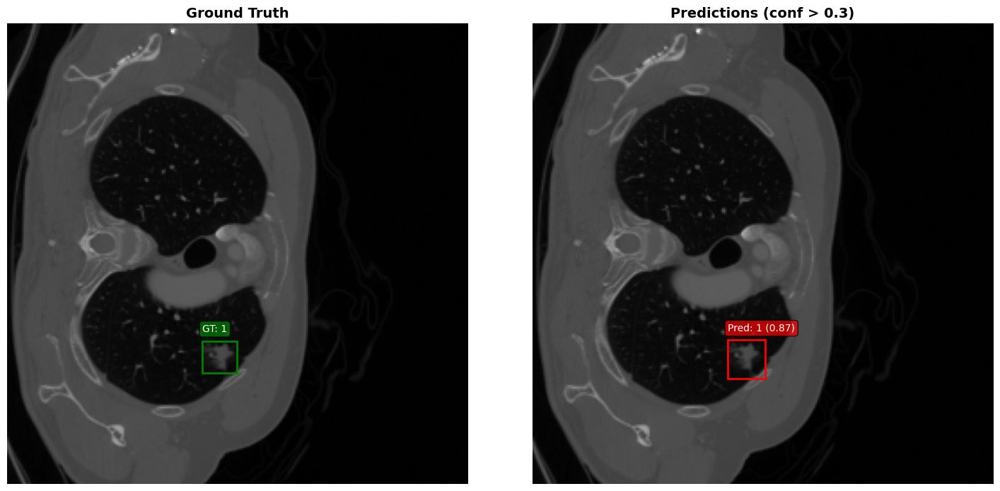

Image index: 50
Ground Truth: 1 boxes
Predictions: 1 boxes (confidence > 0.3)
GT Labels: [1]
Pred Labels: [1]
Pred Scores: [0.873213]


In [70]:
model_path = '/content/lung_tumor_exp1/final_faster_rcnn_lung_tumor.pth'
load_and_visualize(model_path, config, image_idx=50)

100%|██████████| 98/98 [00:00<00:00, 11067.36it/s]


Total 98 images found
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1040, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Prediction keys: dict_keys(['detections'])
Found 1 predictions above confidence 0.3


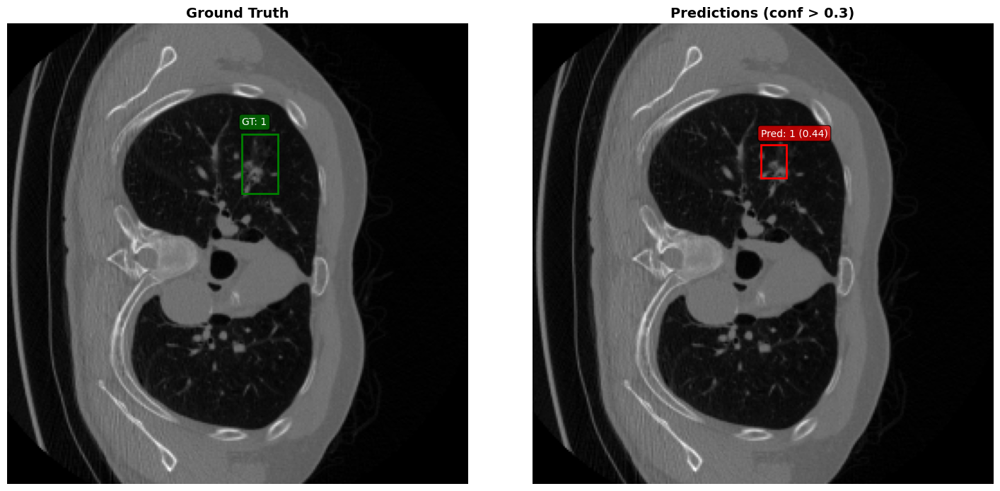

Image index: 11
Ground Truth: 1 boxes
Predictions: 1 boxes (confidence > 0.3)
GT Labels: [1]
Pred Labels: [1]
Pred Scores: [0.44064838]


In [73]:
model_path = '/content/lung_tumor_exp1/final_faster_rcnn_lung_tumor.pth'
load_and_visualize(model_path, config, image_idx=11)

100%|██████████| 98/98 [00:00<00:00, 8437.86it/s]


Total 98 images found
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1289, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Prediction keys: dict_keys(['detections'])
Found 1 predictions above confidence 0.3


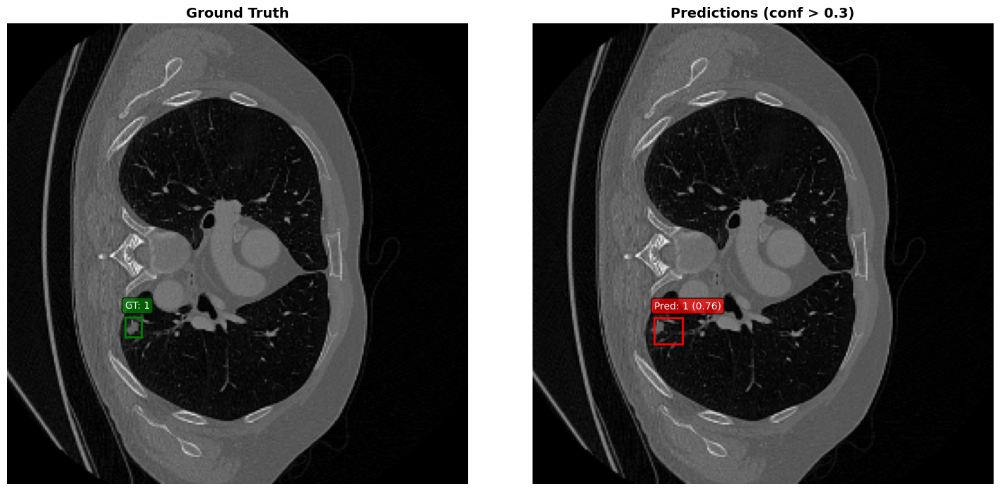

Image index: 95
Ground Truth: 1 boxes
Predictions: 1 boxes (confidence > 0.3)
GT Labels: [1]
Pred Labels: [1]
Pred Scores: [0.76151735]


In [81]:
model_path = '/content/lung_tumor_exp1/final_faster_rcnn_lung_tumor.pth'
load_and_visualize(model_path, config, image_idx=95)

100%|██████████| 98/98 [00:00<00:00, 8992.38it/s]


Total 98 images found
Debug: Features shape: torch.Size([1, 512, 32, 32])
Debug: RPN output keys: dict_keys(['proposals', 'scores'])
Debug: Proposals - 1 batches, shapes: [torch.Size([1103, 4])]
Debug: ROI output keys: dict_keys(['detections'])
Prediction keys: dict_keys(['detections'])
Found 1 predictions above confidence 0.3


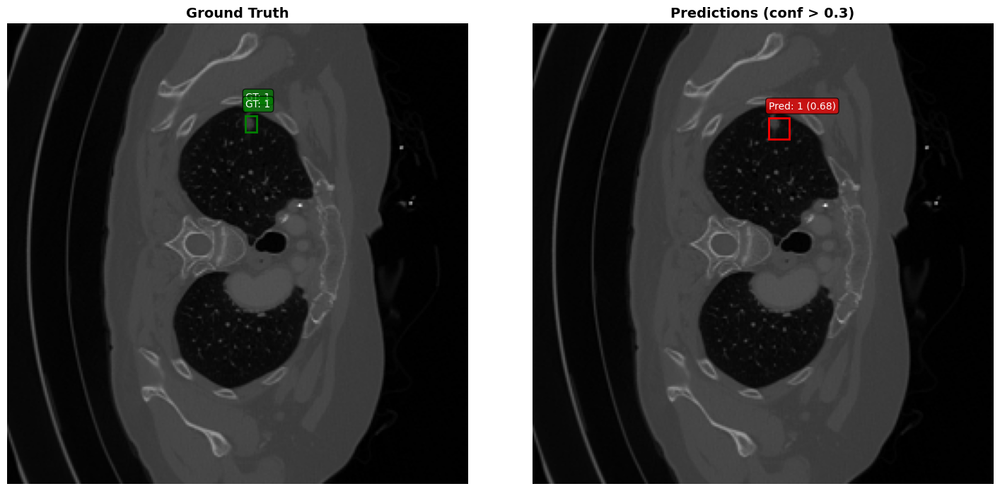

Image index: 27
Ground Truth: 2 boxes
Predictions: 1 boxes (confidence > 0.3)
GT Labels: [1 1]
Pred Labels: [1]
Pred Scores: [0.6842996]


In [88]:
model_path = '/content/lung_tumor_exp1/final_faster_rcnn_lung_tumor.pth'
load_and_visualize(model_path, config, image_idx=27)

In [ ]:
import nbformat

# Path to your notebook (Colab environment)
notebook_path = '/content/Copy_of_LSTM.ipynb'

# Load the notebook
with open(notebook_path, 'r', encoding='utf-8') as f:
    notebook = nbformat.read(f, as_version=4)

# Remove the 'widgets' metadata (this will strip all widgets)
if 'widgets' in notebook.metadata:
    del notebook.metadata['widgets']

# Save the cleaned notebook back
with open(notebook_path, 'w', encoding='utf-8') as f:
    nbformat.write(notebook, f)

print("All widget metadata removed from the notebook.")


class CustomerFeatures(BaseModel):
    CreditScore: int
    Geography: str
    Gender: str
    Age: int
    Tenure: int
    Balance: float
    NumOfProducts: int
    HasCrCard: int
    IsActiveMember: int
    EstimatedSalary: float

@app.post("/predict")
def predict(data: CustomerFeatures):
    # Convert Pydantic model to dict, then DataFrame
    input_df = pd.DataFrame([data.dict()])

    # Apply your saved preprocessing pipeline
    input_transformed = col_transf.transform(input_df)

    # Model prediction
    prediction = model.predict(input_transformed)

    return {"prediction": prediction.tolist()}